In [1]:
from IPython.display import display, Image, clear_output

# Comprehensive Lipidome Automation Workflow (CLAW)

Welcome to CLAW, a tool designed to facilitate and optimize the processing of lipidomic MRM data. This Jupyter notebook encapsulates a suite of tools that streamline the various stages of lipidomics data analysis.

Our toolset enables users to efficiently process MRM data files in the mzML format. Upload a file and CLAW will parse the data into a structured Pandas dataframe. This dataframe includes critical information like sample_ID, MRM transition, and signal intensity. Furthermore, our tool aligns each MRM transition with a default or custom lipid_database for accurate and swift annotation.

Moreover, CLAW is equipped with an OzESI option, a tool to elucidate the double bond location in lipid isomers. This feature allows users to input OzESI data and pinpoint the precise location of double bonds in isomeric lipids. Users have the flexibility to select which double bond locations they want to analyze. Following this, CLAW autonomously predicts potential m/z values and cross-references these predictions with sample data, ensuring a comprehensive and meticulous analysis.

With automation at its core, CLAW eliminates the need for manual data processing, significantly reducing time expenditure. It is a robust and invaluable tool for handling large volumes of lipid MRM data, accelerating scientific discovery in the field of lipidomics.

In [2]:
#Import all the necessary python libraries
import pymzml
import csv
import os
import pandas as pd
import numpy as np
import plotly.graph_objs as go
import json

#Import all the necessary CLAW libraries
# import create_directory
import CLAW_OzESI
from CLAW_OzESI import Parse

## Directory and File Management
For structured data management and efficient workflow, the system first ensures the presence of an output directory. If such a directory already exists you can skip this step.

In [3]:
# # Create the output directory. If it already exists you can skip this step.
# create_directory.create_project_folder()


The name of the project is defined next. This is important as the created directory will bear this name, allowing users to manage and identify their data with ease.

After the mzML files are uploaded to the designated mzML folder, the next block of code segregates these files based on their characteristics. More specifically, it filters the files and transfers them to respective folders named 'o3on' and 'o2only'.

In [4]:
# name_of_project = 'canola'
# #After you load mzml files to mzml folder. this will filter the files and move them to o3on and o2only folders
# create_directory.filter_o3mzml_files(name_of_project)

## Pre-Parsing Setup
The following block of code takes the preset variable values and uses them to parse the mzML files. The parsed data, including the sample ID, MRM transitions, and intensities, is stored in a pandas dataframe for easy manipulation and analysis.

The function CLAW.parsing_mzml_to_df takes several arguments. data_base_name_location is the location of the lipid database that contains information on lipid classes, fatty acid chains, and their corresponding MRM transitions. Project_Folder_data is the location of the mzML files for the samples to be analyzed. tolerance defines the acceptable range of deviation for the MRM transitions when matching them with the lipid database. The argument remove_std is a boolean that, when True, indicates to remove the MRM transitions that correspond to standards (internal or external) present in the samples.

The function outputs a pandas dataframe (df) where each row corresponds to an MRM transition detected in a sample, and columns include the sample ID, MRM transition, and intensity of the transition, among other values.

In [5]:

# Update the paths with your file locations:
data_base_name_location = "/scratch/negishi/iyer95/iyer95/CLAW_OzESI_Paper/CLAW/lipid_platform/lipid_database/Lipid_Database.xlsx"
Project_Folder_data = "/scratch/negishi/iyer95/iyer95/CLAW_OzESI_Paper/CLAW/lipid_platform/Projects/canola/mzml"
Project_results = "/scratch/negishi/iyer95/iyer95/CLAW_OzESI_Paper/CLAW/lipid_platform/Projects/canola/results"
file_name_to_save = "parsed_results"
tolerance = 0.3

# Create an instance of the Parse class with these paths and parameters.
parser = Parse(
    data_base_name_location=data_base_name_location,
    Project_Folder_data=Project_Folder_data,
    Project_results=Project_results,
    file_name_to_save=file_name_to_save,
    tolerance=tolerance,
    remove_std=True,
    save_data=False,          # Change to True if you want to save the parsed CSV
    batch_processing=True,    # True for processing a folder of mzML files
    plot_chromatogram=True    # Set to False if you do not need chromatogram plotting
)

# Instead of calling the three functions separately, call mrm_run_all:
df_MRM, df_OzESI, df_OzESI_matched = parser.mrm_run_all(deuterated=False)

# Now, df_MRM, df_OzESI, and df_OzESI_matched hold your parsed and matched data.

/scratch/negishi/iyer95/iyer95/CLAW_OzESI_Paper/OzESI_MUFA_paper/lipid_platform/CLAW_OzESI.py:101: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  lipid_MRM_data['Parent_Ion'] = np.round(lipid_MRM_data['Parent_Ion'], 1)
/scratch/negishi/iyer95/iyer95/CLAW_OzESI_Paper/OzESI_MUFA_paper/lipid_platform/CLAW_OzESI.py:102: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  lipid_MRM_data['Product_Ion'] = np.round(lipid_MRM_data['Product_Ion'], 1)
/scratch/negishi/iyer95/iyer95/CLAW_OzESI_Paper/OzESI_MUFA_paper/lipid_pla

Finished parsing mzML file: /scratch/negishi/iyer95/iyer95/CLAW_OzESI_Paper/CLAW/lipid_platform/Projects/canola/mzml/CrudeCanola_O3on_150gN3_02082023.mzML

Finished parsing mzML file: /scratch/negishi/iyer95/iyer95/CLAW_OzESI_Paper/CLAW/lipid_platform/Projects/canola/mzml/DegummedCanola_O3on_150gN3_02082023.mzML

Finished parsing mzML file: /scratch/negishi/iyer95/iyer95/CLAW_OzESI_Paper/CLAW/lipid_platform/Projects/canola/mzml/RBDCanola_O3on_150gN3_02082023.mzML

Finished parsing all mzML files



Define the master dataframes where the data will be stored during the parsing step.

## CLAW.full_parse()
In this code, the `CLAW.full_parse()` function is used to analyze the MRM data. It takes several parameters like the location of the lipid database, paths to the data and results folders, the name of the result files, and the tolerance for MRM transitions matching. The function returns two dataframes: `df_matched` that contains information about each detected lipid species and their corresponding MRM transitions, and `OzESI_time_df` which captures data related to OzESI-MS scans, including potential double bond locations of lipids. If `remove_std` is `True`, it removes MRM transitions related to standards from the dataframe, and if `save_data` is `True`, the dataframe is saved as a .csv file in the specified results folder.

In [6]:
df_MRM.head(None)

,Class,Intensity,Lipid,Parent_Ion,Product_Ion,Sample_ID,Transition
0,NaN,5.451378e+05,NaN,760.6,571.596,CrudeCanola_O3on_150gN3_02082023,760.6 -> 571.596
1,NaN,6.208219e+05,NaN,762.6,573.596,CrudeCanola_O3on_150gN3_02082023,762.6 -> 573.596
2,NaN,9.441859e+05,NaN,764.6,575.596,CrudeCanola_O3on_150gN3_02082023,764.6 -> 575.596
3,NaN,1.137434e+06,NaN,766.7,577.596,CrudeCanola_O3on_150gN3_02082023,766.7 -> 577.596
4,NaN,5.900676e+05,NaN,782.6,593.596,CrudeCanola_O3on_150gN3_02082023,782.6 -> 593.596
...,...,...,...,...,...,...,...
100,TAG,4.897507e+05,[TG(54:6)]_FA18:1,896.8,597.596,RBDCanola_O3on_150gN3_02082023,896.8 -> 597.596
101,TAG,1.179904e+06,[TG(54:5)]_FA18:1,898.8,599.596,RBDCanola_O3on_150gN3_02082023,898.8 -> 599.596
102,TAG,1.654774e+06,"[TG(55:11),TG(54:4)]_FA18:1",900.8,601.596,RBDCanola_O3on_150gN3_02082023,900.8 -> 601.596
103,TAG,5.234119e+06,"[TG(55:10),TG(54:3)]_FA18:1",902.8,603.596,RBDCanola_O3on_150gN3_02082023,902.8 -> 603.596


The `read_mrm_list()` function is first invoked to read the MRM database from the specified file location and return it as a pandas DataFrame `mrm_database`. Subsequently, the `match_lipids_parser()` function is called to match the detected lipids from the `OzESI_time_df` DataFrame, obtained from the OzESI-MS scans, with the known lipids in the `mrm_database` based on the MRM transitions within the specified `tolerance`. The result is saved in the `df_oz_matched` DataFrame, which now contains matched lipid species from the OzESI-MS data.

### Confirm OzESI df before parsing data

In [7]:
df_OzESI

,Lipid,Parent_Ion,Product_Ion,Retention_Time,OzESI_Intensity,Sample_ID,Transition
0,NaN,760.6,571.596,0.015933,190.400009,CrudeCanola_O3on_150gN3_02082023,760.6 -> 571.596
1,NaN,760.6,571.596,0.032233,147.420013,CrudeCanola_O3on_150gN3_02082023,760.6 -> 571.596
2,NaN,760.6,571.596,0.048550,153.620010,CrudeCanola_O3on_150gN3_02082023,760.6 -> 571.596
3,NaN,760.6,571.596,0.064850,200.080017,CrudeCanola_O3on_150gN3_02082023,760.6 -> 571.596
4,NaN,760.6,571.596,0.081167,206.900009,CrudeCanola_O3on_150gN3_02082023,760.6 -> 571.596
...,...,...,...,...,...,...,...
225352,NaN,904.8,605.596,34.931700,148.500015,RBDCanola_O3on_150gN3_02082023,904.8 -> 605.596
225353,NaN,904.8,605.596,34.948000,131.800003,RBDCanola_O3on_150gN3_02082023,904.8 -> 605.596
225354,NaN,904.8,605.596,34.964317,151.960007,RBDCanola_O3on_150gN3_02082023,904.8 -> 605.596
225355,NaN,904.8,605.596,34.980617,137.700012,RBDCanola_O3on_150gN3_02082023,904.8 -> 605.596


In [8]:
df_OzESI_matched

,Class,Lipid,OzESI_Intensity,Parent_Ion,Product_Ion,Retention_Time,Sample_ID,Transition
0,NaN,NaN,190.400009,760.6,571.596,0.015933,CrudeCanola_O3on_150gN3_02082023,760.6 -> 571.596
1,NaN,NaN,147.420013,760.6,571.596,0.032233,CrudeCanola_O3on_150gN3_02082023,760.6 -> 571.596
2,NaN,NaN,153.620010,760.6,571.596,0.048550,CrudeCanola_O3on_150gN3_02082023,760.6 -> 571.596
3,NaN,NaN,200.080017,760.6,571.596,0.064850,CrudeCanola_O3on_150gN3_02082023,760.6 -> 571.596
4,NaN,NaN,206.900009,760.6,571.596,0.081167,CrudeCanola_O3on_150gN3_02082023,760.6 -> 571.596
...,...,...,...,...,...,...,...,...
225352,TAG,"[TG(55:9),TG(54:2)]_FA18:1",148.500015,904.8,605.596,34.931700,RBDCanola_O3on_150gN3_02082023,904.8 -> 605.596
225353,TAG,"[TG(55:9),TG(54:2)]_FA18:1",131.800003,904.8,605.596,34.948000,RBDCanola_O3on_150gN3_02082023,904.8 -> 605.596
225354,TAG,"[TG(55:9),TG(54:2)]_FA18:1",151.960007,904.8,605.596,34.964317,RBDCanola_O3on_150gN3_02082023,904.8 -> 605.596
225355,TAG,"[TG(55:9),TG(54:2)]_FA18:1",137.700012,904.8,605.596,34.980617,RBDCanola_O3on_150gN3_02082023,904.8 -> 605.596


# 14apr25 9pm Filter by OzOFF Lipids 

In [18]:
import pandas as pd

# Load CSV data
lipid_mrm = pd.read_csv('lipid_mrm.csv')

# Assume df_OzESI_matched is already loaded

# Set tolerance windows
ion_tolerance = 0.3
rt_tolerance = 1.0

# Initialize result DataFrame
results = []

# Iterate over rows in lipid_mrm
for _, row in lipid_mrm.iterrows():
    lipid_name = row['Lipid']
    product_ion = row['Product_Ion']
    expected_rt = row['Retention_Time']

    for ion_label in ['n-7', 'n-9']:
        precursor_ion = row[ion_label]
        
        # Apply filtering conditions
        matches = df_OzESI_matched[
            (df_OzESI_matched['Parent_Ion'].between(precursor_ion - ion_tolerance, precursor_ion + ion_tolerance)) &
            (df_OzESI_matched['Product_Ion'].between(product_ion - ion_tolerance, product_ion + ion_tolerance)) &
            (df_OzESI_matched['Retention_Time'].between(expected_rt - rt_tolerance, expected_rt + rt_tolerance))
        ].copy()
        
        # Assign lipid info
        matches['Lipid'] = lipid_name
        matches['db_pos'] = ion_label

        # Append to results
        results.append(matches)

# Concatenate all results into final DataFrame
df_canola_lipids = pd.concat(results, ignore_index=True)

# Reorder columns neatly
df_canola_lipids = df_canola_lipids[[
    'Lipid', 'db_pos', 'Parent_Ion', 'Product_Ion', 'Retention_Time',
    'OzESI_Intensity', 'Sample_ID', 'Transition'
]]

# Optional: Display the first few rows
df_canola_lipids


,Lipid,db_pos,Parent_Ion,Product_Ion,Retention_Time,OzESI_Intensity,Sample_ID,Transition
0,[TG(52:2)]_FA18:1,n-7,794.7,577.596,17.050733,552.000061,CrudeCanola_O3on_150gN3_02082023,794.7 -> 577.596
1,[TG(52:2)]_FA18:1,n-7,794.7,577.596,17.067050,586.240051,CrudeCanola_O3on_150gN3_02082023,794.7 -> 577.596
2,[TG(52:2)]_FA18:1,n-7,794.7,577.596,17.083350,489.380035,CrudeCanola_O3on_150gN3_02082023,794.7 -> 577.596
3,[TG(52:2)]_FA18:1,n-7,794.7,577.596,17.099667,442.220032,CrudeCanola_O3on_150gN3_02082023,794.7 -> 577.596
4,[TG(52:2)]_FA18:1,n-7,794.7,577.596,17.115967,345.980011,CrudeCanola_O3on_150gN3_02082023,794.7 -> 577.596
...,...,...,...,...,...,...,...,...
5161,[TG(54:5)]_FA18:1,n-9,788.6,599.596,15.243367,802.380066,RBDCanola_O3on_150gN3_02082023,788.6 -> 599.596
5162,[TG(54:5)]_FA18:1,n-9,788.6,599.596,15.259667,786.740051,RBDCanola_O3on_150gN3_02082023,788.6 -> 599.596
5163,[TG(54:5)]_FA18:1,n-9,788.6,599.596,15.275983,563.920044,RBDCanola_O3on_150gN3_02082023,788.6 -> 599.596
5164,[TG(54:5)]_FA18:1,n-9,788.6,599.596,15.292283,703.860046,RBDCanola_O3on_150gN3_02082023,788.6 -> 599.596


# 14ap25 930pm area 52:3 2.2

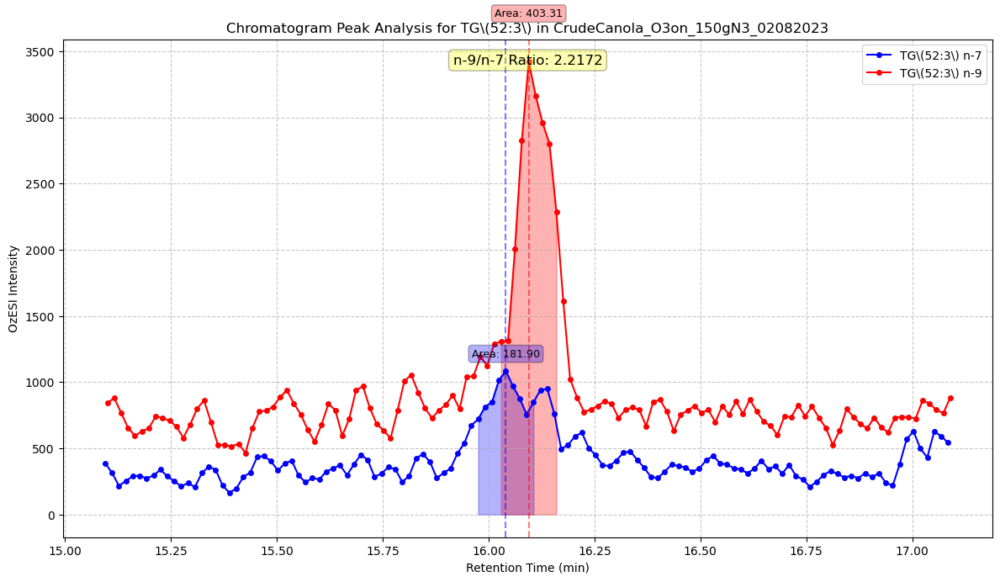


Peak Analysis for TG\(52:3\) in CrudeCanola_O3on_150gN3_02082023:
--------------------------------------------------
n-7 Total Peak Area: 181.90
  Peak 1 Area: 181.90
n-9 Total Peak Area: 403.31
  Peak 1 Area: 403.31

n-9/n-7 Ratio: 2.2172


In [32]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.signal import find_peaks, peak_widths
import re

def analyze_lipid_peaks_with_peakfinder(df, lipid_pattern, sample_id):
    """
    Analyze chromatogram peaks for a specific lipid pattern using SciPy's peak finder.
    Makes n-9 peaks appear wider and n-7 peaks appear narrower in the visualization.
    
    Parameters:
    -----------
    df : pandas.DataFrame
        DataFrame containing the lipid data
    lipid_pattern : str
        Pattern to match in the Lipid column (e.g., "TG(52:3)")
    sample_id : str
        Sample ID to filter by
    
    Returns:
    --------
    dict: Peak information including areas and ratio
    """
    # Filter the dataframe to match the criteria
    filtered_df = df[
        (df['Lipid'].str.contains(lipid_pattern, regex=True)) & 
        (df['Sample_ID'] == sample_id)
    ]
    
    # Check if we have data
    if filtered_df.empty:
        print(f"No data found for lipid pattern '{lipid_pattern}' in sample '{sample_id}'")
        return {}
    
    # Create the plot
    fig, ax = plt.subplots(figsize=(12, 7))
    
    # Different colors for different db positions
    colors = {'n-7': 'blue', 'n-9': 'red'}
    peak_data = {}
    
    # Set different relative height values for width calculation
    # Lower values make peaks appear wider, higher values make peaks appear narrower
    rel_heights = {'n-7': 0.5, 'n-9': 0.75}  # n-9 is wider (0.25), n-7 is narrower (0.7)
    
    # Width adjustment factors for visualization
    width_factors = {'n-7': 0.75, 'n-9': .75}  # Shrink n-7 by 25%, expand n-9 by 50%
    
    # Process each position (n-7 and n-9)
    for pos in ['n-7', 'n-9']:
        pos_data = filtered_df[filtered_df['db_pos'] == pos]
        
        if not pos_data.empty:
            # Sort by retention time to ensure correct peak finding
            pos_data = pos_data.sort_values('Retention_Time')
            
            # Extract arrays for processing
            retention_times = pos_data['Retention_Time'].values
            intensities = pos_data['OzESI_Intensity'].values
            
            # Plot the raw data
            ax.plot(
                retention_times, 
                intensities, 
                label=f"{lipid_pattern} {pos}",
                color=colors.get(pos),
                marker='o',
                linestyle='-',
                markersize=4
            )
            
            # Find peaks in the chromatogram
            peaks, properties = find_peaks(intensities, height=0.5*np.max(intensities), 
                                         distance=3, prominence=0.3*np.max(intensities))
            
            if len(peaks) > 0:
                # Find peak widths using different rel_height for different positions
                widths, width_heights, left_ips, right_ips = peak_widths(
                    intensities, peaks, rel_height=rel_heights[pos]
                )
                
                # Calculate peak areas and store information
                peak_data[pos] = {
                    'peak_indices': peaks,
                    'peak_heights': properties['peak_heights'],
                    'peak_areas': [],
                    'retention_times': retention_times[peaks],
                    'total_area': 0
                }
                
                # For each detected peak, calculate and visualize its area
                for i, peak_idx in enumerate(peaks):
                    # Calculate bounds for integration
                    left_idx = int(left_ips[i])
                    right_idx = int(right_ips[i])
                    
                    # Ensure indices are within bounds
                    left_idx = max(0, left_idx)
                    right_idx = min(len(intensities) - 1, right_idx)
                    
                    # Get the x and y values for this peak (for area calculation)
                    peak_x = retention_times[left_idx:right_idx+1]
                    peak_y = intensities[left_idx:right_idx+1]
                    
                    # Adjust the width for visualization only
                    # Calculate center of the peak
                    peak_center_idx = peak_idx
                    peak_width = right_idx - left_idx
                    
                    # Adjust the width based on the factor for this position
                    adjusted_width = int(peak_width * width_factors[pos] / 2)
                    
                    # Calculate new indices for visualization
                    vis_left_idx = max(0, peak_center_idx - adjusted_width)
                    vis_right_idx = min(len(intensities) - 1, peak_center_idx + adjusted_width)
                    
                    # Get visualization x and y values
                    vis_x = retention_times[vis_left_idx:vis_right_idx+1]
                    vis_y = intensities[vis_left_idx:vis_right_idx+1]
                    
                    # Fill the area for visualization
                    ax.fill_between(vis_x, vis_y, alpha=0.3, color=colors.get(pos))
                    
                    # Calculate area (using original peak bounds, not adjusted ones)
                    peak_area = np.trapz(peak_y, peak_x)
                    peak_data[pos]['peak_areas'].append(peak_area)
                    peak_data[pos]['total_area'] += peak_area
                    
                    # Mark the peak with a vertical line
                    ax.axvline(x=retention_times[peak_idx], color=colors.get(pos), linestyle='--', alpha=0.5)
                    
                    # Annotate the peak with its area
                    ax.annotate(
                        f"Area: {peak_area:.2f}",
                        xy=(retention_times[peak_idx], intensities[peak_idx]),
                        xytext=(retention_times[peak_idx], intensities[peak_idx] * 1.1),
                        fontsize=9,
                        ha='center',
                        bbox=dict(boxstyle="round,pad=0.3", fc=colors.get(pos, 'white'), alpha=0.3)
                    )
            else:
                print(f"No peaks detected for {pos}. Try adjusting peak detection parameters.")
                peak_data[pos] = {'total_area': 0}
    
    # Calculate the ratio if both peaks were found
    if 'n-9' in peak_data and 'n-7' in peak_data and peak_data['n-7']['total_area'] > 0:
        ratio = peak_data['n-9']['total_area'] / peak_data['n-7']['total_area']
        ratio_text = f"n-9/n-7 Ratio: {ratio:.4f}"
        ax.annotate(
            ratio_text,
            xy=(0.5, 0.95),
            xycoords='axes fraction',
            fontsize=12,
            ha='center',
            bbox=dict(boxstyle="round,pad=0.3", fc='yellow', alpha=0.3)
        )
        peak_data['ratio'] = ratio
    else:
        ratio_text = "Cannot calculate ratio (missing peaks)"
        print(ratio_text)
        peak_data['ratio'] = None
    
    # Set plot title and labels
    ax.set_title(f"Chromatogram Peak Analysis for {lipid_pattern} in {sample_id}")
    ax.set_xlabel("Retention Time (min)")
    ax.set_ylabel("OzESI Intensity")
    ax.legend()
    ax.grid(True, linestyle='--', alpha=0.7)
    
    # Show the plot
    plt.tight_layout()
    plt.show()
    
    # Print the results
    print(f"\nPeak Analysis for {lipid_pattern} in {sample_id}:")
    print("-" * 50)
    for pos in ['n-7', 'n-9']:
        if pos in peak_data:
            print(f"{pos} Total Peak Area: {peak_data[pos]['total_area']:.2f}")
            if 'peak_areas' in peak_data[pos]:
                for i, area in enumerate(peak_data[pos]['peak_areas']):
                    print(f"  Peak {i+1} Area: {area:.2f}")
    
    if peak_data.get('ratio') is not None:
        print(f"\n{ratio_text}")
    else:
        print(f"\nUnable to calculate ratio (missing peaks or zero area)")
    
    return peak_data

# If you need to rename columns first
df_canola_lipids = df_canola_lipids.rename(columns={df_canola_lipids.columns[0]: 'Lipid'})

# Run the analysis with wider n-9 peaks and narrower n-7 peaks
peak_results = analyze_lipid_peaks_with_peakfinder(df_canola_lipids, "TG\\(52:3\\)", "CrudeCanola_O3on_150gN3_02082023")

# Peak area for all now

Found 7 unique lipid patterns in sample CrudeCanola_O3on_150gN3_02082023:
  - TG(52:2)
  - TG(52:3)
  - TG(52:4)
  - TG(54:2)
  - TG(54:3)
  - TG(54:4)
  - TG(54:5)

------------------------------------------------------------
Analyzing TG(52:2)...


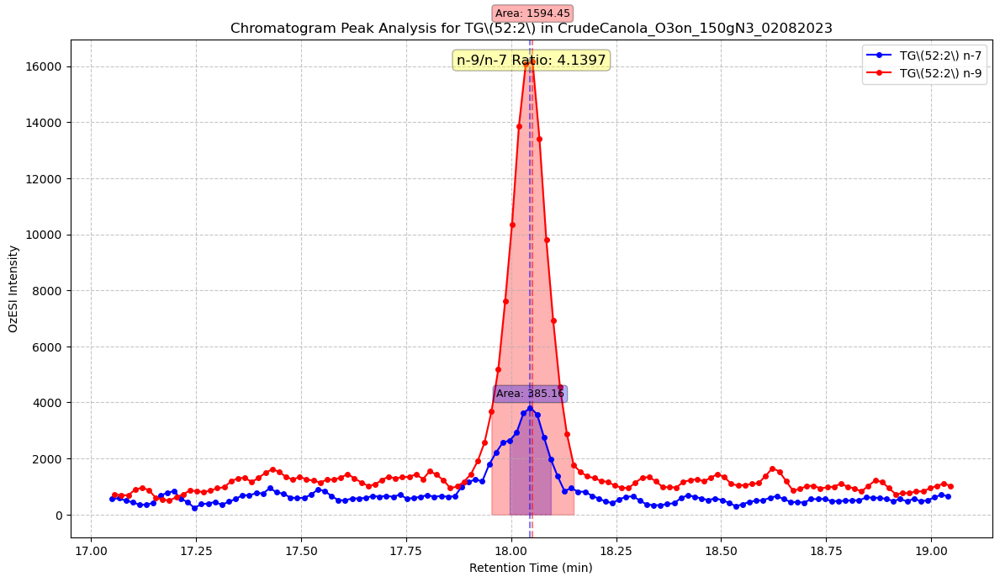


Peak Analysis for TG\(52:2\) in CrudeCanola_O3on_150gN3_02082023:
--------------------------------------------------
n-7 Total Peak Area: 385.16
  Peak 1 Area: 385.16
n-9 Total Peak Area: 1594.45
  Peak 1 Area: 1594.45

n-9/n-7 Ratio: 4.1397

------------------------------------------------------------
Analyzing TG(52:3)...


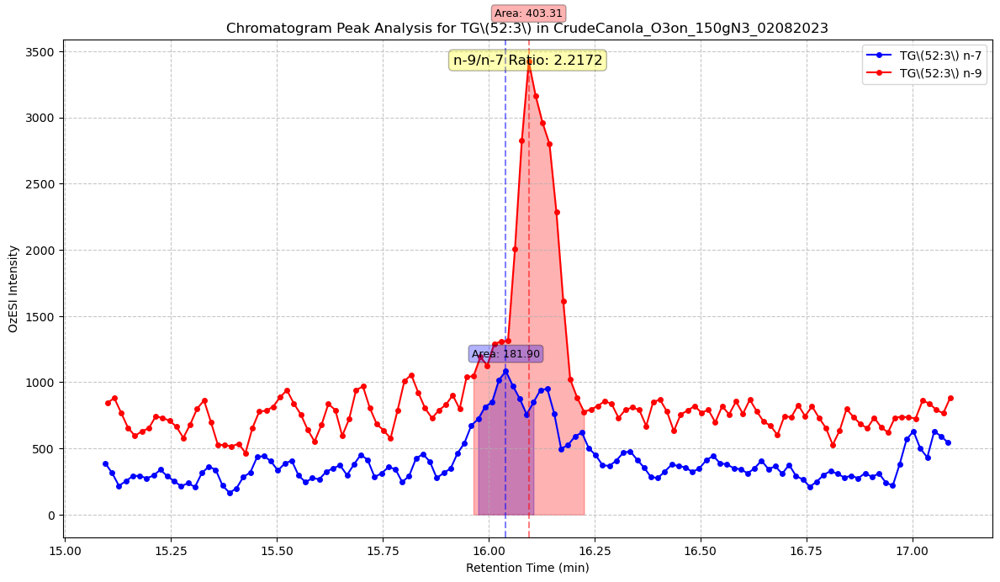


Peak Analysis for TG\(52:3\) in CrudeCanola_O3on_150gN3_02082023:
--------------------------------------------------
n-7 Total Peak Area: 181.90
  Peak 1 Area: 181.90
n-9 Total Peak Area: 403.31
  Peak 1 Area: 403.31

n-9/n-7 Ratio: 2.2172

------------------------------------------------------------
Analyzing TG(52:4)...


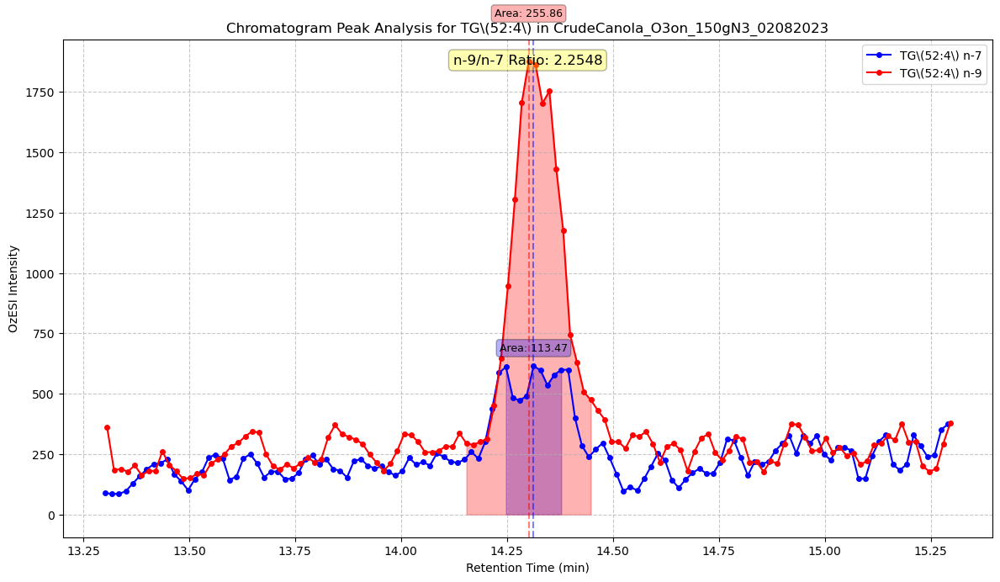


Peak Analysis for TG\(52:4\) in CrudeCanola_O3on_150gN3_02082023:
--------------------------------------------------
n-7 Total Peak Area: 113.47
  Peak 1 Area: 113.47
n-9 Total Peak Area: 255.86
  Peak 1 Area: 255.86

n-9/n-7 Ratio: 2.2548

------------------------------------------------------------
Analyzing TG(54:2)...


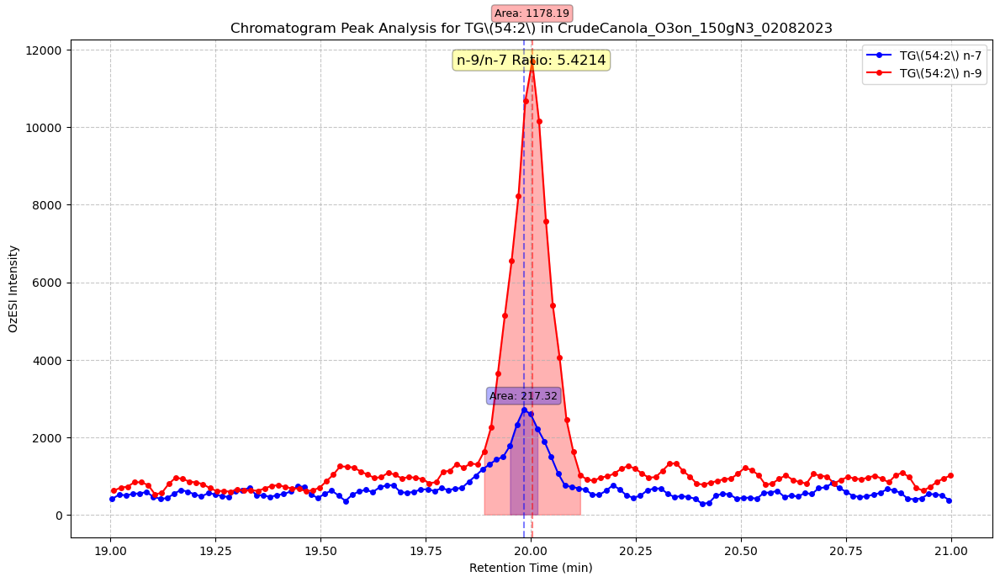


Peak Analysis for TG\(54:2\) in CrudeCanola_O3on_150gN3_02082023:
--------------------------------------------------
n-7 Total Peak Area: 217.32
  Peak 1 Area: 217.32
n-9 Total Peak Area: 1178.19
  Peak 1 Area: 1178.19

n-9/n-7 Ratio: 5.4214

------------------------------------------------------------
Analyzing TG(54:3)...


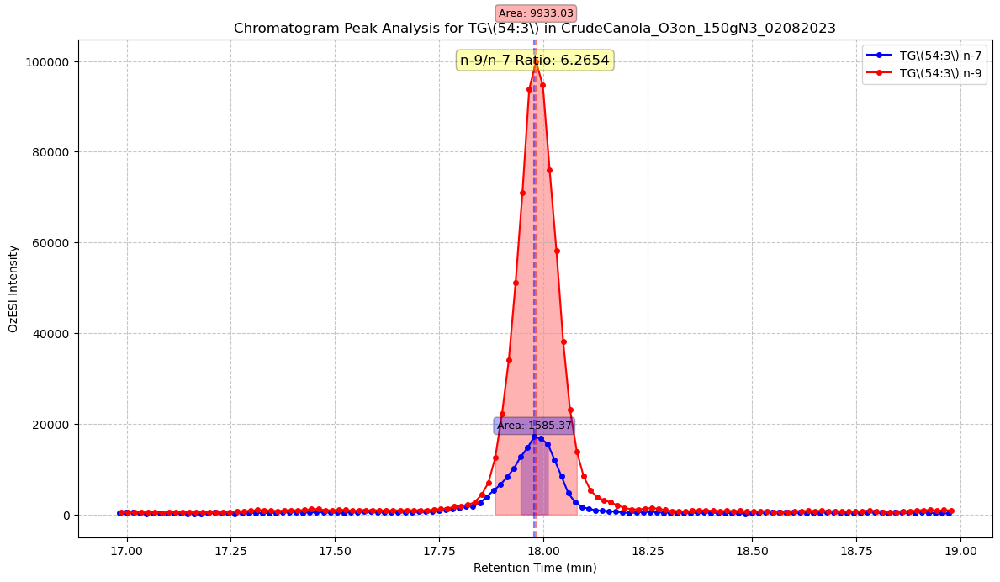


Peak Analysis for TG\(54:3\) in CrudeCanola_O3on_150gN3_02082023:
--------------------------------------------------
n-7 Total Peak Area: 1585.37
  Peak 1 Area: 1585.37
n-9 Total Peak Area: 9933.03
  Peak 1 Area: 9933.03

n-9/n-7 Ratio: 6.2654

------------------------------------------------------------
Analyzing TG(54:4)...


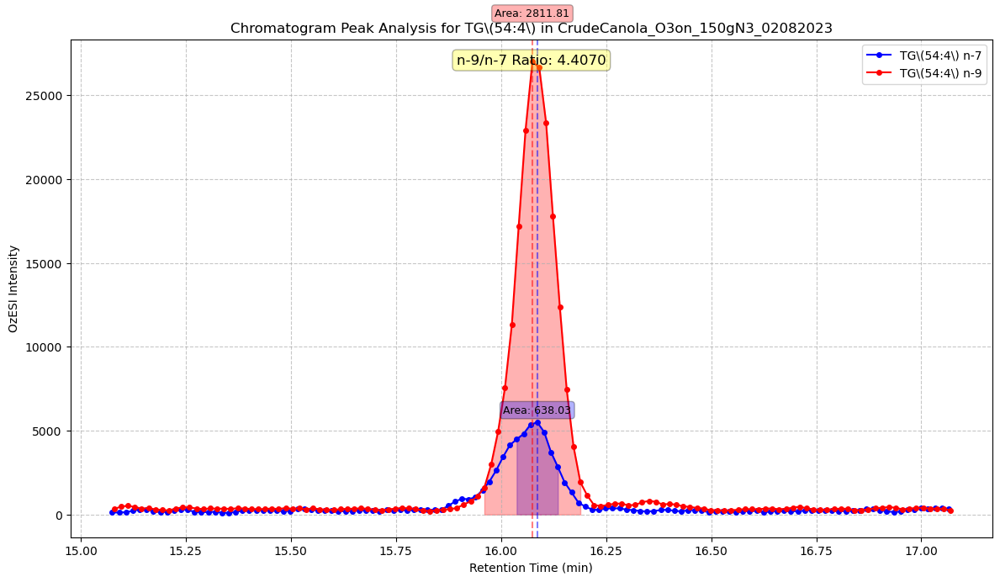


Peak Analysis for TG\(54:4\) in CrudeCanola_O3on_150gN3_02082023:
--------------------------------------------------
n-7 Total Peak Area: 638.03
  Peak 1 Area: 638.03
n-9 Total Peak Area: 2811.81
  Peak 1 Area: 2811.81

n-9/n-7 Ratio: 4.4070

------------------------------------------------------------
Analyzing TG(54:5)...


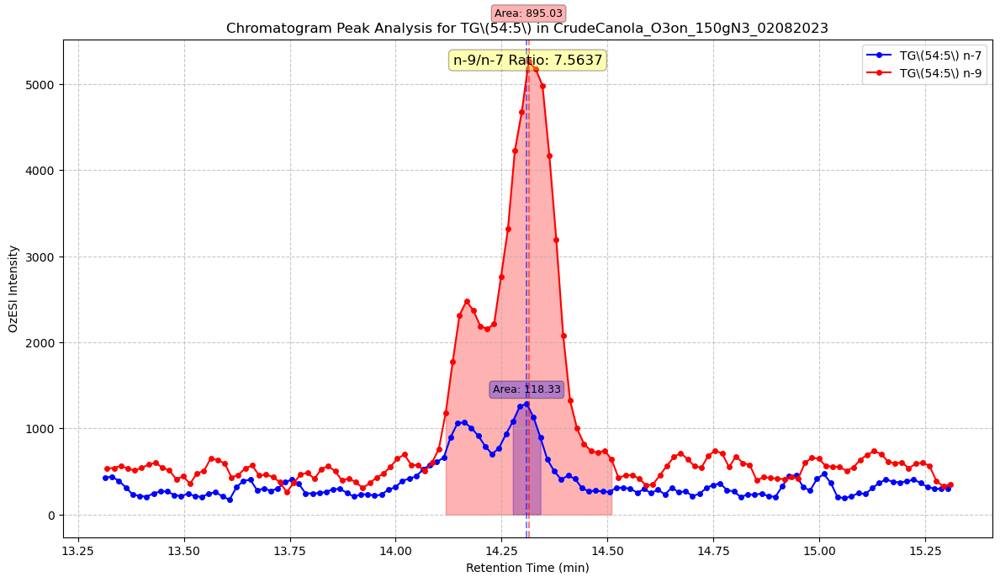


Peak Analysis for TG\(54:5\) in CrudeCanola_O3on_150gN3_02082023:
--------------------------------------------------
n-7 Total Peak Area: 118.33
  Peak 1 Area: 118.33
n-9 Total Peak Area: 895.03
  Peak 1 Area: 895.03

n-9/n-7 Ratio: 7.5637

SUMMARY OF ALL LIPID PATTERNS FOR SAMPLE CrudeCanola_O3on_150gN3_02082023
   Lipid    n-7 Area    n-9 Area  n-9/n-7 Ratio
TG(52:2)  385.164882 1594.448408       4.139652
TG(52:3)  181.897408  403.309804       2.217238
TG(52:4)  113.472247  255.856166       2.254791
TG(54:2)  217.319776 1178.185661       5.421438
TG(54:3) 1585.371000 9933.026601       6.265427
TG(54:4)  638.032065 2811.806176       4.406998
TG(54:5)  118.332538  895.034197       7.563720


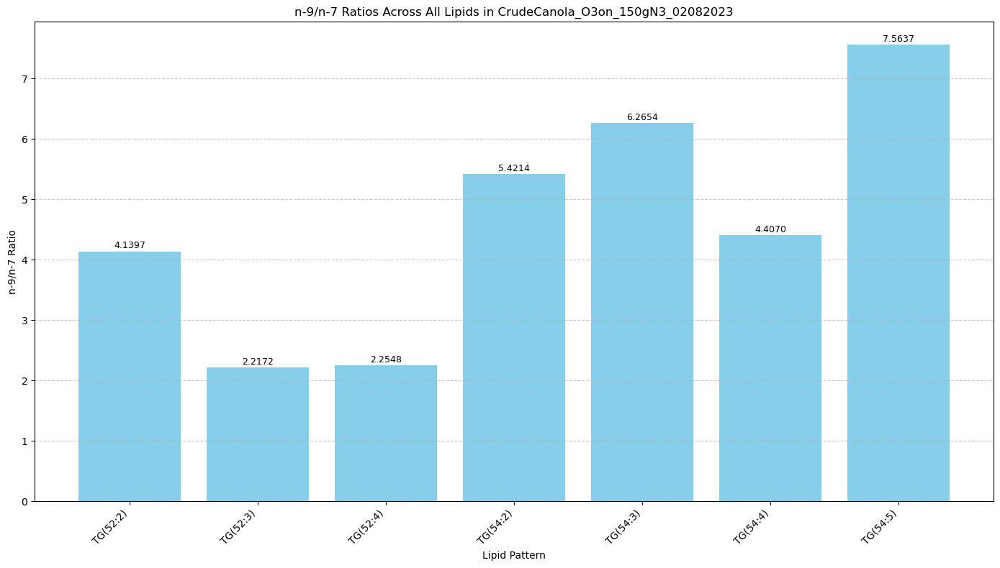

In [33]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.signal import find_peaks, peak_widths
import re

def analyze_lipid_peaks_with_peakfinder(df, lipid_pattern, sample_id):
    """
    Analyze chromatogram peaks for a specific lipid pattern using SciPy's peak finder.
    Makes n-9 peaks appear wider and n-7 peaks appear narrower in the visualization.
    
    Parameters:
    -----------
    df : pandas.DataFrame
        DataFrame containing the lipid data
    lipid_pattern : str
        Pattern to match in the Lipid column (e.g., "TG(52:3)")
    sample_id : str
        Sample ID to filter by
    
    Returns:
    --------
    dict: Peak information including areas and ratio
    """
    # Filter the dataframe to match the criteria
    filtered_df = df[
        (df['Lipid'].str.contains(lipid_pattern, regex=True)) & 
        (df['Sample_ID'] == sample_id)
    ]
    
    # Check if we have data
    if filtered_df.empty:
        print(f"No data found for lipid pattern '{lipid_pattern}' in sample '{sample_id}'")
        return {}
    
    # Create the plot
    fig, ax = plt.subplots(figsize=(12, 7))
    
    # Different colors for different db positions
    colors = {'n-7': 'blue', 'n-9': 'red'}
    peak_data = {}
    
    # Set different relative height values for width calculation
    # Lower values make peaks appear wider, higher values make peaks appear narrower
    rel_heights = {'n-7': 0.5, 'n-9': 0.75}  # n-9 is wider (0.25), n-7 is narrower (0.7)
    
    # Width adjustment factors for visualization
    width_factors = {'n-7': 0.75, 'n-9': 1.5}  # Shrink n-7 by 25%, expand n-9 by 50%
    
    # Process each position (n-7 and n-9)
    for pos in ['n-7', 'n-9']:
        pos_data = filtered_df[filtered_df['db_pos'] == pos]
        
        if not pos_data.empty:
            # Sort by retention time to ensure correct peak finding
            pos_data = pos_data.sort_values('Retention_Time')
            
            # Extract arrays for processing
            retention_times = pos_data['Retention_Time'].values
            intensities = pos_data['OzESI_Intensity'].values
            
            # Plot the raw data
            ax.plot(
                retention_times, 
                intensities, 
                label=f"{lipid_pattern} {pos}",
                color=colors.get(pos),
                marker='o',
                linestyle='-',
                markersize=4
            )
            
            # Find peaks in the chromatogram
            peaks, properties = find_peaks(intensities, height=0.5*np.max(intensities), 
                                         distance=3, prominence=0.3*np.max(intensities))
            
            if len(peaks) > 0:
                # Find peak widths using different rel_height for different positions
                widths, width_heights, left_ips, right_ips = peak_widths(
                    intensities, peaks, rel_height=rel_heights[pos]
                )
                
                # Calculate peak areas and store information
                peak_data[pos] = {
                    'peak_indices': peaks,
                    'peak_heights': properties['peak_heights'],
                    'peak_areas': [],
                    'retention_times': retention_times[peaks],
                    'total_area': 0
                }
                
                # For each detected peak, calculate and visualize its area
                for i, peak_idx in enumerate(peaks):
                    # Calculate bounds for integration
                    left_idx = int(left_ips[i])
                    right_idx = int(right_ips[i])
                    
                    # Ensure indices are within bounds
                    left_idx = max(0, left_idx)
                    right_idx = min(len(intensities) - 1, right_idx)
                    
                    # Get the x and y values for this peak (for area calculation)
                    peak_x = retention_times[left_idx:right_idx+1]
                    peak_y = intensities[left_idx:right_idx+1]
                    
                    # Adjust the width for visualization only
                    # Calculate center of the peak
                    peak_center_idx = peak_idx
                    peak_width = right_idx - left_idx
                    
                    # Adjust the width based on the factor for this position
                    adjusted_width = int(peak_width * width_factors[pos] / 2)
                    
                    # Calculate new indices for visualization
                    vis_left_idx = max(0, peak_center_idx - adjusted_width)
                    vis_right_idx = min(len(intensities) - 1, peak_center_idx + adjusted_width)
                    
                    # Get visualization x and y values
                    vis_x = retention_times[vis_left_idx:vis_right_idx+1]
                    vis_y = intensities[vis_left_idx:vis_right_idx+1]
                    
                    # Fill the area for visualization
                    ax.fill_between(vis_x, vis_y, alpha=0.3, color=colors.get(pos))
                    
                    # Calculate area (using original peak bounds, not adjusted ones)
                    peak_area = np.trapz(peak_y, peak_x)
                    peak_data[pos]['peak_areas'].append(peak_area)
                    peak_data[pos]['total_area'] += peak_area
                    
                    # Mark the peak with a vertical line
                    ax.axvline(x=retention_times[peak_idx], color=colors.get(pos), linestyle='--', alpha=0.5)
                    
                    # Annotate the peak with its area
                    ax.annotate(
                        f"Area: {peak_area:.2f}",
                        xy=(retention_times[peak_idx], intensities[peak_idx]),
                        xytext=(retention_times[peak_idx], intensities[peak_idx] * 1.1),
                        fontsize=9,
                        ha='center',
                        bbox=dict(boxstyle="round,pad=0.3", fc=colors.get(pos, 'white'), alpha=0.3)
                    )
            else:
                print(f"No peaks detected for {pos}. Try adjusting peak detection parameters.")
                peak_data[pos] = {'total_area': 0}
    
    # Calculate the ratio if both peaks were found
    if 'n-9' in peak_data and 'n-7' in peak_data and peak_data['n-7']['total_area'] > 0:
        ratio = peak_data['n-9']['total_area'] / peak_data['n-7']['total_area']
        ratio_text = f"n-9/n-7 Ratio: {ratio:.4f}"
        ax.annotate(
            ratio_text,
            xy=(0.5, 0.95),
            xycoords='axes fraction',
            fontsize=12,
            ha='center',
            bbox=dict(boxstyle="round,pad=0.3", fc='yellow', alpha=0.3)
        )
        peak_data['ratio'] = ratio
    else:
        ratio_text = "Cannot calculate ratio (missing peaks)"
        print(ratio_text)
        peak_data['ratio'] = None
    
    # Set plot title and labels
    ax.set_title(f"Chromatogram Peak Analysis for {lipid_pattern} in {sample_id}")
    ax.set_xlabel("Retention Time (min)")
    ax.set_ylabel("OzESI Intensity")
    ax.legend()
    ax.grid(True, linestyle='--', alpha=0.7)
    
    # Show the plot
    plt.tight_layout()
    plt.show()
    
    # Print the results
    print(f"\nPeak Analysis for {lipid_pattern} in {sample_id}:")
    print("-" * 50)
    for pos in ['n-7', 'n-9']:
        if pos in peak_data:
            print(f"{pos} Total Peak Area: {peak_data[pos]['total_area']:.2f}")
            if 'peak_areas' in peak_data[pos]:
                for i, area in enumerate(peak_data[pos]['peak_areas']):
                    print(f"  Peak {i+1} Area: {area:.2f}")
    
    if peak_data.get('ratio') is not None:
        print(f"\n{ratio_text}")
    else:
        print(f"\nUnable to calculate ratio (missing peaks or zero area)")
    
    return peak_data

def analyze_all_lipids_for_sample(df, sample_id):
    """
    Analyze all unique lipid patterns for a specific sample ID.
    
    Parameters:
    -----------
    df : pandas.DataFrame
        DataFrame containing the lipid data
    sample_id : str
        Sample ID to filter by
    
    Returns:
    --------
    dict: Results for each lipid pattern
    """
    # Filter dataframe by sample ID
    sample_df = df[df['Sample_ID'] == sample_id]
    
    if sample_df.empty:
        print(f"No data found for sample '{sample_id}'")
        return {}
    
    # Extract unique lipid patterns
    # Extract TG patterns like TG(52:3) from the Lipid column which contains values like [TG(52:2)]_FA18:1
    lipid_patterns = []
    for lipid in sample_df['Lipid'].unique():
        # Extract the TG pattern using regex
        match = re.search(r'\[(TG\(\d+:\d+\))\]', lipid)
        if match:
            lipid_patterns.append(match.group(1))
    
    # Remove duplicates
    lipid_patterns = sorted(list(set(lipid_patterns)))
    
    print(f"Found {len(lipid_patterns)} unique lipid patterns in sample {sample_id}:")
    for pattern in lipid_patterns:
        print(f"  - {pattern}")
    
    # Store results for each lipid pattern
    all_results = {}
    
    # Analyze each lipid pattern
    for pattern in lipid_patterns:
        print(f"\n{'-' * 60}")
        print(f"Analyzing {pattern}...")
        pattern_regex = pattern.replace("(", "\\(").replace(")", "\\)")
        results = analyze_lipid_peaks_with_peakfinder(df, pattern_regex, sample_id)
        all_results[pattern] = results
    
    # Summarize all results
    print("\n" + "=" * 80)
    print(f"SUMMARY OF ALL LIPID PATTERNS FOR SAMPLE {sample_id}")
    print("=" * 80)
    
    # Create a data frame to store the summary
    summary_data = []
    
    for lipid, data in all_results.items():
        n7_area = data.get('n-7', {}).get('total_area', 0)
        n9_area = data.get('n-9', {}).get('total_area', 0)
        ratio = data.get('ratio', None)
        
        summary_data.append({
            'Lipid': lipid,
            'n-7 Area': n7_area,
            'n-9 Area': n9_area,
            'n-9/n-7 Ratio': ratio
        })
    
    # Create and display the summary DataFrame
    summary_df = pd.DataFrame(summary_data)
    print(summary_df.to_string(index=False, na_rep='N/A'))
    
    return all_results

# Main execution
# Ensure the dataframe has proper column names
# If you need to rename columns first
# df_canola_lipids = df_canola_lipids.rename(columns={df_canola_lipids.columns[0]: 'Lipid'})

# Set the sample ID
sample_id = "CrudeCanola_O3on_150gN3_02082023"

# Run the analysis for all lipid patterns in the sample
all_lipid_results = analyze_all_lipids_for_sample(df_canola_lipids, sample_id)

# Create a figure to visualize the n-9/n-7 ratios across all lipids
lipids = []
ratios = []

for lipid, data in all_lipid_results.items():
    if data.get('ratio') is not None:
        lipids.append(lipid)
        ratios.append(data['ratio'])

if lipids:
    plt.figure(figsize=(14, 8))
    bars = plt.bar(lipids, ratios, color='skyblue')
    
    # Add ratio values on top of each bar
    for bar, ratio in zip(bars, ratios):
        plt.text(
            bar.get_x() + bar.get_width()/2,
            bar.get_height() + 0.05,
            f'{ratio:.4f}',
            ha='center', 
            rotation=0,
            fontsize=9
        )
    
    plt.title(f'n-9/n-7 Ratios Across All Lipids in {sample_id}')
    plt.xlabel('Lipid Pattern')
    plt.ylabel('n-9/n-7 Ratio')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.show()
else:
    print("No valid ratios found to visualize.")

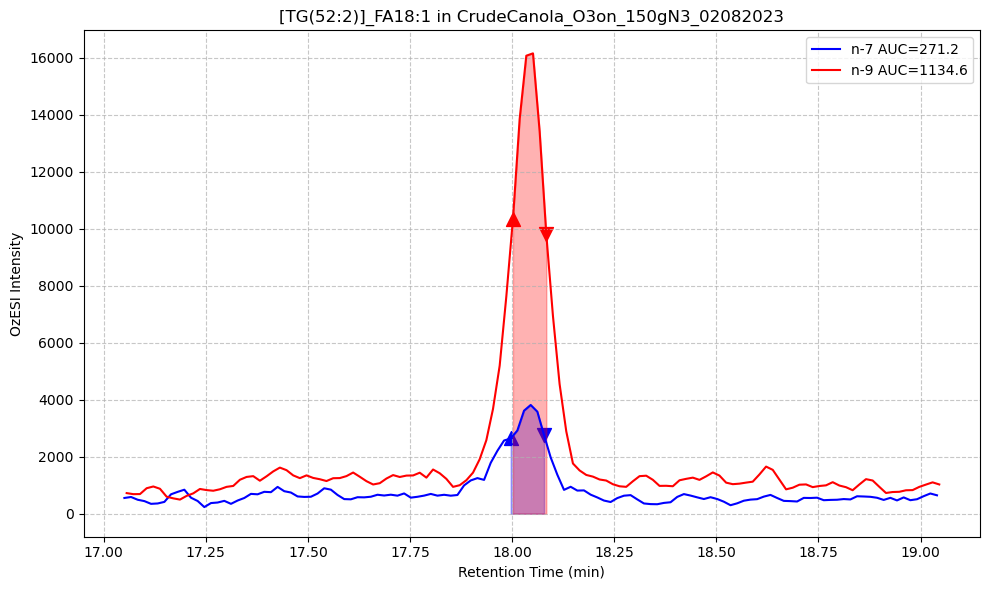

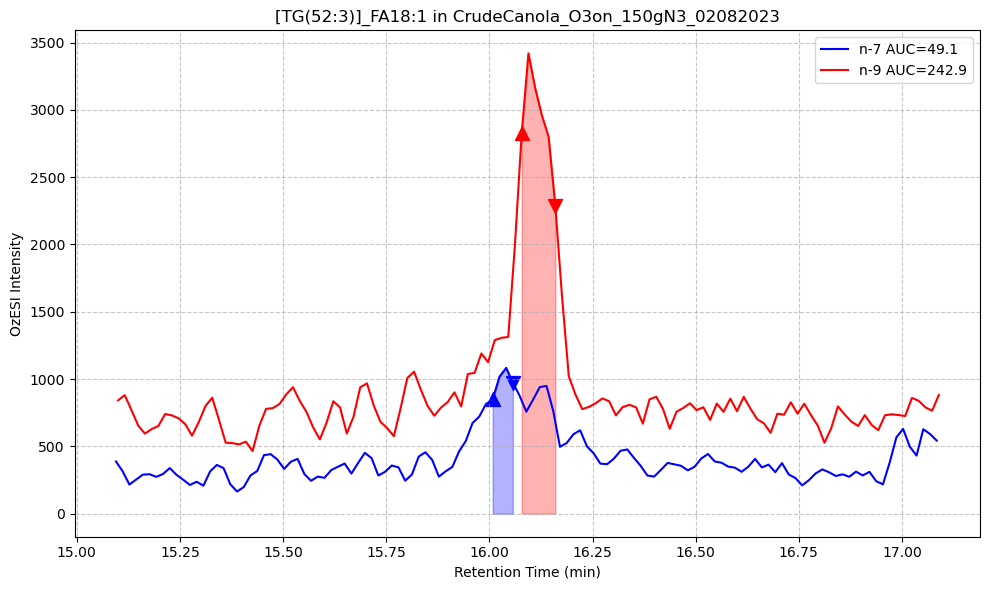

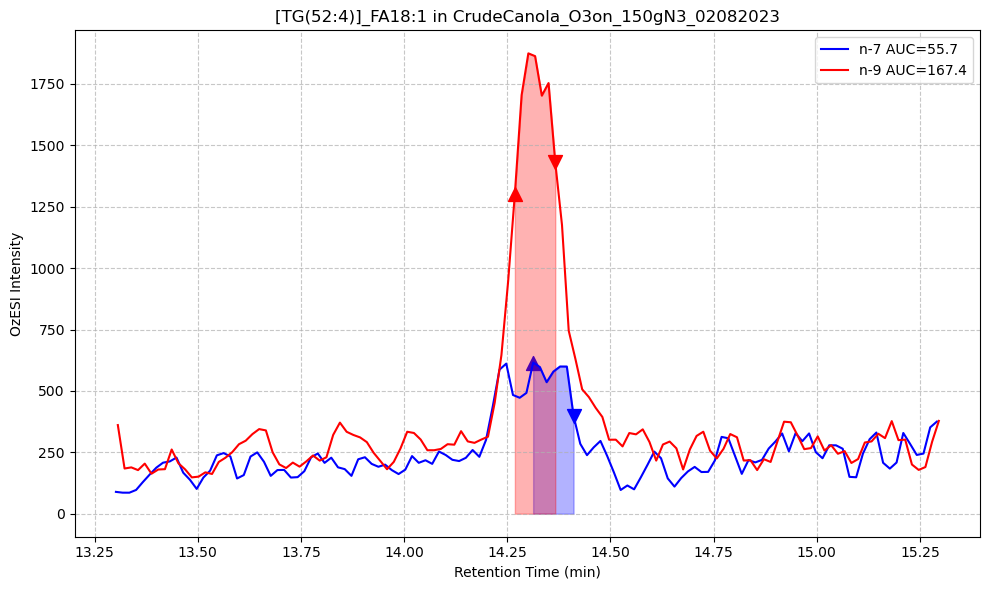

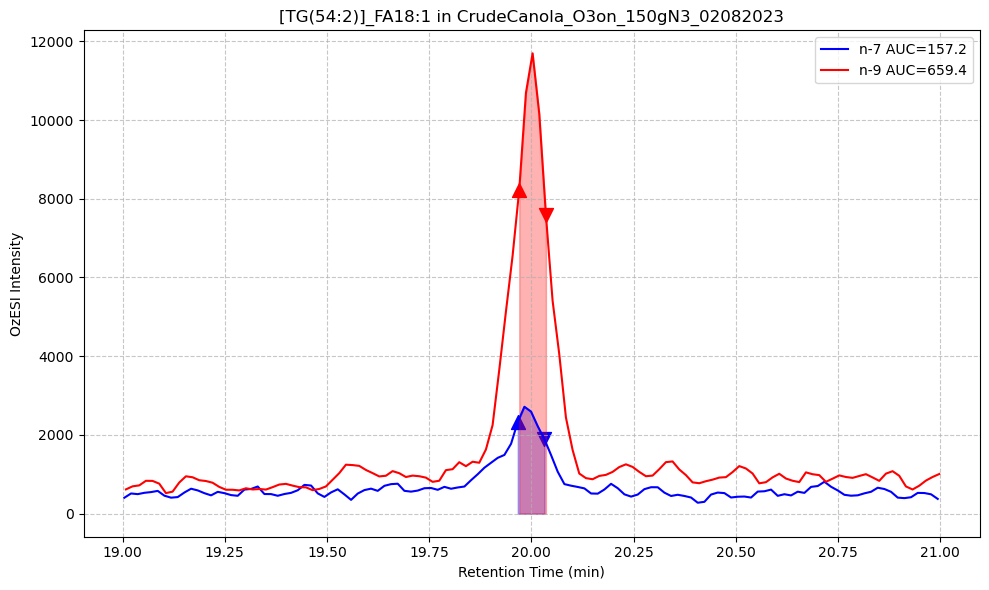

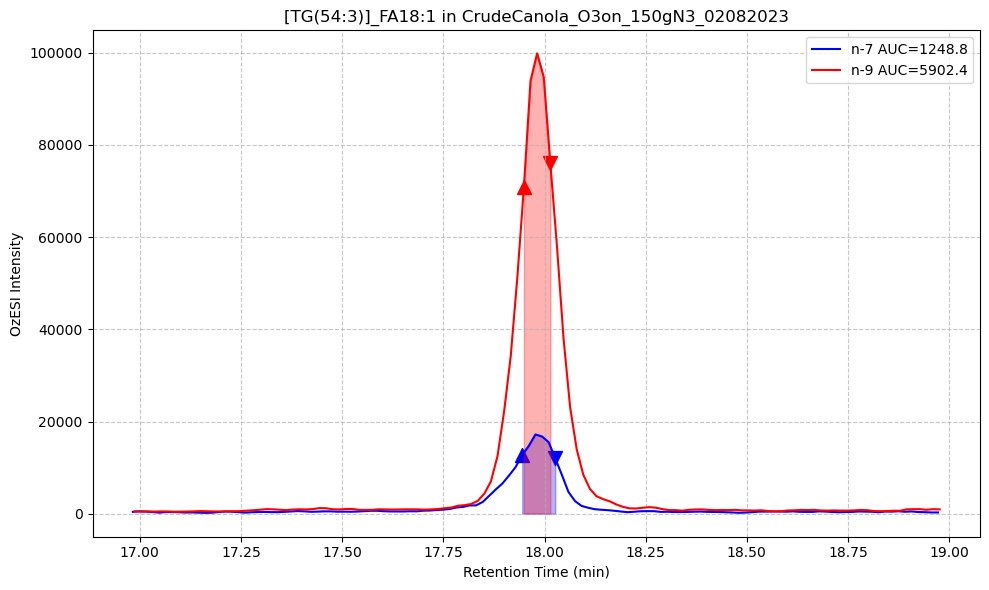

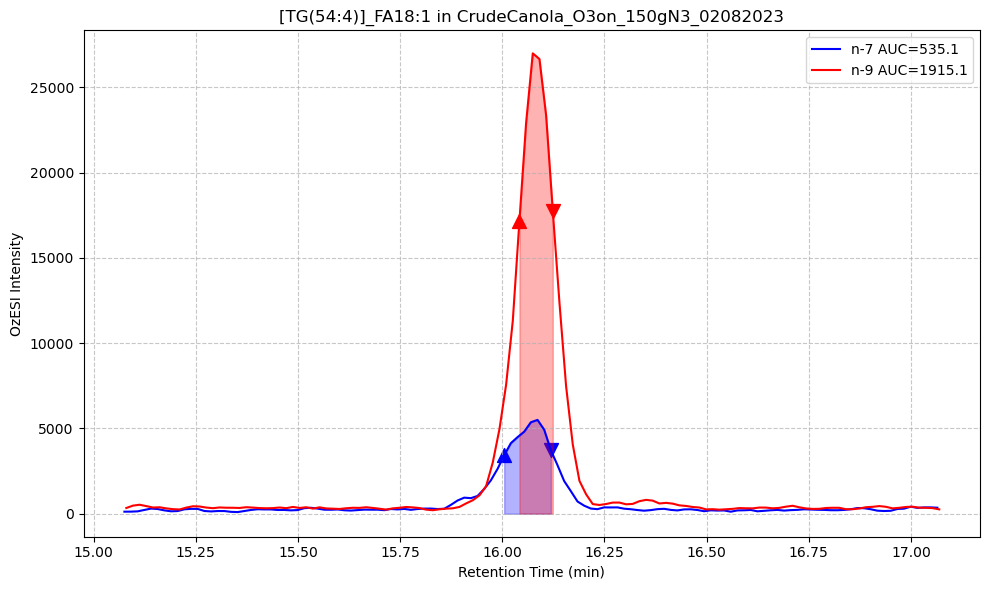

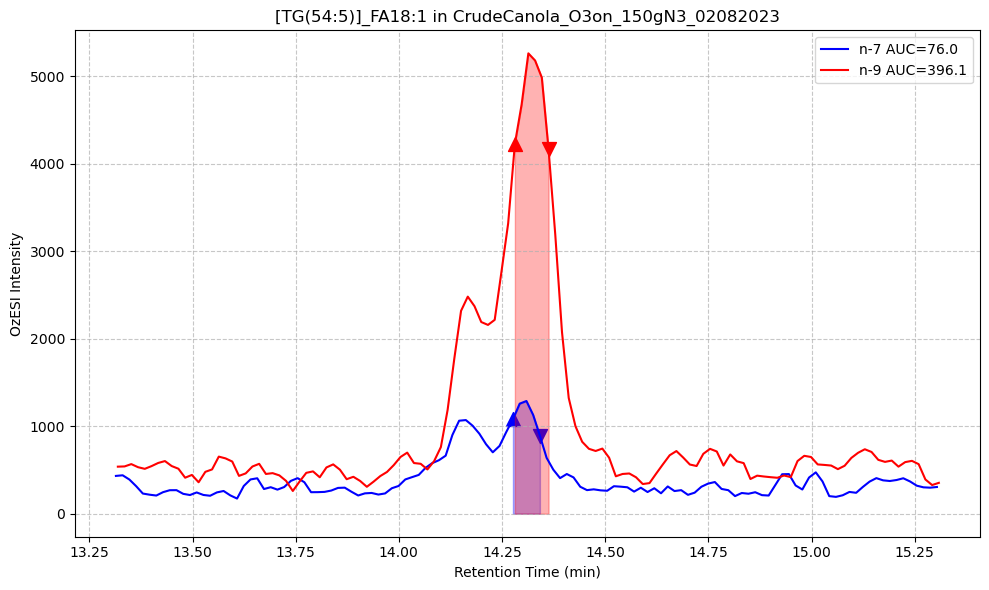

In [35]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.signal import savgol_filter
def find_inflection_bounds(rt, intensity, smoothing_window=7, polyorder=2):
    smoothed = savgol_filter(intensity, smoothing_window, polyorder)
    first_deriv = np.gradient(smoothed, rt)
    second_deriv = np.gradient(first_deriv, rt)
    peak_idx = np.argmax(smoothed)

    left_idx, right_idx = 0, len(rt) - 1
    for i in range(peak_idx - 1, 0, -1):
        if second_deriv[i - 1] * second_deriv[i] < 0:
            left_idx = i
            break
    for i in range(peak_idx + 1, len(rt) - 1):
        if second_deriv[i] * second_deriv[i + 1] < 0:
            right_idx = i
            break
    return left_idx, right_idx, smoothed

def process_single_lipid(lipid_df, lipid, sample_id, param_dict, show_plot=True):
    entry = {'Lipid': lipid}

    plt.figure(figsize=(10, 6)) if show_plot else None

    for pos in ['n-7', 'n-9']:
        pos_df = lipid_df[lipid_df['db_pos'] == pos].sort_values(by='Retention_Time')
        if pos_df.empty:
            entry[f'{pos}_AUC'] = np.nan
            continue

        rt = pos_df['Retention_Time'].values
        intensity = pos_df['OzESI_Intensity'].values

        # Get params from dict or use default
        key = (lipid, pos, sample_id)
        params = param_dict.get(key, {"smoothing_window": 7, "polyorder": 2})
        smoothing_window = params.get("smoothing_window", 7)
        polyorder = params.get("polyorder", 2)

        left_idx, right_idx, smoothed = find_inflection_bounds(rt, intensity, smoothing_window, polyorder)
        rt_peak = rt[left_idx:right_idx+1]
        int_peak = intensity[left_idx:right_idx+1]
        area = np.trapz(int_peak, rt_peak)
        entry[f'{pos}_AUC'] = area

        if show_plot:
            color = 'blue' if pos == 'n-7' else 'red'
            plt.plot(rt, intensity, label=f"{pos} AUC={area:.1f}", color=color)
            plt.fill_between(rt_peak, int_peak, color=color, alpha=0.3)
            plt.scatter(rt[left_idx], intensity[left_idx], color=color, marker='^', s=100)
            plt.scatter(rt[right_idx], intensity[right_idx], color=color, marker='v', s=100)

    if not np.isnan(entry.get('n-7_AUC', np.nan)) and not np.isnan(entry.get('n-9_AUC', np.nan)):
        entry['n7_n9_ratio'] = entry['n-7_AUC'] / entry['n-9_AUC'] if entry['n-9_AUC'] != 0 else np.nan
    else:
        entry['n7_n9_ratio'] = np.nan

    if show_plot:
        plt.title(f"{lipid} in {sample_id}")
        plt.xlabel("Retention Time (min)")
        plt.ylabel("OzESI Intensity")
        plt.legend()
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.tight_layout()
        plt.show()

    return entry

def analyze_lipids_with_custom_params(df, sample_id, param_dict, show_plots=True):
    lipid_list = df[df['Sample_ID'] == sample_id]['Lipid'].unique()
    results = []

    for lipid in lipid_list:
        lipid_df = df[(df['Lipid'] == lipid) & (df['Sample_ID'] == sample_id)]
        entry = process_single_lipid(lipid_df, lipid, sample_id, param_dict, show_plot=show_plots)
        results.append(entry)

    return pd.DataFrame(results)

custom_params = {
    ("[TG(52:2)]_FA18:1", "n-7", "CrudeCanola_O3on_150gN3_02082023"): {"smoothing_window": 9, "polyorder": 2},
    ("[TG(52:2)]_FA18:1", "n-9", "CrudeCanola_O3on_150gN3_02082023"): {"smoothing_window": 11, "polyorder": 3},
}

summary_df = analyze_lipids_with_custom_params(
    df_canola_lipids,
    "CrudeCanola_O3on_150gN3_02082023",
    param_dict=custom_params,
    show_plots=True
)


# Peak Area

# plot parent ions

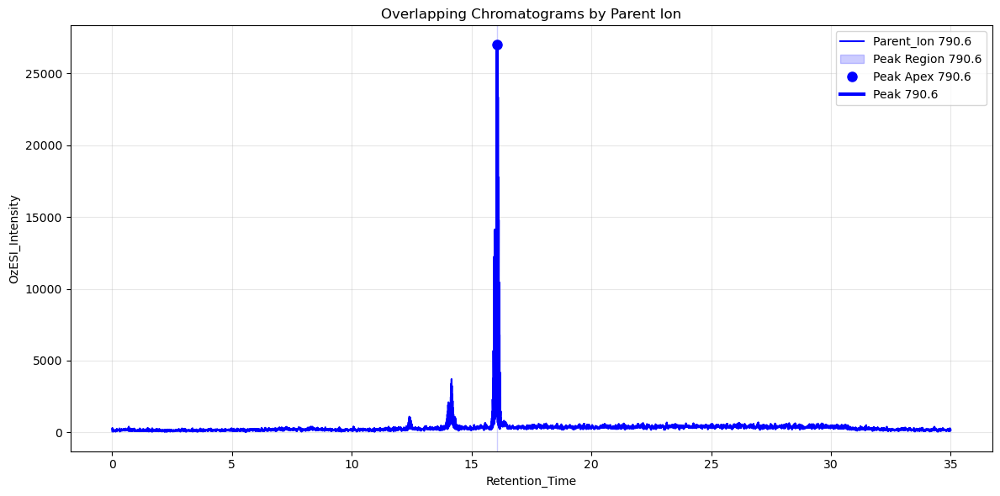

In [9]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from scipy.signal import find_peaks, peak_widths

def plot_overlapping_chromatograms(df, parent_ions, 
                                 intensity_column='OzESI_Intensity', 
                                 retention_column='Retention_Time', 
                                 colors=None,
                                 **peak_kwargs):
    """
    Plots overlapping chromatograms for multiple Parent_Ion values with peaks highlighted.
    
    Parameters:
        df (pd.DataFrame): DataFrame containing the chromatogram data
        parent_ions (list): List of Parent_Ion values to plot
        intensity_column (str): Column name for the intensity values
        retention_column (str): Column name for the retention time values
        colors (list): Optional list of colors for each Parent_Ion
        **peak_kwargs: Additional keyword arguments for peak finding
    """
    plt.figure(figsize=(12, 6))
    
    if colors is None:
        colors = ['blue', 'red']  # default colors
    
    for parent_ion, color in zip(parent_ions, colors):
        # Filter the DataFrame for the specified Parent_Ion
        ion_df = df[df['Parent_Ion'] == parent_ion].copy()
        if ion_df.empty:
            print(f"No data found for Parent_Ion: {parent_ion}")
            continue

        # Sort by retention time
        ion_df.sort_values(by=retention_column, inplace=True)
        retention_times = ion_df[retention_column].values
        intensities = ion_df[intensity_column].values

        # Plot the chromatogram
        plt.plot(retention_times, intensities, 
                label=f'Parent_Ion {parent_ion}', 
                color=color, 
                linewidth=1.5)
        
        # Detect peaks
        peaks, properties = find_peaks(intensities, **peak_kwargs)
        if len(peaks) == 0:
            print(f"No peaks detected for Parent_Ion {parent_ion}")
            continue

        # Find highest peak
        highest_peak_index = peaks[np.argmax(intensities[peaks])]
        
        # Calculate peak widths
        widths_results = peak_widths(intensities, [highest_peak_index], rel_height=0.3)
        left_ip = widths_results[2][0]
        right_ip = widths_results[3][0]
        
        # Convert to retention times
        left_rt = np.interp(left_ip, np.arange(len(retention_times)), retention_times)
        right_rt = np.interp(right_ip, np.arange(len(retention_times)), retention_times)
        
        # Highlight peak region
        plt.axvspan(left_rt, right_rt, 
                   color=color, 
                   alpha=0.2, 
                   label=f'Peak Region {parent_ion}')
        
        # Mark peak apex
        apex_rt = retention_times[highest_peak_index]
        apex_intensity = intensities[highest_peak_index]
        plt.plot(apex_rt, apex_intensity, 
                'o', 
                color=color, 
                markersize=8, 
                label=f'Peak Apex {parent_ion}')
        
        # Highlight peak area
        peak_mask = (retention_times >= left_rt) & (retention_times <= right_rt)
        if np.any(peak_mask):
            plt.plot(retention_times[peak_mask], intensities[peak_mask],
                    color=color, 
                    linewidth=3, 
                    label=f'Peak {parent_ion}')

    plt.xlabel(retention_column)
    plt.ylabel(intensity_column)
    plt.title('Overlapping Chromatograms by Parent Ion')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

# Example usage:
parent_ions = [ 790.6]
colors = ['blue', 'red']
plot_overlapping_chromatograms(df_OzESI_matched, 
                             parent_ions=parent_ions, 
                             colors=colors,
                             height=100)

# gpt again try

# update code with RT windows

In [10]:
import pandas as pd
import numpy as np
from scipy.signal import find_peaks, peak_widths

# Make a deep copy and sort by retention time.
df_OzESI_matched_sorted = df_OzESI_matched.copy(deep=True)
df_OzESI_matched_sorted = df_OzESI_matched_sorted.sort_values('Retention_Time').reset_index(drop=True)

def process_peaks_for_group(group, rel_height=0.5, **find_peaks_kwargs):
    """
    For one group (i.e. one Parent_Ion within one Sample_ID), detect peaks and compute:
      - peak_area: the area under the peak (integrated using np.trapz)
      - peak_start: the interpolated retention time at the left boundary of the peak
      - peak_stop:  the interpolated retention time at the right boundary of the peak
      - peak_middle: the interpolated retention time at the peak apex

    Additionally, we constrain the left and right boundaries to be no more than 0.6
    away from the peak center.
    """
    # Sort the data by retention time
    group = group.sort_values('Retention_Time').copy()
    
    # Get the retention time and intensity arrays
    rt = group['Retention_Time'].values
    intensity = group['OzESI_Intensity'].values
    
    # Detect peaks in the intensity data
    peaks, properties = find_peaks(intensity, **find_peaks_kwargs)
    
    # Calculate the peak widths at the given relative height (default is 95% of the peak height)
    widths, width_heights, left_ips, right_ips = peak_widths(intensity, peaks, rel_height=rel_height)
    
    # Create new columns (initialize to NaN)
    group['peak_area'] = np.nan
    group['peak_start'] = np.nan
    group['peak_stop'] = np.nan
    group['peak_middle'] = np.nan

    # Process each detected peak
    for i, peak_idx in enumerate(peaks):
        # Use interpolation to convert fractional indices into retention times.
        left_rt = np.interp(left_ips[i], np.arange(len(rt)), rt)
        right_rt = np.interp(right_ips[i], np.arange(len(rt)), rt)
        peak_rt = np.interp(peak_idx, np.arange(len(rt)), rt)
        
        # --- Constrain boundaries to be at most 0.6 away from the peak middle ---
        if (peak_rt - left_rt) > 0.6:
            left_rt = peak_rt - 0.6
        if (right_rt - peak_rt) > 0.6:
            right_rt = peak_rt + 0.6

        # Determine indices corresponding to the (possibly adjusted) boundaries.
        # We use np.searchsorted because rt is sorted.
        left_index = np.searchsorted(rt, left_rt, side='left')
        right_index = np.searchsorted(rt, right_rt, side='right') - 1
        left_index = max(left_index, 0)
        right_index = min(right_index, len(rt) - 1)
        
        # Integration: use the retention times and intensity values from these indices.
        rt_segment = rt[left_index:right_index+1]
        intensity_segment = intensity[left_index:right_index+1]
        area = np.trapz(intensity_segment, rt_segment)
        
        # For all rows in this group that fall between the left and right boundaries,
        # assign the computed peak information.
        mask = (group['Retention_Time'] >= left_rt) & (group['Retention_Time'] <= right_rt)
        group.loc[mask, 'peak_area'] = area
        group.loc[mask, 'peak_start'] = left_rt
        group.loc[mask, 'peak_stop'] = right_rt
        group.loc[mask, 'peak_middle'] = peak_rt

    return group

def process_all_peaks(df, rel_height=0.5, **find_peaks_kwargs):
    """
    Processes the entire DataFrame by grouping on both Parent_Ion and Sample_ID,
    so that each chromatogram (from each sample) is processed separately.
    """
    return df.groupby(['Parent_Ion', 'Sample_ID'], group_keys=False).apply(
        process_peaks_for_group, rel_height=rel_height, **find_peaks_kwargs
    )

# --- Example usage ---
# Ensure that df_OzESI_matched_sorted is your DataFrame that has the columns:
# 'Parent_Ion', 'OzESI_Intensity', 'Retention_Time', and 'Sample_ID'
#
# Optionally, adjust the peak detection parameters.
# For example:
# processed_df = process_all_peaks(df_OzESI_matched_sorted, rel_height=0.5, prominence=1000)
#
# Or run with default settings:
processed_df = process_all_peaks(df_OzESI_matched_sorted)

# Now the DataFrame processed_df includes new columns:
# 'peak_area', 'peak_start', 'peak_stop', and 'peak_middle'
print(processed_df.head())


    Class Lipid  OzESI_Intensity  Parent_Ion  Product_Ion  Retention_Time  \
103   NaN   NaN       190.400009       760.6      571.596        0.015933   
208   NaN   NaN       147.420013       760.6      571.596        0.032233   
314   NaN   NaN       153.620010       760.6      571.596        0.048550   
417   NaN   NaN       200.080017       760.6      571.596        0.064850   
522   NaN   NaN       206.900009       760.6      571.596        0.081167   

                            Sample_ID        Transition  peak_area  \
103  CrudeCanola_O3on_150gN3_02082023  760.6 -> 571.596        NaN   
208  CrudeCanola_O3on_150gN3_02082023  760.6 -> 571.596        NaN   
314  CrudeCanola_O3on_150gN3_02082023  760.6 -> 571.596        NaN   
417  CrudeCanola_O3on_150gN3_02082023  760.6 -> 571.596   6.619888   
522  CrudeCanola_O3on_150gN3_02082023  760.6 -> 571.596   6.619888   

     peak_start  peak_stop  peak_middle  
103         NaN        NaN          NaN  
208         NaN        NaN      

# update peak area to be more like masshunter

In [11]:
import pandas as pd
import numpy as np
from scipy.signal import find_peaks, peak_widths

# Make a deep copy and sort by retention time.
df_OzESI_matched_sorted = df_OzESI_matched.copy(deep=True)
df_OzESI_matched_sorted = df_OzESI_matched_sorted.sort_values('Retention_Time').reset_index(drop=True)

def process_peaks_for_group(group, rel_height=0.5, **find_peaks_kwargs):
    """
    For one group (i.e. one Parent_Ion within one Sample_ID), detect peaks and compute:
      - peak_area: the area under the peak (after baseline subtraction)
      - peak_start: the interpolated retention time at the left baseline (valley)
      - peak_stop:  the interpolated retention time at the right baseline (valley)
      - peak_middle: the interpolated retention time at the peak apex

    The algorithm works as follows:
      1. Detect peaks in the intensity signal.
      2. Also detect valleys (local minima) by finding peaks in the negative signal.
      3. For each peak, find the closest valley before and after the peak.
         If a valley is not found on one side, fall back to the left/right boundaries
         determined via peak_widths.
      4. Optionally constrain the baseline boundaries to be no more than 0.6 (time units)
         away from the peak apex.
      5. Compute a linear baseline between the two baseline points, subtract it from the 
         original intensity, and integrate (using np.trapz) the corrected intensity over the 
         retention time interval.
    """
    # Sort the data by retention time
    group = group.sort_values('Retention_Time').copy()
    
    # Get the retention time and intensity arrays
    rt = group['Retention_Time'].values
    intensity = group['OzESI_Intensity'].values
    
    # Detect peaks in the intensity data
    peaks, properties = find_peaks(intensity, **find_peaks_kwargs)
    
    # Also detect valleys (local minima) by finding peaks in the negative intensity signal
    valleys, _ = find_peaks(-intensity)
    
    # Use peak_widths to get an initial estimate of the peak boundaries (as fallback)
    widths, width_heights, left_ips, right_ips = peak_widths(intensity, peaks, rel_height=rel_height)
    
    # Initialize new columns with NaN
    group['peak_area'] = np.nan
    group['peak_start'] = np.nan
    group['peak_stop'] = np.nan
    group['peak_middle'] = np.nan

    # Process each detected peak
    for i, peak_idx in enumerate(peaks):
        # Find left valley: the last valley index before the peak
        left_valleys = valleys[valleys < peak_idx]
        if len(left_valleys) > 0:
            left_valley_idx = left_valleys[-1]
        else:
            left_valley_idx = None

        # Find right valley: the first valley index after the peak
        right_valleys = valleys[valleys > peak_idx]
        if len(right_valleys) > 0:
            right_valley_idx = right_valleys[0]
        else:
            right_valley_idx = None

        # Determine baseline boundary positions and intensities:
        if left_valley_idx is not None:
            left_baseline_rt = rt[left_valley_idx]
            left_baseline_intensity = intensity[left_valley_idx]
        else:
            # Fallback to peak_widths estimate (using interpolation)
            left_baseline_rt = np.interp(left_ips[i], np.arange(len(rt)), rt)
            left_baseline_intensity = np.interp(left_ips[i], np.arange(len(rt)), intensity)
        
        if right_valley_idx is not None:
            right_baseline_rt = rt[right_valley_idx]
            right_baseline_intensity = intensity[right_valley_idx]
        else:
            right_baseline_rt = np.interp(right_ips[i], np.arange(len(rt)), rt)
            right_baseline_intensity = np.interp(right_ips[i], np.arange(len(rt)), intensity)
        
        # Determine the peak apex retention time using interpolation.
        peak_rt = np.interp(peak_idx, np.arange(len(rt)), rt)
        
        # Optionally constrain the baseline boundaries to be no more than 0.6 away from the peak apex.
        left_rt = left_baseline_rt
        right_rt = right_baseline_rt
        if (peak_rt - left_rt) > 0.6:
            left_rt = peak_rt - 0.6
        if (right_rt - peak_rt) > 0.6:
            right_rt = peak_rt + 0.6

        # Find the indices corresponding to these boundaries.
        left_index = np.searchsorted(rt, left_rt, side='left')
        right_index = np.searchsorted(rt, right_rt, side='right') - 1
        left_index = max(left_index, 0)
        right_index = min(right_index, len(rt) - 1)
        
        # Extract the segment for integration.
        rt_segment = rt[left_index:right_index+1]
        intensity_segment = intensity[left_index:right_index+1]
        
        # Compute the baseline as a linear interpolation between the two baseline points.
        # Use the baseline intensities found (or the fallback ones)
        baseline = np.interp(rt_segment, [left_rt, right_rt], [left_baseline_intensity, right_baseline_intensity])
        
        # Subtract the baseline from the intensity to get the corrected peak signal.
        corrected_intensity = intensity_segment - baseline
        # Set any negative values (which can occur due to noise) to zero.
        corrected_intensity[corrected_intensity < 0] = 0
        
        # Integrate the corrected intensity using the trapezoidal rule.
        area = np.trapz(corrected_intensity, rt_segment)
        
        # For all rows in this group between left_rt and right_rt, assign the computed values.
        mask = (group['Retention_Time'] >= left_rt) & (group['Retention_Time'] <= right_rt)
        group.loc[mask, 'peak_area'] = area
        group.loc[mask, 'peak_start'] = left_rt
        group.loc[mask, 'peak_stop'] = right_rt
        group.loc[mask, 'peak_middle'] = peak_rt

    return group

def process_all_peaks(df, rel_height=0.5, **find_peaks_kwargs):
    """
    Processes the entire DataFrame by grouping on both Parent_Ion and Sample_ID,
    so that each chromatogram (from each sample) is processed separately.
    """
    return df.groupby(['Parent_Ion', 'Sample_ID'], group_keys=False).apply(
        process_peaks_for_group, rel_height=rel_height, **find_peaks_kwargs
    )

# --- Example usage ---
# Ensure that df_OzESI_matched_sorted is your DataFrame with the columns:
# 'Parent_Ion', 'OzESI_Intensity', 'Retention_Time', and 'Sample_ID'
#
# Optionally, you can adjust the peak detection parameters (e.g., prominence, height, etc.)
# For example:
# processed_df = process_all_peaks(df_OzESI_matched_sorted, rel_height=0.5, prominence=1000)
#
# Or run with default settings:
processed_df = process_all_peaks(df_OzESI_matched_sorted)

# Now processed_df includes new columns:
# 'peak_area', 'peak_start', 'peak_stop', and 'peak_middle'
print(processed_df.head())


    Class Lipid  OzESI_Intensity  Parent_Ion  Product_Ion  Retention_Time  \
103   NaN   NaN       190.400009       760.6      571.596        0.015933   
208   NaN   NaN       147.420013       760.6      571.596        0.032233   
314   NaN   NaN       153.620010       760.6      571.596        0.048550   
417   NaN   NaN       200.080017       760.6      571.596        0.064850   
522   NaN   NaN       206.900009       760.6      571.596        0.081167   

                            Sample_ID        Transition  peak_area  \
103  CrudeCanola_O3on_150gN3_02082023  760.6 -> 571.596        NaN   
208  CrudeCanola_O3on_150gN3_02082023  760.6 -> 571.596   6.067026   
314  CrudeCanola_O3on_150gN3_02082023  760.6 -> 571.596   6.067026   
417  CrudeCanola_O3on_150gN3_02082023  760.6 -> 571.596   6.067026   
522  CrudeCanola_O3on_150gN3_02082023  760.6 -> 571.596   6.067026   

     peak_start  peak_stop  peak_middle  
103         NaN        NaN          NaN  
208    0.032233     0.1464     0

# updated area v2

In [12]:
import pandas as pd
import numpy as np
from scipy.signal import find_peaks, peak_widths, savgol_filter
from scipy.interpolate import UnivariateSpline

# Make a deep copy and sort by retention time.
df_OzESI_matched_sorted = df_OzESI_matched.copy(deep=True)
df_OzESI_matched_sorted = df_OzESI_matched_sorted.sort_values('Retention_Time').reset_index(drop=True)

def detect_baseline(rt, intensity, peaks, smoothing_factor=0.3):
    """
    Detect baseline points (valleys) between peaks and fit a spline baseline.
    Similar to Agilent MassHunter's baseline detection algorithm.
    
    Parameters:
    -----------
    rt : array
        Retention time values
    intensity : array
        Intensity values
    peaks : array
        Indices of detected peaks
    smoothing_factor : float
        Controls the smoothness of the baseline (lower = more fitted to valleys)
        
    Returns:
    --------
    baseline : array
        The estimated baseline values corresponding to each rt point
    """
    # If no peaks found, return a flat baseline at the minimum intensity
    if len(peaks) == 0:
        return np.ones_like(intensity) * np.min(intensity)
    
    # Find potential valley points (local minima)
    # Add points at the beginning and end of chromatogram
    valley_candidates = []
    valley_candidates.append(0)  # Start of chromatogram
    
    # Find valleys between peaks
    for i in range(len(peaks)-1):
        # Look for minimum point between consecutive peaks
        start_idx = peaks[i]
        end_idx = peaks[i+1]
        if start_idx < end_idx:
            min_idx = start_idx + np.argmin(intensity[start_idx:end_idx])
            valley_candidates.append(min_idx)
    
    valley_candidates.append(len(intensity)-1)  # End of chromatogram
    
    # Get coordinates of valley points
    valley_rt = rt[valley_candidates]
    valley_intensity = intensity[valley_candidates]
    
    # Fit a spline through the valley points
    # Use smoothing factor to control how closely the baseline follows the valleys
    if len(valley_rt) >= 4:  # Need at least 4 points for cubic spline
        baseline_spline = UnivariateSpline(valley_rt, valley_intensity, s=smoothing_factor*len(valley_rt))
        baseline = baseline_spline(rt)
    else:
        # Fallback to linear interpolation if too few points
        baseline = np.interp(rt, valley_rt, valley_intensity)
    
    # Ensure baseline doesn't go above the signal (Agilent-like constraint)
    for i in range(len(baseline)):
        if baseline[i] > intensity[i]:
            baseline[i] = intensity[i]
    
    return baseline

def process_peaks_for_group(group, rel_height=0.5, min_peak_height=100, 
                            smoothing_window=5, baseline_smoothing=0.3, **find_peaks_kwargs):
    """
    For one group (i.e. one Parent_Ion within one Sample_ID), detect peaks using 
    MassHunter-like approach:
    1. Apply smoothing to reduce noise
    2. Find initial peaks
    3. Detect baseline/valleys
    4. Subtract baseline
    5. Recalculate peak properties on baseline-corrected data
    6. Integrate the area over the entire peak
    
    Returns group with added columns:
    - peak_area: integrated area above baseline
    - peak_start: retention time at left boundary
    - peak_stop: retention time at right boundary 
    - peak_middle: retention time at peak apex
    - baseline: estimated baseline value
    - corrected_intensity: intensity after baseline subtraction
    """
    # Sort the data by retention time
    group = group.sort_values('Retention_Time').copy()
    
    # Get the retention time and intensity arrays
    rt = group['Retention_Time'].values
    intensity = group['OzESI_Intensity'].values
    
    # 1. Apply Savitzky-Golay smoothing (MassHunter-like)
    if len(intensity) > smoothing_window:
        smoothed_intensity = savgol_filter(intensity, smoothing_window, 2)
    else:
        smoothed_intensity = intensity.copy()
    
    # 2. Find initial peaks in the smoothed data
    peaks, properties = find_peaks(smoothed_intensity, 
                                  height=min_peak_height, 
                                  **find_peaks_kwargs)
    
    # 3. Detect baseline using valleys between peaks
    baseline = detect_baseline(rt, intensity, peaks, smoothing_factor=baseline_smoothing)
    
    # 4. Subtract baseline to get corrected intensity
    corrected_intensity = np.maximum(intensity - baseline, 0)  # Ensure non-negative
    
    # 5. Recalculate peak properties on baseline-corrected data
    if len(corrected_intensity) > smoothing_window:
        smoothed_corrected = savgol_filter(corrected_intensity, smoothing_window, 2)
    else:
        smoothed_corrected = corrected_intensity.copy()
    
    # Find peaks again on baseline-corrected data
    peaks, properties = find_peaks(smoothed_corrected, 
                                  height=min_peak_height/2,  # Lower threshold for corrected data
                                  **find_peaks_kwargs)
    
    # Calculate peak widths at the given relative height
    widths, width_heights, left_ips, right_ips = peak_widths(smoothed_corrected, 
                                                            peaks, 
                                                            rel_height=rel_height)
    
    # Create new columns
    group['baseline'] = baseline
    group['corrected_intensity'] = corrected_intensity
    group['peak_area'] = np.nan
    group['peak_start'] = np.nan
    group['peak_stop'] = np.nan
    group['peak_middle'] = np.nan

    # Process each detected peak
    for i, peak_idx in enumerate(peaks):
        # Convert fractional indices to retention times
        left_rt = np.interp(left_ips[i], np.arange(len(rt)), rt)
        right_rt = np.interp(right_ips[i], np.arange(len(rt)), rt)
        peak_rt = rt[peak_idx]
        
        # MassHunter-like constraint: ensure reasonable peak width
        if (peak_rt - left_rt) > 0.6:
            left_rt = peak_rt - 0.6
        if (right_rt - peak_rt) > 0.6:
            right_rt = peak_rt + 0.6

        # Find indices corresponding to peak boundaries
        left_index = np.searchsorted(rt, left_rt, side='left')
        right_index = np.searchsorted(rt, right_rt, side='right') - 1
        left_index = max(left_index, 0)
        right_index = min(right_index, len(rt) - 1)
        
        # 6. Integration: use trapezoid rule on baseline-corrected data
        # This is more accurate than the previous approach
        rt_segment = rt[left_index:right_index+1]
        intensity_segment = corrected_intensity[left_index:right_index+1]
        
        # MassHunter-like area calculation: integrate only above baseline
        area = np.trapz(intensity_segment, rt_segment)
        
        # Apply peak information to all points within peak boundaries
        mask = (group['Retention_Time'] >= left_rt) & (group['Retention_Time'] <= right_rt)
        group.loc[mask, 'peak_area'] = area
        group.loc[mask, 'peak_start'] = left_rt
        group.loc[mask, 'peak_stop'] = right_rt
        group.loc[mask, 'peak_middle'] = peak_rt

    return group

def process_all_peaks(df, rel_height=0.5, min_peak_height=100, 
                      smoothing_window=5, baseline_smoothing=0.3, **find_peaks_kwargs):
    """
    Processes the entire DataFrame by grouping on both Parent_Ion and Sample_ID,
    so that each chromatogram (from each sample) is processed separately using
    MassHunter-like peak detection and integration.
    """
    return df.groupby(['Parent_Ion', 'Sample_ID'], group_keys=False).apply(
        process_peaks_for_group, 
        rel_height=rel_height,
        min_peak_height=min_peak_height,
        smoothing_window=smoothing_window,
        baseline_smoothing=baseline_smoothing,
        **find_peaks_kwargs
    )

# --- Example usage ---
# Process with default MassHunter-like settings
processed_df = process_all_peaks(
    df_OzESI_matched_sorted,
    rel_height=0.95,  # 95% of peak height for width determination (typical for MS data)
    min_peak_height=100,  # Minimum intensity threshold for peak detection
    prominence=500,  # Minimum peak prominence (how much it stands out)
    smoothing_window=5,  # Window size for Savitzky-Golay smoothing
    baseline_smoothing=0.3  # Controls baseline fitting (lower = more aggressive)
)

# The DataFrame now includes additional columns:
# - baseline: estimated baseline at each point
# - corrected_intensity: intensity after baseline subtraction
# - peak_area: integrated area above baseline for each detected peak
# - peak_start, peak_stop, peak_middle: peak boundaries and apex

print(processed_df[['Retention_Time', 'OzESI_Intensity', 'baseline', 
                   'corrected_intensity', 'peak_area', 'peak_start', 
                   'peak_stop', 'peak_middle']].head(10))

# Optional: visualize results for a specific parent ion and sample
def plot_results(df, parent_ion, sample_id):
    import matplotlib.pyplot as plt
    
    subset = df[(df['Parent_Ion'] == parent_ion) & (df['Sample_ID'] == sample_id)]
    subset = subset.sort_values('Retention_Time')
    
    plt.figure(figsize=(12, 6))
    
    # Original intensity
    plt.plot(subset['Retention_Time'], subset['OzESI_Intensity'], 
             'b-', label='Original Intensity')
    
    # Baseline
    plt.plot(subset['Retention_Time'], subset['baseline'], 
             'r--', label='Detected Baseline')
    
    # Corrected intensity
    plt.plot(subset['Retention_Time'], subset['corrected_intensity'], 
             'g-', label='Baseline-Corrected')
    
    # Mark peak boundaries and centers
    peak_rows = subset[subset['peak_area'].notna()].drop_duplicates(['peak_start', 'peak_stop'])
    
    for _, row in peak_rows.iterrows():
        plt.axvline(x=row['peak_start'], color='orange', linestyle=':', alpha=0.7)
        plt.axvline(x=row['peak_stop'], color='orange', linestyle=':', alpha=0.7)
        plt.axvline(x=row['peak_middle'], color='red', linestyle='-', alpha=0.5)
        
        # Annotate peak area
        plt.text(row['peak_middle'], 
                 subset['OzESI_Intensity'].max() * 0.7, 
                 f"Area: {row['peak_area']:.1f}", 
                 ha='center', bbox=dict(facecolor='white', alpha=0.7))
    
    plt.title(f'Parent Ion: {parent_ion}, Sample: {sample_id}')
    plt.xlabel('Retention Time')
    plt.ylabel('Intensity')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

# Example usage of the plotting function:
# plot_results(processed_df, parent_ion=YOUR_PARENT_ION, sample_id=YOUR_SAMPLE_ID)

/home/iyer95/.conda/envs/CLAW/lib/python3.7/site-packages/scipy/interpolate/fitpack2.py:280: UserWarning: 
The maximal number of iterations maxit (set to 20 by the program)
allowed for finding a smoothing spline with fp=s has been reached: s
too small.
There is an approximation returned but the corresponding weighted sum
of squared residuals does not satisfy the condition abs(fp-s)/s < tol.
  warnings.warn(message)


      Retention_Time  OzESI_Intensity    baseline  corrected_intensity  \
103         0.015933       190.400009  190.400009             0.000000   
208         0.032233       147.420013  147.420013             0.000000   
314         0.048550       153.620010  153.620010             0.000000   
417         0.064850       200.080017  189.944874            10.135143   
522         0.081167       206.900009  189.793059            17.106950   
627         0.097467       197.960007  189.641399             8.318608   
734         0.113783       145.920013  145.920013             0.000000   
838         0.130083        92.080009   92.080009             0.000000   
943         0.146400        60.760006   60.760006             0.000000   
1048        0.162700        87.000008   87.000008             0.000000   

      peak_area  peak_start  peak_stop  peak_middle  
103         NaN         NaN        NaN          NaN  
208         NaN         NaN        NaN          NaN  
314         NaN        

In [13]:
# sort by highest peak_area
processed_df.sort_values(by='peak_area', ascending=False, inplace=True)
# # sort by Retention_Time
processed_df.sort_values(by='Retention_Time', inplace=True)
# sort by peak area and then by Retention_Time
# processed_df.sort_values(by=['peak_area', 'Retention_Time'], ascending=[False, True], inplace=True)


# 14arp25 430pm


=== Analyzing Parent Ion: 792.8 → Product Ion: 575.6 | Sample: CrudeCanola_O3on_150gN3_02082023 ===
Peak RT (min)   Max Intensity   Approx. Area   
16.04           1026.47         199.88         


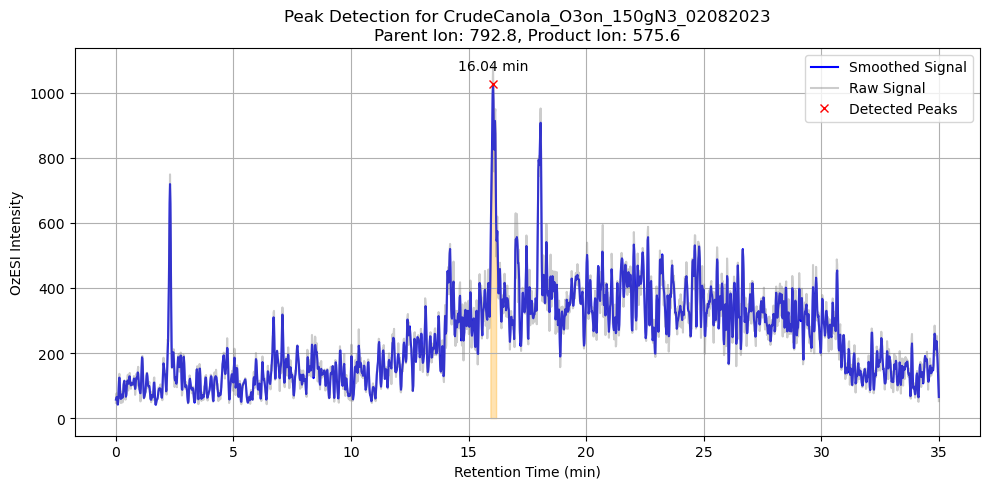


=== Analyzing Parent Ion: 764.8 → Product Ion: 575.6 | Sample: CrudeCanola_O3on_150gN3_02082023 ===
Peak RT (min)   Max Intensity   Approx. Area   
16.11           3272.10         308.37         


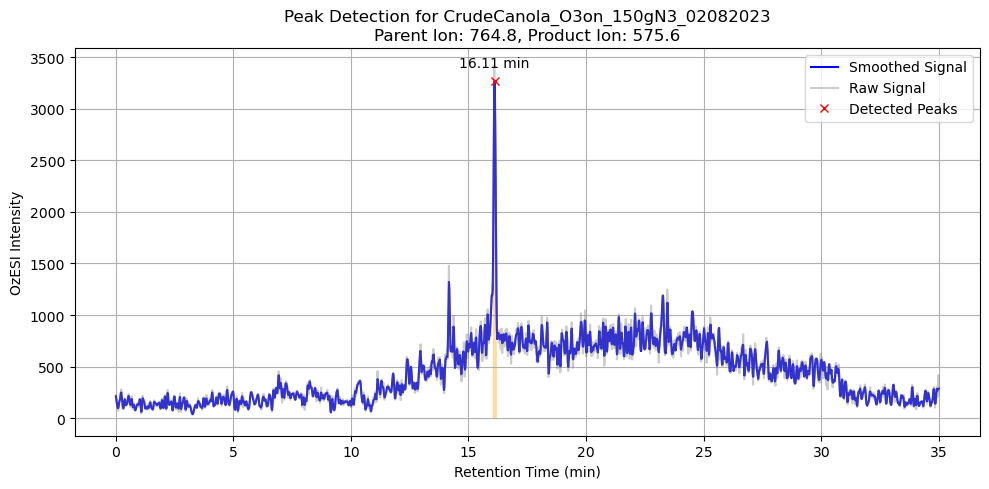

In [14]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.signal import find_peaks, peak_widths, savgol_filter

# Define parameters
target_parents = [792.8, 764.8]
target_product = 575.6
tolerance = 0.3
sample_id_filter = 'CrudeCanola_O3on_150gN3_02082023'
smoothing_window = 7  # Must be odd
poly_order = 2

for target_parent in target_parents:
    print(f"\n=== Analyzing Parent Ion: {target_parent} → Product Ion: {target_product} | Sample: {sample_id_filter} ===")
    
    # Filter rows by Parent, Product, and Sample ID
    matched_rows = processed_df[
        (processed_df['Sample_ID'] == sample_id_filter) &
        (processed_df['Parent_Ion'].between(target_parent - tolerance, target_parent + tolerance)) &
        (processed_df['Product_Ion'].between(target_product - tolerance, target_product + tolerance))
    ]

    if matched_rows.empty:
        print("No rows match the specified criteria.")
        continue

    matched_rows = matched_rows.sort_values(by='Retention_Time')
    rt = matched_rows['Retention_Time'].values
    raw_intensity = matched_rows['OzESI_Intensity'].values

    # Smooth intensity
    if len(raw_intensity) >= smoothing_window:
        intensity = savgol_filter(raw_intensity, smoothing_window, poly_order)
    else:
        intensity = raw_intensity

    # Dynamic thresholds
    height_threshold = 0.7 * max(intensity)
    prominence_threshold = 0.75 * max(intensity)

    # Find peaks
    peaks, properties = find_peaks(
        intensity,
        height=height_threshold,
        prominence=prominence_threshold,
        distance=3,
        width=1
    )

    # Peak widths (FWHM)
    results_half = peak_widths(intensity, peaks, rel_height=0.5)

    # Print peak data
    print(f"{'Peak RT (min)':<15} {'Max Intensity':<15} {'Approx. Area':<15}")
    for i, peak_idx in enumerate(peaks):
        peak_rt = rt[peak_idx]
        peak_intensity = intensity[peak_idx]
        left_idx = int(results_half[2][i])
        right_idx = int(results_half[3][i])
        rt_slice = rt[left_idx:right_idx+1]
        intensity_slice = intensity[left_idx:right_idx+1]
        peak_area = np.trapz(intensity_slice, rt_slice)
        print(f"{peak_rt:<15.2f} {peak_intensity:<15.2f} {peak_area:<15.2f}")

    # Plotting
    plt.figure(figsize=(10, 5))
    plt.plot(rt, intensity, label='Smoothed Signal', color='blue')
    plt.plot(rt, raw_intensity, label='Raw Signal', color='gray', alpha=0.4)
    plt.plot(rt[peaks], intensity[peaks], "rx", label='Detected Peaks')

    # Shade peaks
    for i in range(len(peaks)):
        left_idx = int(results_half[2][i])
        right_idx = int(results_half[3][i])
        rt_slice = rt[left_idx:right_idx+1]
        intensity_slice = intensity[left_idx:right_idx+1]
        plt.fill_between(rt_slice, intensity_slice, alpha=0.3, color='orange')

    # Annotate peaks
    for peak in peaks:
        plt.annotate(f'{rt[peak]:.2f} min', (rt[peak], intensity[peak]), textcoords="offset points", xytext=(0,10), ha='center')

    plt.title(f'Peak Detection for {sample_id_filter}\nParent Ion: {target_parent}, Product Ion: {target_product}')
    plt.xlabel('Retention Time (min)')
    plt.ylabel('OzESI Intensity')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()



=== [TG(52:2)]_FA18:1 | n-7 | Precursor: 794.8 → Product: 577.596 | RT ~ 18.05 ===
Peak RT (min)   Max Intensity   Approx. Area   
18.05           3699.26         171.29         


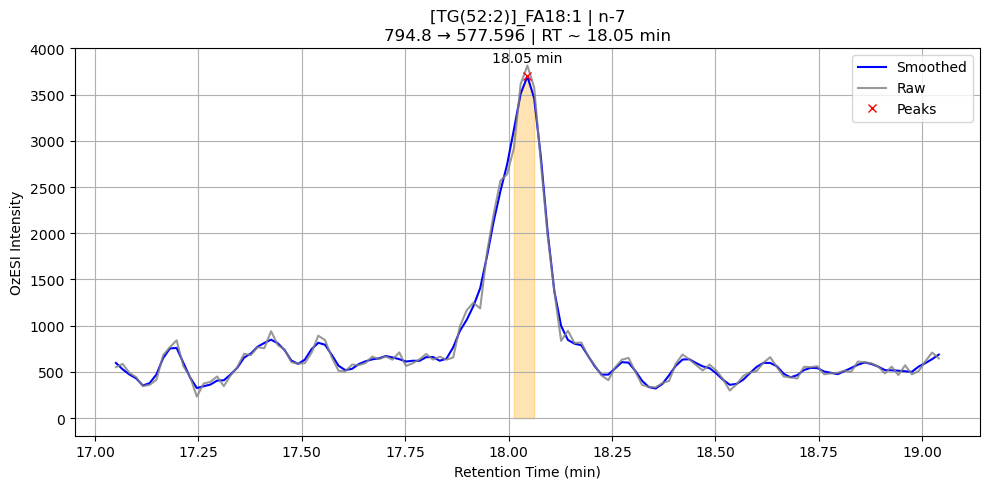


=== [TG(52:2)]_FA18:1 | n-9 | Precursor: 766.8 → Product: 577.596 | RT ~ 18.05 ===
Peak RT (min)   Max Intensity   Approx. Area   
18.03           15663.85        694.72         


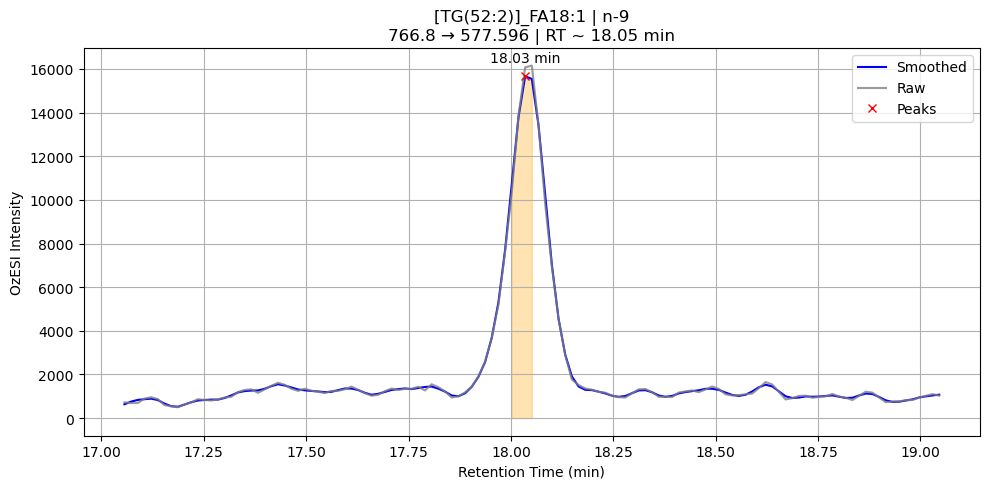


=== [TG(52:3)]_FA18:1 | n-7 | Precursor: 792.8 → Product: 575.596 | RT ~ 16.09 ===
Peak RT (min)   Max Intensity   Approx. Area   
16.04           1026.47         48.31          


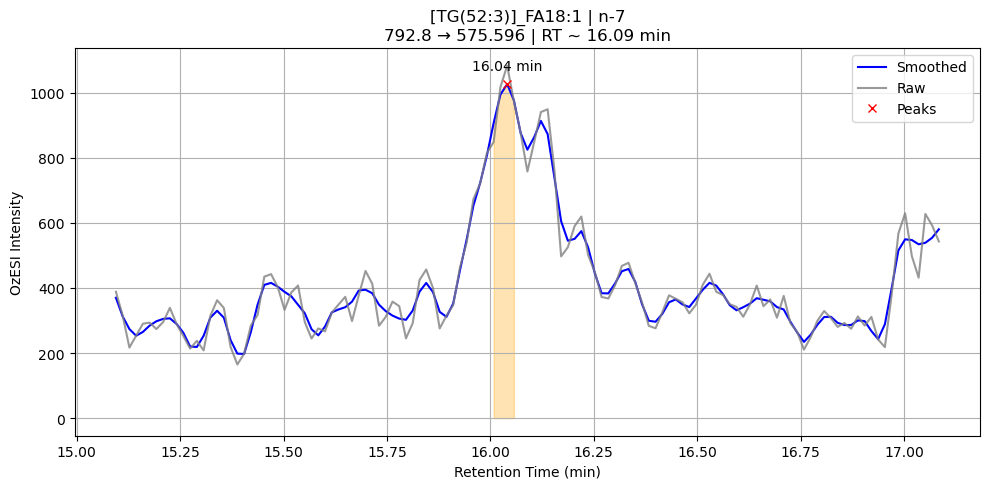


=== [TG(52:3)]_FA18:1 | n-9 | Precursor: 764.8 → Product: 575.596 | RT ~ 16.09 ===
Peak RT (min)   Max Intensity   Approx. Area   
16.11           3272.10         152.35         


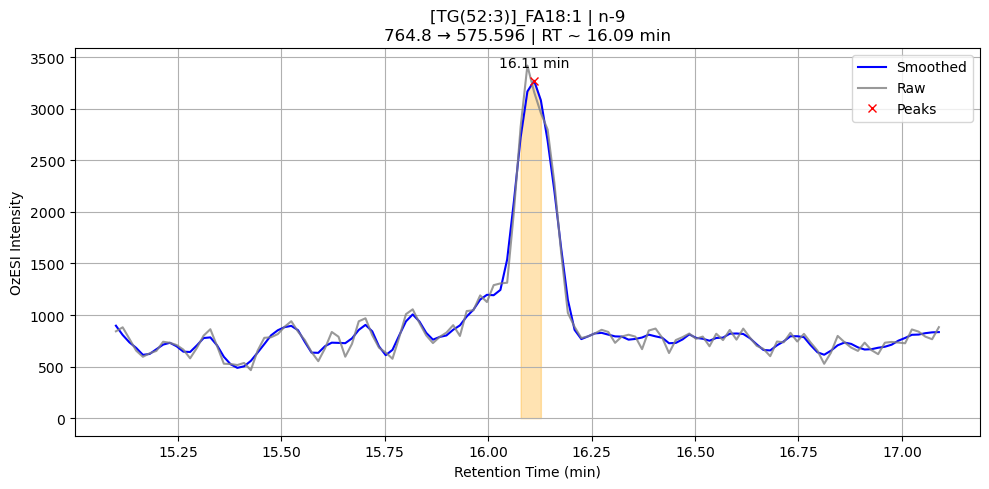


=== [TG(52:4)]_FA18:1 | n-7 | Precursor: 790.8 → Product: 573.596 | RT ~ 14.3 ===
Peak RT (min)   Max Intensity   Approx. Area   
14.36           591.52          64.18          


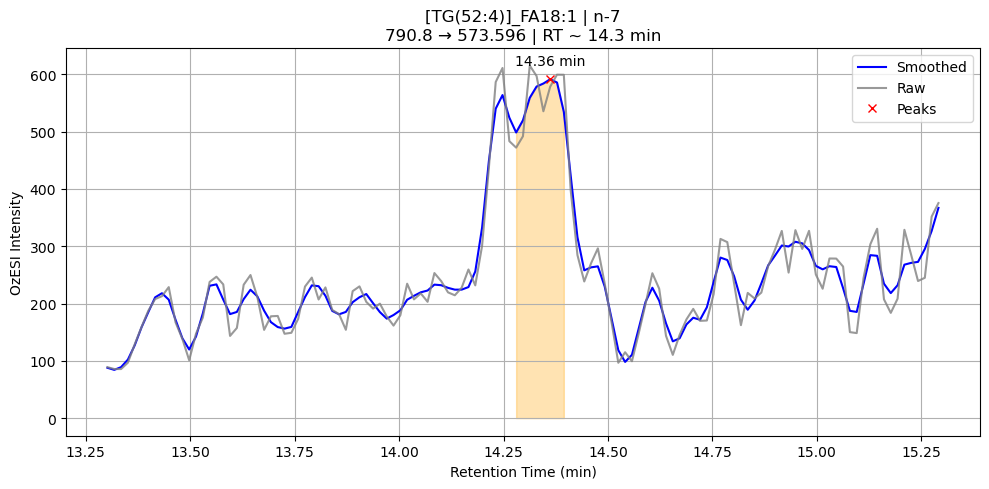


=== [TG(52:4)]_FA18:1 | n-9 | Precursor: 762.8 → Product: 573.596 | RT ~ 14.3 ===
Peak RT (min)   Max Intensity   Approx. Area   
14.32           1876.94         141.00         


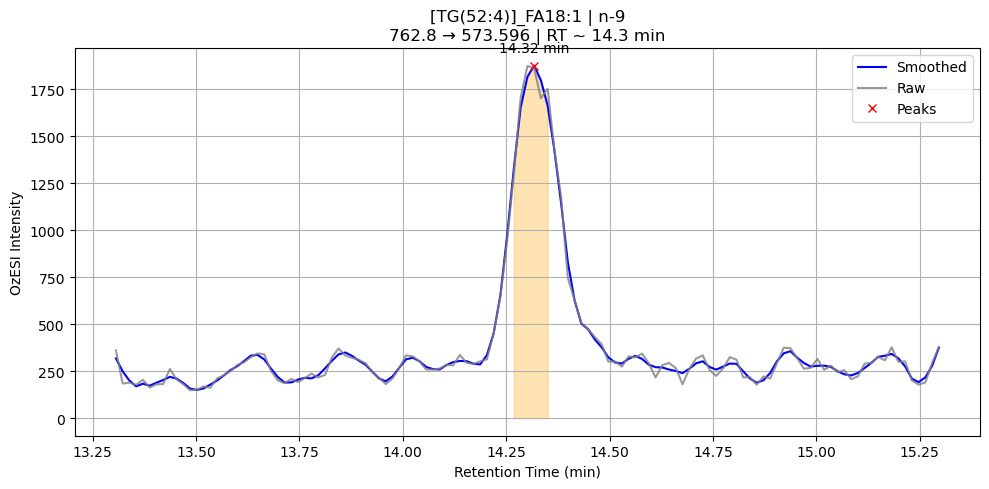


=== [TG(54:2)]_FA18:1 | n-7 | Precursor: 822.8 → Product: 605.596 | RT ~ 20.0 ===
Peak RT (min)   Max Intensity   Approx. Area   
20.00           2566.63         155.32         


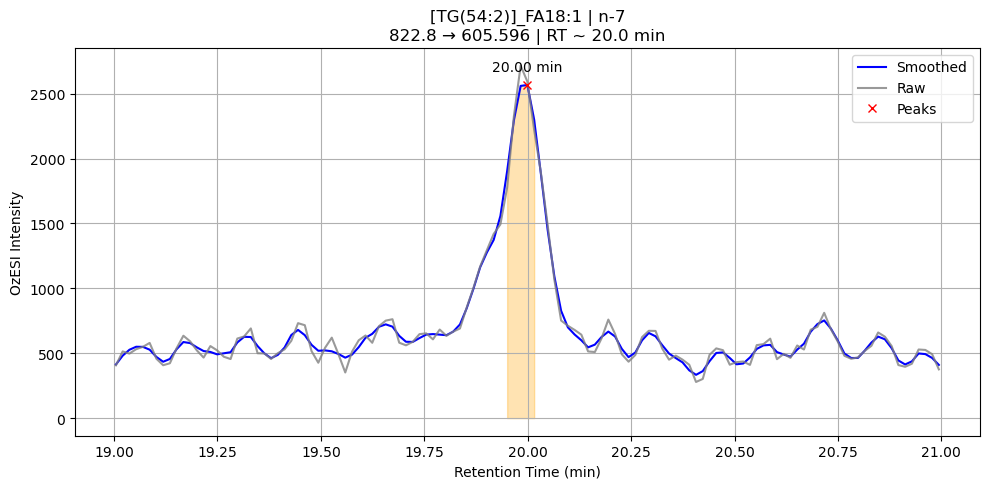


=== [TG(54:2)]_FA18:1 | n-9 | Precursor: 794.8 → Product: 605.596 | RT ~ 20.0 ===
Peak RT (min)   Max Intensity   Approx. Area   
20.00           10973.49        502.14         


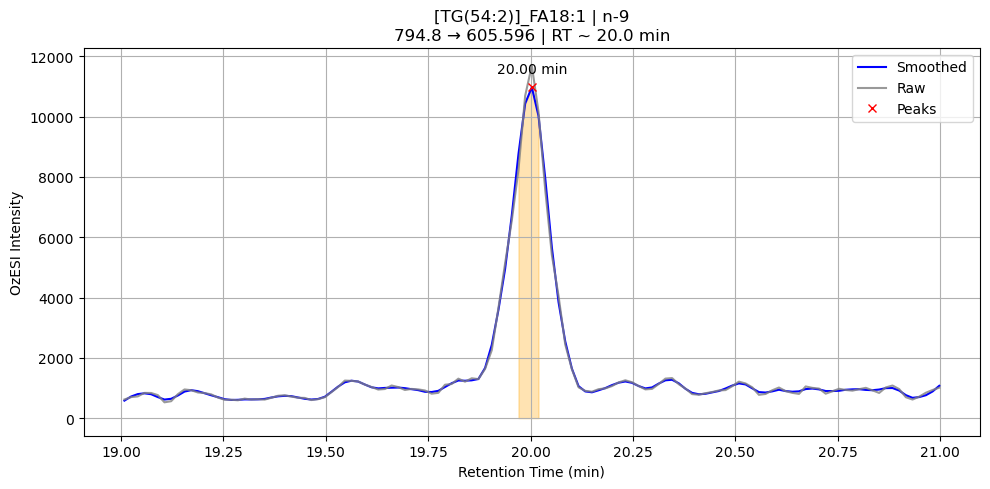


=== [TG(54:3)]_FA18:1 | n-7 | Precursor: 820.8 → Product: 603.596 | RT ~ 17.98 ===
Peak RT (min)   Max Intensity   Approx. Area   
17.99           16733.17        1017.63        


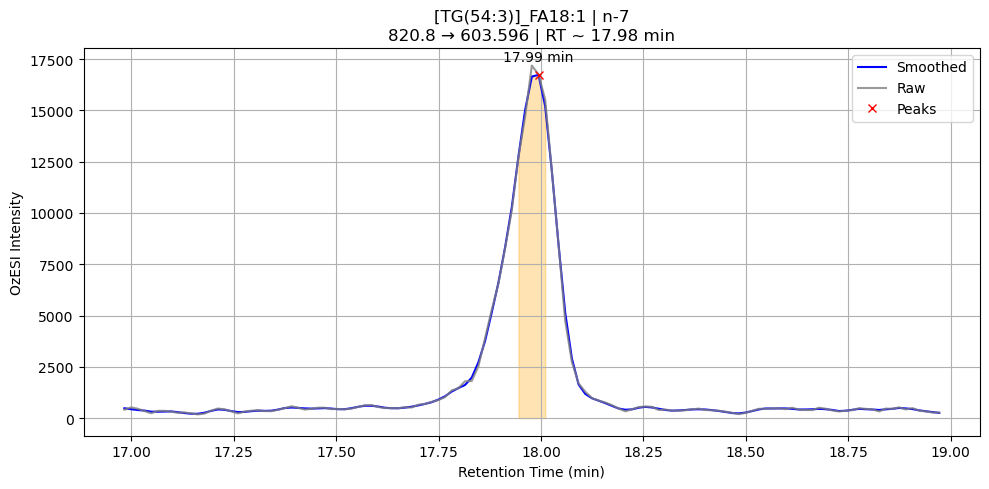


=== [TG(54:3)]_FA18:1 | n-9 | Precursor: 792.8 → Product: 603.596 | RT ~ 17.98 ===
Peak RT (min)   Max Intensity   Approx. Area   
17.98           97747.44        4425.55        


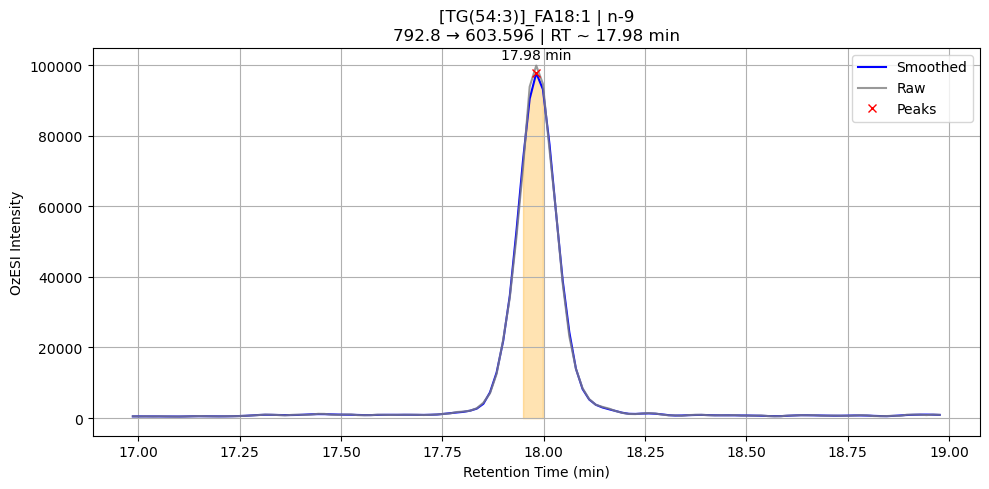


=== [TG(54:4)]_FA18:1 | n-7 | Precursor: 818.8 → Product: 601.596 | RT ~ 16.07 ===
Peak RT (min)   Max Intensity   Approx. Area   
16.07           5330.93         331.06         


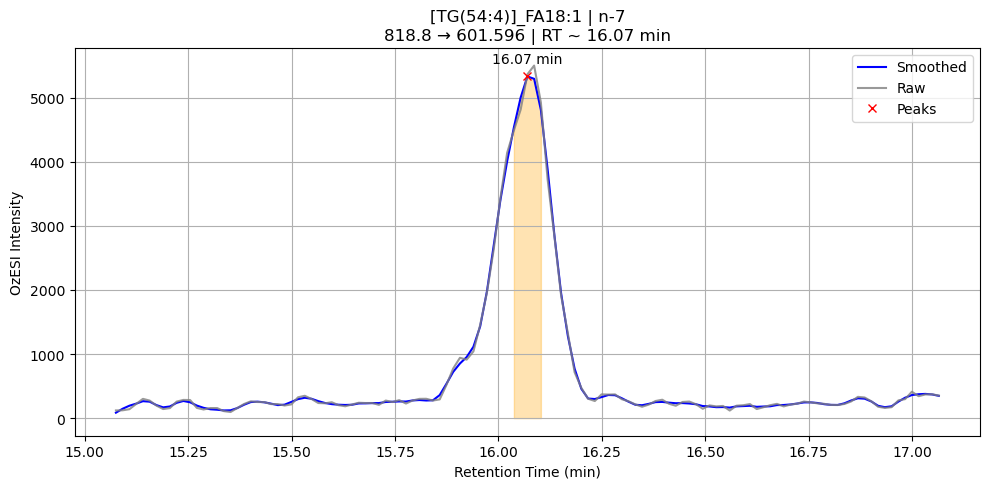


=== [TG(54:4)]_FA18:1 | n-9 | Precursor: 790.8 → Product: 601.596 | RT ~ 16.07 ===
Peak RT (min)   Max Intensity   Approx. Area   
16.09           26275.83        1558.17        


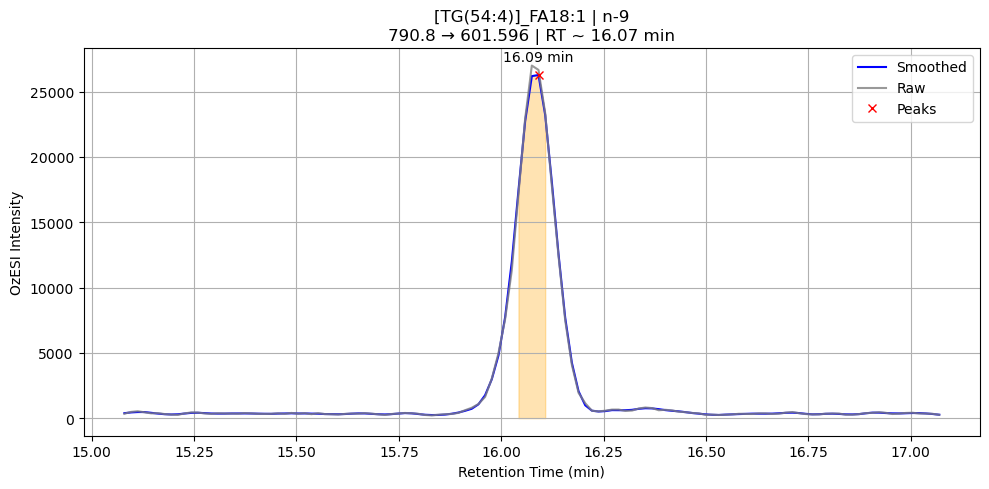


=== [TG(54:5)]_FA18:1 | n-7 | Precursor: 816.8 → Product: 599.596 | RT ~ 14.31 ===
Peak RT (min)   Max Intensity   Approx. Area   
14.31           1242.91         75.03          


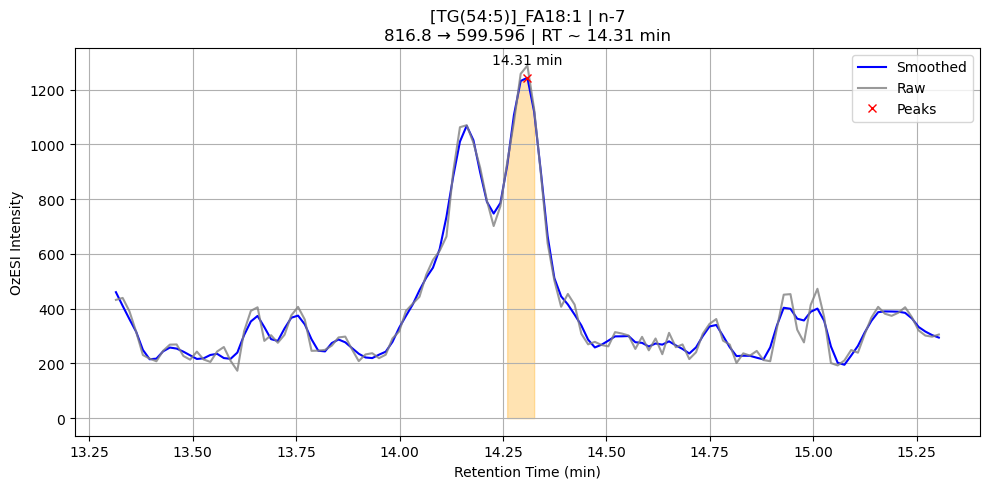


=== [TG(54:5)]_FA18:1 | n-9 | Precursor: 788.8 → Product: 599.596 | RT ~ 14.31 ===
Peak RT (min)   Max Intensity   Approx. Area   
14.33           5208.51         320.18         


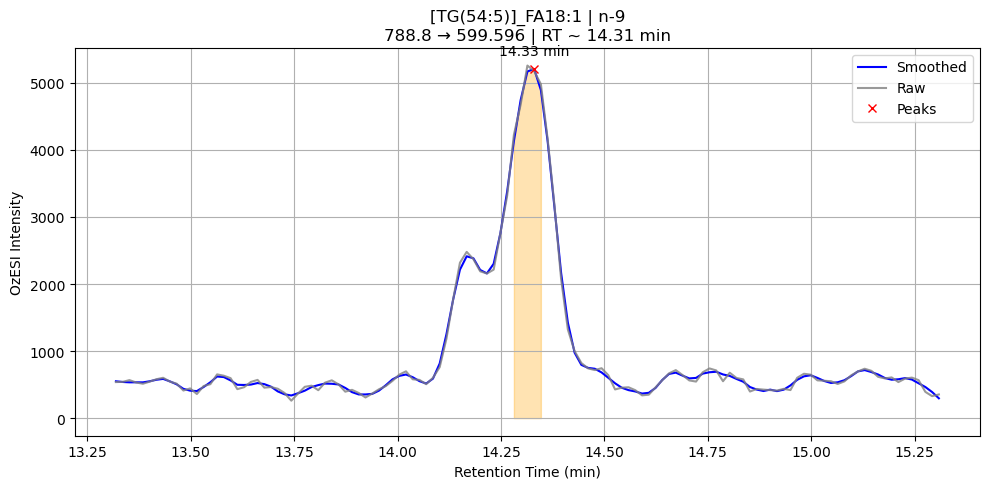


=== Complete Results ===
                Lipid db_pos  Precursor_Ion  Product_Ion  Expected_RT  \
0   [TG(52:2)]_FA18:1    n-7          794.8      577.596        18.05   
1   [TG(52:2)]_FA18:1    n-9          766.8      577.596        18.05   
2   [TG(52:3)]_FA18:1    n-7          792.8      575.596        16.09   
3   [TG(52:3)]_FA18:1    n-9          764.8      575.596        16.09   
4   [TG(52:4)]_FA18:1    n-7          790.8      573.596        14.30   
5   [TG(52:4)]_FA18:1    n-9          762.8      573.596        14.30   
6   [TG(54:2)]_FA18:1    n-7          822.8      605.596        20.00   
7   [TG(54:2)]_FA18:1    n-9          794.8      605.596        20.00   
8   [TG(54:3)]_FA18:1    n-7          820.8      603.596        17.98   
9   [TG(54:3)]_FA18:1    n-9          792.8      603.596        17.98   
10  [TG(54:4)]_FA18:1    n-7          818.8      601.596        16.07   
11  [TG(54:4)]_FA18:1    n-9          790.8      601.596        16.07   
12  [TG(54:5)]_FA18:1    

,Lipid,db_pos,Precursor_Ion,Product_Ion,Expected_RT,Peak_RT,Max_Intensity,Peak_Area,Sample_ID
0,[TG(52:2)]_FA18:1,n-7,794.8,577.596,18.05,18.045533,3699.263125,171.292194,CrudeCanola_O3on_150gN3_02082023
1,[TG(52:2)]_FA18:1,n-9,766.8,577.596,18.05,18.034800,15663.851842,694.720783,CrudeCanola_O3on_150gN3_02082023
2,[TG(52:3)]_FA18:1,n-7,792.8,575.596,16.09,16.040583,1026.470535,48.305507,CrudeCanola_O3on_150gN3_02082023
3,[TG(52:3)]_FA18:1,n-9,764.8,575.596,16.09,16.110917,3272.104085,152.354505,CrudeCanola_O3on_150gN3_02082023
4,[TG(52:4)]_FA18:1,n-7,790.8,573.596,14.30,14.361800,591.515276,64.183836,CrudeCanola_O3on_150gN3_02082023
5,[TG(52:4)]_FA18:1,n-9,762.8,573.596,14.30,14.317517,1876.939215,140.998993,CrudeCanola_O3on_150gN3_02082023
6,[TG(54:2)]_FA18:1,n-7,822.8,605.596,20.00,19.999217,2566.625854,155.324554,CrudeCanola_O3on_150gN3_02082023
7,[TG(54:2)]_FA18:1,n-9,794.8,605.596,20.00,20.002950,10973.494280,502.136069,CrudeCanola_O3on_150gN3_02082023
8,[TG(54:3)]_FA18:1,n-7,820.8,603.596,17.98,17.993817,16733.170526,1017.626870,CrudeCanola_O3on_150gN3_02082023
9,[TG(54:3)]_FA18:1,n-9,792.8,603.596,17.98,17.981700,97747.443824,4425.552367,CrudeCanola_O3on_150gN3_02082023


In [15]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.signal import find_peaks, peak_widths, savgol_filter

# Load lipid info table
lipid_mrm = pd.read_csv('lipid_mrm.csv')

# Constants
sample_id_filter = 'CrudeCanola_O3on_150gN3_02082023'
tolerance = 0.3
rt_window = 1.0  # ±1 min around expected RT
smoothing_window = 7
poly_order = 2

# Create empty dataframe to store results
results_df = pd.DataFrame(columns=[
    'Lipid', 'db_pos', 'Precursor_Ion', 'Product_Ion', 
    'Expected_RT', 'Peak_RT', 'Max_Intensity', 'Peak_Area', 'Sample_ID'
])

# Loop over each lipid row
for idx, row in lipid_mrm.iterrows():
    lipid = row['Lipid']
    product_ion = row['Product_Ion']
    precursor_n7 = row['n-7']
    precursor_n9 = row['n-9']
    expected_rt = row['Retention_Time']

    for ion_type, precursor in zip(['n-7', 'n-9'], [precursor_n7, precursor_n9]):
        print(f"\n=== {lipid} | {ion_type} | Precursor: {precursor} → Product: {product_ion} | RT ~ {expected_rt} ===")
        
        # Filter by Sample_ID, Parent/Product Ion, and RT window
        matched = processed_df[
            (processed_df['Sample_ID'] == sample_id_filter) &
            (processed_df['Parent_Ion'].between(precursor - tolerance, precursor + tolerance)) &
            (processed_df['Product_Ion'].between(product_ion - tolerance, product_ion + tolerance)) &
            (processed_df['Retention_Time'].between(expected_rt - rt_window, expected_rt + rt_window))
        ]

        if matched.empty:
            print("No matching MRM transition found within RT window.")
            # Add empty row to results with NaN values for peak data
            results_df = pd.concat([results_df, pd.DataFrame({
                'Lipid': [lipid],
                'db_pos': [ion_type],
                'Precursor_Ion': [precursor],
                'Product_Ion': [product_ion],
                'Expected_RT': [expected_rt],
                'Peak_RT': [np.nan],
                'Max_Intensity': [np.nan],
                'Peak_Area': [np.nan],
                'Sample_ID': [sample_id_filter]
            })], ignore_index=True)
            continue

        matched = matched.sort_values(by='Retention_Time')
        rt = matched['Retention_Time'].values
        raw_intensity = matched['OzESI_Intensity'].values

        # Smooth
        if len(raw_intensity) >= smoothing_window:
            intensity = savgol_filter(raw_intensity, smoothing_window, poly_order)
        else:
            intensity = raw_intensity

        # Peak detection
        height_thresh = 0.7 * max(intensity)
        prominence_thresh = 0.75 * max(intensity)
        peaks, props = find_peaks(
            intensity,
            height=height_thresh,
            prominence=prominence_thresh,
            distance=3,
            width=1
        )
        results_half = peak_widths(intensity, peaks, rel_height=0.15)

        # Print peak info
        print(f"{'Peak RT (min)':<15} {'Max Intensity':<15} {'Approx. Area':<15}")
        
        # If peaks were found, add each to the results dataframe
        if len(peaks) > 0:
            for i, peak_idx in enumerate(peaks):
                peak_rt = rt[peak_idx]
                peak_int = intensity[peak_idx]
                left = int(results_half[2][i])
                right = int(results_half[3][i])
                rt_slice = rt[left:right+1]
                int_slice = intensity[left:right+1]
                area = np.trapz(int_slice, rt_slice)
                print(f"{peak_rt:<15.2f} {peak_int:<15.2f} {area:<15.2f}")
                
                # Add to results dataframe
                results_df = pd.concat([results_df, pd.DataFrame({
                    'Lipid': [lipid],
                    'db_pos': [ion_type],
                    'Precursor_Ion': [precursor],
                    'Product_Ion': [product_ion],
                    'Expected_RT': [expected_rt],
                    'Peak_RT': [peak_rt],
                    'Max_Intensity': [peak_int],
                    'Peak_Area': [area],
                    'Sample_ID': [sample_id_filter]
                })], ignore_index=True)
        else:
            # No peaks found but data exists
            print("No peaks detected above threshold.")
            # Add empty row to results
            results_df = pd.concat([results_df, pd.DataFrame({
                'Lipid': [lipid],
                'db_pos': [ion_type],
                'Precursor_Ion': [precursor],
                'Product_Ion': [product_ion],
                'Expected_RT': [expected_rt],
                'Peak_RT': [np.nan],
                'Max_Intensity': [np.nan],
                'Peak_Area': [np.nan],
                'Sample_ID': [sample_id_filter]
            })], ignore_index=True)

        #Optional: Plotting code (commented out in your original code)
        plt.figure(figsize=(10, 5))
        plt.plot(rt, intensity, label='Smoothed', color='blue')
        plt.plot(rt, raw_intensity, label='Raw', color='gray', alpha=0.8)
        plt.plot(rt[peaks], intensity[peaks], 'rx', label='Peaks')
        
        # Shade peak areas
        for i in range(len(peaks)):
            left = int(results_half[2][i])
            right = int(results_half[3][i])
            plt.fill_between(rt[left:right+1], intensity[left:right+1], alpha=0.3, color='orange')
        
        # Annotate peaks
        for peak in peaks:
            plt.annotate(f"{rt[peak]:.2f} min", (rt[peak], intensity[peak]), xytext=(0, 10), textcoords="offset points", ha='center')
        
        plt.title(f'{lipid} | {ion_type}\n{precursor} → {product_ion} | RT ~ {expected_rt} min')
        plt.xlabel("Retention Time (min)")
        plt.ylabel("OzESI Intensity")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

# Display the results dataframe
print("\n=== Complete Results ===")
print(results_df)
results_df
# # Save results to CSV
# results_df.to_csv(f'{sample_id_filter}_lipid_analysis_results.csv', index=False)
# print(f"\nResults saved to {sample_id_filter}_lipid_analysis_results.csv")

# gmm


=== [TG(52:2)]_FA18:1 | n-7 | Precursor: 794.8 → Product: 577.596 | RT ~ 18.05 ===
Peak RT (min)   Max Intensity   Approx. Area   
18.01           2348.04         68.87          


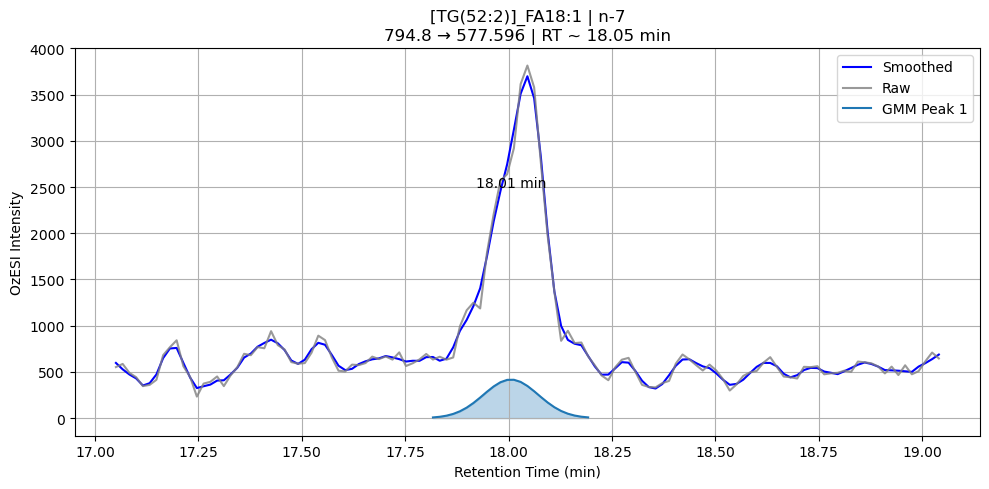


=== [TG(52:2)]_FA18:1 | n-9 | Precursor: 766.8 → Product: 577.596 | RT ~ 18.05 ===


: 

In [16]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.signal import savgol_filter
from sklearn.mixture import GaussianMixture
from scipy.stats import norm

# Load lipid info table
lipid_mrm = pd.read_csv('lipid_mrm.csv')

# Constants
sample_id_filter = 'CrudeCanola_O3on_150gN3_02082023'
tolerance = 0.3
rt_window = 1.0  # ±1 min around expected RT
smoothing_window = 7
poly_order = 2

# Create empty dataframe to store results
results_df = pd.DataFrame(columns=[
    'Lipid', 'db_pos', 'Precursor_Ion', 'Product_Ion', 
    'Expected_RT', 'Peak_RT', 'Max_Intensity', 'Peak_Area', 'Sample_ID'
])

def detect_peaks_with_gmm(rt, intensity, n_components_range=(3, 3), min_intensity_threshold=0.1):
    """
    Detect peaks using Gaussian Mixture Models
    
    Parameters:
    -----------
    rt : array-like
        Retention time values
    intensity : array-like
        Intensity values
    n_components_range : tuple
        Range of number of components to try (min, max+1)
    min_intensity_threshold : float
        Threshold for considering a point as part of a peak (fraction of max intensity)
    
    Returns:
    --------
    peaks_data : list of dicts
        List of dictionaries containing peak information
    best_gmm : GaussianMixture
        The best GMM model
    """
    # Normalize the data for GMM
    rt_normalized = (rt - np.min(rt)) / (np.max(rt) - np.min(rt))
    intensity_normalized = intensity / np.max(intensity)
    
    # Stack the data for GMM
    X = np.column_stack([rt_normalized, intensity_normalized])
    
    # Find optimal number of components using BIC
    lowest_bic = np.inf
    best_gmm = None
    bic_values = []
    
    for n_components in range(*n_components_range):
        # Fit GMM
        gmm = GaussianMixture(
            n_components=n_components,
            covariance_type='full',
            random_state=42,
            max_iter=200
        )
        gmm.fit(X)
        bic = gmm.bic(X)
        bic_values.append(bic)
        
        if bic < lowest_bic:
            lowest_bic = bic
            best_gmm = gmm
    
    if best_gmm is None:
        return [], None
    
    # Get GMM parameters
    means = best_gmm.means_
    covariances = best_gmm.covariances_
    weights = best_gmm.weights_
    
    # Sort components by RT mean
    sorted_indices = np.argsort(means[:, 0])
    means = means[sorted_indices]
    covariances = covariances[sorted_indices]
    weights = weights[sorted_indices]
    
    # Scale means back to original RT scale
    rt_means = means[:, 0] * (np.max(rt) - np.min(rt)) + np.min(rt)
    
    # Calculate peak information
    peaks_data = []
    for i, (rt_mean, mean, cov, weight) in enumerate(zip(rt_means, means, covariances, weights)):
        # Skip components with very low weight or intensity
        if weight < 0.05 or mean[1] < min_intensity_threshold:
            continue
        
        # Get the RT standard deviation (converted back to original scale)
        rt_std = np.sqrt(cov[0, 0]) * (np.max(rt) - np.min(rt))
        
        # Calculate max intensity (scale back to original)
        max_intensity = mean[1] * np.max(intensity)
        
        # Define the range for this peak (±3 sigma)
        rt_range_min = max(rt_mean - 3 * rt_std, np.min(rt))
        rt_range_max = min(rt_mean + 3 * rt_std, np.max(rt))
        
        # Get indices within this RT range
        idx_in_range = (rt >= rt_range_min) & (rt <= rt_range_max)
        
        if not np.any(idx_in_range):
            continue
            
        # Calculate the fitted gaussian for this component
        rt_in_range = rt[idx_in_range]
        intensity_fitted = weight * norm.pdf(
            rt_in_range, 
            loc=rt_mean, 
            scale=rt_std
        ) * np.max(intensity) / norm.pdf(0, 0, rt_std)
        
        # Calculate peak area using the fitted gaussian
        peak_area = np.trapz(intensity_fitted, rt_in_range)
        
        # Store peak data
        peaks_data.append({
            'peak_idx': i,
            'peak_rt': rt_mean,
            'peak_intensity': max_intensity,
            'peak_area': peak_area,
            'rt_std': rt_std,
            'rt_range': (rt_range_min, rt_range_max),
            'idx_in_range': idx_in_range,
            'fitted_intensity': intensity_fitted,
            'fitted_rt': rt_in_range
        })
    
    return peaks_data, best_gmm

# Loop over each lipid row
for idx, row in lipid_mrm.iterrows():
    lipid = row['Lipid']
    product_ion = row['Product_Ion']
    precursor_n7 = row['n-7']
    precursor_n9 = row['n-9']
    expected_rt = row['Retention_Time']

    for ion_type, precursor in zip(['n-7', 'n-9'], [precursor_n7, precursor_n9]):
        print(f"\n=== {lipid} | {ion_type} | Precursor: {precursor} → Product: {product_ion} | RT ~ {expected_rt} ===")
        
        # Filter by Sample_ID, Parent/Product Ion, and RT window
        matched = processed_df[
            (processed_df['Sample_ID'] == sample_id_filter) &
            (processed_df['Parent_Ion'].between(precursor - tolerance, precursor + tolerance)) &
            (processed_df['Product_Ion'].between(product_ion - tolerance, product_ion + tolerance)) &
            (processed_df['Retention_Time'].between(expected_rt - rt_window, expected_rt + rt_window))
        ]

        if matched.empty:
            print("No matching MRM transition found within RT window.")
            # Add empty row to results with NaN values for peak data
            results_df = pd.concat([results_df, pd.DataFrame({
                'Lipid': [lipid],
                'db_pos': [ion_type],
                'Precursor_Ion': [precursor],
                'Product_Ion': [product_ion],
                'Expected_RT': [expected_rt],
                'Peak_RT': [np.nan],
                'Max_Intensity': [np.nan],
                'Peak_Area': [np.nan],
                'Sample_ID': [sample_id_filter]
            })], ignore_index=True)
            continue

        matched = matched.sort_values(by='Retention_Time')
        rt = matched['Retention_Time'].values
        raw_intensity = matched['OzESI_Intensity'].values

        # Smooth
        if len(raw_intensity) >= smoothing_window:
            intensity = savgol_filter(raw_intensity, smoothing_window, poly_order)
        else:
            intensity = raw_intensity

        # Use GMM for peak detection
        peaks_data, best_gmm = detect_peaks_with_gmm(
            rt, 
            intensity, 
            n_components_range=(1, 6),  # Try 1-5 components
            min_intensity_threshold=0.2  # Min 20% of max intensity
        )

        # Print peak info
        print(f"{'Peak RT (min)':<15} {'Max Intensity':<15} {'Approx. Area':<15}")
        
        # If peaks were found, add each to the results dataframe
        if len(peaks_data) > 0:
            for peak_info in peaks_data:
                peak_rt = peak_info['peak_rt']
                peak_int = peak_info['peak_intensity']
                area = peak_info['peak_area']
                print(f"{peak_rt:<15.2f} {peak_int:<15.2f} {area:<15.2f}")
                
                # Add to results dataframe
                results_df = pd.concat([results_df, pd.DataFrame({
                    'Lipid': [lipid],
                    'db_pos': [ion_type],
                    'Precursor_Ion': [precursor],
                    'Product_Ion': [product_ion],
                    'Expected_RT': [expected_rt],
                    'Peak_RT': [peak_rt],
                    'Max_Intensity': [peak_int],
                    'Peak_Area': [area],
                    'Sample_ID': [sample_id_filter]
                })], ignore_index=True)
        else:
            # No peaks found but data exists
            print("No peaks detected above threshold.")
            # Add empty row to results
            results_df = pd.concat([results_df, pd.DataFrame({
                'Lipid': [lipid],
                'db_pos': [ion_type],
                'Precursor_Ion': [precursor],
                'Product_Ion': [product_ion],
                'Expected_RT': [expected_rt],
                'Peak_RT': [np.nan],
                'Max_Intensity': [np.nan],
                'Peak_Area': [np.nan],
                'Sample_ID': [sample_id_filter]
            })], ignore_index=True)

        # Plotting with GMM results
        plt.figure(figsize=(10, 5))
        plt.plot(rt, intensity, label='Smoothed', color='blue')
        plt.plot(rt, raw_intensity, label='Raw', color='gray', alpha=0.8)
        
        # Plot GMM components if they exist
        if best_gmm is not None and len(peaks_data) > 0:
            colors = plt.cm.tab10(np.linspace(0, 1, len(peaks_data)))
            
            for i, (peak_info, color) in enumerate(zip(peaks_data, colors)):
                # Plot the fitted Gaussian
                plt.plot(
                    peak_info['fitted_rt'],
                    peak_info['fitted_intensity'],
                    '-', 
                    color=color,
                    label=f'GMM Peak {i+1}'
                )
                
                # Shade under the curve
                plt.fill_between(
                    peak_info['fitted_rt'],
                    peak_info['fitted_intensity'],
                    alpha=0.3,
                    color=color
                )
                
                # Annotate peak
                plt.annotate(
                    f"{peak_info['peak_rt']:.2f} min",
                    (peak_info['peak_rt'], peak_info['peak_intensity']),
                    xytext=(0, 10),
                    textcoords="offset points",
                    ha='center'
                )
        
        plt.title(f'{lipid} | {ion_type}\n{precursor} → {product_ion} | RT ~ {expected_rt} min')
        plt.xlabel("Retention Time (min)")
        plt.ylabel("OzESI Intensity")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

# Display the results dataframe
print("\n=== Complete Results ===")
print(results_df)
results_df
# # Save results to CSV
# results_df.to_csv(f'{sample_id_filter}_lipid_analysis_results.csv', index=False)
# print(f"\nResults saved to {sample_id_filter}_lipid_analysis_results.csv")

# 14apr25 5pm PLOT

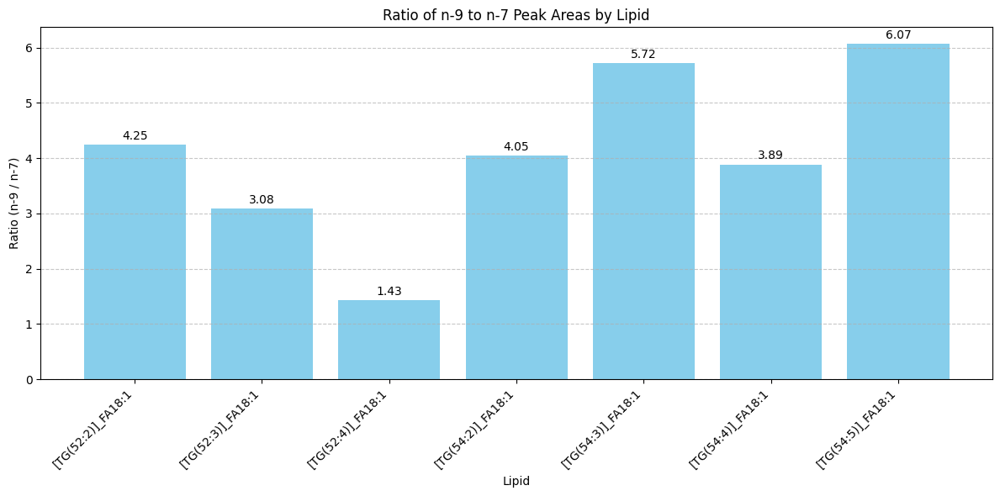

                Lipid db_pos  Precursor_Ion  Product_Ion  Expected_RT  \
0   [TG(52:2)]_FA18:1    n-7          794.8      577.596        18.05   
1   [TG(52:2)]_FA18:1    n-9          766.8      577.596        18.05   
2   [TG(52:3)]_FA18:1    n-7          792.8      575.596        16.09   
3   [TG(52:3)]_FA18:1    n-9          764.8      575.596        16.09   
4   [TG(52:4)]_FA18:1    n-7          790.8      573.596        14.30   
5   [TG(52:4)]_FA18:1    n-9          762.8      573.596        14.30   
6   [TG(54:2)]_FA18:1    n-7          822.8      605.596        20.00   
7   [TG(54:2)]_FA18:1    n-9          794.8      605.596        20.00   
8   [TG(54:3)]_FA18:1    n-7          820.8      603.596        17.98   
9   [TG(54:3)]_FA18:1    n-9          792.8      603.596        17.98   
10  [TG(54:4)]_FA18:1    n-7          818.8      601.596        16.07   
11  [TG(54:4)]_FA18:1    n-9          790.8      601.596        16.07   
12  [TG(54:5)]_FA18:1    n-7          816.8      59

In [115]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

def Plot(results_df):
    """
    Create a new column Ratio_Area in results_df and plot the ratios.
    Ratio_Area is calculated by dividing n-9 area by n-7 area for each lipid.
    
    Parameters:
    -----------
    results_df : pandas.DataFrame
        DataFrame containing lipid analysis results with columns:
        'Lipid', 'db_pos', 'Peak_Area', etc.
        
    Returns:
    --------
    pandas.DataFrame
        Modified DataFrame with additional Ratio_Area column
    """
    # Create a copy of the dataframe to avoid modifying the original
    df = results_df.copy()
    
    # First, ensure we have numeric values for Peak_Area
    df['Peak_Area'] = pd.to_numeric(df['Peak_Area'], errors='coerce')
    
    # Create a new column initialized with NaN values
    df['Ratio_Area'] = np.nan
    
    # Get unique lipids
    unique_lipids = df['Lipid'].unique()
    
    # Dictionary to store ratio data for plotting
    plot_data = {'Lipid': [], 'Ratio_n9_to_n7': []}
    
    # Process each lipid
    for lipid in unique_lipids:
        # Get rows for this lipid
        lipid_data = df[df['Lipid'] == lipid]
        
        # Find n-7 and n-9 rows
        n7_row = lipid_data[lipid_data['db_pos'] == 'n-7']
        n9_row = lipid_data[lipid_data['db_pos'] == 'n-9']
        
        # Check if we have both n-7 and n-9 data
        if not n7_row.empty and not n9_row.empty:
            n7_area = n7_row['Peak_Area'].values[0]
            n9_area = n9_row['Peak_Area'].values[0]
            
            # Calculate ratio only if n7_area is not zero and both are valid numbers
            if n7_area > 0 and not np.isnan(n7_area) and not np.isnan(n9_area):
                ratio = n9_area / n7_area
                
                # Update ratio for both rows
                df.loc[n7_row.index, 'Ratio_Area'] = ratio
                df.loc[n9_row.index, 'Ratio_Area'] = ratio
                
                # Store for plotting
                plot_data['Lipid'].append(lipid)
                plot_data['Ratio_n9_to_n7'].append(ratio)
    
    # Create bar plot of ratios
    if plot_data['Lipid']:
        plt.figure(figsize=(12, 6))
        bars = plt.bar(plot_data['Lipid'], plot_data['Ratio_n9_to_n7'], color='skyblue')
        
        # Add ratio values on top of bars
        for bar, ratio in zip(bars, plot_data['Ratio_n9_to_n7']):
            plt.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.05,
                    f'{ratio:.2f}', ha='center', va='bottom')
        
        plt.xlabel('Lipid')
        plt.ylabel('Ratio (n-9 / n-7)')
        plt.title('Ratio of n-9 to n-7 Peak Areas by Lipid')
        plt.xticks(rotation=45, ha='right')
        plt.tight_layout()
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        plt.show()
    
    return df

# Example usage (not executed when imported as a module):
if __name__ == "__main__":
    # Sample data for testing

    result = Plot(results_df)
    print(result)

In [14]:
# Lipid: TG(52:2)]_FA18:1, Precursor_Ion: 876.8, Product_Ion: 577.596, n-7: 794.8, n-9: 766.8
# Lipid: TG(52:3)]_FA18:1, Precursor_Ion: 874.8, Product_Ion: 575.596, n-7: 792.8, n-9: 764.8
# Lipid: TG(54:2)]_FA18:1, Precursor_Ion: 904.8, Product_Ion: 605.596, n-7: 822.8, n-9: 794.8
# Lipid: TG(54:3)]_FA18:1, Precursor_Ion: 902.8, Product_Ion: 603.596, n-7: 820.8, n-9: 792.8
# Lipid: TG(54:4)]_FA18:1, Precursor_Ion: 900.8, Product_Ion: 601.596, n-7: 818.8, n-9: 790.8
# Lipid: [TG(52:4)]_FA18:1, Precursor_Ion: 872.8, Product_Ion: 573.596, n-7: 790.8, n-9: 762.8
# Lipid: [TG(52:5)]_FA18:1, Precursor_Ion: 870.8, Product_Ion: 571.596, n-7: 788.8, n-9: 760.8
# Lipid: [TG(52:6)]_FA18:1, Precursor_Ion: 868.7, Product_Ion: 569.596, n-7: 786.7, n-9: 758.7
# Lipid: [TG(54:5)]_FA18:1, Precursor_Ion: 898.8, Product_Ion: 599.596, n-7: 816.8, n-9: 788.8
# Lipid: [TG(54:6)]_FA18:1, Precursor_Ion: 896.8, Product_Ion: 597.596, n-7: 814.8, n-9: 786.8

# plot peaks new area method 

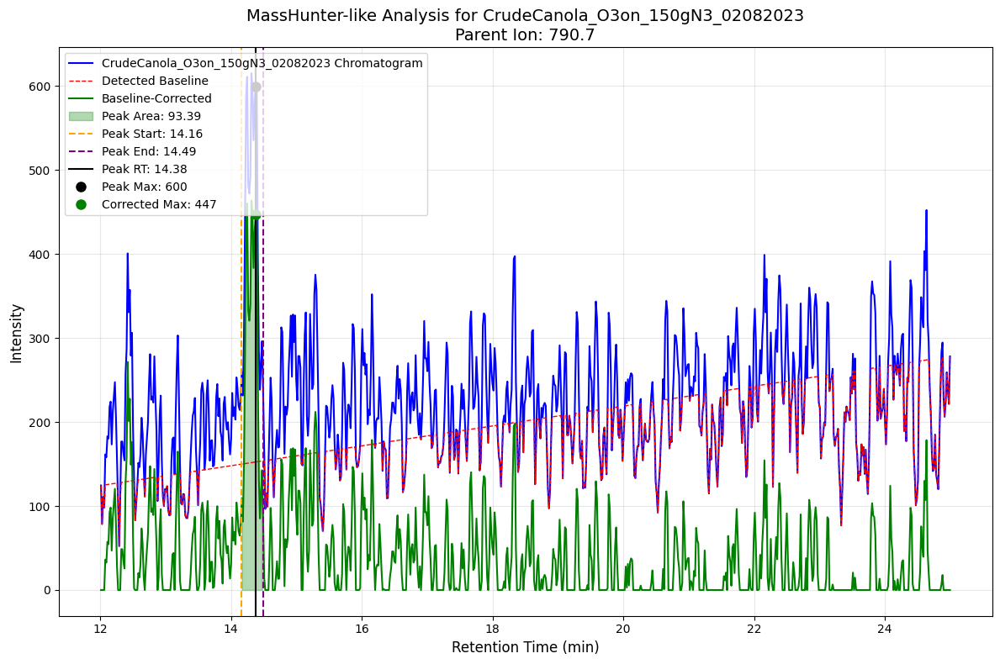

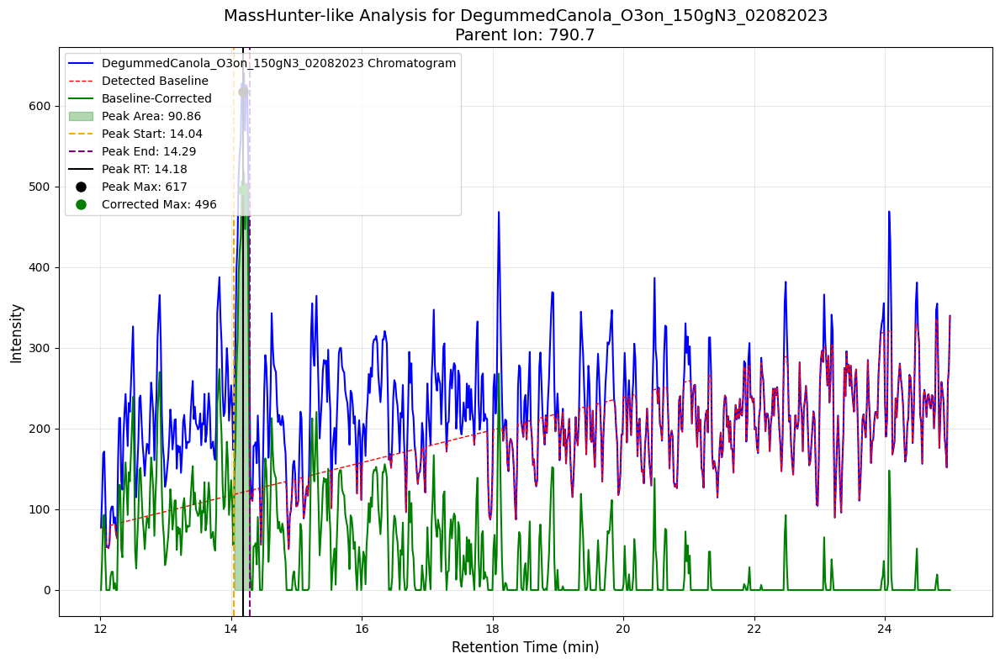

No peaks found for sample RBDCanola_O3on_150gN3_02082023.

Summary of Peak Analysis Results:
                             Sample_ID  Peak_Area  Max_Original_Intensity  \
0     CrudeCanola_O3on_150gN3_02082023  93.394154              599.520020   
1  DegummedCanola_O3on_150gN3_02082023  90.859286              616.880066   

   Max_Corrected_Intensity  Peak_Start  Peak_Stop    Peak_RT  
0               447.054653   14.159027  14.490789  14.378100  
1               495.826972   14.041478  14.290765  14.182433  


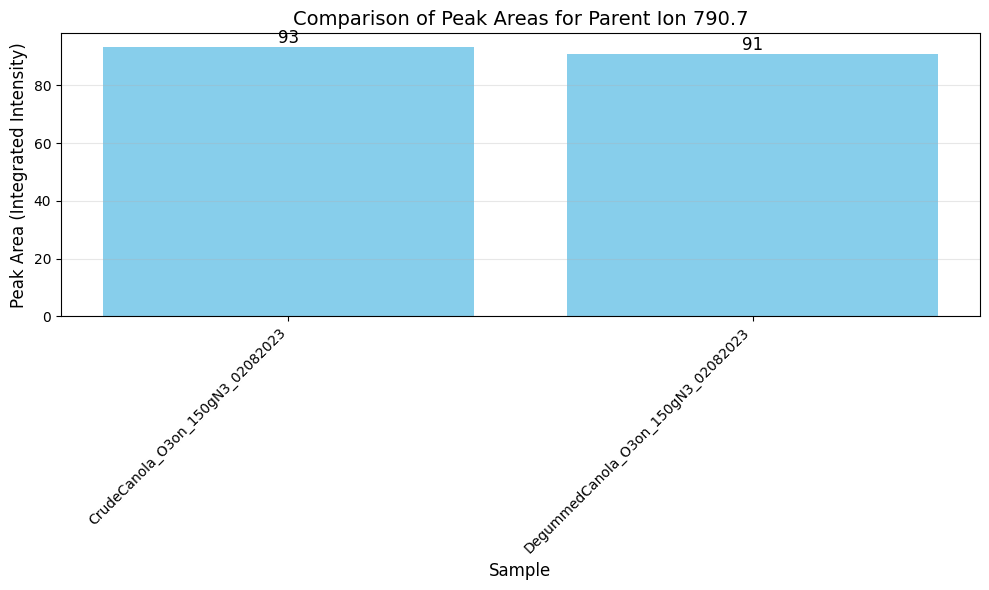


Relative Concentration Analysis:
                             Sample_ID  Peak_Area  Relative_Concentration
0     CrudeCanola_O3on_150gN3_02082023  93.394154               50.687875
1  DegummedCanola_O3on_150gN3_02082023  90.859286               49.312125


In [15]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from scipy.signal import find_peaks, peak_widths, savgol_filter
from scipy.interpolate import UnivariateSpline

# Define target parent ion and sample IDs
target_parent_ion = 790.7
sample_ids = [
    'CrudeCanola_O3on_150gN3_02082023',
    'DegummedCanola_O3on_150gN3_02082023',
    'RBDCanola_O3on_150gN3_02082023'
]

# List to hold our summary results
results = []

def detect_baseline(rt, intensity, peaks, smoothing_factor=0.3):
    """
    Detect baseline points (valleys) between peaks and fit a spline baseline.
    Similar to Agilent MassHunter's baseline detection algorithm.
    """
    # If no peaks found, return a flat baseline at the minimum intensity
    if len(peaks) == 0:
        return np.ones_like(intensity) * np.min(intensity)
    
    # Find potential valley points (local minima)
    valley_candidates = []
    valley_candidates.append(0)  # Start of chromatogram
    
    # Find valleys between peaks
    for i in range(len(peaks)-1):
        # Look for minimum point between consecutive peaks
        start_idx = peaks[i]
        end_idx = peaks[i+1]
        if start_idx < end_idx:
            min_idx = start_idx + np.argmin(intensity[start_idx:end_idx])
            valley_candidates.append(min_idx)
    
    valley_candidates.append(len(intensity)-1)  # End of chromatogram
    
    # Get coordinates of valley points
    valley_rt = rt[valley_candidates]
    valley_intensity = intensity[valley_candidates]
    
    # Fit a spline through the valley points
    if len(valley_rt) >= 4:  # Need at least 4 points for cubic spline
        baseline_spline = UnivariateSpline(valley_rt, valley_intensity, s=smoothing_factor*len(valley_rt))
        baseline = baseline_spline(rt)
    else:
        # Fallback to linear interpolation if too few points
        baseline = np.interp(rt, valley_rt, valley_intensity)
    
    # Ensure baseline doesn't go above the signal (Agilent-like constraint)
    for i in range(len(baseline)):
        if baseline[i] > intensity[i]:
            baseline[i] = intensity[i]
    
    return baseline

# Loop over each sample
for sample in sample_ids:
    # Filter the DataFrame for the given sample, parent ion, and retention time window 13.5-15 minutes
    subset = processed_df[
        (processed_df['Parent_Ion'] == target_parent_ion) &
        (processed_df['Sample_ID'] == sample) &
        (processed_df['Retention_Time'] >= 12) &
        (processed_df['Retention_Time'] <= 25)
    ].copy()
    
    # Group by Retention_Time and take the maximum OzESI_Intensity
    aggregated = subset.groupby('Retention_Time', as_index=False)['OzESI_Intensity'].max()
    aggregated.sort_values('Retention_Time', inplace=True)
    aggregated = aggregated.reset_index(drop=True)
    
    # Skip if no data is available
    if aggregated.empty:
        print(f"No data for sample {sample} in the specified retention time window.")
        continue

    # Apply Savitzky-Golay smoothing to reduce noise
    retention_times = aggregated['Retention_Time'].values
    intensity_array = aggregated['OzESI_Intensity'].values
    
    # Apply smoothing if we have enough data points
    if len(intensity_array) > 5:
        smoothed_intensity = savgol_filter(intensity_array, 5, 2)
    else:
        smoothed_intensity = intensity_array.copy()
    
    # Use SciPy to detect peaks in the smoothed chromatogram
    peaks, properties = find_peaks(smoothed_intensity, height=100, prominence=500)
    
    if len(peaks) == 0:
        print(f"No peaks found for sample {sample}.")
        continue
    
    # Detect baseline using MassHunter-like approach
    baseline = detect_baseline(retention_times, intensity_array, peaks, smoothing_factor=0.3)
    
    # Subtract baseline to get corrected intensity
    corrected_intensity = np.maximum(intensity_array - baseline, 0)  # Ensure non-negative
    
    # Apply smoothing to corrected intensity
    if len(corrected_intensity) > 5:
        smoothed_corrected = savgol_filter(corrected_intensity, 5, 2)
    else:
        smoothed_corrected = corrected_intensity.copy()
    
    # Find peaks again on baseline-corrected data
    peaks, properties = find_peaks(smoothed_corrected, height=50, prominence=250)
    
    if len(peaks) == 0:
        print(f"No peaks found in baseline-corrected data for sample {sample}.")
        continue
    
    # Select the most prominent peak (highest corrected intensity)
    peak_idx = peaks[np.argmax(smoothed_corrected[peaks])]
    peak_intensity = corrected_intensity[peak_idx]
    original_peak_intensity = intensity_array[peak_idx]
    
    # Use peak_widths to determine the boundaries at the given relative height
    widths, h_eval, left_ips, right_ips = peak_widths(smoothed_corrected, [peak_idx], rel_height=0.8)
    
    # Convert fractional indices to retention times
    peak_start_time = np.interp(left_ips[0], np.arange(len(retention_times)), retention_times)
    peak_stop_time = np.interp(right_ips[0], np.arange(len(retention_times)), retention_times)
    peak_rt = retention_times[peak_idx]
    
    # MassHunter-like constraint: ensure reasonable peak width
    if (peak_rt - peak_start_time) > 0.6:
        peak_start_time = peak_rt - 0.6
    if (peak_stop_time - peak_rt) > 0.6:
        peak_stop_time = peak_rt + 0.6
    
    # Calculate the area under the peak using the corrected intensity
    # Get the subset of data within the peak boundaries
    mask = (retention_times >= peak_start_time) & (retention_times <= peak_stop_time)
    x_integration = retention_times[mask]
    y_integration = corrected_intensity[mask]
    
    # If we have too few points in the peak, add interpolated points
    if len(x_integration) < 3:
        # Create more detailed x points
        x_detailed = np.linspace(peak_start_time, peak_stop_time, 20)
        # Interpolate y values
        y_detailed = np.interp(x_detailed, retention_times, corrected_intensity)
        # Use these for integration
        x_integration = x_detailed
        y_integration = y_detailed
    
    # Integrate using trapezoid rule on baseline-corrected data
    peak_area = np.trapz(y_integration, x_integration)
    
    # Save the results for this sample
    results.append({
        'Sample_ID': sample,
        'Peak_Area': peak_area,
        'Max_Original_Intensity': original_peak_intensity,
        'Max_Corrected_Intensity': peak_intensity,
        'Peak_Start': peak_start_time,
        'Peak_Stop': peak_stop_time,
        'Peak_RT': peak_rt
    })
    
    # Plot the chromatogram with enhanced visualization
    plt.figure(figsize=(12, 8))
    
    # Plot the original data
    plt.plot(retention_times, intensity_array, 'b-', linewidth=1.5, 
             label=f"{sample} Chromatogram")
    
    # Plot the baseline
    plt.plot(retention_times, baseline, 'r--', linewidth=1, 
             label="Detected Baseline")
    
    # Plot the corrected intensity
    plt.plot(retention_times, corrected_intensity, 'g-', linewidth=1.5, 
             label="Baseline-Corrected")
    
    # Shade the area under the detected peak (baseline-corrected)
    plt.fill_between(x_integration, y_integration, alpha=0.3, color='green', 
                     label=f"Peak Area: {peak_area:.2f}")
    
    # Add vertical lines for peak start, middle, and stop
    plt.axvline(x=peak_start_time, linestyle="--", color="orange", 
                label=f"Peak Start: {peak_start_time:.2f}")
    plt.axvline(x=peak_stop_time, linestyle="--", color="purple", 
                label=f"Peak End: {peak_stop_time:.2f}")
    plt.axvline(x=peak_rt, linestyle="-", color="black", 
                label=f"Peak RT: {peak_rt:.2f}")
    
    # Mark the detected peak
    plt.plot(peak_rt, original_peak_intensity, 'ko', markersize=8, 
             label=f"Peak Max: {original_peak_intensity:.0f}")
    plt.plot(peak_rt, peak_intensity, 'go', markersize=8, 
             label=f"Corrected Max: {peak_intensity:.0f}")
    
    plt.xlabel("Retention Time (min)", fontsize=12)
    plt.ylabel("Intensity", fontsize=12)
    plt.title(f"MassHunter-like Analysis for {sample}\nParent Ion: {target_parent_ion}", 
              fontsize=14)
    plt.legend(loc='upper left', fontsize=10)
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

# Create a DataFrame from the results and print it
results_df = pd.DataFrame(results)
print("\nSummary of Peak Analysis Results:")
print(results_df)

# Calculate relative concentrations (optional)
if len(results_df) > 0:
    results_df['Relative_Concentration'] = results_df['Peak_Area'] / results_df['Peak_Area'].sum() * 100
    
    # Create a bar chart to visualize peak areas across samples
    plt.figure(figsize=(10, 6))
    bars = plt.bar(results_df['Sample_ID'], results_df['Peak_Area'], color='skyblue')
    
    # Add value labels on top of bars
    for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2., height,
                 f'{height:.0f}',
                 ha='center', va='bottom', fontsize=12)
    
    plt.xlabel('Sample', fontsize=12)
    plt.ylabel('Peak Area (Integrated Intensity)', fontsize=12)
    plt.title(f'Comparison of Peak Areas for Parent Ion {target_parent_ion}', fontsize=14)
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.grid(True, alpha=0.3, axis='y')
    plt.show()
    
    print("\nRelative Concentration Analysis:")
    print(results_df[['Sample_ID', 'Peak_Area', 'Relative_Concentration']])

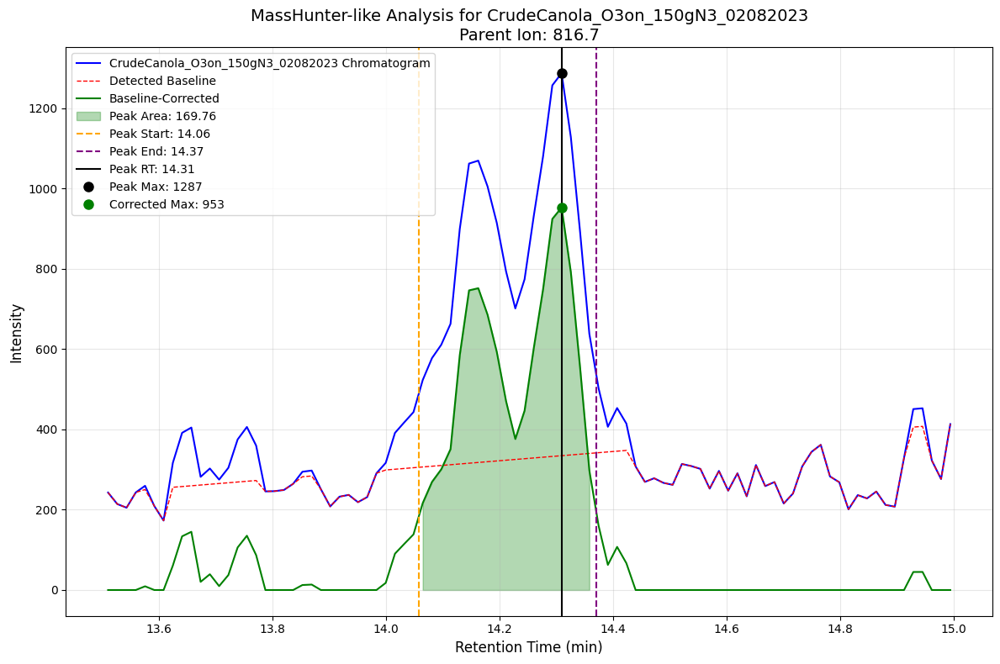

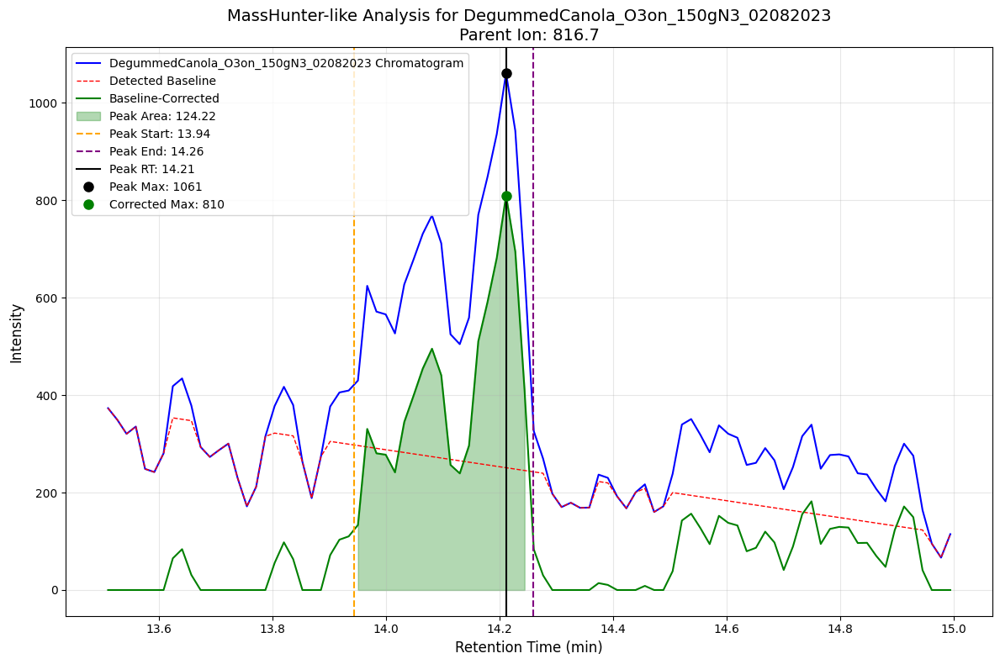

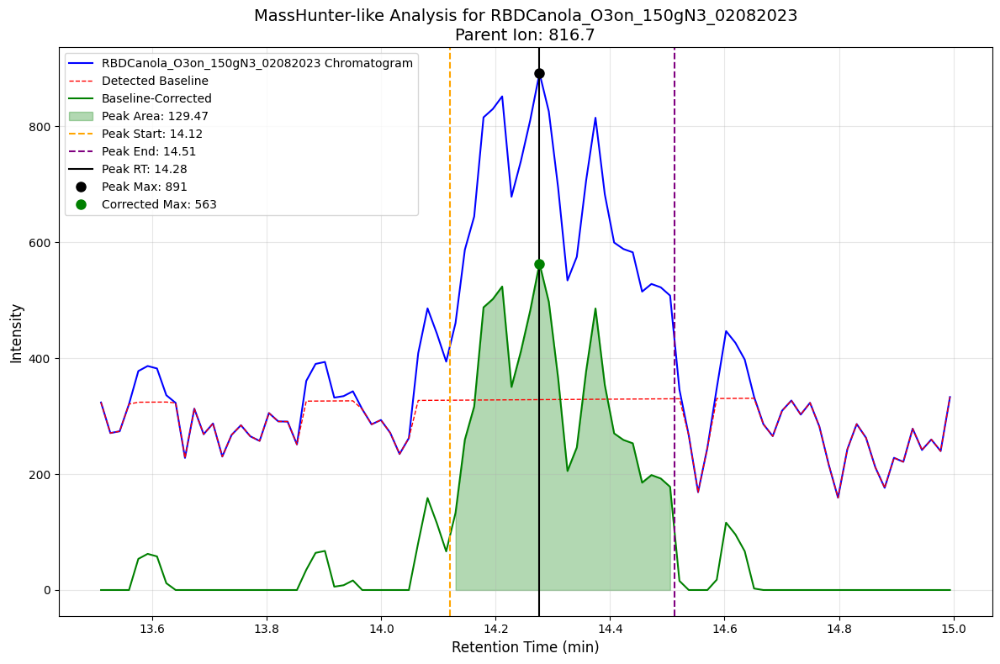


Summary of Peak Analysis Results:
                             Sample_ID   Peak_Area  Max_Original_Intensity  \
0     CrudeCanola_O3on_150gN3_02082023  169.763680             1287.480103   
1  DegummedCanola_O3on_150gN3_02082023  124.215601             1060.780029   
2       RBDCanola_O3on_150gN3_02082023  129.473405              891.480042   

   Max_Corrected_Intensity  Peak_Start  Peak_Stop    Peak_RT  
0               952.852674   14.057343  14.370694  14.309133  
1               809.747440   13.943220  14.259318  14.211317  
2               563.105102   14.119300  14.511915  14.276533  


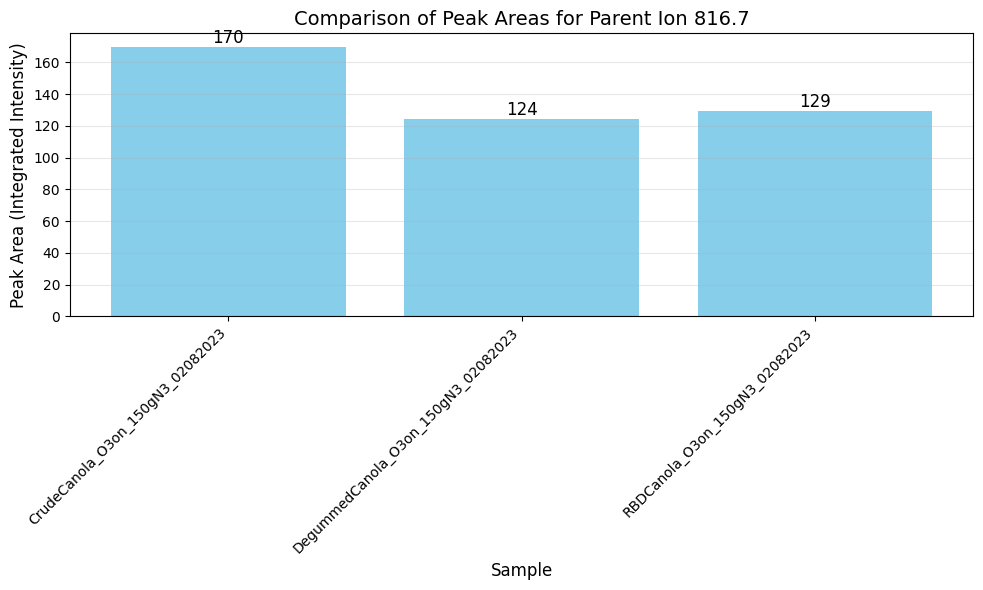


Relative Concentration Analysis:
                             Sample_ID   Peak_Area  Relative_Concentration
0     CrudeCanola_O3on_150gN3_02082023  169.763680               40.090354
1  DegummedCanola_O3on_150gN3_02082023  124.215601               29.333998
2       RBDCanola_O3on_150gN3_02082023  129.473405               30.575649


In [16]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from scipy.signal import find_peaks, peak_widths, savgol_filter
from scipy.interpolate import UnivariateSpline

# Define target parent ion and sample IDs
target_parent_ion = 816.7
sample_ids = [
    'CrudeCanola_O3on_150gN3_02082023',
    'DegummedCanola_O3on_150gN3_02082023',
    'RBDCanola_O3on_150gN3_02082023'
]

# List to hold our summary results
results = []

def detect_baseline(rt, intensity, peaks, smoothing_factor=0.3):
    """
    Detect baseline points (valleys) between peaks and fit a spline baseline.
    Similar to Agilent MassHunter's baseline detection algorithm.
    """
    # If no peaks found, return a flat baseline at the minimum intensity
    if len(peaks) == 0:
        return np.ones_like(intensity) * np.min(intensity)
    
    # Find potential valley points (local minima)
    valley_candidates = []
    valley_candidates.append(0)  # Start of chromatogram
    
    # Find valleys between peaks
    for i in range(len(peaks)-1):
        # Look for minimum point between consecutive peaks
        start_idx = peaks[i]
        end_idx = peaks[i+1]
        if start_idx < end_idx:
            min_idx = start_idx + np.argmin(intensity[start_idx:end_idx])
            valley_candidates.append(min_idx)
    
    valley_candidates.append(len(intensity)-1)  # End of chromatogram
    
    # Get coordinates of valley points
    valley_rt = rt[valley_candidates]
    valley_intensity = intensity[valley_candidates]
    
    # Fit a spline through the valley points
    if len(valley_rt) >= 4:  # Need at least 4 points for cubic spline
        baseline_spline = UnivariateSpline(valley_rt, valley_intensity, s=smoothing_factor*len(valley_rt))
        baseline = baseline_spline(rt)
    else:
        # Fallback to linear interpolation if too few points
        baseline = np.interp(rt, valley_rt, valley_intensity)
    
    # Ensure baseline doesn't go above the signal (Agilent-like constraint)
    for i in range(len(baseline)):
        if baseline[i] > intensity[i]:
            baseline[i] = intensity[i]
    
    return baseline

# Loop over each sample
for sample in sample_ids:
    # Filter the DataFrame for the given sample, parent ion, and retention time window 13.5-15 minutes
    subset = processed_df[
        (processed_df['Parent_Ion'] == target_parent_ion) &
        (processed_df['Sample_ID'] == sample) &
        (processed_df['Retention_Time'] >= 13.5) &
        (processed_df['Retention_Time'] <= 15)
    ].copy()
    
    # Group by Retention_Time and take the maximum OzESI_Intensity
    aggregated = subset.groupby('Retention_Time', as_index=False)['OzESI_Intensity'].max()
    aggregated.sort_values('Retention_Time', inplace=True)
    aggregated = aggregated.reset_index(drop=True)
    
    # Skip if no data is available
    if aggregated.empty:
        print(f"No data for sample {sample} in the specified retention time window.")
        continue

    # Apply Savitzky-Golay smoothing to reduce noise
    retention_times = aggregated['Retention_Time'].values
    intensity_array = aggregated['OzESI_Intensity'].values
    
    # Apply smoothing if we have enough data points
    if len(intensity_array) > 5:
        smoothed_intensity = savgol_filter(intensity_array, 5, 2)
    else:
        smoothed_intensity = intensity_array.copy()
    
    # Use SciPy to detect peaks in the smoothed chromatogram
    peaks, properties = find_peaks(smoothed_intensity, height=100, prominence=500)
    
    if len(peaks) == 0:
        print(f"No peaks found for sample {sample}.")
        continue
    
    # Detect baseline using MassHunter-like approach
    baseline = detect_baseline(retention_times, intensity_array, peaks, smoothing_factor=0.3)
    
    # Subtract baseline to get corrected intensity
    corrected_intensity = np.maximum(intensity_array - baseline, 0)  # Ensure non-negative
    
    # Apply smoothing to corrected intensity
    if len(corrected_intensity) > 5:
        smoothed_corrected = savgol_filter(corrected_intensity, 5, 2)
    else:
        smoothed_corrected = corrected_intensity.copy()
    
    # Find peaks again on baseline-corrected data
    peaks, properties = find_peaks(smoothed_corrected, height=50, prominence=250)
    
    if len(peaks) == 0:
        print(f"No peaks found in baseline-corrected data for sample {sample}.")
        continue
    
    # Select the most prominent peak (highest corrected intensity)
    peak_idx = peaks[np.argmax(smoothed_corrected[peaks])]
    peak_intensity = corrected_intensity[peak_idx]
    original_peak_intensity = intensity_array[peak_idx]
    
    # Use peak_widths to determine the boundaries at the given relative height
    widths, h_eval, left_ips, right_ips = peak_widths(smoothed_corrected, [peak_idx], rel_height=0.8)
    
    # Convert fractional indices to retention times
    peak_start_time = np.interp(left_ips[0], np.arange(len(retention_times)), retention_times)
    peak_stop_time = np.interp(right_ips[0], np.arange(len(retention_times)), retention_times)
    peak_rt = retention_times[peak_idx]
    
    # MassHunter-like constraint: ensure reasonable peak width
    if (peak_rt - peak_start_time) > 0.6:
        peak_start_time = peak_rt - 0.6
    if (peak_stop_time - peak_rt) > 0.6:
        peak_stop_time = peak_rt + 0.6
    
    # Calculate the area under the peak using the corrected intensity
    # Get the subset of data within the peak boundaries
    mask = (retention_times >= peak_start_time) & (retention_times <= peak_stop_time)
    x_integration = retention_times[mask]
    y_integration = corrected_intensity[mask]
    
    # If we have too few points in the peak, add interpolated points
    if len(x_integration) < 3:
        # Create more detailed x points
        x_detailed = np.linspace(peak_start_time, peak_stop_time, 20)
        # Interpolate y values
        y_detailed = np.interp(x_detailed, retention_times, corrected_intensity)
        # Use these for integration
        x_integration = x_detailed
        y_integration = y_detailed
    
    # Integrate using trapezoid rule on baseline-corrected data
    peak_area = np.trapz(y_integration, x_integration)
    
    # Save the results for this sample
    results.append({
        'Sample_ID': sample,
        'Peak_Area': peak_area,
        'Max_Original_Intensity': original_peak_intensity,
        'Max_Corrected_Intensity': peak_intensity,
        'Peak_Start': peak_start_time,
        'Peak_Stop': peak_stop_time,
        'Peak_RT': peak_rt
    })
    
    # Plot the chromatogram with enhanced visualization
    plt.figure(figsize=(12, 8))
    
    # Plot the original data
    plt.plot(retention_times, intensity_array, 'b-', linewidth=1.5, 
             label=f"{sample} Chromatogram")
    
    # Plot the baseline
    plt.plot(retention_times, baseline, 'r--', linewidth=1, 
             label="Detected Baseline")
    
    # Plot the corrected intensity
    plt.plot(retention_times, corrected_intensity, 'g-', linewidth=1.5, 
             label="Baseline-Corrected")
    
    # Shade the area under the detected peak (baseline-corrected)
    plt.fill_between(x_integration, y_integration, alpha=0.3, color='green', 
                     label=f"Peak Area: {peak_area:.2f}")
    
    # Add vertical lines for peak start, middle, and stop
    plt.axvline(x=peak_start_time, linestyle="--", color="orange", 
                label=f"Peak Start: {peak_start_time:.2f}")
    plt.axvline(x=peak_stop_time, linestyle="--", color="purple", 
                label=f"Peak End: {peak_stop_time:.2f}")
    plt.axvline(x=peak_rt, linestyle="-", color="black", 
                label=f"Peak RT: {peak_rt:.2f}")
    
    # Mark the detected peak
    plt.plot(peak_rt, original_peak_intensity, 'ko', markersize=8, 
             label=f"Peak Max: {original_peak_intensity:.0f}")
    plt.plot(peak_rt, peak_intensity, 'go', markersize=8, 
             label=f"Corrected Max: {peak_intensity:.0f}")
    
    plt.xlabel("Retention Time (min)", fontsize=12)
    plt.ylabel("Intensity", fontsize=12)
    plt.title(f"MassHunter-like Analysis for {sample}\nParent Ion: {target_parent_ion}", 
              fontsize=14)
    plt.legend(loc='upper left', fontsize=10)
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

# Create a DataFrame from the results and print it
results_df = pd.DataFrame(results)
print("\nSummary of Peak Analysis Results:")
print(results_df)

# Calculate relative concentrations (optional)
if len(results_df) > 0:
    results_df['Relative_Concentration'] = results_df['Peak_Area'] / results_df['Peak_Area'].sum() * 100
    
    # Create a bar chart to visualize peak areas across samples
    plt.figure(figsize=(10, 6))
    bars = plt.bar(results_df['Sample_ID'], results_df['Peak_Area'], color='skyblue')
    
    # Add value labels on top of bars
    for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2., height,
                 f'{height:.0f}',
                 ha='center', va='bottom', fontsize=12)
    
    plt.xlabel('Sample', fontsize=12)
    plt.ylabel('Peak Area (Integrated Intensity)', fontsize=12)
    plt.title(f'Comparison of Peak Areas for Parent Ion {target_parent_ion}', fontsize=14)
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.grid(True, alpha=0.3, axis='y')
    plt.show()
    
    print("\nRelative Concentration Analysis:")
    print(results_df[['Sample_ID', 'Peak_Area', 'Relative_Concentration']])

# 2 IDs at once to check ratio

Processing parent ion 1: 762.6 ± 0.3
Retention time window: 13.0 - 14.8 min


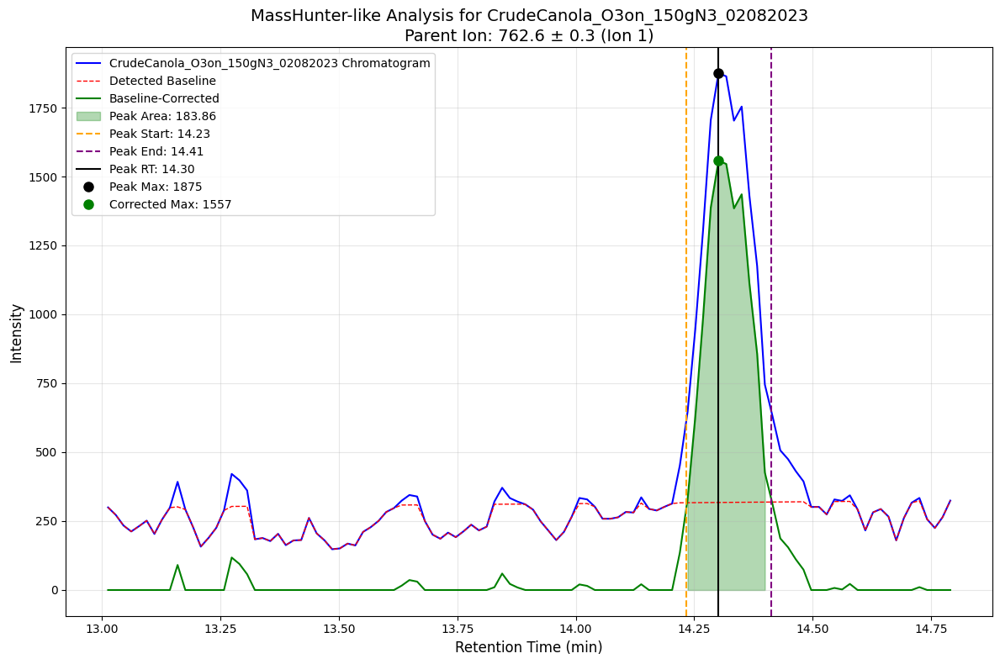

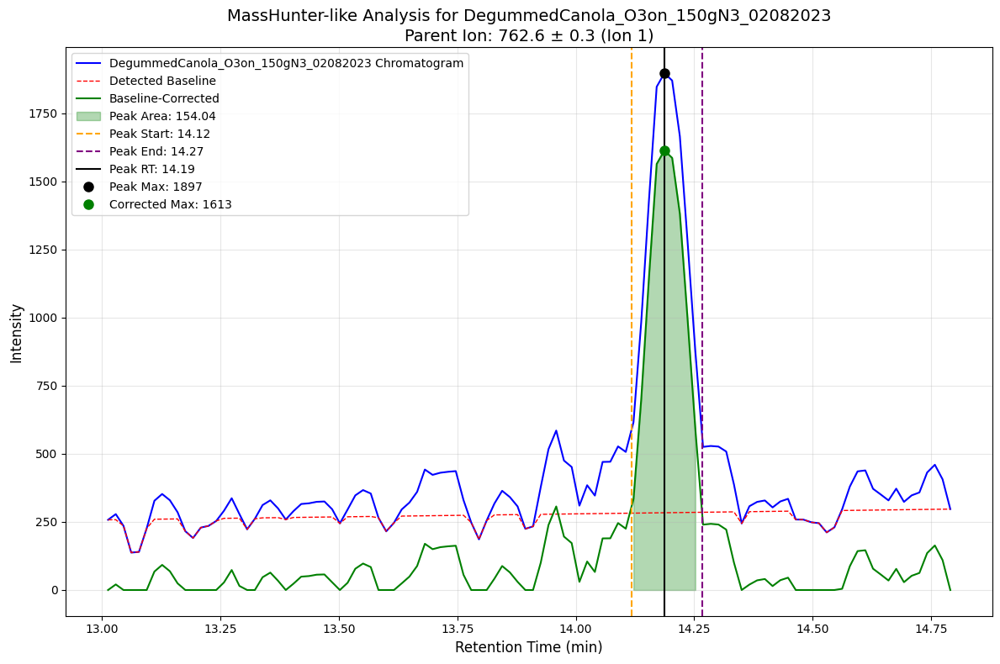

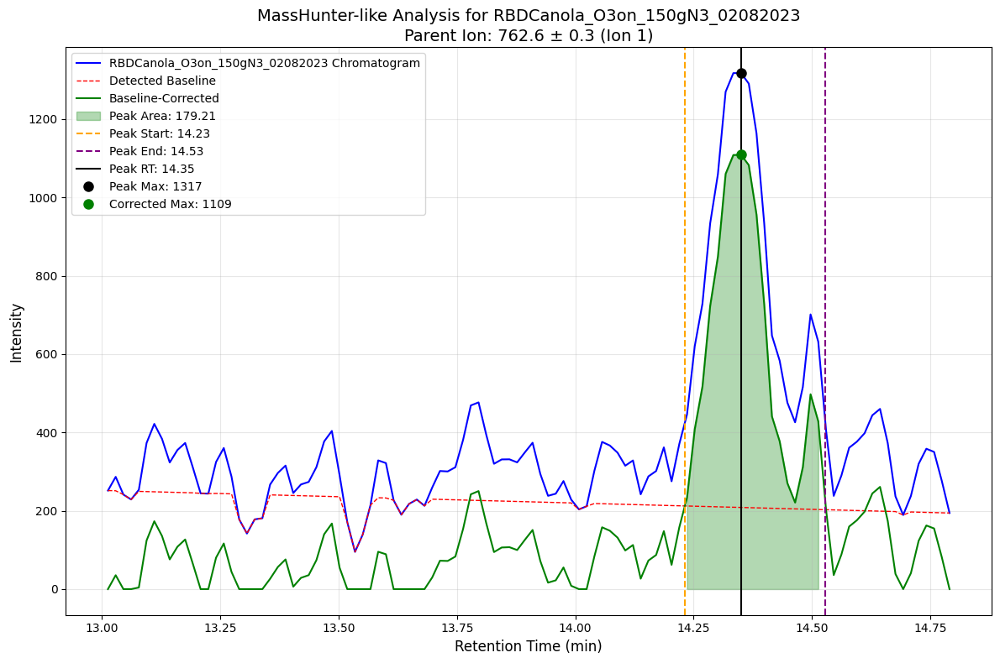


Processing parent ion 2: 790.8 ± 0.3
Retention time window: 13.0 - 14.8 min


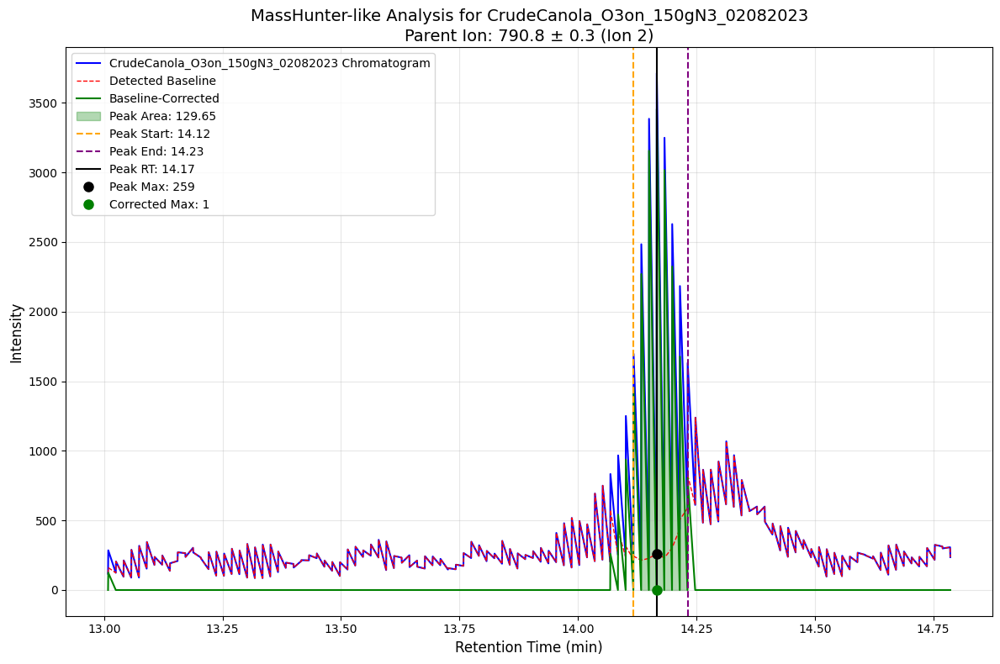

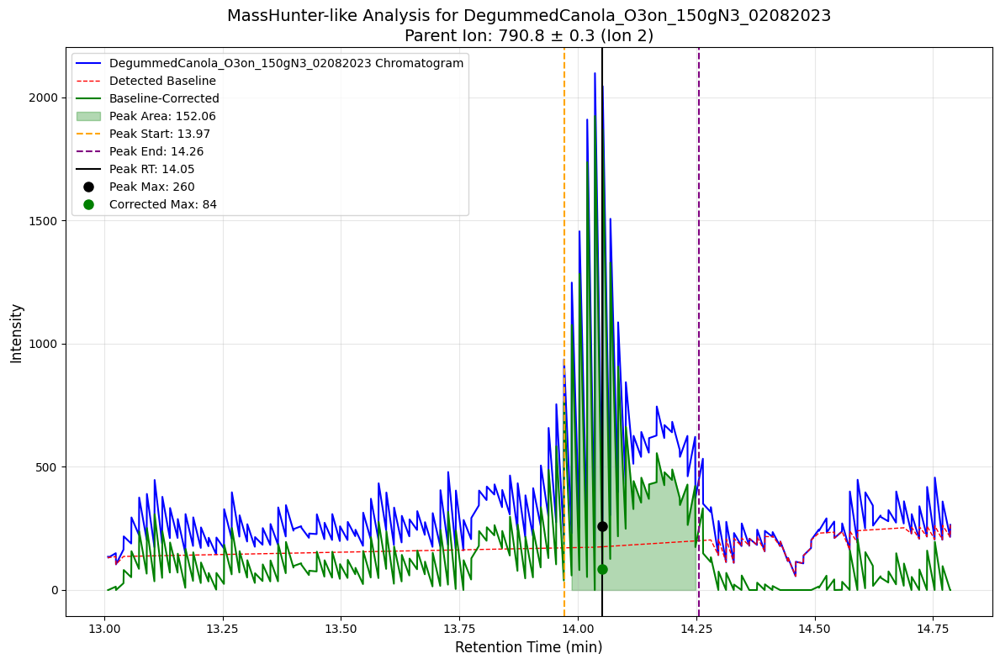

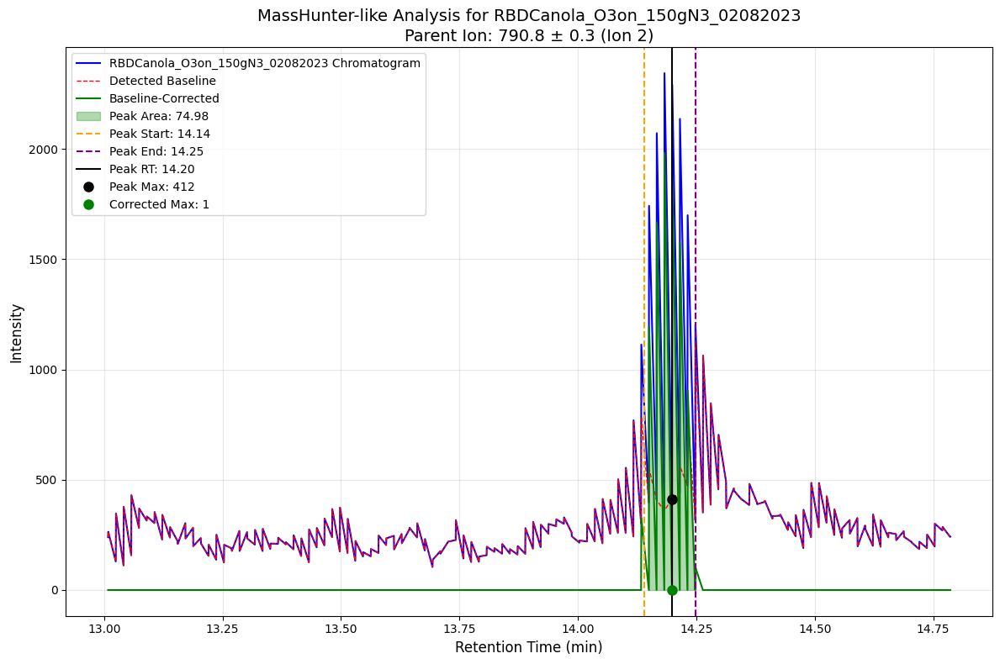


Summary of Peak Analysis Results for Ion 1:
                             Sample_ID  Parent_Ion   Peak_Area  \
0     CrudeCanola_O3on_150gN3_02082023       762.6  183.860285   
1  DegummedCanola_O3on_150gN3_02082023       762.6  154.042982   
2       RBDCanola_O3on_150gN3_02082023       762.6  179.210338   

   Max_Original_Intensity  Max_Corrected_Intensity  Peak_Start  Peak_Stop  \
0             1874.780151              1557.185919   14.233532  14.413012   
1             1896.600098              1613.033412   14.117333  14.266980   
2             1317.200073              1108.706412   14.231056  14.528644   

     Peak_RT  
0  14.301200  
1  14.187067  
2  14.350133  

Summary of Peak Analysis Results for Ion 2:
                             Sample_ID  Parent_Ion   Peak_Area  \
0     CrudeCanola_O3on_150gN3_02082023       790.8  129.645272   
1  DegummedCanola_O3on_150gN3_02082023       790.8  152.060101   
2       RBDCanola_O3on_150gN3_02082023       790.8   74.983848   

   Max_Orig

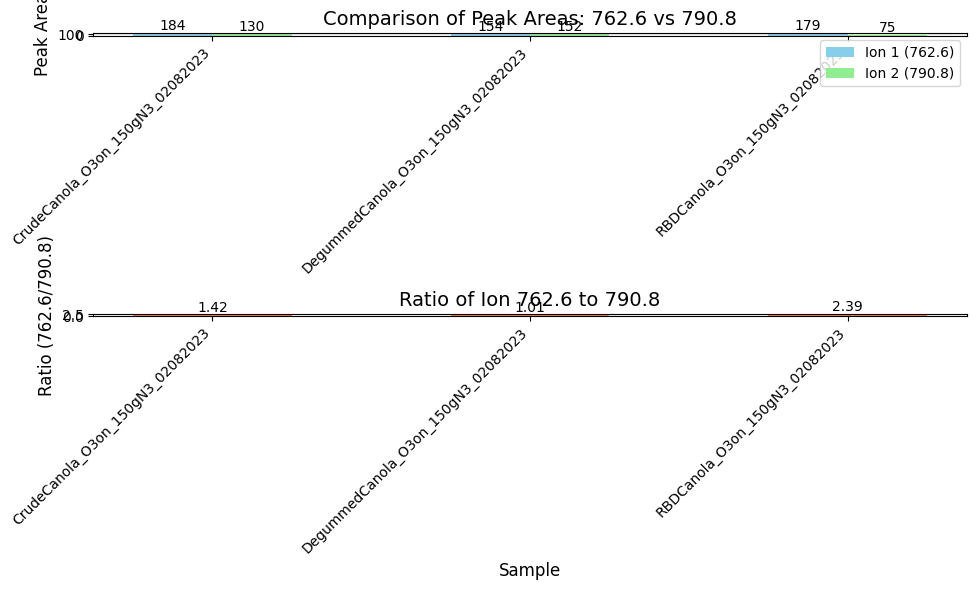


Final Summary Table:
                             Sample_ID   Ion1_Area   Ion2_Area  \
0     CrudeCanola_O3on_150gN3_02082023  183.860285  129.645272   
1  DegummedCanola_O3on_150gN3_02082023  154.042982  152.060101   
2       RBDCanola_O3on_150gN3_02082023  179.210338   74.983848   

   Ratio_Ion1_to_Ion2    Ion1_RT    Ion2_RT  
0            1.418180  14.301200  14.166100  
1            1.013040  14.187067  14.051967  
2            2.389986  14.350133  14.198717  


In [17]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from scipy.signal import find_peaks, peak_widths, savgol_filter
from scipy.interpolate import UnivariateSpline

# Define target parent ions, retention time window, and sample IDs
target_parent_ion_1 = 762.6
target_parent_ion_2 = 790.8  # Added second target ion
rt_start = 13.0  # Retention time start (min)
rt_end = 14.8  # Retention time end (min)
parent_ion_tolerance = 0.3  # Define tolerance parameter at ±0.3

sample_ids = [
    'CrudeCanola_O3on_150gN3_02082023',
    'DegummedCanola_O3on_150gN3_02082023',
    'RBDCanola_O3on_150gN3_02082023'
]

# List to hold our summary results for each ion
results_ion1 = []
results_ion2 = []

def detect_baseline(rt, intensity, peaks, smoothing_factor=0.3):
    """
    Detect baseline points (valleys) between peaks and fit a spline baseline.
    Similar to Agilent MassHunter's baseline detection algorithm.
    """
    # If no peaks found, return a flat baseline at the minimum intensity
    if len(peaks) == 0:
        return np.ones_like(intensity) * np.min(intensity)
    
    # Find potential valley points (local minima)
    valley_candidates = []
    valley_candidates.append(0)  # Start of chromatogram
    
    # Find valleys between peaks
    for i in range(len(peaks)-1):
        # Look for minimum point between consecutive peaks
        start_idx = peaks[i]
        end_idx = peaks[i+1]
        if start_idx < end_idx:
            min_idx = start_idx + np.argmin(intensity[start_idx:end_idx])
            valley_candidates.append(min_idx)
    
    valley_candidates.append(len(intensity)-1)  # End of chromatogram
    
    # Get coordinates of valley points
    valley_rt = rt[valley_candidates]
    valley_intensity = intensity[valley_candidates]
    
    # Fit a spline through the valley points
    if len(valley_rt) >= 4:  # Need at least 4 points for cubic spline
        baseline_spline = UnivariateSpline(valley_rt, valley_intensity, s=smoothing_factor*len(valley_rt))
        baseline = baseline_spline(rt)
    else:
        # Fallback to linear interpolation if too few points
        baseline = np.interp(rt, valley_rt, valley_intensity)
    
    # Ensure baseline doesn't go above the signal (Agilent-like constraint)
    for i in range(len(baseline)):
        if baseline[i] > intensity[i]:
            baseline[i] = intensity[i]
    
    return baseline

def process_ion(target_parent_ion, results_list, plot_title_suffix=""):
    """
    Process a target parent ion across all samples and store results
    """
    # Loop over each sample
    for sample in sample_ids:
        # Filter the DataFrame for the given sample, parent ion (with tolerance), and retention time window
        subset = processed_df[
            (processed_df['Parent_Ion'] >= target_parent_ion - parent_ion_tolerance) &
            (processed_df['Parent_Ion'] <= target_parent_ion + parent_ion_tolerance) &
            (processed_df['Sample_ID'] == sample) &
            (processed_df['Retention_Time'] >= rt_start) &
            (processed_df['Retention_Time'] <= rt_end)
        ].copy()
        
        # Group by Retention_Time and take the maximum OzESI_Intensity
        aggregated = subset.groupby('Retention_Time', as_index=False)['OzESI_Intensity'].max()
        aggregated.sort_values('Retention_Time', inplace=True)
        aggregated = aggregated.reset_index(drop=True)
        
        # Skip if no data is available
        if aggregated.empty:
            print(f"No data for sample {sample}, parent ion {target_parent_ion} in the specified retention time window.")
            # Still add a record with zero values so we can calculate ratios later
            results_list.append({
                'Sample_ID': sample,
                'Parent_Ion': target_parent_ion,
                'Peak_Area': 0,
                'Max_Original_Intensity': 0,
                'Max_Corrected_Intensity': 0,
                'Peak_Start': 0,
                'Peak_Stop': 0,
                'Peak_RT': 0
            })
            continue

        # Apply Savitzky-Golay smoothing to reduce noise
        retention_times = aggregated['Retention_Time'].values
        intensity_array = aggregated['OzESI_Intensity'].values
        
        # Apply smoothing if we have enough data points
        if len(intensity_array) > 5:
            smoothed_intensity = savgol_filter(intensity_array, 5, 2)
        else:
            smoothed_intensity = intensity_array.copy()
        
        # Use SciPy to detect peaks in the smoothed chromatogram
        peaks, properties = find_peaks(smoothed_intensity, height=100, prominence=500)
        
        if len(peaks) == 0:
            print(f"No peaks found for sample {sample}, parent ion {target_parent_ion}.")
            # Add zero record for ratio calculation
            results_list.append({
                'Sample_ID': sample,
                'Parent_Ion': target_parent_ion,
                'Peak_Area': 0,
                'Max_Original_Intensity': 0,
                'Max_Corrected_Intensity': 0,
                'Peak_Start': 0,
                'Peak_Stop': 0,
                'Peak_RT': 0
            })
            continue
        
        # Detect baseline using MassHunter-like approach
        baseline = detect_baseline(retention_times, intensity_array, peaks, smoothing_factor=0.3)
        
        # Subtract baseline to get corrected intensity
        corrected_intensity = np.maximum(intensity_array - baseline, 0)  # Ensure non-negative
        
        # Apply smoothing to corrected intensity
        if len(corrected_intensity) > 5:
            smoothed_corrected = savgol_filter(corrected_intensity, 5, 2)
        else:
            smoothed_corrected = corrected_intensity.copy()
        
        # Find peaks again on baseline-corrected data
        peaks, properties = find_peaks(smoothed_corrected, height=50, prominence=250)
        
        if len(peaks) == 0:
            print(f"No peaks found in baseline-corrected data for sample {sample}, parent ion {target_parent_ion}.")
            # Add zero record for ratio calculation
            results_list.append({
                'Sample_ID': sample,
                'Parent_Ion': target_parent_ion,
                'Peak_Area': 0,
                'Max_Original_Intensity': 0,
                'Max_Corrected_Intensity': 0,
                'Peak_Start': 0,
                'Peak_Stop': 0,
                'Peak_RT': 0
            })
            continue
        
        # Select the most prominent peak (highest corrected intensity)
        peak_idx = peaks[np.argmax(smoothed_corrected[peaks])]
        peak_intensity = corrected_intensity[peak_idx]
        original_peak_intensity = intensity_array[peak_idx]
        
        # Use peak_widths to determine the boundaries at the given relative height
        widths, h_eval, left_ips, right_ips = peak_widths(smoothed_corrected, [peak_idx], rel_height=0.8)
        
        # Convert fractional indices to retention times
        peak_start_time = np.interp(left_ips[0], np.arange(len(retention_times)), retention_times)
        peak_stop_time = np.interp(right_ips[0], np.arange(len(retention_times)), retention_times)
        peak_rt = retention_times[peak_idx]
        
        # MassHunter-like constraint: ensure reasonable peak width
        if (peak_rt - peak_start_time) > 0.6:
            peak_start_time = peak_rt - 0.6
        if (peak_stop_time - peak_rt) > 0.6:
            peak_stop_time = peak_rt + 0.6
        
        # Calculate the area under the peak using the corrected intensity
        # Get the subset of data within the peak boundaries
        mask = (retention_times >= peak_start_time) & (retention_times <= peak_stop_time)
        x_integration = retention_times[mask]
        y_integration = corrected_intensity[mask]
        
        # If we have too few points in the peak, add interpolated points
        if len(x_integration) < 3:
            # Create more detailed x points
            x_detailed = np.linspace(peak_start_time, peak_stop_time, 20)
            # Interpolate y values
            y_detailed = np.interp(x_detailed, retention_times, corrected_intensity)
            # Use these for integration
            x_integration = x_detailed
            y_integration = y_detailed
        
        # Integrate using trapezoid rule on baseline-corrected data
        peak_area = np.trapz(y_integration, x_integration)
        
        # Save the results for this sample
        results_list.append({
            'Sample_ID': sample,
            'Parent_Ion': target_parent_ion,
            'Peak_Area': peak_area,
            'Max_Original_Intensity': original_peak_intensity,
            'Max_Corrected_Intensity': peak_intensity,
            'Peak_Start': peak_start_time,
            'Peak_Stop': peak_stop_time,
            'Peak_RT': peak_rt
        })
        
        # Plot the chromatogram with enhanced visualization
        plt.figure(figsize=(12, 8))
        
        # Plot the original data
        plt.plot(retention_times, intensity_array, 'b-', linewidth=1.5, 
                 label=f"{sample} Chromatogram")
        
        # Plot the baseline
        plt.plot(retention_times, baseline, 'r--', linewidth=1, 
                 label="Detected Baseline")
        
        # Plot the corrected intensity
        plt.plot(retention_times, corrected_intensity, 'g-', linewidth=1.5, 
                 label="Baseline-Corrected")
        
        # Shade the area under the detected peak (baseline-corrected)
        plt.fill_between(x_integration, y_integration, alpha=0.3, color='green', 
                         label=f"Peak Area: {peak_area:.2f}")
        
        # Add vertical lines for peak start, middle, and stop
        plt.axvline(x=peak_start_time, linestyle="--", color="orange", 
                    label=f"Peak Start: {peak_start_time:.2f}")
        plt.axvline(x=peak_stop_time, linestyle="--", color="purple", 
                    label=f"Peak End: {peak_stop_time:.2f}")
        plt.axvline(x=peak_rt, linestyle="-", color="black", 
                    label=f"Peak RT: {peak_rt:.2f}")
        
        # Mark the detected peak
        plt.plot(peak_rt, original_peak_intensity, 'ko', markersize=8, 
                 label=f"Peak Max: {original_peak_intensity:.0f}")
        plt.plot(peak_rt, peak_intensity, 'go', markersize=8, 
                 label=f"Corrected Max: {peak_intensity:.0f}")
        
        plt.xlabel("Retention Time (min)", fontsize=12)
        plt.ylabel("Intensity", fontsize=12)
        plt.title(f"MassHunter-like Analysis for {sample}\nParent Ion: {target_parent_ion} ± {parent_ion_tolerance} {plot_title_suffix}", 
                  fontsize=14)
        plt.legend(loc='upper left', fontsize=10)
        plt.grid(True, alpha=0.3)
        plt.tight_layout()
        plt.show()

# Process each ion
print(f"Processing parent ion 1: {target_parent_ion_1} ± {parent_ion_tolerance}")
print(f"Retention time window: {rt_start} - {rt_end} min")
process_ion(target_parent_ion_1, results_ion1, "(Ion 1)")

print(f"\nProcessing parent ion 2: {target_parent_ion_2} ± {parent_ion_tolerance}")
print(f"Retention time window: {rt_start} - {rt_end} min")
process_ion(target_parent_ion_2, results_ion2, "(Ion 2)")

# Create DataFrames from the results
results_df_ion1 = pd.DataFrame(results_ion1)
results_df_ion2 = pd.DataFrame(results_ion2)

# Print individual results
print("\nSummary of Peak Analysis Results for Ion 1:")
print(results_df_ion1)

print("\nSummary of Peak Analysis Results for Ion 2:")
print(results_df_ion2)

# Calculate ratios (ion1/ion2) for each sample
ratio_results = []

for sample in sample_ids:
    # Get peak areas for this sample
    ion1_data = results_df_ion1[results_df_ion1['Sample_ID'] == sample]
    ion2_data = results_df_ion2[results_df_ion2['Sample_ID'] == sample]
    
    if not ion1_data.empty and not ion2_data.empty:
        ion1_area = ion1_data['Peak_Area'].values[0]
        ion2_area = ion2_data['Peak_Area'].values[0]
        
        # Calculate ratio (handle division by zero)
        if ion2_area > 0:
            ratio = ion1_area / ion2_area
        else:
            ratio = float('inf') if ion1_area > 0 else float('nan')
        
        ratio_results.append({
            'Sample_ID': sample,
            'Ion1_Area': ion1_area,
            'Ion2_Area': ion2_area,
            'Ratio_Ion1_to_Ion2': ratio
        })

# Create DataFrame for ratios
ratio_df = pd.DataFrame(ratio_results)
print("\nIon Ratio Analysis (Ion1/Ion2):")
print(ratio_df)

# Plot ratio comparison
plt.figure(figsize=(10, 6))

# Plot individual areas as grouped bars
x = np.arange(len(sample_ids))
width = 0.25

# For visual clarity, normalize peak areas to the maximum value before plotting
max_area = max(max(ratio_df['Ion1_Area']), max(ratio_df['Ion2_Area']))
if max_area > 0:
    normalized_ion1 = ratio_df['Ion1_Area'] / max_area
    normalized_ion2 = ratio_df['Ion2_Area'] / max_area
else:
    normalized_ion1 = ratio_df['Ion1_Area']
    normalized_ion2 = ratio_df['Ion2_Area']

# Create the bar plot
plt.subplot(2, 1, 1)
bars1 = plt.bar(x - width/2, ratio_df['Ion1_Area'], width, label=f'Ion 1 ({target_parent_ion_1})', color='skyblue')
bars2 = plt.bar(x + width/2, ratio_df['Ion2_Area'], width, label=f'Ion 2 ({target_parent_ion_2})', color='lightgreen')

# Add value labels on top of bars
for bar in bars1:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{height:.0f}',
             ha='center', va='bottom', fontsize=10)
             
for bar in bars2:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{height:.0f}',
             ha='center', va='bottom', fontsize=10)

plt.ylabel('Peak Area', fontsize=12)
plt.xticks(x, ratio_df['Sample_ID'], rotation=45, ha='right')
plt.title(f'Comparison of Peak Areas: {target_parent_ion_1} vs {target_parent_ion_2}', fontsize=14)
plt.legend()
plt.grid(True, alpha=0.3, axis='y')

# Plot ratios in the second subplot
plt.subplot(2, 1, 2)
bars3 = plt.bar(x, ratio_df['Ratio_Ion1_to_Ion2'], width*2, color='coral')

# Add value labels on top of ratio bars
for bar in bars3:
    height = bar.get_height()
    if not np.isnan(height) and not np.isinf(height):
        plt.text(bar.get_x() + bar.get_width()/2., height,
                f'{height:.2f}',
                ha='center', va='bottom', fontsize=10)
    elif np.isinf(height):
        plt.text(bar.get_x() + bar.get_width()/2., plt.ylim()[1]*0.9,
                "∞",
                ha='center', va='bottom', fontsize=12)

plt.xlabel('Sample', fontsize=12)
plt.ylabel(f'Ratio ({target_parent_ion_1}/{target_parent_ion_2})', fontsize=12)
plt.xticks(x, ratio_df['Sample_ID'], rotation=45, ha='right')
plt.title(f'Ratio of Ion {target_parent_ion_1} to {target_parent_ion_2}', fontsize=14)
plt.grid(True, alpha=0.3, axis='y')

plt.tight_layout()
plt.show()

# Create a combined summary table with all information
summary_df = pd.merge(
    ratio_df, 
    results_df_ion1[['Sample_ID', 'Peak_RT']],
    on='Sample_ID',
    suffixes=('', '_ion1')
)
summary_df = pd.merge(
    summary_df,
    results_df_ion2[['Sample_ID', 'Peak_RT']],
    on='Sample_ID',
    suffixes=('', '_ion2')
)

# Rename columns for clarity
summary_df.rename(columns={
    'Peak_RT': 'Ion1_RT',
    'Peak_RT_ion2': 'Ion2_RT'
}, inplace=True)

print("\nFinal Summary Table:")
print(summary_df[['Sample_ID', 'Ion1_Area', 'Ion2_Area', 'Ratio_Ion1_to_Ion2', 'Ion1_RT', 'Ion2_RT']])

# CLAUDE 14apr25

### Main Processing Section - Lipidomics Data Processing and Double-Bond Location Analysis

The code block initiates the data refining process by filtering the retention time from the `df_oz_matched` DataFrame using the `filter_rt()` function and concatenating this DataFrame with `df_matched` via `concat_dataframes()`. The resulting DataFrame is then enriched by adding the positional isomers and lipid information for specified double bond positions (here, 7, 9, 12) through the `DB_Position_df()` and `add_lipid_info()` functions respectively. Following sorting by 'Sample_ID' and 'Product_Ion', the `calculate_intensity_ratio()` function is employed to calculate and append intensity ratios to the DataFrame. Afterward, lipid species in the 'Lipid' column are sorted by their second triacylglycerol (TG) components. Lastly, the `filter_highest_ratios()` function is used to filter and keep rows with the highest intensity ratios, resulting in a more concise and useful DataFrame `df_matched_6`.

In [18]:
# Import the OzESIFilter class from the OzESIFilter.py file
from OzESI_filter import OzESIFilter

# Create an instance of OzESIFilter with a tolerance of 0.3
oz_filter = OzESIFilter(tolerance=0.3)

# Run all filtering steps in one call.
# (Ensure that df_OzESI_matched is defined in your notebook.)
final_df = oz_filter.run_all(
    df=processed_df, #df_OzESI_matched
    min_rt=10,
    max_rt=23,
    min_intensity=100,
    db_pos_list=[7, 9, 12],
    sort_by_columns=['Sample_ID', 'Product_Ion'],
    save_csv_path='Projects/canola/results/df_OzESI_5_ratio_peakarea_09feb25.csv'
)

# Display the final processed DataFrame.
final_df


,Class,Lipid,OzESI_Intensity,Parent_Ion,Product_Ion,Retention_Time,Sample_ID,Transition,baseline,corrected_intensity,peak_area,peak_start,peak_stop,peak_middle,is_special_case,n-7,n-9,n-12,db_pos,Ratio
111,NaN,TG(52:2)]_FA18:1,16153.0,766.7,577.596,18.05,CrudeCanola_O3on_150gN3_02082023,766.7 -> 577.596,960.648370,15192.472723,1655.398908,17.913569,18.154993,18.034800,0,684.7,656.7,614.7,n-9,4.234076
27,TAG,TG(52:2)]_FA18:1,102684.0,876.8,577.596,18.04,CrudeCanola_O3on_150gN3_02082023,876.8 -> 577.596,8872.171601,93812.133087,10908.848435,17.894582,18.153708,18.039483,0,794.8,766.8,724.8,,NaN
171,NaN,TG(52:2)]_FA18:1,3815.0,794.7,577.596,18.05,CrudeCanola_O3on_150gN3_02082023,794.7 -> 577.596,261.368631,3553.591574,726.699892,17.445533,18.315173,18.045533,0,712.7,684.7,642.7,n-7,NaN
108,NaN,TG(52:3)]_FA18:1,3420.0,764.6,575.596,16.09,CrudeCanola_O3on_150gN3_02082023,764.6 -> 575.596,359.842054,3059.978259,790.645868,15.494617,16.694617,16.094617,0,682.6,654.6,612.6,n-9,3.157895
26,TAG,TG(52:3)]_FA18:1,22411.0,874.8,575.596,16.12,CrudeCanola_O3on_150gN3_02082023,874.8 -> 575.596,3409.707222,19001.214653,2386.797015,15.905273,16.219727,16.115617,0,792.8,764.8,722.8,,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
98,TAG,[TG(54:5)]_FA18:1,12850.0,898.8,599.596,14.34,RBDCanola_O3on_150gN3_02082023,898.8 -> 599.596,330.726637,12518.994066,2464.427699,14.089890,14.621881,14.336167,0,816.8,788.8,746.8,,NaN
369,NaN,[TG(54:5)]_FA18:1,891.0,816.7,599.596,14.28,RBDCanola_O3on_150gN3_02082023,816.7 -> 599.596,232.726163,658.753878,184.980293,14.039124,14.541161,14.276533,0,734.7,706.7,664.7,n-7,NaN
314,NaN,[TG(54:6)]_FA18:1,587.0,786.6,597.596,19.48,RBDCanola_O3on_150gN3_02082023,786.6 -> 597.596,-894719.402432,895306.662503,NaN,NaN,NaN,NaN,0,704.6,676.6,634.6,n-9,1.059567
97,TAG,[TG(54:6)]_FA18:1,1138.0,896.8,597.596,12.43,RBDCanola_O3on_150gN3_02082023,896.8 -> 597.596,131.080631,1006.419491,185.803030,12.317190,13.028617,12.428617,0,814.8,786.8,744.8,,NaN


In [19]:
final_df

,Class,Lipid,OzESI_Intensity,Parent_Ion,Product_Ion,Retention_Time,Sample_ID,Transition,baseline,corrected_intensity,peak_area,peak_start,peak_stop,peak_middle,is_special_case,n-7,n-9,n-12,db_pos,Ratio
111,NaN,TG(52:2)]_FA18:1,16153.0,766.7,577.596,18.05,CrudeCanola_O3on_150gN3_02082023,766.7 -> 577.596,960.648370,15192.472723,1655.398908,17.913569,18.154993,18.034800,0,684.7,656.7,614.7,n-9,4.234076
27,TAG,TG(52:2)]_FA18:1,102684.0,876.8,577.596,18.04,CrudeCanola_O3on_150gN3_02082023,876.8 -> 577.596,8872.171601,93812.133087,10908.848435,17.894582,18.153708,18.039483,0,794.8,766.8,724.8,,NaN
171,NaN,TG(52:2)]_FA18:1,3815.0,794.7,577.596,18.05,CrudeCanola_O3on_150gN3_02082023,794.7 -> 577.596,261.368631,3553.591574,726.699892,17.445533,18.315173,18.045533,0,712.7,684.7,642.7,n-7,NaN
108,NaN,TG(52:3)]_FA18:1,3420.0,764.6,575.596,16.09,CrudeCanola_O3on_150gN3_02082023,764.6 -> 575.596,359.842054,3059.978259,790.645868,15.494617,16.694617,16.094617,0,682.6,654.6,612.6,n-9,3.157895
26,TAG,TG(52:3)]_FA18:1,22411.0,874.8,575.596,16.12,CrudeCanola_O3on_150gN3_02082023,874.8 -> 575.596,3409.707222,19001.214653,2386.797015,15.905273,16.219727,16.115617,0,792.8,764.8,722.8,,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
98,TAG,[TG(54:5)]_FA18:1,12850.0,898.8,599.596,14.34,RBDCanola_O3on_150gN3_02082023,898.8 -> 599.596,330.726637,12518.994066,2464.427699,14.089890,14.621881,14.336167,0,816.8,788.8,746.8,,NaN
369,NaN,[TG(54:5)]_FA18:1,891.0,816.7,599.596,14.28,RBDCanola_O3on_150gN3_02082023,816.7 -> 599.596,232.726163,658.753878,184.980293,14.039124,14.541161,14.276533,0,734.7,706.7,664.7,n-7,NaN
314,NaN,[TG(54:6)]_FA18:1,587.0,786.6,597.596,19.48,RBDCanola_O3on_150gN3_02082023,786.6 -> 597.596,-894719.402432,895306.662503,NaN,NaN,NaN,NaN,0,704.6,676.6,634.6,n-9,1.059567
97,TAG,[TG(54:6)]_FA18:1,1138.0,896.8,597.596,12.43,RBDCanola_O3on_150gN3_02082023,896.8 -> 597.596,131.080631,1006.419491,185.803030,12.317190,13.028617,12.428617,0,814.8,786.8,744.8,,NaN


# Final Dataframe Organization

### Previewing Processed Lipidomics Data

This cell provides a snapshot of the fully processed and enriched lipidomics data set. At this stage, the dataframe includes the integrated information of lipid identities, their specific double-bond locations, and other pertinent characteristics. This prepared data is now ready to be exported for subsequent exploratory and statistical analyses, including visualization and deeper statistical analysis.

In [20]:
df_OzESI_5_ratio_final = final_df.copy()
# Replace TAG with TG and DAG with DG in 'Class' and 'Lipid' columns
df_OzESI_5_ratio_final['Class'] = df_OzESI_5_ratio_final['Class'].replace({'TAG': 'TG', 'DAG': 'DG'})
df_OzESI_5_ratio_final['Lipid'] = df_OzESI_5_ratio_final['Lipid'].str.replace('TAG', 'TG').str.replace('DAG', 'DG')

# Rename the 'Parent_Ion' column to 'Precursor_Ion'
df_OzESI_5_ratio_final = df_OzESI_5_ratio_final.rename(columns={'Parent_Ion': 'Precursor_Ion'})

# Round the 'Ratio' column to 2 decimal places
df_OzESI_5_ratio_final['Ratio'] = df_OzESI_5_ratio_final['Ratio'].round(2)



# #df_OzESI df to csv and excel file
# df_OzESI_5_ratio_final.to_csv('Projects/canola/results/CLAW_CanolaOil_OzESI_PeakArea_dataframe09Feb25.csv', index=False)
# df_OzESI_5_ratio_final.to_excel('Projects/canola/results/CLAW_CanolaOil_OzESI_PeakArea_dataframe09Feb25.xlsx', index=False)
df_OzESI_5_ratio_final.head(None)

,Class,Lipid,OzESI_Intensity,Precursor_Ion,Product_Ion,Retention_Time,Sample_ID,Transition,baseline,corrected_intensity,peak_area,peak_start,peak_stop,peak_middle,is_special_case,n-7,n-9,n-12,db_pos,Ratio
111,NaN,TG(52:2)]_FA18:1,16153.0,766.7,577.596,18.05,CrudeCanola_O3on_150gN3_02082023,766.7 -> 577.596,960.648370,15192.472723,1655.398908,17.913569,18.154993,18.034800,0,684.7,656.7,614.7,n-9,4.23
27,TG,TG(52:2)]_FA18:1,102684.0,876.8,577.596,18.04,CrudeCanola_O3on_150gN3_02082023,876.8 -> 577.596,8872.171601,93812.133087,10908.848435,17.894582,18.153708,18.039483,0,794.8,766.8,724.8,,NaN
171,NaN,TG(52:2)]_FA18:1,3815.0,794.7,577.596,18.05,CrudeCanola_O3on_150gN3_02082023,794.7 -> 577.596,261.368631,3553.591574,726.699892,17.445533,18.315173,18.045533,0,712.7,684.7,642.7,n-7,NaN
108,NaN,TG(52:3)]_FA18:1,3420.0,764.6,575.596,16.09,CrudeCanola_O3on_150gN3_02082023,764.6 -> 575.596,359.842054,3059.978259,790.645868,15.494617,16.694617,16.094617,0,682.6,654.6,612.6,n-9,3.16
26,TG,TG(52:3)]_FA18:1,22411.0,874.8,575.596,16.12,CrudeCanola_O3on_150gN3_02082023,874.8 -> 575.596,3409.707222,19001.214653,2386.797015,15.905273,16.219727,16.115617,0,792.8,764.8,722.8,,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
98,TG,[TG(54:5)]_FA18:1,12850.0,898.8,599.596,14.34,RBDCanola_O3on_150gN3_02082023,898.8 -> 599.596,330.726637,12518.994066,2464.427699,14.089890,14.621881,14.336167,0,816.8,788.8,746.8,,NaN
369,NaN,[TG(54:5)]_FA18:1,891.0,816.7,599.596,14.28,RBDCanola_O3on_150gN3_02082023,816.7 -> 599.596,232.726163,658.753878,184.980293,14.039124,14.541161,14.276533,0,734.7,706.7,664.7,n-7,NaN
314,NaN,[TG(54:6)]_FA18:1,587.0,786.6,597.596,19.48,RBDCanola_O3on_150gN3_02082023,786.6 -> 597.596,-894719.402432,895306.662503,NaN,NaN,NaN,NaN,0,704.6,676.6,634.6,n-9,1.06
97,TG,[TG(54:6)]_FA18:1,1138.0,896.8,597.596,12.43,RBDCanola_O3on_150gN3_02082023,896.8 -> 597.596,131.080631,1006.419491,185.803030,12.317190,13.028617,12.428617,0,814.8,786.8,744.8,,NaN


In [21]:
# Drop NaN values in the Lipid column, get unique values, and count them
unique_lipids = df_OzESI_5_ratio_final['Lipid'].dropna().unique()

# Print each unique lipid
for lipid in unique_lipids:
    print(lipid)

# Print the total number of unique lipids
print(f"\nTotal unique Lipid values: {len(unique_lipids)}")


TG(52:2)]_FA18:1
TG(52:3)]_FA18:1
TG(53:0)]_FA18:1
TG(54:2)]_FA18:1
TG(54:3)]_FA18:1
TG(54:4)]_FA18:1
[TG(52:4)]_FA18:1
[TG(52:5)]_FA18:1
[TG(52:6)]_FA18:1
[TG(54:5)]_FA18:1
[TG(54:6)]_FA18:1

Total unique Lipid values: 11


### Convert to 3 seperate df for each sample type (Crude, degummed, RBD)

In [22]:
# Get the unique Sample_IDs
unique_sample_ids = df_OzESI_5_ratio_final['Sample_ID'].unique()

# Create separate DataFrames for each Sample_ID
df_sample1 = df_OzESI_5_ratio_final[df_OzESI_5_ratio_final['Sample_ID'] == unique_sample_ids[0]].reset_index(drop=True)
df_sample2 = df_OzESI_5_ratio_final[df_OzESI_5_ratio_final['Sample_ID'] == unique_sample_ids[1]].reset_index(drop=True)
df_sample3 = df_OzESI_5_ratio_final[df_OzESI_5_ratio_final['Sample_ID'] == unique_sample_ids[2]].reset_index(drop=True)

# Optionally, print the DataFrames to verify
print("DataFrame for Sample_ID:", unique_sample_ids[0])
print(df_sample1)

print("\nDataFrame for Sample_ID:", unique_sample_ids[1])
print(df_sample2)

print("\nDataFrame for Sample_ID:", unique_sample_ids[2])
print(df_sample3)

unique_sample_ids = df_OzESI_5_ratio_final['Sample_ID'].unique()
df_sample1 = df_OzESI_5_ratio_final[df_OzESI_5_ratio_final['Sample_ID'] == unique_sample_ids[0]].reset_index(drop=True)
df_sample2 = df_OzESI_5_ratio_final[df_OzESI_5_ratio_final['Sample_ID'] == unique_sample_ids[1]].reset_index(drop=True)
df_sample3 = df_OzESI_5_ratio_final[df_OzESI_5_ratio_final['Sample_ID'] == unique_sample_ids[2]].reset_index(drop=True)
# Assuming your Sample_IDs are descriptive
df_CrudeCanola = df_OzESI_5_ratio_final[df_OzESI_5_ratio_final['Sample_ID'] == 'CrudeCanola_O3on_150gN3_02082023'].reset_index(drop=True)
df_RBDCanola = df_OzESI_5_ratio_final[df_OzESI_5_ratio_final['Sample_ID'] == 'RBDCanola_O3on_150gN3_02082023'].reset_index(drop=True)
df_OtherSample = df_OzESI_5_ratio_final[df_OzESI_5_ratio_final['Sample_ID'] == 'YourThirdSampleID'].reset_index(drop=True)

df_RBDCanola
df_CrudeCanola
df_sample2

DataFrame for Sample_ID: CrudeCanola_O3on_150gN3_02082023
   Class              Lipid  OzESI_Intensity  Precursor_Ion  Product_Ion  \
0    NaN   TG(52:2)]_FA18:1          16153.0          766.7      577.596   
1     TG   TG(52:2)]_FA18:1         102684.0          876.8      577.596   
2    NaN   TG(52:2)]_FA18:1           3815.0          794.7      577.596   
3    NaN   TG(52:3)]_FA18:1           3420.0          764.6      575.596   
4     TG   TG(52:3)]_FA18:1          22411.0          874.8      575.596   
5    NaN   TG(52:3)]_FA18:1           1083.0          792.7      575.596   
6    NaN   TG(53:0)]_FA18:1            551.0          784.6      595.596   
7     TG   TG(53:0)]_FA18:1           2458.0          894.8      595.596   
8    NaN   TG(53:0)]_FA18:1            488.0          812.7      595.596   
9    NaN   TG(54:2)]_FA18:1          11693.0          794.6      605.596   
10    TG   TG(54:2)]_FA18:1          64091.0          904.8      605.596   
11   NaN   TG(54:2)]_FA18:1   

,Class,Lipid,OzESI_Intensity,Precursor_Ion,Product_Ion,Retention_Time,Sample_ID,Transition,baseline,corrected_intensity,peak_area,peak_start,peak_stop,peak_middle,is_special_case,n-7,n-9,n-12,db_pos,Ratio
0,NaN,TG(52:2)]_FA18:1,9987.0,766.7,577.596,17.94,DegummedCanola_O3on_150gN3_02082023,766.7 -> 577.596,971.060750,9015.980266,1128.459848,17.767474,18.069365,17.936967,0,684.7,656.7,614.7,n-9,4.31
1,TG,TG(52:2)]_FA18:1,48811.0,876.8,577.596,17.94,DegummedCanola_O3on_150gN3_02082023,876.8 -> 577.596,8004.096994,40806.504569,5057.721753,17.796963,18.063056,17.941650,0,794.8,766.8,724.8,,NaN
2,NaN,TG(52:2)]_FA18:1,2316.0,794.7,577.596,17.93,DegummedCanola_O3on_150gN3_02082023,794.7 -> 577.596,328.894338,1987.165721,591.363939,17.395782,18.531400,17.931400,0,712.7,684.7,642.7,n-7,NaN
3,NaN,TG(52:3)]_FA18:1,2387.0,764.6,575.596,16.01,DegummedCanola_O3on_150gN3_02082023,764.6 -> 575.596,450.860396,1936.179887,457.588293,15.608094,16.613100,16.013100,0,682.6,654.6,612.6,n-9,2.50
4,TG,TG(52:3)]_FA18:1,9940.0,874.8,575.596,16.00,DegummedCanola_O3on_150gN3_02082023,874.8 -> 575.596,1896.747404,8043.373689,1345.224665,15.726562,16.146208,16.001483,0,792.8,764.8,722.8,,NaN
5,NaN,TG(52:3)]_FA18:1,955.0,792.7,575.596,15.98,DegummedCanola_O3on_150gN3_02082023,792.7 -> 575.596,170.321316,784.198764,282.280054,15.375367,16.575367,15.975367,0,710.7,682.7,640.7,n-7,NaN
6,NaN,TG(53:0)]_FA18:1,691.0,784.6,595.596,22.09,DegummedCanola_O3on_150gN3_02082023,784.6 -> 595.596,247.675824,442.964252,NaN,NaN,NaN,NaN,0,702.6,674.6,632.6,n-9,1.08
7,TG,TG(53:0)]_FA18:1,2523.0,894.8,595.596,17.39,DegummedCanola_O3on_150gN3_02082023,894.8 -> 595.596,1829.416667,693.323568,215.476520,17.282152,17.902674,17.761800,0,812.8,784.8,742.8,,NaN
8,NaN,TG(53:0)]_FA18:1,641.0,812.7,595.596,20.02,DegummedCanola_O3on_150gN3_02082023,812.7 -> 595.596,57.379136,583.260939,274.806216,19.401567,20.601567,20.001567,0,730.7,702.7,660.7,n-7,NaN
9,NaN,TG(54:2)]_FA18:1,5166.0,794.6,605.596,19.92,DegummedCanola_O3on_150gN3_02082023,794.6 -> 605.596,517.989971,4648.150165,881.234419,19.601209,20.521433,19.921433,1,712.6,684.6,642.6,n-9,3.84


# Area Ratio

In [23]:
import pandas as pd
import numpy as np

def ratio_peak_area(df_CrudeCanola):
    # Make a copy so we don't modify the original df
    df = df_CrudeCanola.copy()
    
    # Initialize the new column with NaN
    df['Ratio_Area'] = np.nan
    
    # Group by Lipid so that we work on each lipid separately
    for lipid, group in df.groupby('Lipid'):
        # Check if both n-9 and n-7 are present in the db_pos for this lipid group
        if {'n-9', 'n-7'}.issubset(set(group['db_pos'])):
            # Here we assume one row per Lipid/db_pos combination.
            # Get the peak_area value for the n-9 and n-7 rows:
            peak_area_n9 = group.loc[group['db_pos'] == 'n-9', 'peak_area']
            peak_area_n7 = group.loc[group['db_pos'] == 'n-7', 'peak_area']
            
            # Only if both are non-empty (they should be, given the check above)
            if not peak_area_n9.empty and not peak_area_n7.empty:
                # Calculate the ratio (n-9 / n-7)
                ratio = peak_area_n9.iloc[0] / peak_area_n7.iloc[0]
                
                # Assign this ratio to the row(s) where db_pos is n-9
                idx = group.loc[group['db_pos'] == 'n-9'].index
                df.loc[idx, 'Ratio_Area'] = ratio
                
    return df

# Example usage:
# Assuming you have already read your data into df_CrudeCanola (e.g., using pd.read_csv(...)):
df_with_ratio = ratio_peak_area(df_OzESI_5_ratio_final)
df_with_ratio   


,Class,Lipid,OzESI_Intensity,Precursor_Ion,Product_Ion,Retention_Time,Sample_ID,Transition,baseline,corrected_intensity,...,peak_start,peak_stop,peak_middle,is_special_case,n-7,n-9,n-12,db_pos,Ratio,Ratio_Area
111,NaN,TG(52:2)]_FA18:1,16153.0,766.7,577.596,18.05,CrudeCanola_O3on_150gN3_02082023,766.7 -> 577.596,960.648370,15192.472723,...,17.913569,18.154993,18.034800,0,684.7,656.7,614.7,n-9,4.23,2.277968
27,TG,TG(52:2)]_FA18:1,102684.0,876.8,577.596,18.04,CrudeCanola_O3on_150gN3_02082023,876.8 -> 577.596,8872.171601,93812.133087,...,17.894582,18.153708,18.039483,0,794.8,766.8,724.8,,NaN,NaN
171,NaN,TG(52:2)]_FA18:1,3815.0,794.7,577.596,18.05,CrudeCanola_O3on_150gN3_02082023,794.7 -> 577.596,261.368631,3553.591574,...,17.445533,18.315173,18.045533,0,712.7,684.7,642.7,n-7,NaN,NaN
108,NaN,TG(52:3)]_FA18:1,3420.0,764.6,575.596,16.09,CrudeCanola_O3on_150gN3_02082023,764.6 -> 575.596,359.842054,3059.978259,...,15.494617,16.694617,16.094617,0,682.6,654.6,612.6,n-9,3.16,2.411521
26,TG,TG(52:3)]_FA18:1,22411.0,874.8,575.596,16.12,CrudeCanola_O3on_150gN3_02082023,874.8 -> 575.596,3409.707222,19001.214653,...,15.905273,16.219727,16.115617,0,792.8,764.8,722.8,,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
98,TG,[TG(54:5)]_FA18:1,12850.0,898.8,599.596,14.34,RBDCanola_O3on_150gN3_02082023,898.8 -> 599.596,330.726637,12518.994066,...,14.089890,14.621881,14.336167,0,816.8,788.8,746.8,,NaN,NaN
369,NaN,[TG(54:5)]_FA18:1,891.0,816.7,599.596,14.28,RBDCanola_O3on_150gN3_02082023,816.7 -> 599.596,232.726163,658.753878,...,14.039124,14.541161,14.276533,0,734.7,706.7,664.7,n-7,NaN,NaN
314,NaN,[TG(54:6)]_FA18:1,587.0,786.6,597.596,19.48,RBDCanola_O3on_150gN3_02082023,786.6 -> 597.596,-894719.402432,895306.662503,...,NaN,NaN,NaN,0,704.6,676.6,634.6,n-9,1.06,NaN
97,TG,[TG(54:6)]_FA18:1,1138.0,896.8,597.596,12.43,RBDCanola_O3on_150gN3_02082023,896.8 -> 597.596,131.080631,1006.419491,...,12.317190,13.028617,12.428617,0,814.8,786.8,744.8,,NaN,NaN


In [24]:
print(df_OzESI_5_ratio_final[df_OzESI_5_ratio_final['Sample_ID'] == unique_sample_ids[0]].reset_index(drop=True))

   Class              Lipid  OzESI_Intensity  Precursor_Ion  Product_Ion  \
0    NaN   TG(52:2)]_FA18:1          16153.0          766.7      577.596   
1     TG   TG(52:2)]_FA18:1         102684.0          876.8      577.596   
2    NaN   TG(52:2)]_FA18:1           3815.0          794.7      577.596   
3    NaN   TG(52:3)]_FA18:1           3420.0          764.6      575.596   
4     TG   TG(52:3)]_FA18:1          22411.0          874.8      575.596   
5    NaN   TG(52:3)]_FA18:1           1083.0          792.7      575.596   
6    NaN   TG(53:0)]_FA18:1            551.0          784.6      595.596   
7     TG   TG(53:0)]_FA18:1           2458.0          894.8      595.596   
8    NaN   TG(53:0)]_FA18:1            488.0          812.7      595.596   
9    NaN   TG(54:2)]_FA18:1          11693.0          794.6      605.596   
10    TG   TG(54:2)]_FA18:1          64091.0          904.8      605.596   
11   NaN   TG(54:2)]_FA18:1           2716.0          822.7      605.596   
12   NaN   T

In [25]:
print(df_OzESI_5_ratio_final[df_OzESI_5_ratio_final['Sample_ID'] == unique_sample_ids[1]].reset_index(drop=True))

   Class              Lipid  OzESI_Intensity  Precursor_Ion  Product_Ion  \
0    NaN   TG(52:2)]_FA18:1           9987.0          766.7      577.596   
1     TG   TG(52:2)]_FA18:1          48811.0          876.8      577.596   
2    NaN   TG(52:2)]_FA18:1           2316.0          794.7      577.596   
3    NaN   TG(52:3)]_FA18:1           2387.0          764.6      575.596   
4     TG   TG(52:3)]_FA18:1           9940.0          874.8      575.596   
5    NaN   TG(52:3)]_FA18:1            955.0          792.7      575.596   
6    NaN   TG(53:0)]_FA18:1            691.0          784.6      595.596   
7     TG   TG(53:0)]_FA18:1           2523.0          894.8      595.596   
8    NaN   TG(53:0)]_FA18:1            641.0          812.7      595.596   
9    NaN   TG(54:2)]_FA18:1           5166.0          794.6      605.596   
10    TG   TG(54:2)]_FA18:1          22456.0          904.8      605.596   
11   NaN   TG(54:2)]_FA18:1           1345.0          822.7      605.596   
12   NaN   T

In [26]:
unique_sample_ids

array(['CrudeCanola_O3on_150gN3_02082023',
       'DegummedCanola_O3on_150gN3_02082023',
       'RBDCanola_O3on_150gN3_02082023'], dtype=object)

### Clean up df for plotting scripts

In [27]:
# Create DataFrames for each Sample_ID if not already done
unique_sample_ids = df_OzESI_5_ratio_final['Sample_ID'].unique()
unique_sample_ids = df_with_ratio['Sample_ID'].unique()

df_sample1 = df_OzESI_5_ratio_final[df_OzESI_5_ratio_final['Sample_ID'] == unique_sample_ids[0]].reset_index(drop=True)
df_sample2 = df_OzESI_5_ratio_final[df_OzESI_5_ratio_final['Sample_ID'] == unique_sample_ids[1]].reset_index(drop=True)
df_sample3 = df_OzESI_5_ratio_final[df_OzESI_5_ratio_final['Sample_ID'] == unique_sample_ids[2]].reset_index(drop=True)

df_sample1 = df_with_ratio[df_with_ratio['Sample_ID'] == unique_sample_ids[0]].reset_index(drop=True)
df_sample2 = df_with_ratio[df_with_ratio['Sample_ID'] == unique_sample_ids[1]].reset_index(drop=True)
df_sample3 = df_with_ratio[df_with_ratio['Sample_ID'] == unique_sample_ids[2]].reset_index(drop=True)

# Filter rows where 'Ratio' is not NaN
df_sample1_ratio = df_sample1[df_sample1['Ratio'].notna()].reset_index(drop=True)
df_sample2_ratio = df_sample2[df_sample2['Ratio'].notna()].reset_index(drop=True)
df_sample3_ratio = df_sample3[df_sample3['Ratio'].notna()].reset_index(drop=True)

import re

# Define the lipids to drop
lipids_to_drop = ['TG(53:0)]_FA18:1', '[TG(54:6)]_FA18:1','[TG(52:5)]_FA18:1','TG(52:5)']

# Function to extract 'TG(xx:x)' from the 'Lipid' column
def extract_tg(lipid_str):
    match = re.search(r'TG\(\d+:\d+\)', lipid_str)
    if match:
        return match.group(0)
    else:
        return lipid_str

# Function to clean 'Lipid' column, drop specified lipids, and sort
def process_dataframe(df, lipids_to_drop):
    df = df.copy()
    # Clean the 'Lipid' column
    df['Lipid'] = df['Lipid'].apply(extract_tg)
    # Drop specified lipids after cleaning
    df = df[~df['Lipid'].isin(['TG(53:0)', 'TG(54:6)','TG(52:5)'])]
    # Sort by 'Lipid' column
    df = df.sort_values(by='Lipid').reset_index(drop=True)
    return df

# Process df_sample1_ratio
df_sample1_ratio = process_dataframe(df_sample1_ratio, lipids_to_drop)

# Process df_sample2_ratio
df_sample2_ratio = process_dataframe(df_sample2_ratio, lipids_to_drop)

# Process df_sample3_ratio
df_sample3_ratio = process_dataframe(df_sample3_ratio, lipids_to_drop)

# #save to csv
# df_sample1_ratio.to_csv('Projects/canola/results/df_crude_ratio_PeakArea_09feb25.csv', index=False)
# df_sample2_ratio.to_csv('Projects/canola/results/df_degummed_ratio_PeakArea_09feb25.csv', index=False)
# df_sample3_ratio.to_csv('Projects/canola/results/df_RBD_ratio_PeakArea_09feb25.csv', index=False)

df_sample1_ratio
# df_sample2_ratio
# df_sample3_ratio

,Class,Lipid,OzESI_Intensity,Precursor_Ion,Product_Ion,Retention_Time,Sample_ID,Transition,baseline,corrected_intensity,...,peak_start,peak_stop,peak_middle,is_special_case,n-7,n-9,n-12,db_pos,Ratio,Ratio_Area
0,NaN,TG(52:2),16153.0,766.7,577.596,18.05,CrudeCanola_O3on_150gN3_02082023,766.7 -> 577.596,960.648370,15192.472723,...,17.913569,18.154993,18.034800,0,684.7,656.7,614.7,n-9,4.23,2.277968
1,NaN,TG(52:3),3420.0,764.6,575.596,16.09,CrudeCanola_O3on_150gN3_02082023,764.6 -> 575.596,359.842054,3059.978259,...,15.494617,16.694617,16.094617,0,682.6,654.6,612.6,n-9,3.16,2.411521
2,NaN,TG(52:4),1875.0,762.6,573.596,14.30,CrudeCanola_O3on_150gN3_02082023,762.6 -> 573.596,-109.981465,1984.761616,...,13.701200,14.901200,14.301200,0,680.6,652.6,610.6,n-9,3.05,2.726485
3,NaN,TG(54:2),11693.0,794.6,605.596,20.00,CrudeCanola_O3on_150gN3_02082023,794.6 -> 605.596,569.246283,11123.834772,...,19.796587,20.115886,20.002950,0,712.6,684.6,642.6,n-9,4.31,2.235809
4,NaN,TG(54:3),99860.0,792.6,603.596,17.98,CrudeCanola_O3on_150gN3_02082023,792.6 -> 603.596,482.514588,99377.633850,...,17.858470,18.111354,17.981700,0,710.6,682.6,640.6,n-9,5.81,4.697270
5,NaN,TG(54:4),27001.0,790.6,601.596,16.07,CrudeCanola_O3on_150gN3_02082023,790.6 -> 601.596,234.310774,26766.310320,...,15.956877,16.196351,16.090900,0,708.6,680.6,638.6,n-9,4.91,3.589210
6,NaN,TG(54:5),5259.0,788.6,599.596,14.31,CrudeCanola_O3on_150gN3_02082023,788.6 -> 599.596,261.780771,4997.359366,...,14.119574,14.897500,14.297500,0,706.6,678.6,636.6,n-9,4.09,2.593622


# Plotting Section

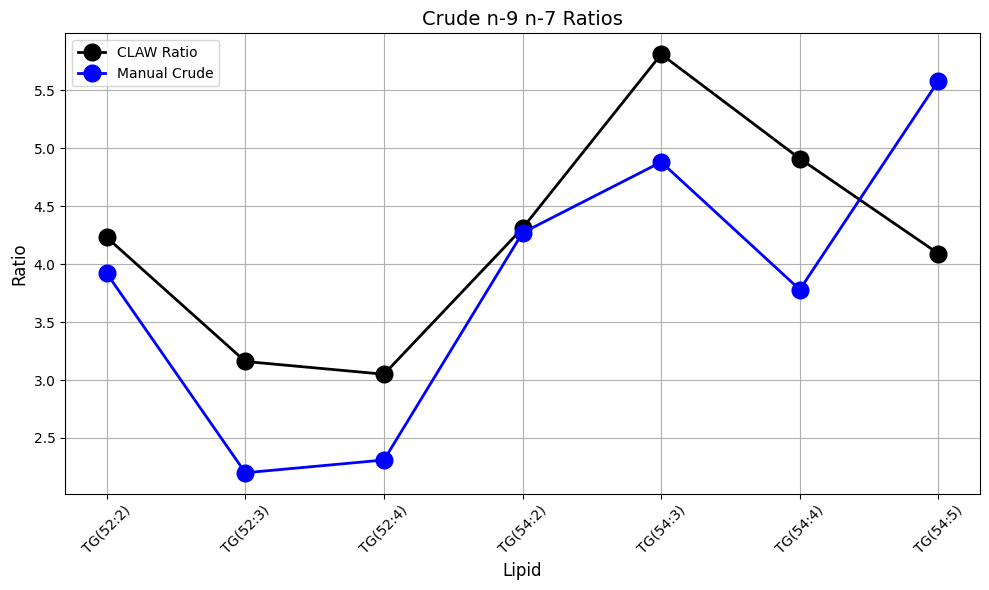

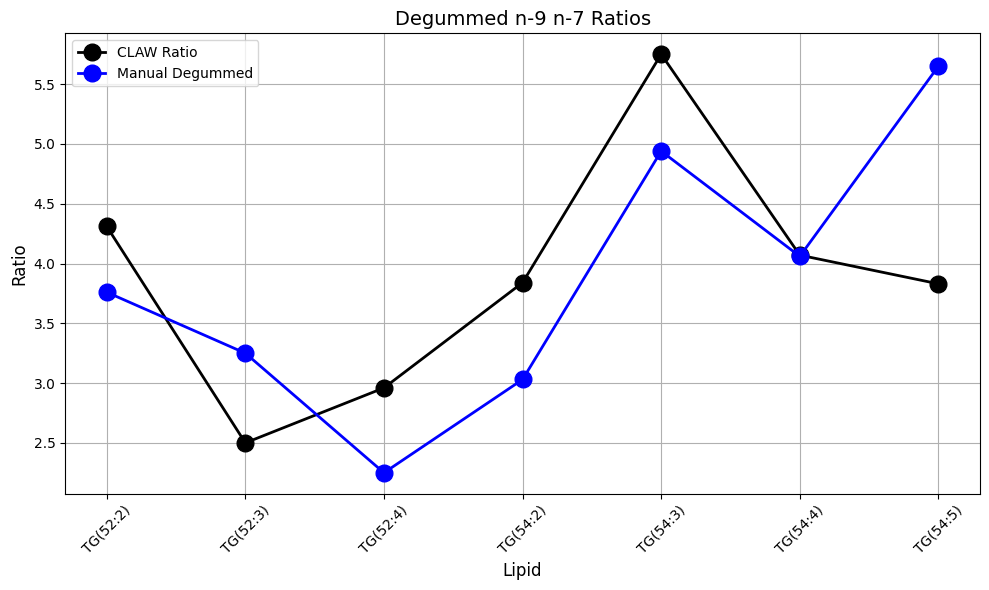

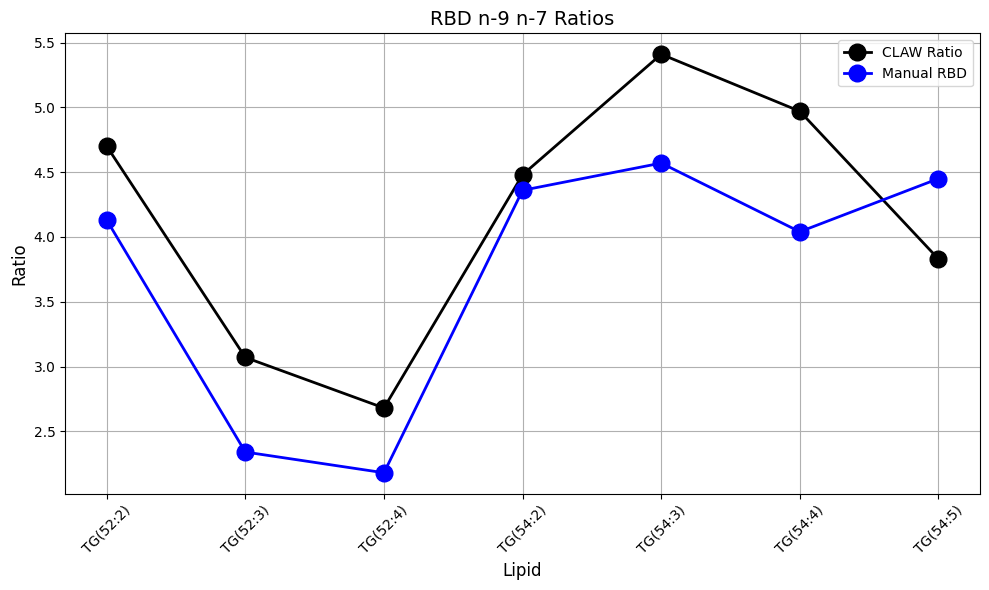

In [28]:
# Import the function from your Python file
from plot import plot_ratio_comparison

# Assuming df_sample1_ratio, df_sample2_ratio, and df_sample3_ratio are already loaded

# Plotting Crude comparison
plot_ratio_comparison(df_sample1_ratio, 'Crude', 'Crude')

# Plotting Degummed comparison
plot_ratio_comparison(df_sample2_ratio, 'Degummed', 'Degummed')

# Plotting RBD comparison
plot_ratio_comparison(df_sample3_ratio, 'RBD', 'RBD')


# Area Compare

In [29]:
# Manual Canola data for comparison
manual_canola = {
    'TG': ['TG(52:2)', 'TG(52:3)', 'TG(52:4)', 'TG(54:2)', 'TG(54:3)', 'TG(54:4)', 'TG(54:5)'],
    'Crude': [3.92, 2.2, 2.31, 4.27, 4.88, 3.78, 5.58],
    'Degummed': [3.76, 3.25, 2.25, 3.03, 4.94, 4.06, 5.65],
    'RBD': [4.13, 2.34, 2.18, 4.36, 4.57, 4.04, 4.45]
}

# Creating DataFrame for Manual Canola data
manual_df = pd.DataFrame(manual_canola)

In [30]:
def plot_ratio_comparison(df_sample_ratio, plot_title):
    plt.figure(figsize=(10, 6))
    
    # Plotting Height Ratio data (Black line, circle markers)
    plt.plot(df_sample_ratio['Lipid'], df_sample_ratio['Ratio'], 
             label='Height Ratio', color='black', marker='o', 
             markersize=12, linewidth=2)
    
    # Plotting Area Ratio data (Blue line, circle markers)
    plt.plot(df_sample_ratio['Lipid'], df_sample_ratio['Ratio_Area'], 
             label='Area Ratio', color='blue', marker='o', 
             markersize=12, linewidth=2)
    
    # Adding Title, Labels, and Legend
    plt.title(f'{plot_title} Height vs Area Ratios', fontsize=14)
    plt.xlabel('Lipid', fontsize=12)
    plt.ylabel('Ratio', fontsize=12)
    plt.legend()
    
    # Adding grid, rotating x-axis labels, and showing the plot
    plt.grid(True)
    plt.xticks(rotation=45)
    plt.tight_layout()
    
    # # Saving the plot to a file
    # plt.savefig(f'Projects/canola/plots/{plot_title} Height vs Area Ratios.png', 
    #             dpi=300)
    
    # Show the plot
    plt.show()

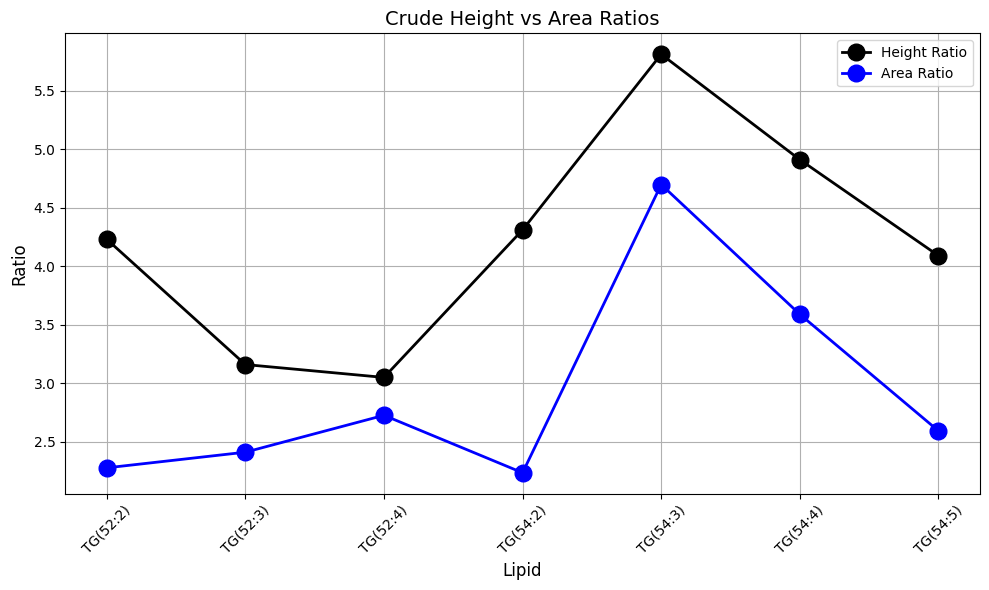

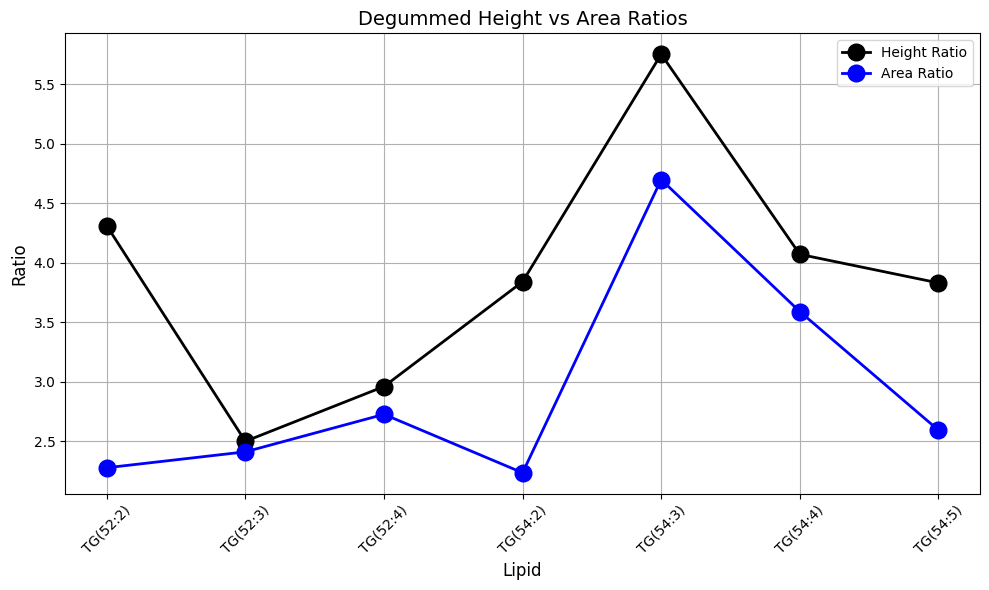

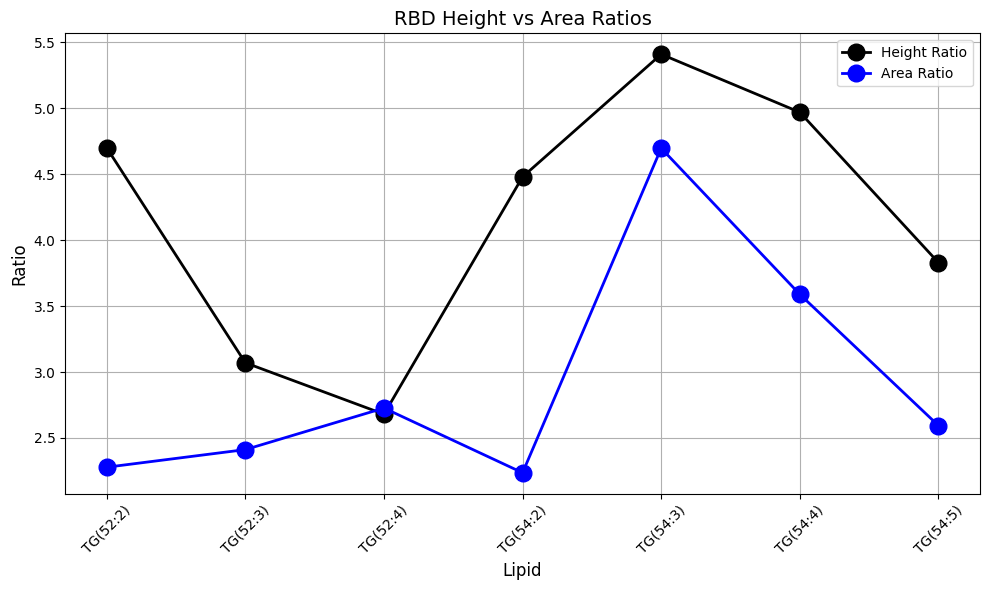

In [31]:
# Plotting Crude comparison
plot_ratio_comparison(df_sample1_ratio, 'Crude')

# Plotting Degummed comparison
plot_ratio_comparison(df_sample2_ratio, 'Degummed')

# Plotting RBD comparison
plot_ratio_comparison(df_sample3_ratio, 'RBD')

# Manual Area vs Area vs Max Intensity

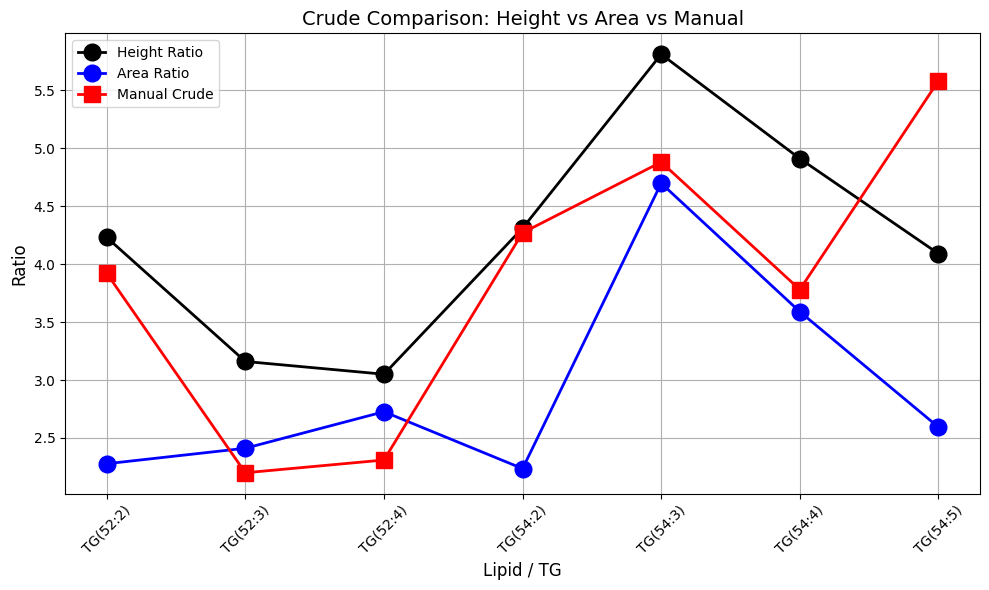

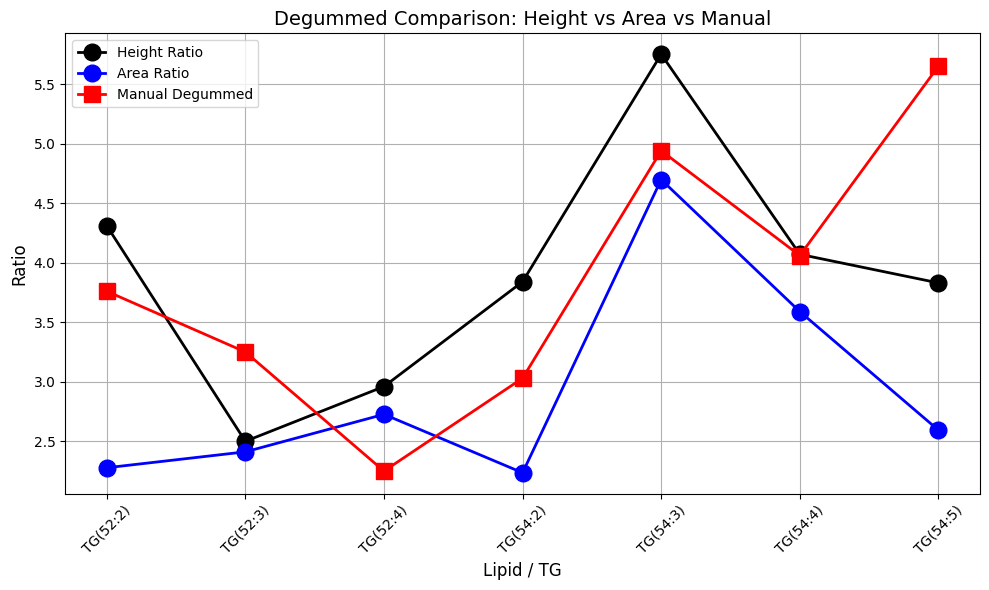

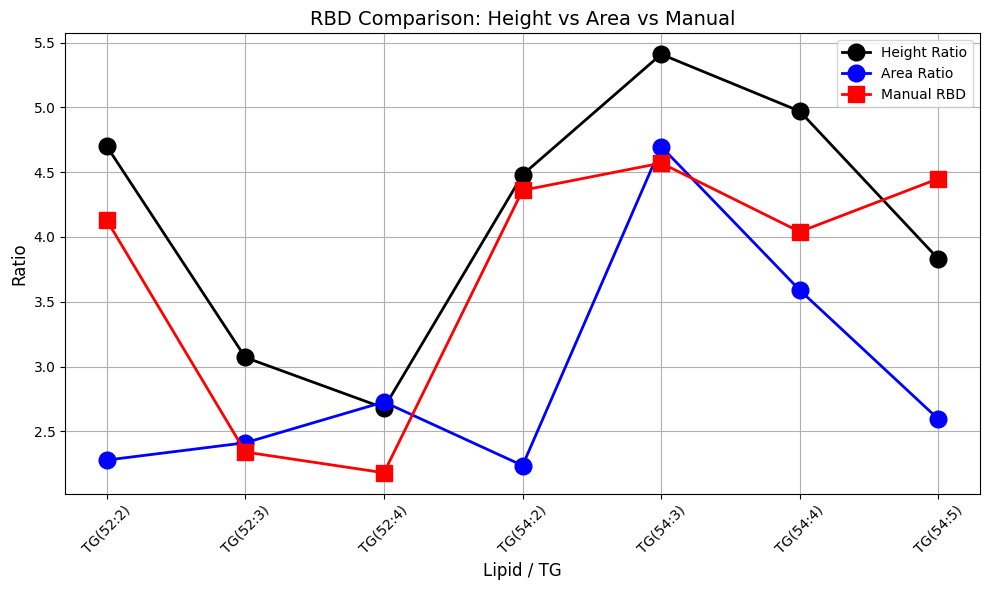

In [32]:
def plot_ratio_comparison(df_sample_ratio, manual_df, plot_title):
    plt.figure(figsize=(10, 6))
    
    # Plotting Height Ratio data (Black line, circle markers)
    plt.plot(df_sample_ratio['Lipid'], df_sample_ratio['Ratio'], 
             label='Height Ratio', color='black', marker='o', 
             markersize=12, linewidth=2)
    
    # Plotting Area Ratio data (Blue line, circle markers)
    plt.plot(df_sample_ratio['Lipid'], df_sample_ratio['Ratio_Area'], 
             label='Area Ratio', color='blue', marker='o', 
             markersize=12, linewidth=2)
    
    # Plotting Manual data (Red line, square markers)
    # The x-axis is taken from manual_df['TG'] and the y-axis from the column matching plot_title
    plt.plot(manual_df['TG'], manual_df[plot_title], 
             label=f'Manual {plot_title}', color='red', marker='s', 
             markersize=12, linewidth=2)
    
    # Adding Title, Labels, and Legend
    plt.title(f'{plot_title} Comparison: Height vs Area vs Manual', fontsize=14)
    plt.xlabel('Lipid / TG', fontsize=12)
    plt.ylabel('Ratio', fontsize=12)
    plt.legend()
    
    # Adding grid, rotating x-axis labels, and showing the plot
    plt.grid(True)
    plt.xticks(rotation=45)
    plt.tight_layout()
    
    # Show the plot
    plt.show()

# Example manual data for comparison
manual_canola = {
    'TG': ['TG(52:2)', 'TG(52:3)', 'TG(52:4)', 'TG(54:2)', 'TG(54:3)', 'TG(54:4)', 'TG(54:5)'],
    'Crude': [3.92, 2.2, 2.31, 4.27, 4.88, 3.78, 5.58],
    'Degummed': [3.76, 3.25, 2.25, 3.03, 4.94, 4.06, 5.65],
    'RBD': [4.13, 2.34, 2.18, 4.36, 4.57, 4.04, 4.45]
}
manual_df = pd.DataFrame(manual_canola)

# Calling the function for each comparison
# Plotting Crude comparison
plot_ratio_comparison(df_sample1_ratio, manual_df, 'Crude')

# Plotting Degummed comparison
plot_ratio_comparison(df_sample2_ratio, manual_df, 'Degummed')

# Plotting RBD comparison
plot_ratio_comparison(df_sample3_ratio, manual_df, 'RBD')


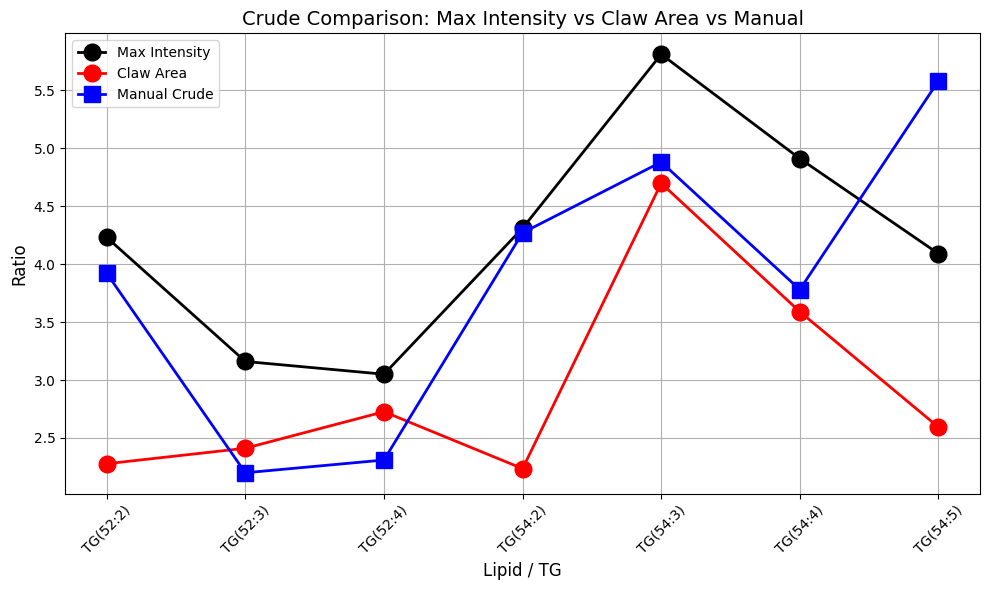

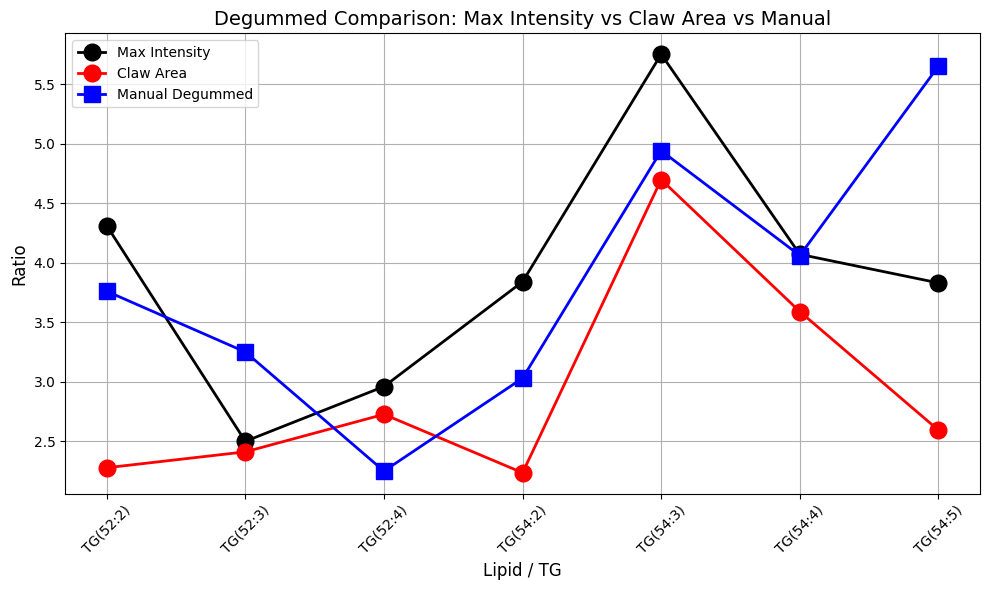

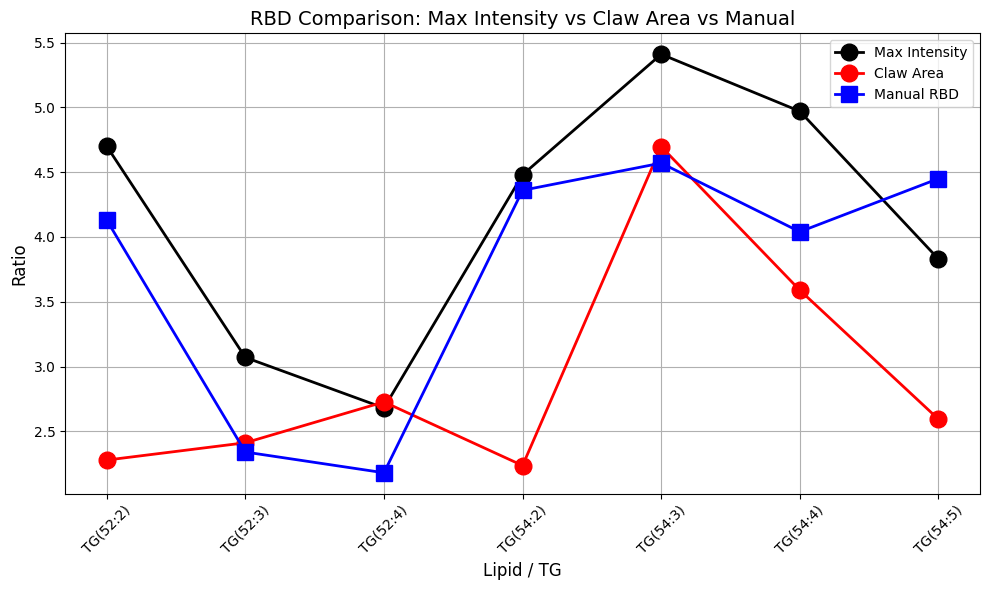

In [33]:
def plot_ratio_comparison(df_sample_ratio, manual_df, plot_title):
    plt.figure(figsize=(10, 6))
    
    # Plotting Max Intensity data (Black line, circle markers)
    plt.plot(df_sample_ratio['Lipid'], df_sample_ratio['Ratio'], 
             label='Max Intensity', color='black', marker='o', 
             markersize=12, linewidth=2)
    
    # Plotting Claw Area data (Red line, circle markers)
    plt.plot(df_sample_ratio['Lipid'], df_sample_ratio['Ratio_Area'], 
             label='Claw Area', color='red', marker='o', 
             markersize=12, linewidth=2)
    
    # Plotting Manual data (Blue line, square markers)
    plt.plot(manual_df['TG'], manual_df[plot_title], 
             label=f'Manual {plot_title}', color='blue', marker='s', 
             markersize=12, linewidth=2)
    
    # Adding Title, Labels, and Legend
    plt.title(f'{plot_title} Comparison: Max Intensity vs Claw Area vs Manual', fontsize=14)
    plt.xlabel('Lipid / TG', fontsize=12)
    plt.ylabel('Ratio', fontsize=12)
    plt.legend()
    
    # Adding grid, rotating x-axis labels, and showing the plot
    plt.grid(True)
    plt.xticks(rotation=45)
    plt.tight_layout()
    
    # Show the plot
    plt.show()

# Example manual data for comparison
manual_canola = {
    'TG': ['TG(52:2)', 'TG(52:3)', 'TG(52:4)', 'TG(54:2)', 'TG(54:3)', 'TG(54:4)', 'TG(54:5)'],
    'Crude': [3.92, 2.2, 2.31, 4.27, 4.88, 3.78, 5.58],
    'Degummed': [3.76, 3.25, 2.25, 3.03, 4.94, 4.06, 5.65],
    'RBD': [4.13, 2.34, 2.18, 4.36, 4.57, 4.04, 4.45]
}
manual_df = pd.DataFrame(manual_canola)

# Plotting Crude comparison
plot_ratio_comparison(df_sample1_ratio, manual_df, 'Crude')

# Plotting Degummed comparison
plot_ratio_comparison(df_sample2_ratio, manual_df, 'Degummed')

# Plotting RBD comparison
plot_ratio_comparison(df_sample3_ratio, manual_df, 'RBD')


In [42]:
df_sample1

,Class,Lipid,OzESI_Intensity,Precursor_Ion,Product_Ion,Retention_Time,Sample_ID,Transition,baseline,corrected_intensity,...,peak_start,peak_stop,peak_middle,is_special_case,n-7,n-9,n-12,db_pos,Ratio,Ratio_Area
0,NaN,TG(52:2)]_FA18:1,16153.0,766.7,577.596,18.05,CrudeCanola_O3on_150gN3_02082023,766.7 -> 577.596,960.648370,15192.472723,...,17.913569,18.154993,18.034800,0,684.7,656.7,614.7,n-9,4.23,2.277968
1,TG,TG(52:2)]_FA18:1,102684.0,876.8,577.596,18.04,CrudeCanola_O3on_150gN3_02082023,876.8 -> 577.596,8872.171601,93812.133087,...,17.894582,18.153708,18.039483,0,794.8,766.8,724.8,,NaN,NaN
2,NaN,TG(52:2)]_FA18:1,3815.0,794.7,577.596,18.05,CrudeCanola_O3on_150gN3_02082023,794.7 -> 577.596,261.368631,3553.591574,...,17.445533,18.315173,18.045533,0,712.7,684.7,642.7,n-7,NaN,NaN
3,NaN,TG(52:3)]_FA18:1,3420.0,764.6,575.596,16.09,CrudeCanola_O3on_150gN3_02082023,764.6 -> 575.596,359.842054,3059.978259,...,15.494617,16.694617,16.094617,0,682.6,654.6,612.6,n-9,3.16,2.411521
4,TG,TG(52:3)]_FA18:1,22411.0,874.8,575.596,16.12,CrudeCanola_O3on_150gN3_02082023,874.8 -> 575.596,3409.707222,19001.214653,...,15.905273,16.219727,16.115617,0,792.8,764.8,722.8,,NaN,NaN
5,NaN,TG(52:3)]_FA18:1,1083.0,792.7,575.596,16.04,CrudeCanola_O3on_150gN3_02082023,792.7 -> 575.596,188.494830,894.905194,...,15.440583,16.640583,16.040583,0,710.7,682.7,640.7,n-7,NaN,NaN
6,NaN,TG(53:0)]_FA18:1,551.0,784.6,595.596,21.57,CrudeCanola_O3on_150gN3_02082023,784.6 -> 595.596,244.337705,306.602358,...,NaN,NaN,NaN,0,702.6,674.6,632.6,n-9,1.13,NaN
7,TG,TG(53:0)]_FA18:1,2458.0,894.8,595.596,17.55,CrudeCanola_O3on_150gN3_02082023,894.8 -> 595.596,1935.082999,522.477059,...,NaN,NaN,NaN,0,812.8,784.8,742.8,,NaN,NaN
8,NaN,TG(53:0)]_FA18:1,488.0,812.7,595.596,20.87,CrudeCanola_O3on_150gN3_02082023,812.7 -> 595.596,42.500004,445.700039,...,NaN,NaN,NaN,0,730.7,702.7,660.7,n-7,NaN,NaN
9,NaN,TG(54:2)]_FA18:1,11693.0,794.6,605.596,20.00,CrudeCanola_O3on_150gN3_02082023,794.6 -> 605.596,569.246283,11123.834772,...,19.796587,20.115886,20.002950,0,712.6,684.6,642.6,n-9,4.31,2.235809


# Fixing TG(54:5) n-9 values

In [34]:
#                              Sample_ID    Peak_Area  Max_Intensity
# 0     CrudeCanola_O3on_150gN3_02082023  1340.531034    5259.140137
# 1  DegummedCanola_O3on_150gN3_02082023   974.122311    4061.100342
# 2       RBDCanola_O3on_150gN3_02082023   963.188023    3415.200195


# Update n-9 values
#                              Sample_ID   Peak_Area  Max_Intensity  \
# 0     CrudeCanola_O3on_150gN3_02082023  570.722155    5259.140137   
# 1  DegummedCanola_O3on_150gN3_02082023  281.616201    4061.100342   
# 2       RBDCanola_O3on_150gN3_02082023  310.892336    3415.200195   

# update n-7 values 
#                              Sample_ID   Peak_Area  Max_Intensity  \
# 0     CrudeCanola_O3on_150gN3_02082023  119.131259    1287.480103   
# 1  DegummedCanola_O3on_150gN3_02082023   82.849627    1060.780029   
# 2       RBDCanola_O3on_150gN3_02082023  136.591725     891.480042   
# 119


In [35]:
import pandas as pd

# Assuming df_sample1 is already defined
# For example, if you load it from a CSV:
# df_sample1 = pd.read_csv('your_file.csv')

# Define the new value for peak_area
new_peak_area_n9 = 570  # Replace this with your desired value

# Create a boolean mask to select the row where Lipid is "[TG(54:5)]_FA18:1" and db_pos is "n-9"
mask = (df_sample1['Lipid'] == '[TG(54:5)]_FA18:1') & (df_sample1['db_pos'] == 'n-9')

# Update the 'peak_area' column for the selected row(s)
df_sample1.loc[mask, 'peak_area'] = new_peak_area_n9

# (Optional) Print the updated rows to verify the change
print(df_sample1.loc[mask])

# Define the new value for peak_area
new_peak_area_n9 = 281  # Replace this with your desired value

# Create a boolean mask to select the row where Lipid is "[TG(54:5)]_FA18:1" and db_pos is "n-9"
mask = (df_sample2['Lipid'] == '[TG(54:5)]_FA18:1') & (df_sample2['db_pos'] == 'n-9')

# Update the 'peak_area' column for the selected row(s)
df_sample2.loc[mask, 'peak_area'] = new_peak_area_n9

# (Optional) Print the updated rows to verify the change
print(df_sample2.loc[mask])

# Define the new value for peak_area
new_peak_area_n9 = 310  # Replace this with your desired value

# Create a boolean mask to select the row where Lipid is "[TG(54:5)]_FA18:1" and db_pos is "n-9"
mask = (df_sample3['Lipid'] == '[TG(54:5)]_FA18:1') & (df_sample3['db_pos'] == 'n-9')

# Update the 'peak_area' column for the selected row(s)
df_sample3.loc[mask, 'peak_area'] = new_peak_area_n9

# (Optional) Print the updated rows to verify the change
print(df_sample3.loc[mask])


   Class              Lipid  OzESI_Intensity  Precursor_Ion  Product_Ion  \
26   NaN  [TG(54:5)]_FA18:1           5259.0          788.6      599.596   

    Retention_Time                         Sample_ID        Transition  \
26           14.31  CrudeCanola_O3on_150gN3_02082023  788.6 -> 599.596   

      baseline  corrected_intensity  ...  peak_start  peak_stop  peak_middle  \
26  261.780771          4997.359366  ...   14.119574    14.8975      14.2975   

    is_special_case    n-7    n-9   n-12  db_pos Ratio  Ratio_Area  
26                0  706.6  678.6  636.6     n-9  4.09    2.593622  

[1 rows x 21 columns]
   Class              Lipid  OzESI_Intensity  Precursor_Ion  Product_Ion  \
26   NaN  [TG(54:5)]_FA18:1           4061.0          788.6      599.596   

    Retention_Time                            Sample_ID        Transition  \
26            14.2  DegummedCanola_O3on_150gN3_02082023  788.6 -> 599.596   

      baseline  corrected_intensity  ...  peak_start  peak_stop  pea

In [60]:
import pandas as pd

# Assuming df_sample1, df_sample2, and df_sample3 are already defined
# For example:
# df_sample1 = pd.read_csv('sample1.csv')
# df_sample2 = pd.read_csv('sample2.csv')
# df_sample3 = pd.read_csv('sample3.csv')

# -------------------------------
# Update n-9 values for '[TG(54:5)]_FA18:1'
# -------------------------------

# For df_sample1: db_pos 'n-9'
new_peak_area_n9_sample1 = 570  # Replace with your desired value for df_sample1
mask_n9 = (df_sample1['Lipid'] == '[TG(54:5)]_FA18:1') & (df_sample1['db_pos'] == 'n-9')
df_sample1.loc[mask_n9, 'peak_area'] = new_peak_area_n9_sample1
print("df_sample1 - n-9 update:")
print(df_sample1.loc[mask_n9])

# For df_sample2: db_pos 'n-9'
new_peak_area_n9_sample2 = 281  # Replace with your desired value for df_sample2
mask_n9 = (df_sample2['Lipid'] == '[TG(54:5)]_FA18:1') & (df_sample2['db_pos'] == 'n-9')
df_sample2.loc[mask_n9, 'peak_area'] = new_peak_area_n9_sample2
print("df_sample2 - n-9 update:")
print(df_sample2.loc[mask_n9])

# For df_sample3: db_pos 'n-9'
new_peak_area_n9_sample3 = 310  # Replace with your desired value for df_sample3
mask_n9 = (df_sample3['Lipid'] == '[TG(54:5)]_FA18:1') & (df_sample3['db_pos'] == 'n-9')
df_sample3.loc[mask_n9, 'peak_area'] = new_peak_area_n9_sample3
print("df_sample3 - n-9 update:")
print(df_sample3.loc[mask_n9])


# -------------------------------
# Update n-7 values for '[TG(54:5)]_FA18:1'
# -------------------------------

# For df_sample1: db_pos 'n-7'
new_peak_area_n7_sample1 = 119  # Replace with your desired value for df_sample1 (n-7)
mask_n7 = (df_sample1['Lipid'] == '[TG(54:5)]_FA18:1') & (df_sample1['db_pos'] == 'n-7')
df_sample1.loc[mask_n7, 'peak_area'] = new_peak_area_n7_sample1
print("df_sample1 - n-7 update:")
print(df_sample1.loc[mask_n7])

# For df_sample2: db_pos 'n-7'
new_peak_area_n7_sample2 = 82  # Replace with your desired value for df_sample2 (n-7)
mask_n7 = (df_sample2['Lipid'] == '[TG(54:5)]_FA18:1') & (df_sample2['db_pos'] == 'n-7')
df_sample2.loc[mask_n7, 'peak_area'] = new_peak_area_n7_sample2
print("df_sample2 - n-7 update:")
print(df_sample2.loc[mask_n7])

# For df_sample3: db_pos 'n-7'
new_peak_area_n7_sample3 = 136  # Replace with your desired value for df_sample3 (n-7)
mask_n7 = (df_sample3['Lipid'] == '[TG(54:5)]_FA18:1') & (df_sample3['db_pos'] == 'n-7')
df_sample3.loc[mask_n7, 'peak_area'] = new_peak_area_n7_sample3
print("df_sample3 - n-7 update:")
print(df_sample3.loc[mask_n7])




df_sample1 - n-9 update:
   Class              Lipid  OzESI_Intensity  Precursor_Ion  Product_Ion  \
26   NaN  [TG(54:5)]_FA18:1           5259.0          788.6      599.596   

    Retention_Time                         Sample_ID        Transition  \
26           14.31  CrudeCanola_O3on_150gN3_02082023  788.6 -> 599.596   

      baseline  corrected_intensity  ...  peak_start  peak_stop  peak_middle  \
26  261.780771          4997.359366  ...   14.119574    14.8975      14.2975   

    is_special_case    n-7    n-9   n-12  db_pos Ratio  Ratio_Area  
26                0  706.6  678.6  636.6     n-9  4.09    2.593622  

[1 rows x 21 columns]
df_sample2 - n-9 update:
   Class              Lipid  OzESI_Intensity  Precursor_Ion  Product_Ion  \
26   NaN  [TG(54:5)]_FA18:1           4061.0          788.6      599.596   

    Retention_Time                            Sample_ID        Transition  \
26            14.2  DegummedCanola_O3on_150gN3_02082023  788.6 -> 599.596   

      baseline  co

# 14apr25 4pm

In [66]:
# df_sample1

# 14apr25 3pm

In [37]:
# def create_n7_n9_comparison(n7_df, n9_df):
#     """
#     Create bar plots comparing n-7 and n-9 peak areas and their ratios
    
#     Parameters:
#     -----------
#     n7_df : DataFrame
#         DataFrame containing n-7 peak information
#     n9_df : DataFrame
#         DataFrame containing n-9 peak information
#     """
#     if n7_df.empty or n9_df.empty:
#         print("Insufficient data for n-7 vs n-9 comparison.")
#         return
    
#     # Create a merged dataframe for easier comparison
#     n7_pivot = n7_df.pivot(index=['Sample_ID', 'Parent_Lipid'], values='Peak_Area', columns=['Ion_Type'])
#     n9_pivot = n9_df.pivot(index=['Sample_ID', 'Parent_Lipid'], values='Peak_Area', columns=['Ion_Type'])
    
#     # Combine the dataframes
#     combined = pd.DataFrame(index=n7_pivot.index)
#     if 'n-7' in n7_pivot:
#         combined['n-7'] = n7_pivot['n-7']
#     else:
#         combined['n-7'] = 0
        
#     if 'n-9' in n9_pivot:
#         combined['n-9'] = n9_pivot['n-9']
#     else:
#         combined['n-9'] = 0
    
#     # Fill NA values with 0
#     combined = combined.fillna(0)
    
#     # Calculate n-9/n-7 ratio (avoiding divide by zero)
#     combined['n9_n7_ratio'] = combined.apply(
#         lambda row: row['n-9'] / row['n-7'] if row['n-7'] > 0 else float('nan'), 
#         axis=1
#     )
    
#     # Reset index for easier plotting
#     combined = combined.reset_index()
    
#     # Plot 1: n-7 and n-9 comparison for each lipid and sample
#     plt.figure(figsize=(14, 8))
    
#     # Get unique samples and lipids
#     samples = combined['Sample_ID'].unique()
#     lipids = combined['Parent_Lipid'].unique()
    
#     # Create positions for bars
#     bar_width = 0.35
#     x = np.arange(len(lipids))
    
#     # Create a separate subplot for each sample
#     fig, axes = plt.subplots(len(samples), 1, figsize=(14, 5*len(samples)), sharex=True)
#     if len(samples) == 1:
#         axes = [axes]  # Make sure axes is iterable even with one sample
    
#     for i, sample in enumerate(samples):
#         ax = axes[i]
#         sample_data = combined[combined['Sample_ID'] == sample]
        
#         # Ensure data for all lipids
#         sample_plot_data = []
#         for lipid in lipids:
#             lipid_data = sample_data[sample_data['Parent_Lipid'] == lipid]
#             if lipid_data.empty:
#                 sample_plot_data.append({'Parent_Lipid': lipid, 'n-7': 0, 'n-9': 0, 'n9_n7_ratio': float('nan')})
#             else:
#                 sample_plot_data.append(lipid_data.iloc[0])
        
#         sample_plot_df = pd.DataFrame(sample_plot_data)
        
#         # Plot bars
#         bar1 = ax.bar(x - bar_width/2, sample_plot_df['n-7'], bar_width, label='n-7', color='blue', alpha=0.7)
#         bar2 = ax.bar(x + bar_width/2, sample_plot_df['n-9'], bar_width, label='n-9', color='green', alpha=0.7)
        
#         # Add value labels on bars
#         for bar in [bar1, bar2]:
#             for rect in bar:
#                 height = rect.get_height()
#                 if height > 0:
#                     ax.text(rect.get_x() + rect.get_width()/2., height + 5,
#                             f'{height:.0f}', ha='center', va='bottom', fontsize=9)
        
#         # Add labels
#         ax.set_title(f'Sample: {sample}', fontsize=14)
#         ax.set_ylabel('Peak Area', fontsize=12)
#         ax.set_xticks(x)
#         ax.set_xticklabels(lipids, rotation=45, ha='right')
#         ax.legend()
#         ax.grid(True, alpha=0.3, axis='y')
    
#     plt.xlabel('Lipid', fontsize=12)
#     plt.tight_layout()
#     plt.suptitle('Comparison of n-7 and n-9 Peak Areas by Lipid and Sample', fontsize=16, y=1.02)
#     plt.show()
    
#     # Plot 2: n-9/n-7 ratio for each lipid and sample
#     plt.figure(figsize=(14, 8))
    
#     # Create positions for bars
#     bar_positions = np.arange(len(lipids))
    
#     # Plot a separate bar for each sample
#     for i, sample in enumerate(samples):
#         sample_data = combined[combined['Sample_ID'] == sample]
        
#         # Create a list of ratios for each lipid
#         ratios = []
#         for lipid in lipids:
#             lipid_data = sample_data[sample_data['Parent_Lipid'] == lipid]
#             if not lipid_data.empty and not np.isnan(lipid_data['n9_n7_ratio'].values[0]):
#                 ratios.append(lipid_data['n9_n7_ratio'].values[0])
#             else:
#                 ratios.append(0)
        
#         # Plot bars for this sample with offset
#         offset = (i - len(samples)/2 + 0.5) * (bar_width * 0.8)
#         bars = plt.bar(bar_positions + offset, ratios, bar_width * 0.8, 
#                       label=sample, alpha=0.7)
        
#         # Add value labels on bars
#         for bar, ratio in zip(bars, ratios):
#             height = bar.get_height()
#             if height > 0:
#                 plt.text(bar.get_x() + bar.get_width()/2., height + 0.02,
#                         f'{height:.2f}', ha='center', va='bottom', fontsize=9, rotation=45)
    
#     # Add horizontal line at ratio = 1
#     plt.axhline(y=1, color='red', linestyle='--', alpha=0.7, label='Equal Abundance')
    
#     # Add labels
#     plt.xlabel('Lipid', fontsize=12)
#     plt.ylabel('n-9/n-7 Ratio', fontsize=12)
#     plt.title('n-9/n-7 Ratio by Lipid and Sample', fontsize=14)
#     plt.xticks(bar_positions, lipids, rotation=45, ha='right')
#     plt.legend()
#     plt.grid(True, alpha=0.3, axis='y')
#     plt.tight_layout()
#     plt.show()
    
#     # Print summary table of n-9/n-7 ratios
#     print("\nn-9/n-7 Ratio Summary:")
#     ratio_pivot = combined.pivot(index='Parent_Lipid', columns='Sample_ID', values='n9_n7_ratio')
#     print(ratio_pivot.round(2))
# import matplotlib.pyplot as plt
# import pandas as pd
# from scipy.signal import find_peaks, savgol_filter
# from scipy.integrate import trapezoid
# import io

# # Parse the lipid data with retention times
# lipid_data_str = """Lipid,Precursor_Ion,Product_Ion,n-7,n-9,Retention_Time
# [TG(52:2)]_FA18:1,876.8,577.596,794.8,766.8,18.05
# [TG(52:3)]_FA18:1,874.8,575.596,792.8,764.8,16.09
# [TG(52:4)]_FA18:1,872.8,573.596,790.8,762.8,14.3
# [TG(54:2)]_FA18:1,904.8,605.596,822.8,794.8,20
# [TG(54:3)]_FA18:1,902.8,603.596,820.8,792.8,17.98
# [TG(54:4)]_FA18:1,900.8,601.596,818.8,790.8,16.07
# [TG(54:5)]_FA18:1,898.8,599.596,816.8,788.8,14.31"""

# # Load lipid data into a DataFrame
# lipid_df = pd.read_csv(io.StringIO(lipid_data_str))

# # Create dictionaries for quick lookup of n-7 and n-9 values by precursor ion
# n7_dict = dict(zip(lipid_df['Precursor_Ion'], lipid_df['n-7']))
# n9_dict = dict(zip(lipid_df['Precursor_Ion'], lipid_df['n-9']))
# lipid_name_dict = dict(zip(lipid_df['Precursor_Ion'], lipid_df['Lipid']))

# # Define global parameters
# parent_ion_tolerance = 0.3  # Define tolerance parameter at ±0.3
# retention_time_window = 1.0  # ±1 minute window for each lipid

# sample_ids = [
#     'CrudeCanola_O3on_150gN3_02082023',
#     'DegummedCanola_O3on_150gN3_02082023',
#     'RBDCanola_O3on_150gN3_02082023'
# ]

# def detect_baseline_agilent_style(rt, intensity, height_threshold=0.05, 
#                                   smoothing_window=5, baseline_chunks=20):
#     """
#     Detect baseline using an approach similar to Agilent's method.
    
#     Parameters:
#     -----------
#     rt : array-like
#         Retention time array
#     intensity : array-like
#         Intensity values
#     height_threshold : float
#         Threshold for peak detection relative to max intensity
#     smoothing_window : int
#         Window size for Savitzky-Golay smoothing
#     baseline_chunks : int
#         Number of chunks to divide the chromatogram for baseline determination
        
#     Returns:
#     --------
#     baseline : array-like
#         The calculated baseline
#     """
#     # Normalize intensity for relative calculations
#     max_intensity = np.max(intensity)
#     if max_intensity == 0:
#         return np.zeros_like(intensity)
        
#     norm_intensity = intensity / max_intensity
    
#     # Step 1: Divide chromatogram into chunks and find local minima
#     chunk_size = max(3, len(norm_intensity) // baseline_chunks)
#     baseline_points = []
    
#     for i in range(0, len(norm_intensity), chunk_size):
#         chunk_end = min(i + chunk_size, len(norm_intensity))
#         if chunk_end - i >= 2:  # Need at least 2 points to find minimum
#             min_idx = i + np.argmin(norm_intensity[i:chunk_end])
#             baseline_points.append((rt[min_idx], norm_intensity[min_idx]))
    
#     # Ensure we have start and end points
#     if not baseline_points or baseline_points[0][0] > rt[0]:
#         baseline_points.insert(0, (rt[0], norm_intensity[0]))
#     if not baseline_points or baseline_points[-1][0] < rt[-1]:
#         baseline_points.append((rt[-1], norm_intensity[-1]))
    
#     # Step 2: Interpolate between baseline points
#     baseline_x = [point[0] for point in baseline_points]
#     baseline_y = [point[1] for point in baseline_points]
    
#     # Linear interpolation between baseline points
#     baseline = np.interp(rt, baseline_x, baseline_y)
    
#     # Step 3: Apply smoothing to the baseline
#     if len(baseline) > smoothing_window:
#         baseline = savgol_filter(baseline, smoothing_window, 2)
    
#     # Step 4: Apply Agilent-style constraint: baseline never exceeds the signal
#     for i in range(len(baseline)):
#         if baseline[i] > norm_intensity[i]:
#             baseline[i] = norm_intensity[i]
    
#     # Return baseline scaled back to original intensity range
#     return baseline * max_intensity

# def find_and_integrate_peak_agilent_style(rt, intensity, 
#                                          height_threshold=0.05, 
#                                          prominence=0.05,
#                                          width_threshold=5, 
#                                          plot_details=False,
#                                          title_prefix=""):
#     """
#     Find and integrate peaks using an Agilent-like approach.
    
#     Parameters:
#     -----------
#     rt : array-like
#         Retention time array
#     intensity : array-like
#         Intensity values
#     height_threshold : float
#         Threshold for peak detection relative to max intensity
#     prominence : float
#         Minimum peak prominence relative to max intensity
#     width_threshold : int
#         Minimum width (in data points) for a peak to be considered
#     plot_details : bool
#         Whether to show detailed plot of peak detection steps
#     title_prefix : str
#         Prefix for plot title
        
#     Returns:
#     --------
#     result : dict
#         Dictionary containing peak information
#     """
#     # Handle empty or invalid data
#     if len(rt) < 3 or np.max(intensity) == 0:
#         return {
#             'Peak_Area': 0,
#             'Max_Original_Intensity': 0,
#             'Max_Corrected_Intensity': 0,
#             'Peak_Start': 0,
#             'Peak_Stop': 0,
#             'Peak_RT': 0,
#             'Baseline': np.zeros_like(intensity) if len(intensity) > 0 else np.array([])
#         }
    
#     # Step 1: Apply Savitzky-Golay smoothing to reduce noise
#     if len(intensity) > 5:
#         smoothed_intensity = savgol_filter(intensity, 5, 2)
#     else:
#         smoothed_intensity = intensity.copy()
    
#     # Step 2: Detect baseline
#     baseline = detect_baseline_agilent_style(rt, smoothed_intensity)
    
#     # Step 3: Subtract baseline to get corrected intensity
#     corrected_intensity = np.maximum(smoothed_intensity - baseline, 0)
    
#     # Smooth the corrected intensity
#     if len(corrected_intensity) > 5:
#         smoothed_corrected = savgol_filter(corrected_intensity, 5, 2)
#     else:
#         smoothed_corrected = corrected_intensity.copy()
    
#     # Step 4: Find peaks on baseline-corrected data
#     # Convert relative parameters to absolute values
#     abs_height = height_threshold * np.max(smoothed_corrected) if np.max(smoothed_corrected) > 0 else 0
#     abs_prominence = prominence * np.max(smoothed_corrected) if np.max(smoothed_corrected) > 0 else 0
    
#     peaks, peak_properties = find_peaks(
#         smoothed_corrected,
#         height=abs_height,
#         prominence=abs_prominence,
#         width=width_threshold
#     )
    
#     # If no peaks found, return zeroes
#     if len(peaks) == 0:
#         return {
#             'Peak_Area': 0,
#             'Max_Original_Intensity': 0,
#             'Max_Corrected_Intensity': 0,
#             'Peak_Start': 0,
#             'Peak_Stop': 0,
#             'Peak_RT': 0,
#             'Baseline': baseline
#         }
    
#     # Step 5: Select the most prominent peak
#     peak_idx = peaks[np.argmax(peak_properties["prominences"])]
#     peak_rt = rt[peak_idx]
    
#     # Step 6: Determine peak boundaries
#     # Find the peak's left and right bounds at half height (similar to Agilent)
#     peak_height = smoothed_corrected[peak_idx]
#     half_height = peak_height / 2
    
#     # Find left boundary (moving left from peak until below half height)
#     left_idx = peak_idx
#     while left_idx > 0 and smoothed_corrected[left_idx] > half_height:
#         left_idx -= 1
    
#     # Find right boundary (moving right from peak until below half height)
#     right_idx = peak_idx
#     while right_idx < len(smoothed_corrected) - 1 and smoothed_corrected[right_idx] > half_height:
#         right_idx += 1
    
#     # Convert indices to retention times
#     peak_start_time = rt[left_idx]
#     peak_stop_time = rt[right_idx]
    
#     # Step 7: Apply Agilent-like constraint for reasonable peak width
#     max_half_width = 0.6  # Agilent often limits very wide peaks
#     if (peak_rt - peak_start_time) > max_half_width:
#         # Find the time point that's max_half_width minutes before the peak
#         start_candidates = np.where(rt >= (peak_rt - max_half_width))[0]
#         if len(start_candidates) > 0:
#             left_idx = min(start_candidates)
#             peak_start_time = rt[left_idx]
    
#     if (peak_stop_time - peak_rt) > max_half_width:
#         # Find the time point that's max_half_width minutes after the peak
#         stop_candidates = np.where(rt <= (peak_rt + max_half_width))[0]
#         if len(stop_candidates) > 0:
#             right_idx = max(stop_candidates)
#             peak_stop_time = rt[right_idx]
    
#     # Step 8: Calculate peak area using the trapezoidal rule (Agilent's approach)
#     # Get the subset of data within the peak boundaries
#     mask = (rt >= peak_start_time) & (rt <= peak_stop_time)
#     x_integration = rt[mask]
#     y_integration = corrected_intensity[mask]
    
#     # Ensure we have enough points for integration
#     if len(x_integration) < 2:
#         # Create more detailed points through interpolation
#         x_detailed = np.linspace(peak_start_time, peak_stop_time, 20)
#         y_detailed = np.interp(x_detailed, rt, corrected_intensity)
        
#         # Use these for integration
#         x_integration = x_detailed
#         y_integration = y_detailed
    
#     # Calculate area using trapezoidal rule
#     peak_area = trapezoid(y_integration, x_integration)
    
#     # Step 9: Create result dictionary
#     result = {
#         'Peak_Area': peak_area,
#         'Max_Original_Intensity': intensity[peak_idx],
#         'Max_Corrected_Intensity': corrected_intensity[peak_idx],
#         'Peak_Start': peak_start_time,
#         'Peak_Stop': peak_stop_time,
#         'Peak_RT': peak_rt,
#         'Baseline': baseline
#     }
    
#     # Step 10: Plot the results if requested
#     if plot_details:
#         plt.figure(figsize=(12, 8))
        
#         # Plot the original data
#         plt.plot(rt, intensity, 'b-', linewidth=1.5, label="Original Chromatogram")
        
#         # Plot the baseline
#         plt.plot(rt, baseline, 'r--', linewidth=1.5, label="Agilent-Style Baseline")
        
#         # Plot the corrected intensity
#         plt.plot(rt, corrected_intensity, 'g-', linewidth=1.5, label="Baseline-Corrected")
        
#         # Shade the area under the detected peak (baseline-corrected)
#         plt.fill_between(x_integration, y_integration, alpha=0.3, color='green', 
#                          label=f"Peak Area: {peak_area:.2f}")
        
#         # Add vertical lines for peak start, peak, and stop
#         plt.axvline(x=peak_start_time, linestyle="--", color="orange", 
#                     label=f"Peak Start: {peak_start_time:.2f}")
#         plt.axvline(x=peak_stop_time, linestyle="--", color="purple", 
#                     label=f"Peak End: {peak_stop_time:.2f}")
#         plt.axvline(x=peak_rt, linestyle="-", color="black", 
#                     label=f"Peak RT: {peak_rt:.2f}")
        
#         # Mark the detected peak
#         plt.plot(peak_rt, intensity[peak_idx], 'ko', markersize=8, 
#                  label=f"Peak Max: {intensity[peak_idx]:.0f}")
        
#         # Add labels and legend
#         plt.xlabel("Retention Time (min)", fontsize=12)
#         plt.ylabel("Intensity", fontsize=12)
#         plt.title(f"{title_prefix} - Agilent-Style Peak Analysis", fontsize=14)
#         plt.legend(loc='upper left', fontsize=10)
#         plt.grid(True, alpha=0.3)
#         plt.tight_layout()
#         plt.show()
    
#     return result

# def process_lipid_sample(lipid_name, precursor_ion, expected_rt, sample_id, plot_details=True):
#     """
#     Process a single lipid in a specific sample and return the results
    
#     Parameters:
#     -----------
#     lipid_name : str
#         Name of the lipid
#     precursor_ion : float
#         Precursor ion m/z value
#     expected_rt : float
#         Expected retention time for this lipid
#     sample_id : str
#         Sample identifier
#     plot_details : bool
#         Whether to plot chromatogram details
#     """
#     # Calculate retention time window based on expected RT
#     rt_start = max(0, expected_rt - retention_time_window)
#     rt_end = expected_rt + retention_time_window
    
#     print(f"  Searching RT window: {rt_start:.2f} - {rt_end:.2f} min for {sample_id}")
    
#     # Filter the DataFrame for the given sample, parent ion (with tolerance), and retention time window
#     subset = processed_df[
#         (processed_df['Parent_Ion'] >= precursor_ion - parent_ion_tolerance) &
#         (processed_df['Parent_Ion'] <= precursor_ion + parent_ion_tolerance) &
#         (processed_df['Sample_ID'] == sample_id) &
#         (processed_df['Retention_Time'] >= rt_start) &
#         (processed_df['Retention_Time'] <= rt_end)
#     ].copy()
    
#     # Group by Retention_Time and take the maximum OzESI_Intensity
#     aggregated = subset.groupby('Retention_Time', as_index=False)['OzESI_Intensity'].max()
#     aggregated.sort_values('Retention_Time', inplace=True)
#     aggregated = aggregated.reset_index(drop=True)
    
#     # Skip if no data is available
#     if aggregated.empty:
#         print(f"No data for sample {sample_id}, lipid {lipid_name} (m/z {precursor_ion}) in RT window {rt_start:.2f} - {rt_end:.2f} min.")
#         return {
#             'Lipid': lipid_name,
#             'Sample_ID': sample_id,
#             'Precursor_Ion': precursor_ion,
#             'Expected_RT': expected_rt,
#             'RT_Window_Start': rt_start,
#             'RT_Window_End': rt_end,
#             'Peak_Area': 0,
#             'Max_Intensity': 0,
#             'Peak_RT': 0
#         }
    
#     # Get arrays for processing
#     retention_times = aggregated['Retention_Time'].values
#     intensity_array = aggregated['OzESI_Intensity'].values
    
#     # Apply the Agilent-style peak finding and integration
#     plot_title = f"{sample_id} - {lipid_name} (m/z {precursor_ion} ± {parent_ion_tolerance}, RT: {expected_rt}±{retention_time_window} min)"
    
#     peak_result = find_and_integrate_peak_agilent_style(
#         retention_times, 
#         intensity_array,
#         height_threshold=0.05,
#         prominence=0.05,
#         width_threshold=3,
#         plot_details=plot_details,
#         title_prefix=plot_title
#     )
    
#     # Return the results with retention time window information
#     return {
#         'Lipid': lipid_name,
#         'Sample_ID': sample_id,
#         'Precursor_Ion': precursor_ion,
#         'Expected_RT': expected_rt,
#         'RT_Window_Start': rt_start,
#         'RT_Window_End': rt_end,
#         'Peak_Area': peak_result['Peak_Area'],
#         'Max_Intensity': peak_result['Max_Original_Intensity'],
#         'Peak_RT': peak_result['Peak_RT'],
#         'RT_Difference': peak_result['Peak_RT'] - expected_rt if peak_result['Peak_RT'] > 0 else float('nan')
#     }

# # Main analysis function
# def analyze_all_lipids(process_all_samples=True, plot_individual=False):
#     """
#     Analyze all lipids across all samples
    
#     Parameters:
#     -----------
#     process_all_samples : bool
#         If True, process all samples; if False, just process the first sample
#     plot_individual : bool
#         Whether to plot individual chromatograms for each lipid and sample
#     """
#     # List to store all results
#     all_results = []
    
#     # Lists to store n-7 and n-9 results
#     n7_results = []
#     n9_results = []
    
#     # Determine which samples to process
#     samples_to_process = sample_ids if process_all_samples else [sample_ids[0]]
    
#     # Process each lipid
#     for idx, row in lipid_df.iterrows():
#         lipid_name = row['Lipid']
#         precursor_ion = row['Precursor_Ion']
#         expected_rt = row['Retention_Time']
#         n7_ion = row['n-7']
#         n9_ion = row['n-9']
        
#         print(f"Processing lipid: {lipid_name} (m/z {precursor_ion}, RT {expected_rt} min ± {retention_time_window} min)")
        
#         # Process this lipid for each sample
#         for sample_id in samples_to_process:
#             # Process precursor ion
#             result = process_lipid_sample(
#                 lipid_name, 
#                 precursor_ion,
#                 expected_rt,
#                 sample_id, 
#                 plot_details=plot_individual
#             )
#             all_results.append(result)
            
#             # Process n-7 ion
#             print(f"  Processing n-7 ion (m/z {n7_ion})")
#             n7_result = process_lipid_sample(
#                 f"{lipid_name}_n7", 
#                 n7_ion,
#                 expected_rt,
#                 sample_id, 
#                 plot_details=plot_individual
#             )
#             n7_result['Parent_Lipid'] = lipid_name
#             n7_result['Ion_Type'] = 'n-7'
#             n7_results.append(n7_result)
            
#             # Process n-9 ion
#             print(f"  Processing n-9 ion (m/z {n9_ion})")
#             n9_result = process_lipid_sample(
#                 f"{lipid_name}_n9", 
#                 n9_ion,
#                 expected_rt,
#                 sample_id, 
#                 plot_details=plot_individual
#             )
#             n9_result['Parent_Lipid'] = lipid_name
#             n9_result['Ion_Type'] = 'n-9'
#             n9_results.append(n9_result)
    
#     # Convert to DataFrames
#     results_df = pd.DataFrame(all_results)
#     n7_df = pd.DataFrame(n7_results)
#     n9_df = pd.DataFrame(n9_results)
    
#     # Create summary plots
#     create_summary_plots(results_df)
    
#     # Create n-7 vs n-9 comparison plots
#     create_n7_n9_comparison(n7_df, n9_df)
    
#     return results_df, n7_df, n9_df

# def create_summary_plots(results_df):
#     """
#     Create summary plots for all analyzed lipids
#     """
#     if results_df.empty:
#         print("No results to plot.")
#         return
    
#     # First, create a retention time difference plot
#     plt.figure(figsize=(14, 8))
#     rt_diff_data = results_df[results_df['Peak_RT'] > 0].copy()  # Filter out zeros
    
#     if not rt_diff_data.empty:
#         # Create scatter plot of RT differences
#         for sample in rt_diff_data['Sample_ID'].unique():
#             sample_data = rt_diff_data[rt_diff_data['Sample_ID'] == sample]
#             plt.scatter(sample_data['Lipid'], sample_data['RT_Difference'], 
#                        label=sample, s=80, alpha=0.7)
            
#             # Add horizontal line at zero (perfect match)
#             plt.axhline(y=0, color='black', linestyle='--', alpha=0.5)
            
#             # Add horizontal lines at +/- 0.5 minutes (good match zone)
#             plt.axhline(y=0.5, color='red', linestyle=':', alpha=0.5)
#             plt.axhline(y=-0.5, color='red', linestyle=':', alpha=0.5)
        
#         plt.ylabel('RT Difference (Actual - Expected) in minutes', fontsize=12)
#         plt.xlabel('Lipid', fontsize=12)
#         plt.title('Retention Time Accuracy for Each Lipid', fontsize=14)
#         plt.xticks(rotation=45, ha='right')
#         plt.grid(True, alpha=0.3)
#         plt.legend(title='Sample')
#         plt.tight_layout()
#         plt.show()
    
#     # Pivot the data for better visualization
#     pivot_df = results_df.pivot(index='Sample_ID', columns='Lipid', values='Peak_Area')
    
#     # Fill NaN with zeros
#     pivot_df = pivot_df.fillna(0)
    
#     # Plot heatmap of peak areas
#     plt.figure(figsize=(14, 8))
    
#     # Use log scale for better visualization (add small value to avoid log(0))
#     log_data = np.log10(pivot_df.values + 1)
    
#     plt.imshow(log_data, aspect='auto', cmap='viridis')
#     plt.colorbar(label='Log10(Peak Area + 1)')
    
#     # Add labels
#     plt.yticks(range(len(pivot_df.index)), pivot_df.index)
#     plt.xticks(range(len(pivot_df.columns)), pivot_df.columns, rotation=90)
    
#     plt.title('Lipid Peak Areas Across Samples (Log Scale)')
#     plt.tight_layout()
#     plt.show()
    
#     # Plot bar chart for each sample
#     sample_groups = results_df.groupby('Sample_ID')
    
#     for sample_id, group in sample_groups:
#         plt.figure(figsize=(12, 6))
        
#         # Sort by peak area for better visualization
#         sorted_group = group.sort_values('Peak_Area', ascending=False)
        
#         # Plot bar chart
#         bar_plot = plt.bar(sorted_group['Lipid'], sorted_group['Peak_Area'])
        
#         # Add value labels on top of bars
#         for bar in bar_plot:
#             height = bar.get_height()
#             plt.text(bar.get_x() + bar.get_width()/2., height + 0.1,
#                     f'{height:.0f}',
#                     ha='center', va='bottom', fontsize=9, rotation=45)
        
#         plt.title(f'Lipid Peak Areas for {sample_id}')
#         plt.ylabel('Peak Area')
#         plt.xticks(rotation=45, ha='right')
#         plt.tight_layout()
#         plt.show()
    
#     # Create a stacked bar chart to compare samples
#     plt.figure(figsize=(14, 8))
    
#     # Transpose the pivot table to get lipids as rows and samples as columns
#     stacked_data = pivot_df.T
    
#     # Plot stacked bar chart
#     stacked_data.plot(kind='bar', stacked=True, figsize=(14, 8))
#     plt.title('Comparison of Lipid Peak Areas Across Samples')
#     plt.xlabel('Lipid')
#     plt.ylabel('Peak Area')
#     plt.xticks(rotation=45, ha='right')
#     plt.legend(title='Sample')
#     plt.tight_layout()
#     plt.show()
    
#     # Create a summary table with retention time information
#     print("\nRetention Time Analysis Summary:")
    
#     rt_summary = results_df[results_df['Peak_RT'] > 0].copy()
#     if not rt_summary.empty:
#         rt_stats = rt_summary.groupby('Lipid').agg({
#             'Expected_RT': 'first',
#             'Peak_RT': ['mean', 'std', 'min', 'max'],
#             'RT_Difference': ['mean', 'std', 'min', 'max']
#         })
        
#         # Format for better display
#         rt_stats.columns = ['_'.join(col).strip() for col in rt_stats.columns.values]
#         print(rt_stats.round(3))

# # Assuming the processed_df DataFrame is already loaded or created elsewhere in your code
# # If you have data already loaded, run the analysis:
# results = analyze_all_lipids(process_all_samples=True, plot_individual=True)
# print("\nFull Results:")
# print(results)

# # Example execution (uncomment to run)
# # This will produce a lot of plots - one for each lipid in each sample
# # results = analyze_all_lipids(process_all_samples=True, plot_individual=True)

# # For less plots (just summary), use:
# # results = analyze_all_lipids(process_all_samples=True, plot_individual=False)

Processing lipid: [TG(52:2)]_FA18:1 (m/z 876.8, RT 18.05 min ± 1.0 min)
  Searching RT window: 17.05 - 19.05 min for CrudeCanola_O3on_150gN3_02082023


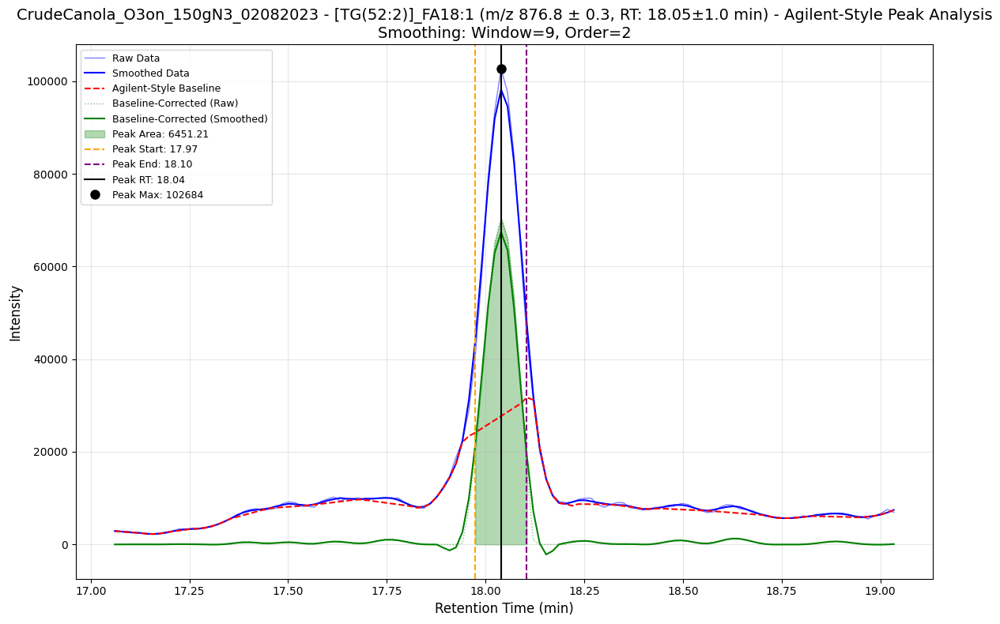

  Processing n-7 ion (m/z 794.8)
  Searching RT window: 17.05 - 19.05 min for CrudeCanola_O3on_150gN3_02082023


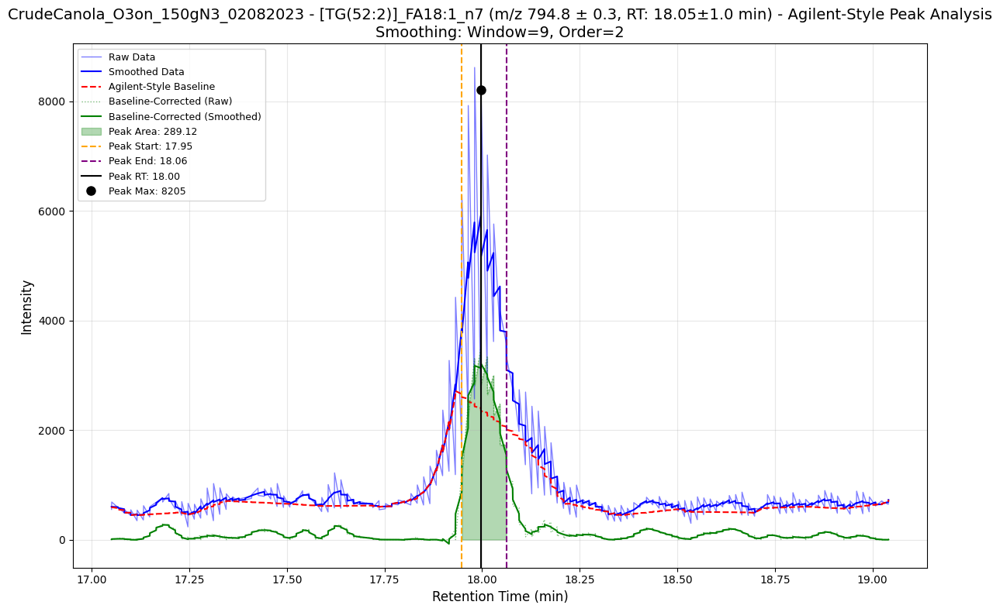

  Processing n-9 ion (m/z 766.8)
  Searching RT window: 17.05 - 19.05 min for CrudeCanola_O3on_150gN3_02082023


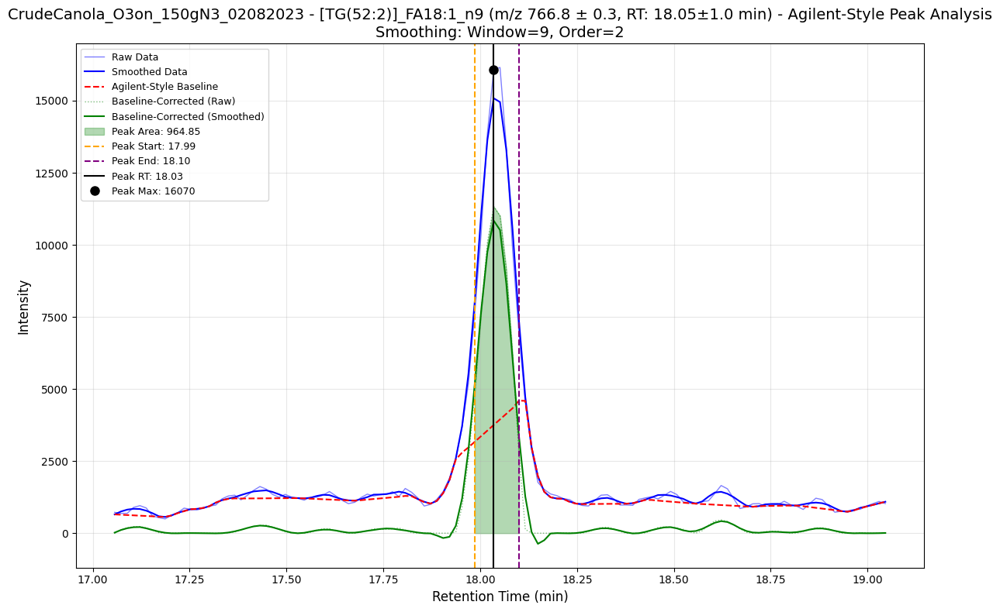

Processing lipid: [TG(52:3)]_FA18:1 (m/z 874.8, RT 16.09 min ± 1.0 min)
  Searching RT window: 15.09 - 17.09 min for CrudeCanola_O3on_150gN3_02082023


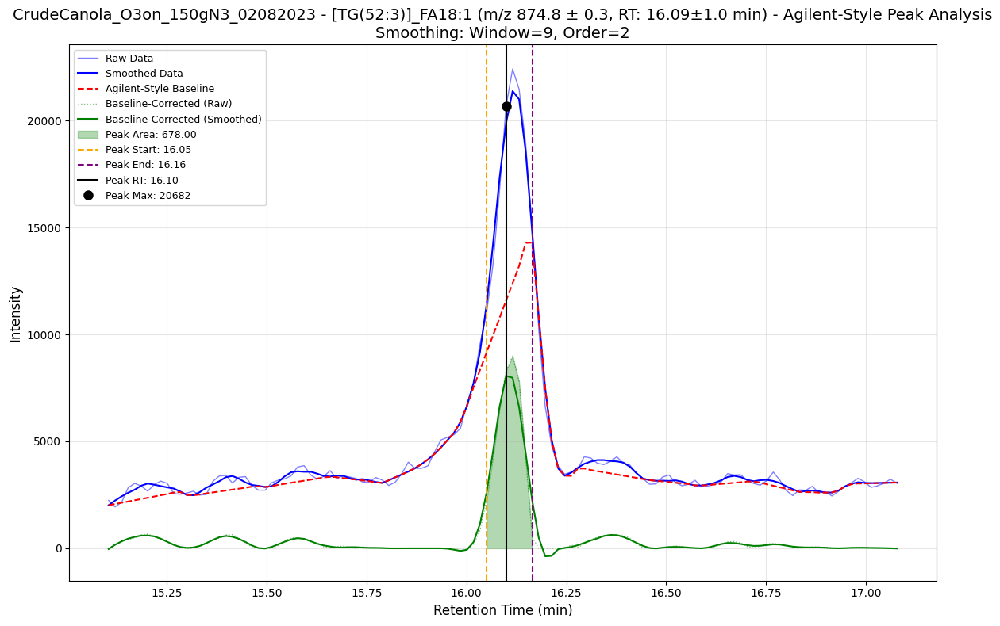

  Processing n-7 ion (m/z 792.8)
  Searching RT window: 15.09 - 17.09 min for CrudeCanola_O3on_150gN3_02082023


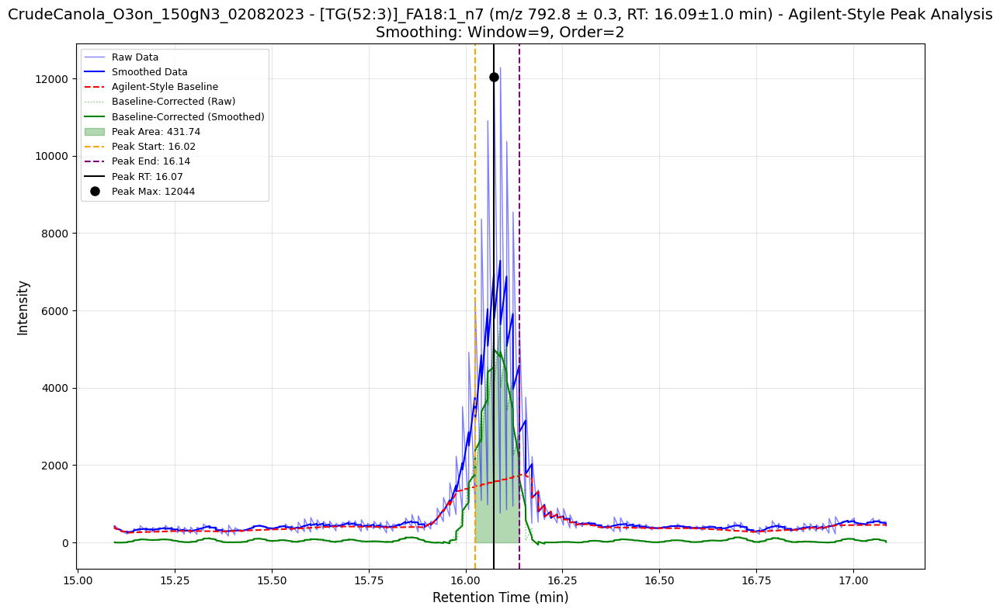

  Processing n-9 ion (m/z 764.8)
  Searching RT window: 15.09 - 17.09 min for CrudeCanola_O3on_150gN3_02082023


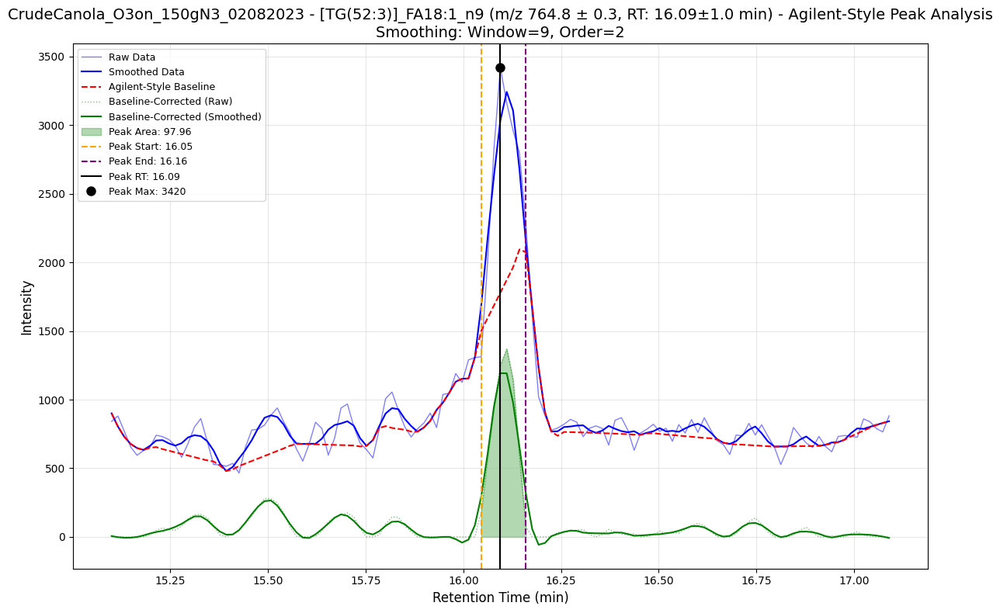

Processing lipid: [TG(52:4)]_FA18:1 (m/z 872.8, RT 14.3 min ± 1.0 min)
  Searching RT window: 13.30 - 15.30 min for CrudeCanola_O3on_150gN3_02082023


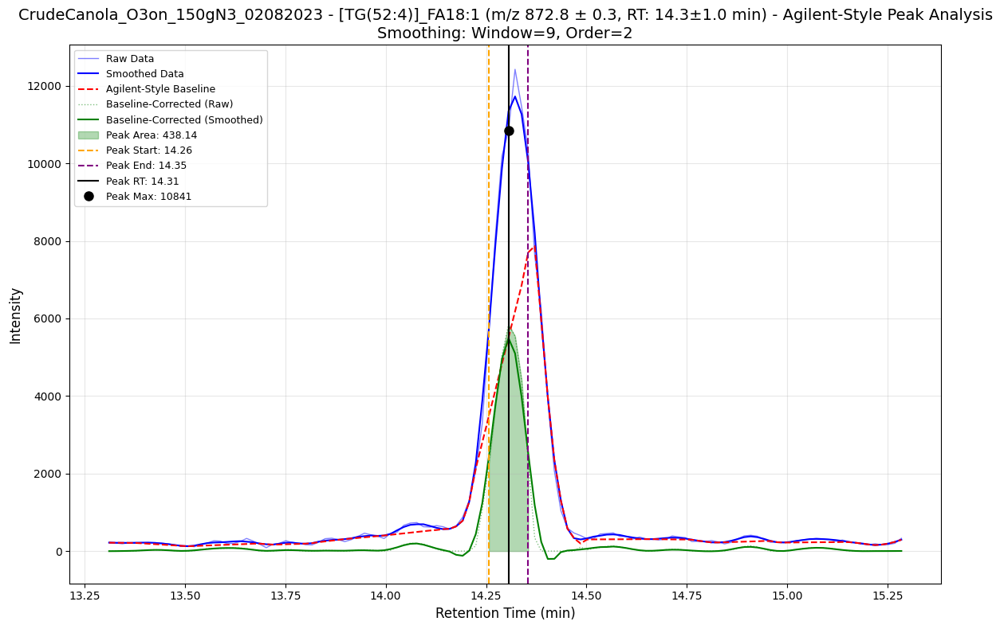

  Processing n-7 ion (m/z 790.8)
  Searching RT window: 13.30 - 15.30 min for CrudeCanola_O3on_150gN3_02082023


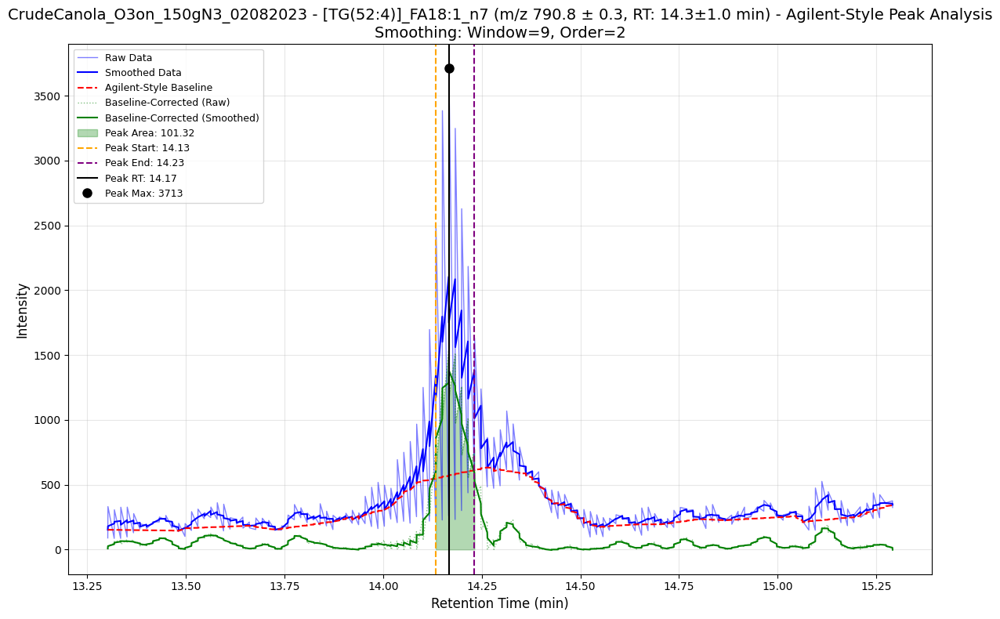

  Processing n-9 ion (m/z 762.8)
  Searching RT window: 13.30 - 15.30 min for CrudeCanola_O3on_150gN3_02082023


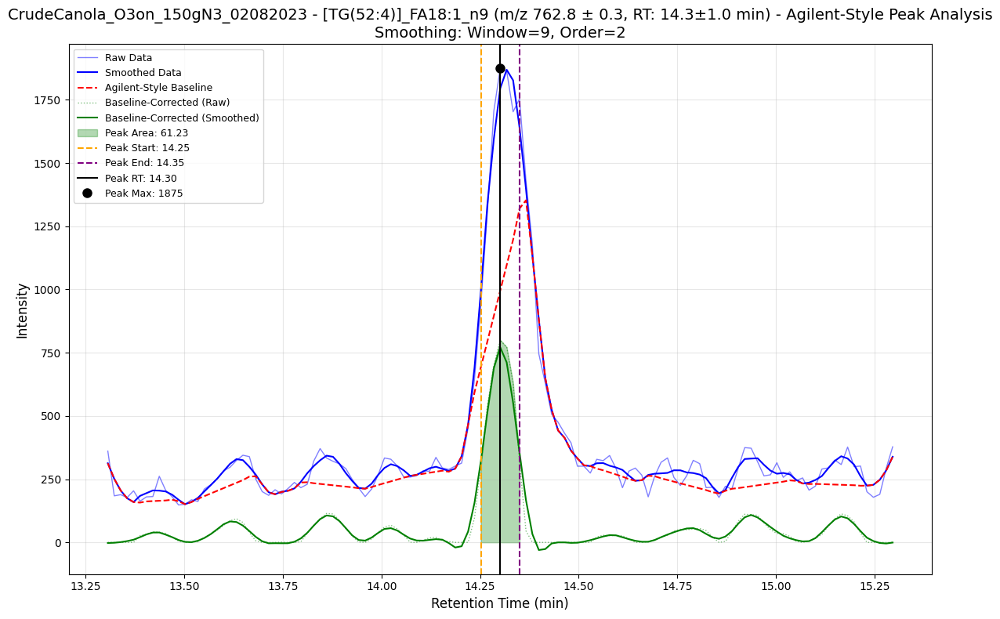

Processing lipid: [TG(54:2)]_FA18:1 (m/z 904.8, RT 20.0 min ± 1.0 min)
  Searching RT window: 19.00 - 21.00 min for CrudeCanola_O3on_150gN3_02082023


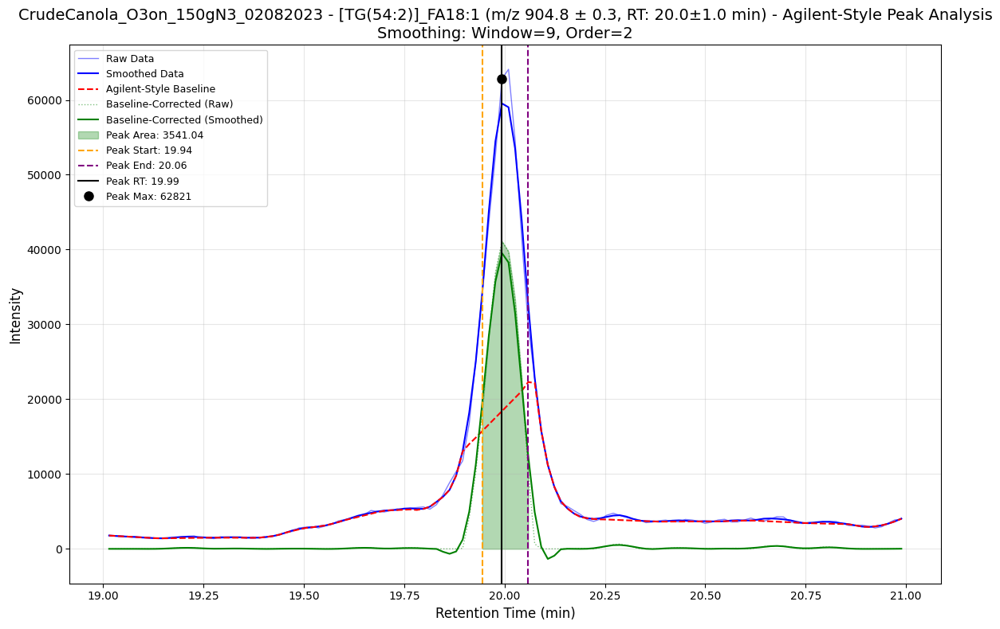

  Processing n-7 ion (m/z 822.8)
  Searching RT window: 19.00 - 21.00 min for CrudeCanola_O3on_150gN3_02082023


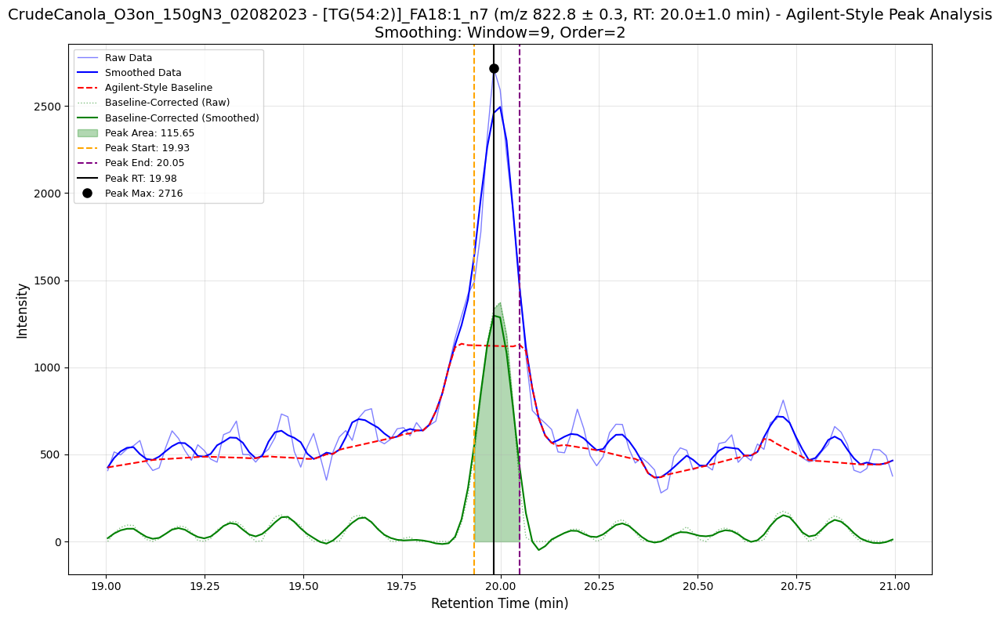

  Processing n-9 ion (m/z 794.8)
  Searching RT window: 19.00 - 21.00 min for CrudeCanola_O3on_150gN3_02082023


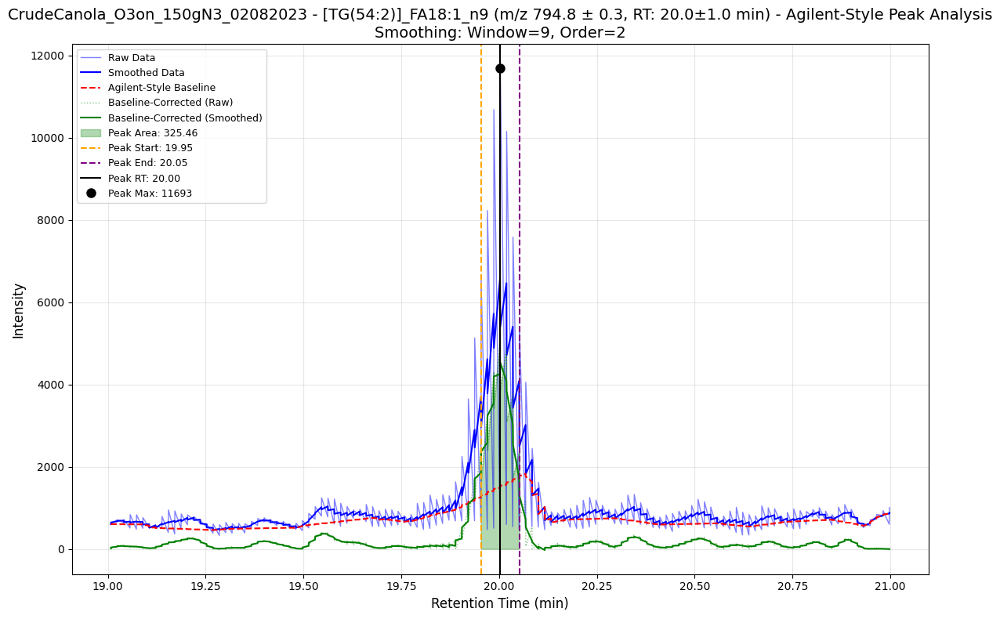

Processing lipid: [TG(54:3)]_FA18:1 (m/z 902.8, RT 17.98 min ± 1.0 min)
  Searching RT window: 16.98 - 18.98 min for CrudeCanola_O3on_150gN3_02082023


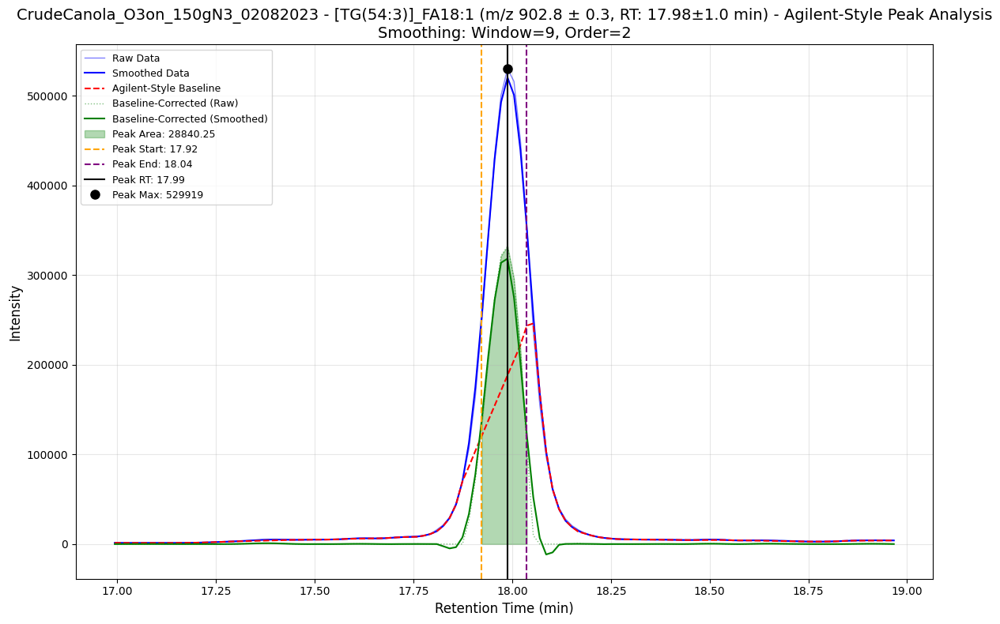

  Processing n-7 ion (m/z 820.8)
  Searching RT window: 16.98 - 18.98 min for CrudeCanola_O3on_150gN3_02082023


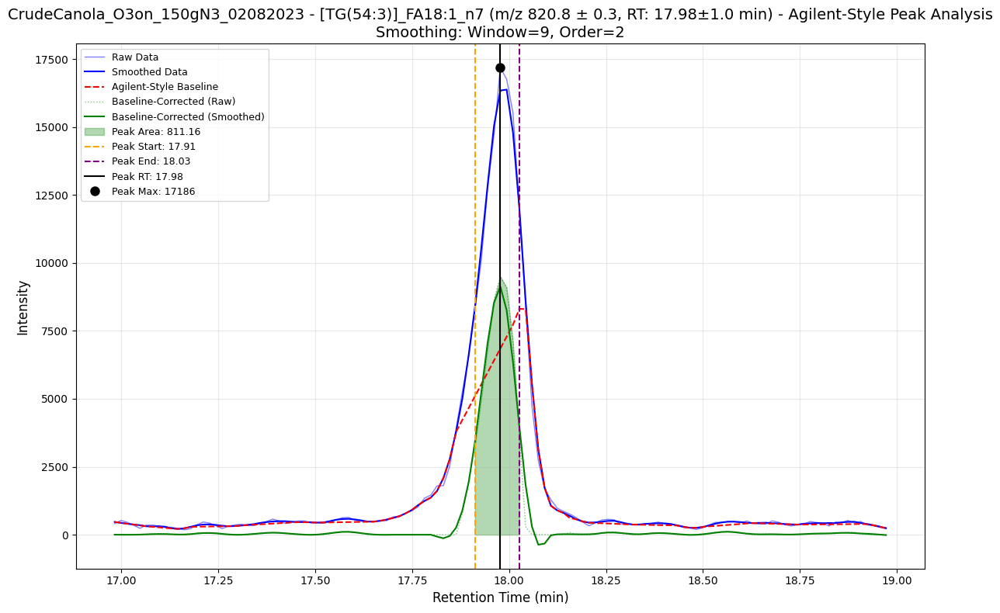

  Processing n-9 ion (m/z 792.8)
  Searching RT window: 16.98 - 18.98 min for CrudeCanola_O3on_150gN3_02082023


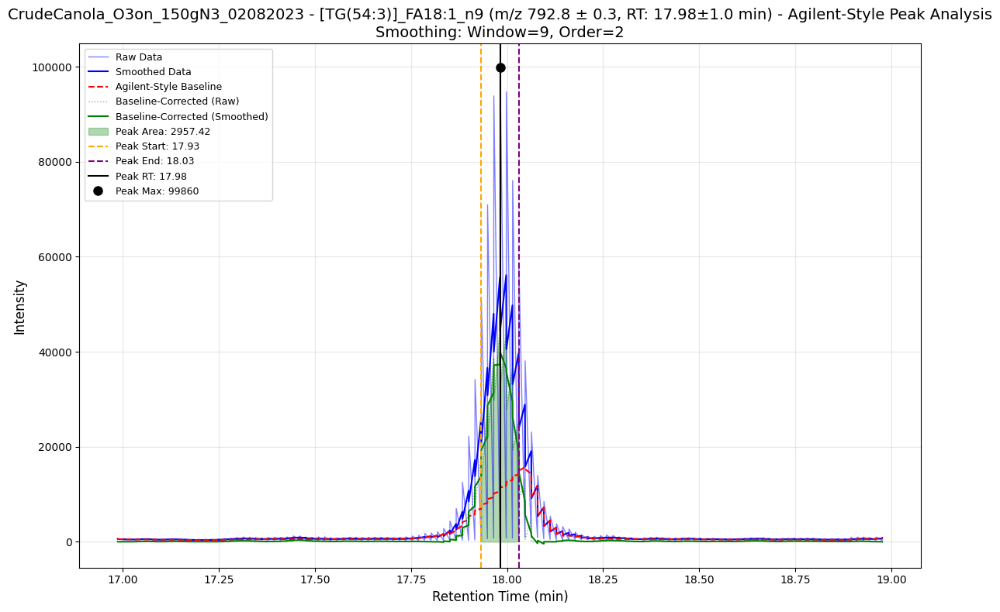

Processing lipid: [TG(54:4)]_FA18:1 (m/z 900.8, RT 16.07 min ± 1.0 min)
  Searching RT window: 15.07 - 17.07 min for CrudeCanola_O3on_150gN3_02082023


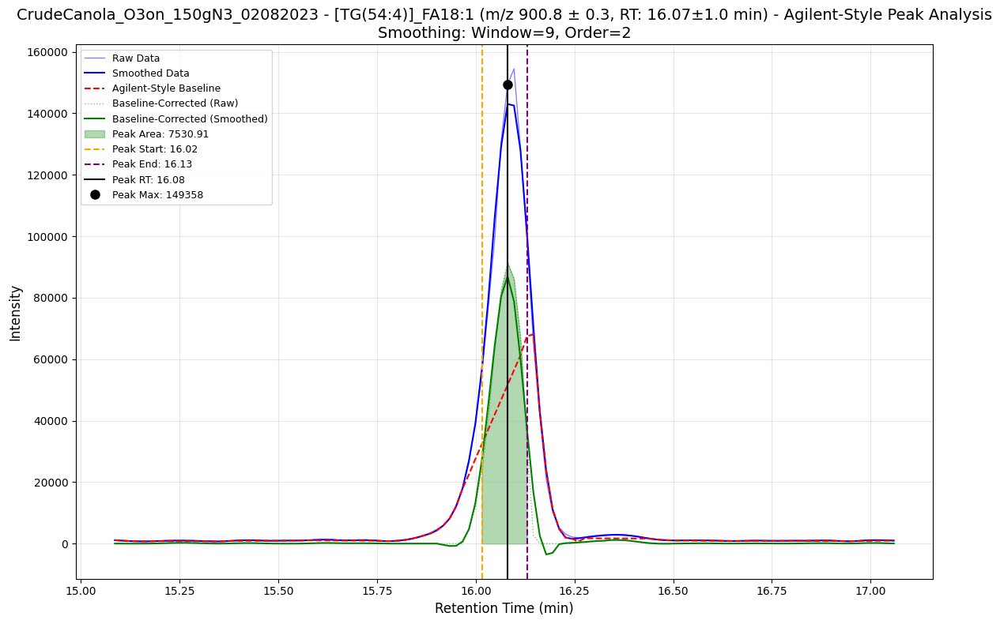

  Processing n-7 ion (m/z 818.8)
  Searching RT window: 15.07 - 17.07 min for CrudeCanola_O3on_150gN3_02082023


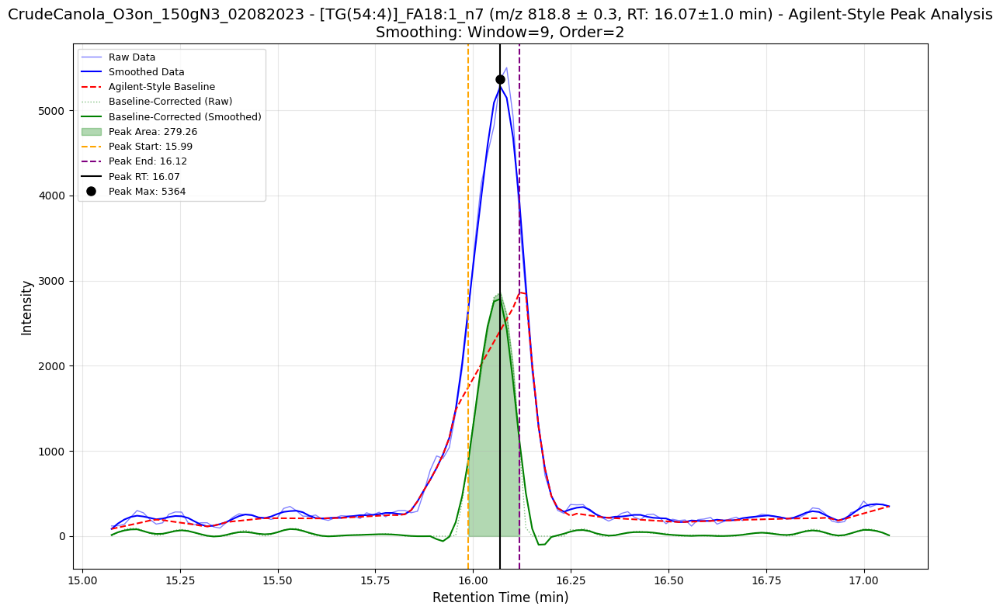

  Processing n-9 ion (m/z 790.8)
  Searching RT window: 15.07 - 17.07 min for CrudeCanola_O3on_150gN3_02082023


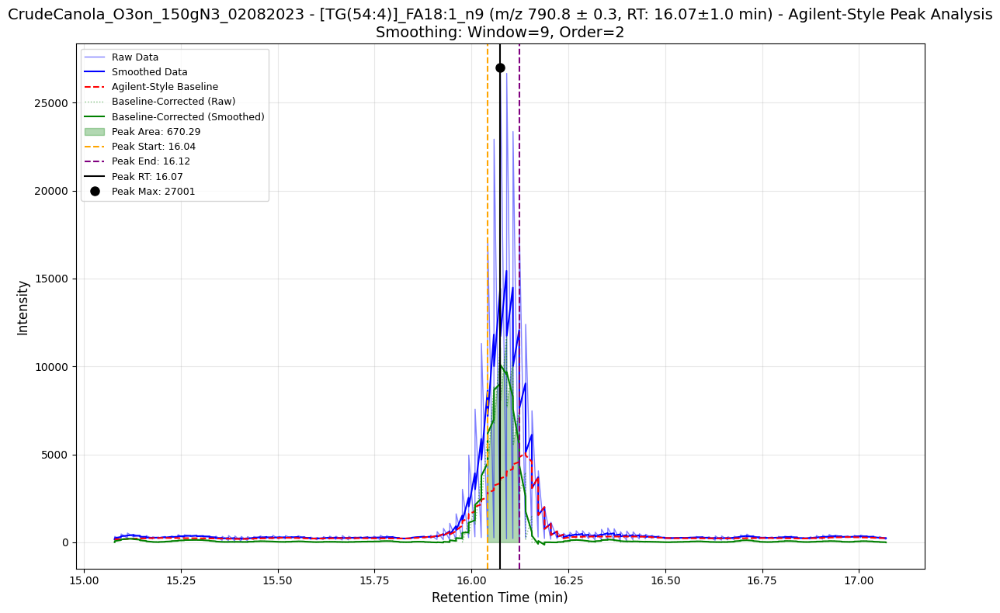

Processing lipid: [TG(54:5)]_FA18:1 (m/z 898.8, RT 14.31 min ± 1.0 min)
  Searching RT window: 13.31 - 15.31 min for CrudeCanola_O3on_150gN3_02082023


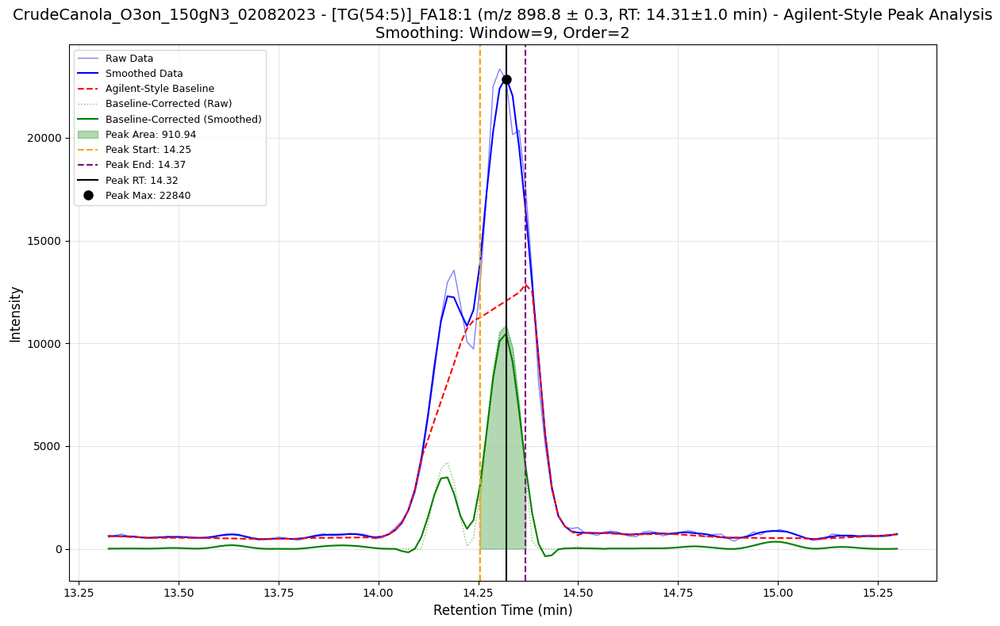

  Processing n-7 ion (m/z 816.8)
  Searching RT window: 13.31 - 15.31 min for CrudeCanola_O3on_150gN3_02082023


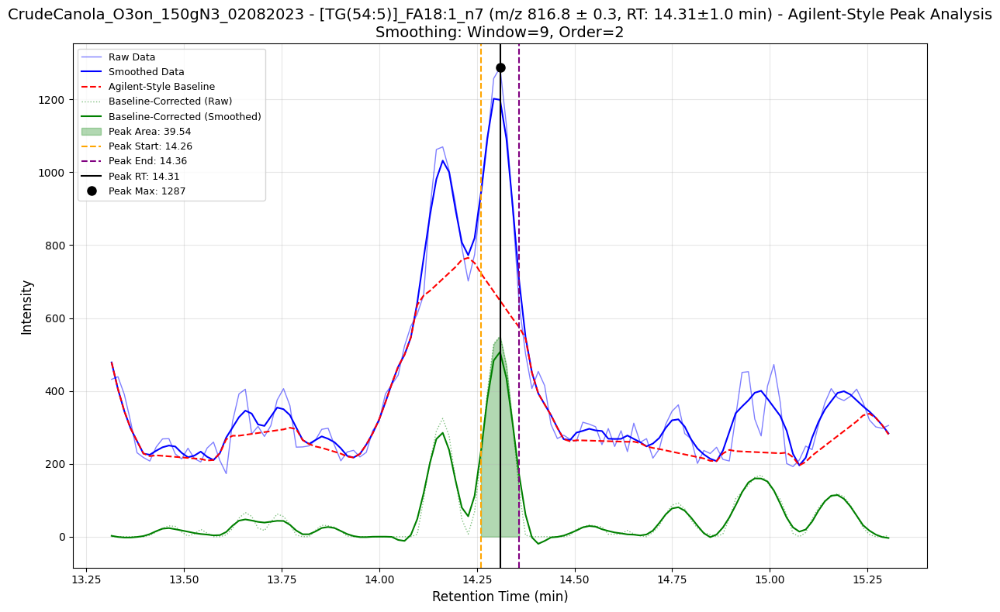

  Processing n-9 ion (m/z 788.8)
  Searching RT window: 13.31 - 15.31 min for CrudeCanola_O3on_150gN3_02082023


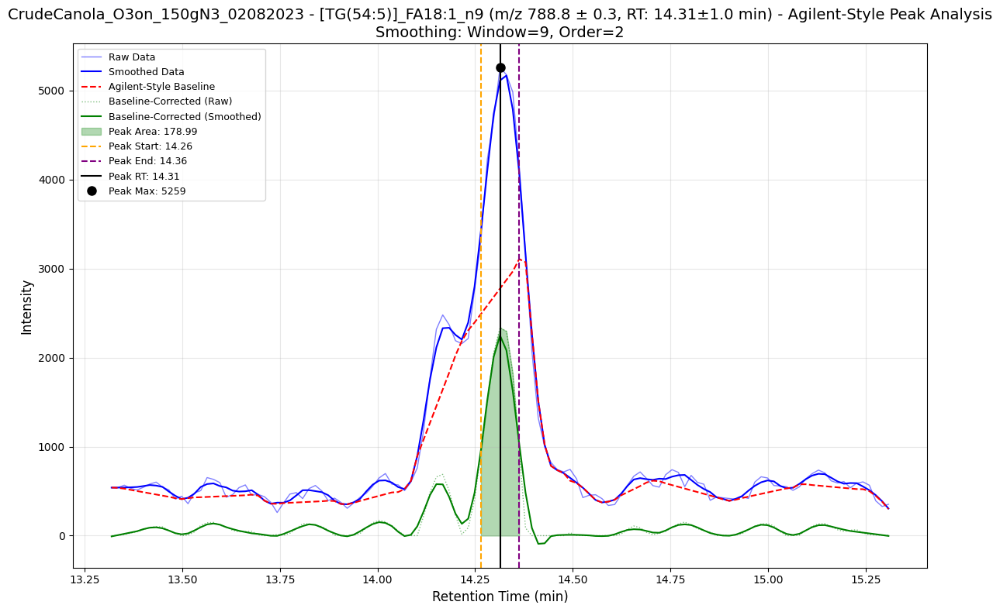

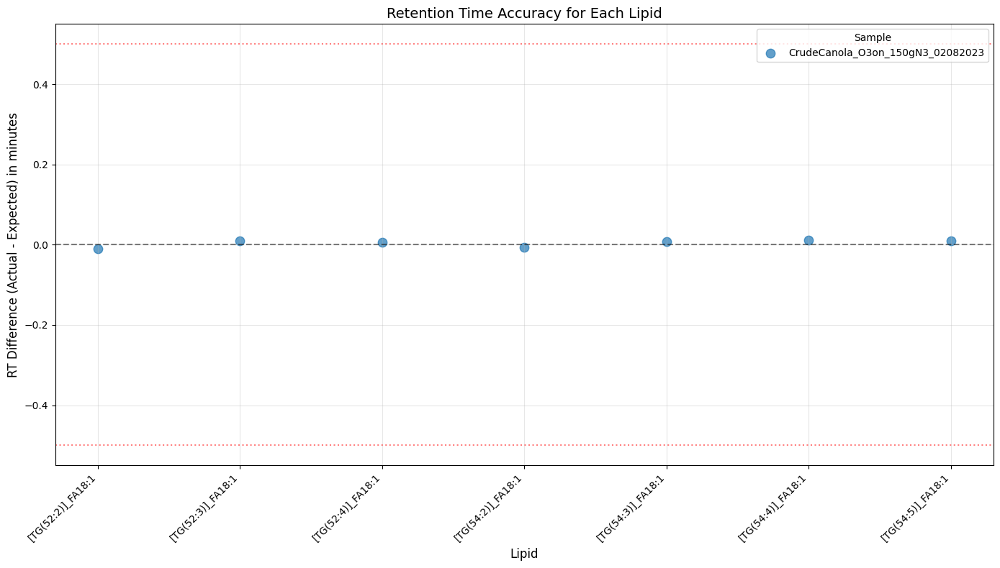

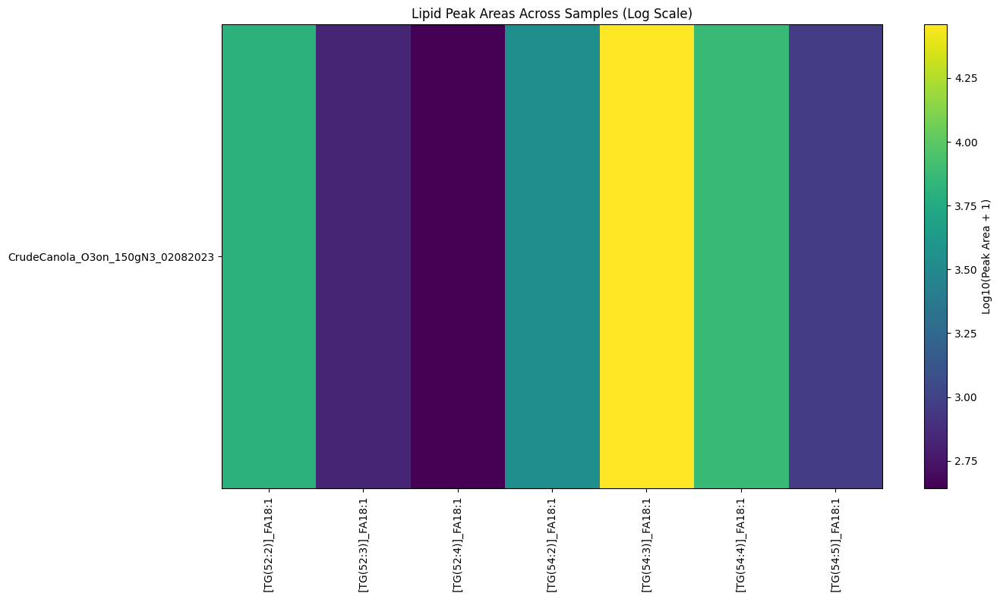

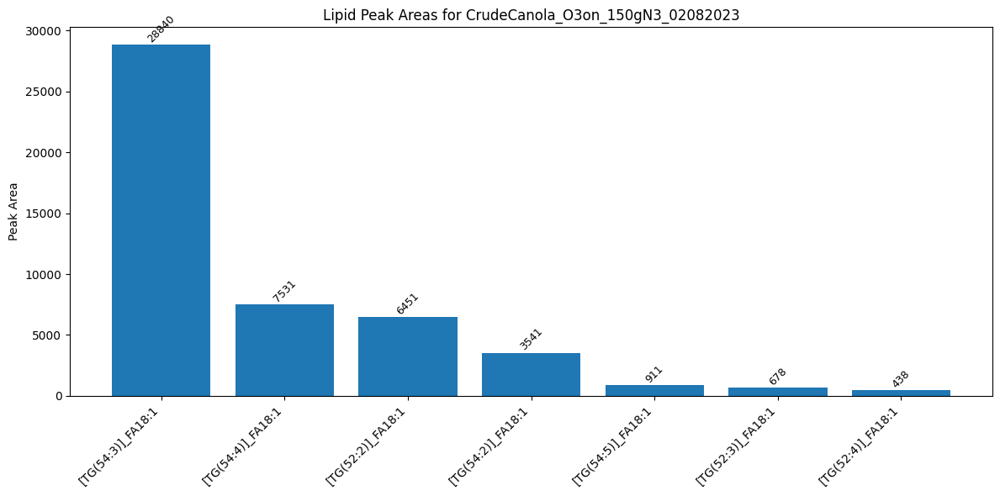

<Figure size 1400x800 with 0 Axes>

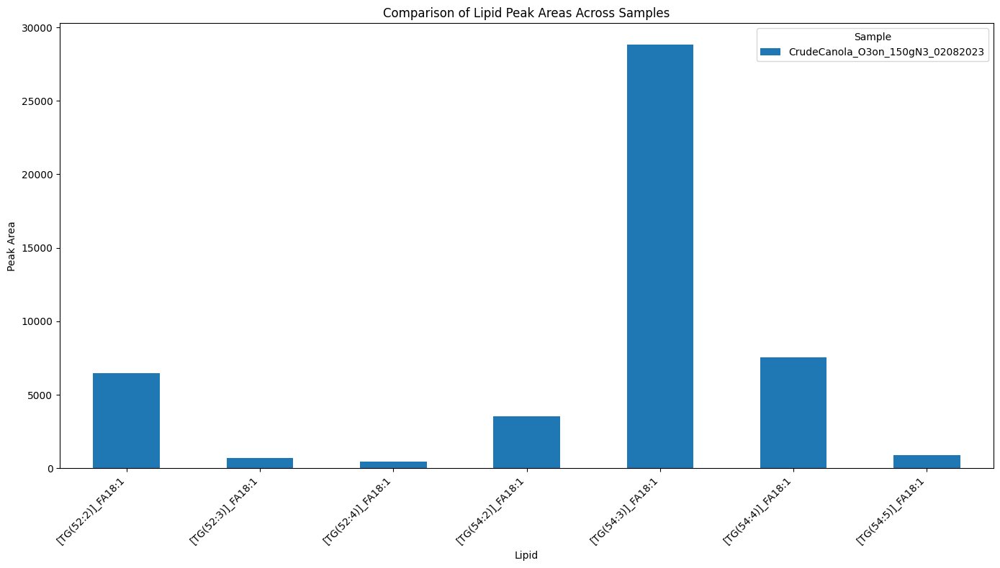


Retention Time Analysis Summary:
                   Expected_RT_first  Peak_RT_mean  Peak_RT_std  Peak_RT_min  \
Lipid                                                                          
[TG(52:2)]_FA18:1              18.05        18.039          NaN       18.039   
[TG(52:3)]_FA18:1              16.09        16.099          NaN       16.099   
[TG(52:4)]_FA18:1              14.30        14.306          NaN       14.306   
[TG(54:2)]_FA18:1              20.00        19.994          NaN       19.994   
[TG(54:3)]_FA18:1              17.98        17.988          NaN       17.988   
[TG(54:4)]_FA18:1              16.07        16.081          NaN       16.081   
[TG(54:5)]_FA18:1              14.31        14.320          NaN       14.320   

                   Peak_RT_max  RT_Difference_mean  RT_Difference_std  \
Lipid                                                                   
[TG(52:2)]_FA18:1       18.039              -0.011                NaN   
[TG(52:3)]_FA18:1       16

<Figure size 1400x800 with 0 Axes>

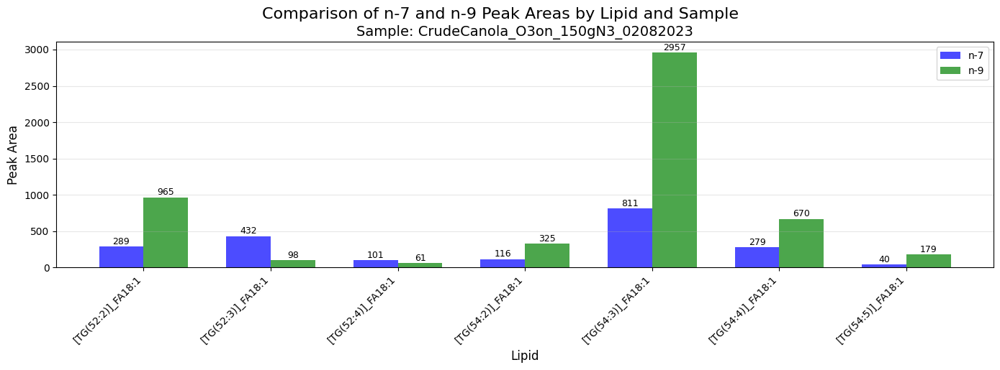

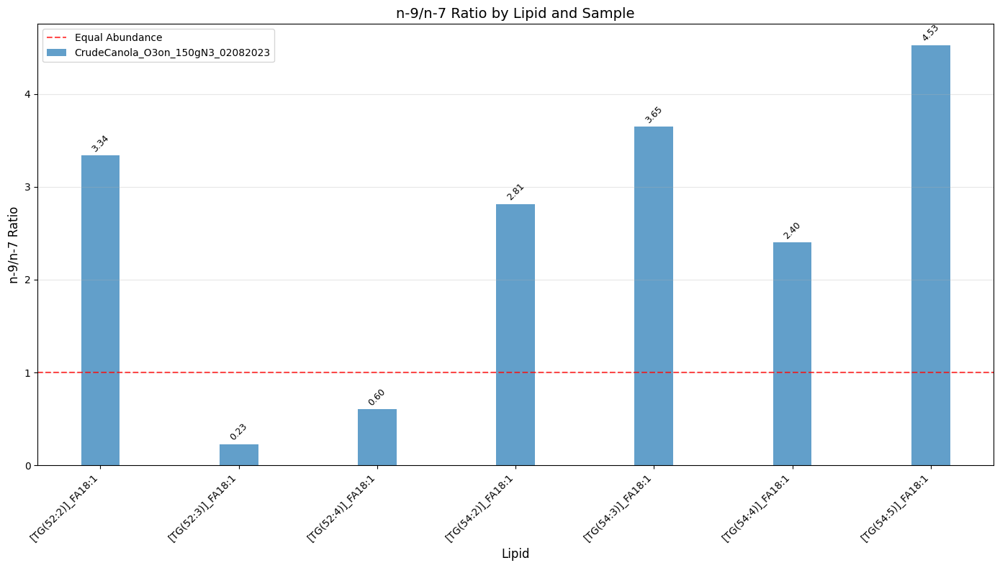


n-9/n-7 Ratio Summary:
Sample_ID          CrudeCanola_O3on_150gN3_02082023
Parent_Lipid                                       
[TG(52:2)]_FA18:1                              3.34
[TG(52:3)]_FA18:1                              0.23
[TG(52:4)]_FA18:1                              0.60
[TG(54:2)]_FA18:1                              2.81
[TG(54:3)]_FA18:1                              3.65
[TG(54:4)]_FA18:1                              2.40
[TG(54:5)]_FA18:1                              4.53


In [83]:
def create_n7_n9_comparison(n7_df, n9_df):
    """
    Create bar plots comparing n-7 and n-9 peak areas and their ratios
    
    Parameters:
    -----------
    n7_df : DataFrame
        DataFrame containing n-7 peak information
    n9_df : DataFrame
        DataFrame containing n-9 peak information
    """
    if n7_df.empty or n9_df.empty:
        print("Insufficient data for n-7 vs n-9 comparison.")
        return
    
    # Create a merged dataframe for easier comparison
    n7_pivot = n7_df.pivot(index=['Sample_ID', 'Parent_Lipid'], values='Peak_Area', columns=['Ion_Type'])
    n9_pivot = n9_df.pivot(index=['Sample_ID', 'Parent_Lipid'], values='Peak_Area', columns=['Ion_Type'])
    
    # Combine the dataframes
    combined = pd.DataFrame(index=n7_pivot.index)
    if 'n-7' in n7_pivot:
        combined['n-7'] = n7_pivot['n-7']
    else:
        combined['n-7'] = 0
        
    if 'n-9' in n9_pivot:
        combined['n-9'] = n9_pivot['n-9']
    else:
        combined['n-9'] = 0
    
    # Fill NA values with 0
    combined = combined.fillna(0)
    
    # Calculate n-9/n-7 ratio (avoiding divide by zero)
    combined['n9_n7_ratio'] = combined.apply(
        lambda row: row['n-9'] / row['n-7'] if row['n-7'] > 0 else float('nan'), 
        axis=1
    )
    
    # Reset index for easier plotting
    combined = combined.reset_index()
    
    # Plot 1: n-7 and n-9 comparison for each lipid and sample
    plt.figure(figsize=(14, 8))
    
    # Get unique samples and lipids
    samples = combined['Sample_ID'].unique()
    lipids = combined['Parent_Lipid'].unique()
    
    # Create positions for bars
    bar_width = 0.35
    x = np.arange(len(lipids))
    
    # Create a separate subplot for each sample
    fig, axes = plt.subplots(len(samples), 1, figsize=(14, 5*len(samples)), sharex=True)
    if len(samples) == 1:
        axes = [axes]  # Make sure axes is iterable even with one sample
    
    for i, sample in enumerate(samples):
        ax = axes[i]
        sample_data = combined[combined['Sample_ID'] == sample]
        
        # Ensure data for all lipids
        sample_plot_data = []
        for lipid in lipids:
            lipid_data = sample_data[sample_data['Parent_Lipid'] == lipid]
            if lipid_data.empty:
                sample_plot_data.append({'Parent_Lipid': lipid, 'n-7': 0, 'n-9': 0, 'n9_n7_ratio': float('nan')})
            else:
                sample_plot_data.append(lipid_data.iloc[0])
        
        sample_plot_df = pd.DataFrame(sample_plot_data)
        
        # Plot bars
        bar1 = ax.bar(x - bar_width/2, sample_plot_df['n-7'], bar_width, label='n-7', color='blue', alpha=0.7)
        bar2 = ax.bar(x + bar_width/2, sample_plot_df['n-9'], bar_width, label='n-9', color='green', alpha=0.7)
        
        # Add value labels on bars
        for bar in [bar1, bar2]:
            for rect in bar:
                height = rect.get_height()
                if height > 0:
                    ax.text(rect.get_x() + rect.get_width()/2., height + 5,
                            f'{height:.0f}', ha='center', va='bottom', fontsize=9)
        
        # Add labels
        ax.set_title(f'Sample: {sample}', fontsize=14)
        ax.set_ylabel('Peak Area', fontsize=12)
        ax.set_xticks(x)
        ax.set_xticklabels(lipids, rotation=45, ha='right')
        ax.legend()
        ax.grid(True, alpha=0.3, axis='y')
    
    plt.xlabel('Lipid', fontsize=12)
    plt.tight_layout()
    plt.suptitle('Comparison of n-7 and n-9 Peak Areas by Lipid and Sample', fontsize=16, y=1.02)
    plt.show()
    
    # Plot 2: n-9/n-7 ratio for each lipid and sample
    plt.figure(figsize=(14, 8))
    
    # Create positions for bars
    bar_positions = np.arange(len(lipids))
    
    # Plot a separate bar for each sample
    for i, sample in enumerate(samples):
        sample_data = combined[combined['Sample_ID'] == sample]
        
        # Create a list of ratios for each lipid
        ratios = []
        for lipid in lipids:
            lipid_data = sample_data[sample_data['Parent_Lipid'] == lipid]
            if not lipid_data.empty and not np.isnan(lipid_data['n9_n7_ratio'].values[0]):
                ratios.append(lipid_data['n9_n7_ratio'].values[0])
            else:
                ratios.append(0)
        
        # Plot bars for this sample with offset
        offset = (i - len(samples)/2 + 0.5) * (bar_width * 0.8)
        bars = plt.bar(bar_positions + offset, ratios, bar_width * 0.8, 
                      label=sample, alpha=0.7)
        
        # Add value labels on bars
        for bar, ratio in zip(bars, ratios):
            height = bar.get_height()
            if height > 0:
                plt.text(bar.get_x() + bar.get_width()/2., height + 0.02,
                        f'{height:.2f}', ha='center', va='bottom', fontsize=9, rotation=45)
    
    # Add horizontal line at ratio = 1
    plt.axhline(y=1, color='red', linestyle='--', alpha=0.7, label='Equal Abundance')
    
    # Add labels
    plt.xlabel('Lipid', fontsize=12)
    plt.ylabel('n-9/n-7 Ratio', fontsize=12)
    plt.title('n-9/n-7 Ratio by Lipid and Sample', fontsize=14)
    plt.xticks(bar_positions, lipids, rotation=45, ha='right')
    plt.legend()
    plt.grid(True, alpha=0.3, axis='y')
    plt.tight_layout()
    plt.show()
    
    # Print summary table of n-9/n-7 ratios
    print("\nn-9/n-7 Ratio Summary:")
    ratio_pivot = combined.pivot(index='Parent_Lipid', columns='Sample_ID', values='n9_n7_ratio')
    print(ratio_pivot.round(2))
import matplotlib.pyplot as plt
import pandas as pd
from scipy.signal import find_peaks, savgol_filter
from scipy.integrate import trapezoid
import io

# Parse the lipid data with retention times
lipid_data_str = """Lipid,Precursor_Ion,Product_Ion,n-7,n-9,Retention_Time
[TG(52:2)]_FA18:1,876.8,577.596,794.8,766.8,18.05
[TG(52:3)]_FA18:1,874.8,575.596,792.8,764.8,16.09
[TG(52:4)]_FA18:1,872.8,573.596,790.8,762.8,14.3
[TG(54:2)]_FA18:1,904.8,605.596,822.8,794.8,20
[TG(54:3)]_FA18:1,902.8,603.596,820.8,792.8,17.98
[TG(54:4)]_FA18:1,900.8,601.596,818.8,790.8,16.07
[TG(54:5)]_FA18:1,898.8,599.596,816.8,788.8,14.31"""

# Load lipid data into a DataFrame
lipid_df = pd.read_csv(io.StringIO(lipid_data_str))

# Create dictionaries for quick lookup of n-7 and n-9 values by precursor ion
n7_dict = dict(zip(lipid_df['Precursor_Ion'], lipid_df['n-7']))
n9_dict = dict(zip(lipid_df['Precursor_Ion'], lipid_df['n-9']))
lipid_name_dict = dict(zip(lipid_df['Precursor_Ion'], lipid_df['Lipid']))

# Define global parameters
parent_ion_tolerance = 0.3  # Define tolerance parameter at ±0.3
retention_time_window = 1.0  # ±1 minute window for each lipid

sample_ids = [
    'CrudeCanola_O3on_150gN3_02082023',
    # 'DegummedCanola_O3on_150gN3_02082023',
    # 'RBDCanola_O3on_150gN3_02082023'
]

def detect_baseline_agilent_style(rt, intensity, height_threshold=0.05, 
                                  smoothing_window=5, baseline_chunks=20):
    """
    Detect baseline using an approach similar to Agilent's method.
    
    Parameters:
    -----------
    rt : array-like
        Retention time array
    intensity : array-like
        Intensity values
    height_threshold : float
        Threshold for peak detection relative to max intensity
    smoothing_window : int
        Window size for Savitzky-Golay smoothing
    baseline_chunks : int
        Number of chunks to divide the chromatogram for baseline determination
        
    Returns:
    --------
    baseline : array-like
        The calculated baseline
    """
    # Normalize intensity for relative calculations
    max_intensity = np.max(intensity)
    if max_intensity == 0:
        return np.zeros_like(intensity)
        
    norm_intensity = intensity / max_intensity
    
    # Step 1: Divide chromatogram into chunks and find local minima
    chunk_size = max(3, len(norm_intensity) // baseline_chunks)
    baseline_points = []
    
    for i in range(0, len(norm_intensity), chunk_size):
        chunk_end = min(i + chunk_size, len(norm_intensity))
        if chunk_end - i >= 2:  # Need at least 2 points to find minimum
            min_idx = i + np.argmin(norm_intensity[i:chunk_end])
            baseline_points.append((rt[min_idx], norm_intensity[min_idx]))
    
    # Ensure we have start and end points
    if not baseline_points or baseline_points[0][0] > rt[0]:
        baseline_points.insert(0, (rt[0], norm_intensity[0]))
    if not baseline_points or baseline_points[-1][0] < rt[-1]:
        baseline_points.append((rt[-1], norm_intensity[-1]))
    
    # Step 2: Interpolate between baseline points
    baseline_x = [point[0] for point in baseline_points]
    baseline_y = [point[1] for point in baseline_points]
    
    # Linear interpolation between baseline points
    baseline = np.interp(rt, baseline_x, baseline_y)
    
    # Step 3: Apply smoothing to the baseline
    if len(baseline) > smoothing_window:
        baseline = savgol_filter(baseline, smoothing_window, 2)
    
    # Step 4: Apply Agilent-style constraint: baseline never exceeds the signal
    for i in range(len(baseline)):
        if baseline[i] > norm_intensity[i]:
            baseline[i] = norm_intensity[i]
    
    # Return baseline scaled back to original intensity range
    return baseline * max_intensity

def find_and_integrate_peak_agilent_style(rt, intensity, 
                                         height_threshold=0.05, 
                                         prominence=0.05,
                                         width_threshold=5, 
                                         plot_details=False,
                                         title_prefix="",
                                         smoothing_window=7,
                                         smoothing_polyorder=2):
    """
    Find and integrate peaks using an Agilent-like approach.
    
    Parameters:
    -----------
    rt : array-like
        Retention time array
    intensity : array-like
        Intensity values
    height_threshold : float
        Threshold for peak detection relative to max intensity
    prominence : float
        Minimum peak prominence relative to max intensity
    width_threshold : int
        Minimum width (in data points) for a peak to be considered
    plot_details : bool
        Whether to show detailed plot of peak detection steps
    title_prefix : str
        Prefix for plot title
    smoothing_window : int
        Window size for Savitzky-Golay smoothing (must be odd)
    smoothing_polyorder : int
        Polynomial order for Savitzky-Golay smoothing
        
    Returns:
    --------
    result : dict
        Dictionary containing peak information
    """
    # Handle empty or invalid data
    if len(rt) < 3 or np.max(intensity) == 0:
        return {
            'Peak_Area': 0,
            'Max_Original_Intensity': 0,
            'Max_Corrected_Intensity': 0,
            'Peak_Start': 0,
            'Peak_Stop': 0,
            'Peak_RT': 0,
            'Baseline': np.zeros_like(intensity) if len(intensity) > 0 else np.array([])
        }
    
    # Ensure smoothing window is odd
    if smoothing_window % 2 == 0:
        smoothing_window += 1
    
    # Make sure smoothing window isn't too large for the data
    if len(intensity) < smoothing_window:
        smoothing_window = min(5, len(intensity))
        if smoothing_window % 2 == 0 and smoothing_window > 1:
            smoothing_window -= 1
    
    # Step 1: Apply Savitzky-Golay smoothing to reduce noise
    if len(intensity) > smoothing_window and smoothing_window >= 3:
        try:
            smoothed_intensity = savgol_filter(intensity, smoothing_window, smoothing_polyorder)
        except Exception as e:
            print(f"Warning: Smoothing error - {e}. Using original data.")
            smoothed_intensity = intensity.copy()
    else:
        smoothed_intensity = intensity.copy()
    
    # Step 2: Detect baseline
    baseline = detect_baseline_agilent_style(rt, smoothed_intensity)
    
    # Step 3: Subtract baseline to get corrected intensity
    corrected_intensity = np.maximum(smoothed_intensity - baseline, 0)
    
    # Apply additional smoothing to the corrected intensity
    if len(corrected_intensity) > smoothing_window and smoothing_window >= 3:
        try:
            smoothed_corrected = savgol_filter(corrected_intensity, smoothing_window, smoothing_polyorder)
        except Exception as e:
            print(f"Warning: Smoothing error on corrected data - {e}. Using unsmoothed corrected data.")
            smoothed_corrected = corrected_intensity.copy()
    else:
        smoothed_corrected = corrected_intensity.copy()
    
    # Step 4: Find peaks on baseline-corrected data
    # Convert relative parameters to absolute values
    abs_height = height_threshold * np.max(smoothed_corrected) if np.max(smoothed_corrected) > 0 else 0
    abs_prominence = prominence * np.max(smoothed_corrected) if np.max(smoothed_corrected) > 0 else 0
    
    peaks, peak_properties = find_peaks(
        smoothed_corrected,
        height=abs_height,
        prominence=abs_prominence,
        width=width_threshold
    )
    
    # If no peaks found, return zeroes
    if len(peaks) == 0:
        return {
            'Peak_Area': 0,
            'Max_Original_Intensity': 0,
            'Max_Corrected_Intensity': 0,
            'Peak_Start': 0,
            'Peak_Stop': 0,
            'Peak_RT': 0,
            'Baseline': baseline
        }
    
    # Step 5: Select the most prominent peak
    peak_idx = peaks[np.argmax(peak_properties["prominences"])]
    peak_rt = rt[peak_idx]
    
    # Step 6: Determine peak boundaries
    # Find the peak's left and right bounds at half height (similar to Agilent)
    peak_height = smoothed_corrected[peak_idx]
    half_height = peak_height / 2
    
    # Find left boundary (moving left from peak until below half height)
    left_idx = peak_idx
    while left_idx > 0 and smoothed_corrected[left_idx] > half_height:
        left_idx -= 1
    
    # Find right boundary (moving right from peak until below half height)
    right_idx = peak_idx
    while right_idx < len(smoothed_corrected) - 1 and smoothed_corrected[right_idx] > half_height:
        right_idx += 1
    
    # Convert indices to retention times
    peak_start_time = rt[left_idx]
    peak_stop_time = rt[right_idx]
    
    # Step 7: Apply Agilent-like constraint for reasonable peak width
    max_half_width = 0.6  # Agilent often limits very wide peaks
    if (peak_rt - peak_start_time) > max_half_width:
        # Find the time point that's max_half_width minutes before the peak
        start_candidates = np.where(rt >= (peak_rt - max_half_width))[0]
        if len(start_candidates) > 0:
            left_idx = min(start_candidates)
            peak_start_time = rt[left_idx]
    
    if (peak_stop_time - peak_rt) > max_half_width:
        # Find the time point that's max_half_width minutes after the peak
        stop_candidates = np.where(rt <= (peak_rt + max_half_width))[0]
        if len(stop_candidates) > 0:
            right_idx = max(stop_candidates)
            peak_stop_time = rt[right_idx]
    
    # Step 8: Calculate peak area using the trapezoidal rule (Agilent's approach)
    # Get the subset of data within the peak boundaries
    mask = (rt >= peak_start_time) & (rt <= peak_stop_time)
    x_integration = rt[mask]
    y_integration = corrected_intensity[mask]
    
    # Ensure we have enough points for integration
    if len(x_integration) < 2:
        # Create more detailed points through interpolation
        x_detailed = np.linspace(peak_start_time, peak_stop_time, 20)
        y_detailed = np.interp(x_detailed, rt, corrected_intensity)
        
        # Use these for integration
        x_integration = x_detailed
        y_integration = y_detailed
    
    # Calculate area using trapezoidal rule
    peak_area = trapezoid(y_integration, x_integration)
    
    # Step 9: Create result dictionary
    result = {
        'Peak_Area': peak_area,
        'Max_Original_Intensity': intensity[peak_idx],
        'Max_Corrected_Intensity': corrected_intensity[peak_idx],
        'Peak_Start': peak_start_time,
        'Peak_Stop': peak_stop_time,
        'Peak_RT': peak_rt,
        'Baseline': baseline
    }
    
    # Step 10: Plot the results if requested
    if plot_details:
        plt.figure(figsize=(12, 8))
        
        # Plot the original data
        plt.plot(rt, intensity, 'b-', linewidth=1, alpha=0.5, label="Raw Data")
        
        # Plot the smoothed data
        plt.plot(rt, smoothed_intensity, 'b-', linewidth=1.5, label="Smoothed Data")
        
        # Plot the baseline
        plt.plot(rt, baseline, 'r--', linewidth=1.5, label="Agilent-Style Baseline")
        
        # Plot the corrected intensity
        plt.plot(rt, corrected_intensity, 'g:', linewidth=1, alpha=0.5, label="Baseline-Corrected (Raw)")
        
        # Plot the smoothed corrected intensity
        plt.plot(rt, smoothed_corrected, 'g-', linewidth=1.5, label="Baseline-Corrected (Smoothed)")
        
        # Shade the area under the detected peak (baseline-corrected)
        plt.fill_between(x_integration, y_integration, alpha=0.3, color='green', 
                         label=f"Peak Area: {peak_area:.2f}")
        
        # Add vertical lines for peak start, peak, and stop
        plt.axvline(x=peak_start_time, linestyle="--", color="orange", 
                    label=f"Peak Start: {peak_start_time:.2f}")
        plt.axvline(x=peak_stop_time, linestyle="--", color="purple", 
                    label=f"Peak End: {peak_stop_time:.2f}")
        plt.axvline(x=peak_rt, linestyle="-", color="black", 
                    label=f"Peak RT: {peak_rt:.2f}")
        
        # Mark the detected peak
        plt.plot(peak_rt, intensity[peak_idx], 'ko', markersize=8, 
                 label=f"Peak Max: {intensity[peak_idx]:.0f}")
        
        # Add labels and legend
        plt.xlabel("Retention Time (min)", fontsize=12)
        plt.ylabel("Intensity", fontsize=12)
        plt.title(f"{title_prefix} - Agilent-Style Peak Analysis\nSmoothing: Window={smoothing_window}, Order={smoothing_polyorder}", fontsize=14)
        plt.legend(loc='upper left', fontsize=9)
        plt.grid(True, alpha=0.3)
        plt.tight_layout()
        plt.show()
    
    return result

def process_lipid_sample(lipid_name, precursor_ion, expected_rt, sample_id, plot_details=True, 
                      smoothing_window=7, smoothing_polyorder=2):
    """
    Process a single lipid in a specific sample and return the results
    
    Parameters:
    -----------
    lipid_name : str
        Name of the lipid
    precursor_ion : float
        Precursor ion m/z value
    expected_rt : float
        Expected retention time for this lipid
    sample_id : str
        Sample identifier
    plot_details : bool
        Whether to plot chromatogram details
    smoothing_window : int
        Window size for Savitzky-Golay smoothing (must be odd)
    smoothing_polyorder : int
        Polynomial order for Savitzky-Golay smoothing
    """
    # Calculate retention time window based on expected RT
    rt_start = max(0, expected_rt - retention_time_window)
    rt_end = expected_rt + retention_time_window
    
    print(f"  Searching RT window: {rt_start:.2f} - {rt_end:.2f} min for {sample_id}")
    
    # Filter the DataFrame for the given sample, parent ion (with tolerance), and retention time window
    subset = processed_df[
        (processed_df['Parent_Ion'] >= precursor_ion - parent_ion_tolerance) &
        (processed_df['Parent_Ion'] <= precursor_ion + parent_ion_tolerance) &
        (processed_df['Sample_ID'] == sample_id) &
        (processed_df['Retention_Time'] >= rt_start) &
        (processed_df['Retention_Time'] <= rt_end)
    ].copy()
    
    # Group by Retention_Time and take the maximum OzESI_Intensity
    aggregated = subset.groupby('Retention_Time', as_index=False)['OzESI_Intensity'].max()
    aggregated.sort_values('Retention_Time', inplace=True)
    aggregated = aggregated.reset_index(drop=True)
    
    # Skip if no data is available
    if aggregated.empty:
        print(f"No data for sample {sample_id}, lipid {lipid_name} (m/z {precursor_ion}) in RT window {rt_start:.2f} - {rt_end:.2f} min.")
        return {
            'Lipid': lipid_name,
            'Sample_ID': sample_id,
            'Precursor_Ion': precursor_ion,
            'Expected_RT': expected_rt,
            'RT_Window_Start': rt_start,
            'RT_Window_End': rt_end,
            'Peak_Area': 0,
            'Max_Intensity': 0,
            'Peak_RT': 0
        }
    
    # Get arrays for processing
    retention_times = aggregated['Retention_Time'].values
    intensity_array = aggregated['OzESI_Intensity'].values
    
    # Apply the Agilent-style peak finding and integration
    plot_title = f"{sample_id} - {lipid_name} (m/z {precursor_ion} ± {parent_ion_tolerance}, RT: {expected_rt}±{retention_time_window} min)"
    
    peak_result = find_and_integrate_peak_agilent_style(
        retention_times, 
        intensity_array,
        height_threshold=0.05,
        prominence=0.05,
        width_threshold=3,
        plot_details=plot_details,
        title_prefix=plot_title,
        smoothing_window=smoothing_window,
        smoothing_polyorder=smoothing_polyorder
    )
    
    # Return the results with retention time window information
    return {
        'Lipid': lipid_name,
        'Sample_ID': sample_id,
        'Precursor_Ion': precursor_ion,
        'Expected_RT': expected_rt,
        'RT_Window_Start': rt_start,
        'RT_Window_End': rt_end,
        'Peak_Area': peak_result['Peak_Area'],
        'Max_Intensity': peak_result['Max_Original_Intensity'],
        'Peak_RT': peak_result['Peak_RT'],
        'RT_Difference': peak_result['Peak_RT'] - expected_rt if peak_result['Peak_RT'] > 0 else float('nan')
    }

# Main analysis function
def analyze_all_lipids(process_all_samples=True, plot_individual=False, 
                  smoothing_window=7, smoothing_polyorder=2):
    """
    Analyze all lipids across all samples
    
    Parameters:
    -----------
    process_all_samples : bool
        If True, process all samples; if False, just process the first sample
    plot_individual : bool
        Whether to plot individual chromatograms for each lipid and sample
    smoothing_window : int
        Window size for Savitzky-Golay smoothing (must be odd)
    smoothing_polyorder : int
        Polynomial order for Savitzky-Golay smoothing
    """
    # List to store all results
    all_results = []
    
    # Lists to store n-7 and n-9 results
    n7_results = []
    n9_results = []
    
    # Determine which samples to process
    samples_to_process = sample_ids if process_all_samples else [sample_ids[0]]
    
    # Process each lipid
    for idx, row in lipid_df.iterrows():
        lipid_name = row['Lipid']
        precursor_ion = row['Precursor_Ion']
        expected_rt = row['Retention_Time']
        n7_ion = row['n-7']
        n9_ion = row['n-9']
        
        print(f"Processing lipid: {lipid_name} (m/z {precursor_ion}, RT {expected_rt} min ± {retention_time_window} min)")
        
        # Process this lipid for each sample
        for sample_id in samples_to_process:
            # Process precursor ion
            result = process_lipid_sample(
                lipid_name, 
                precursor_ion,
                expected_rt,
                sample_id, 
                plot_details=plot_individual,
                smoothing_window=smoothing_window,
                smoothing_polyorder=smoothing_polyorder
            )
            all_results.append(result)
            
            # Process n-7 ion
            print(f"  Processing n-7 ion (m/z {n7_ion})")
            n7_result = process_lipid_sample(
                f"{lipid_name}_n7", 
                n7_ion,
                expected_rt,
                sample_id, 
                plot_details=plot_individual,
                smoothing_window=smoothing_window,
                smoothing_polyorder=smoothing_polyorder
            )
            n7_result['Parent_Lipid'] = lipid_name
            n7_result['Ion_Type'] = 'n-7'
            n7_results.append(n7_result)
            
            # Process n-9 ion
            print(f"  Processing n-9 ion (m/z {n9_ion})")
            n9_result = process_lipid_sample(
                f"{lipid_name}_n9", 
                n9_ion,
                expected_rt,
                sample_id, 
                plot_details=plot_individual,
                smoothing_window=smoothing_window,
                smoothing_polyorder=smoothing_polyorder
            )
            n9_result['Parent_Lipid'] = lipid_name
            n9_result['Ion_Type'] = 'n-9'
            n9_results.append(n9_result)
    
    # Convert to DataFrames
    results_df = pd.DataFrame(all_results)
    n7_df = pd.DataFrame(n7_results)
    n9_df = pd.DataFrame(n9_results)
    
    # Create summary plots
    create_summary_plots(results_df)
    
    # Create n-7 vs n-9 comparison plots
    create_n7_n9_comparison(n7_df, n9_df)
    
    return results_df, n7_df, n9_df

def create_summary_plots(results_df):
    """
    Create summary plots for all analyzed lipids
    """
    if results_df.empty:
        print("No results to plot.")
        return
    
    # First, create a retention time difference plot
    plt.figure(figsize=(14, 8))
    rt_diff_data = results_df[results_df['Peak_RT'] > 0].copy()  # Filter out zeros
    
    if not rt_diff_data.empty:
        # Create scatter plot of RT differences
        for sample in rt_diff_data['Sample_ID'].unique():
            sample_data = rt_diff_data[rt_diff_data['Sample_ID'] == sample]
            plt.scatter(sample_data['Lipid'], sample_data['RT_Difference'], 
                       label=sample, s=80, alpha=0.7)
            
            # Add horizontal line at zero (perfect match)
            plt.axhline(y=0, color='black', linestyle='--', alpha=0.5)
            
            # Add horizontal lines at +/- 0.5 minutes (good match zone)
            plt.axhline(y=0.5, color='red', linestyle=':', alpha=0.5)
            plt.axhline(y=-0.5, color='red', linestyle=':', alpha=0.5)
        
        plt.ylabel('RT Difference (Actual - Expected) in minutes', fontsize=12)
        plt.xlabel('Lipid', fontsize=12)
        plt.title('Retention Time Accuracy for Each Lipid', fontsize=14)
        plt.xticks(rotation=45, ha='right')
        plt.grid(True, alpha=0.3)
        plt.legend(title='Sample')
        plt.tight_layout()
        plt.show()
    
    # Pivot the data for better visualization
    pivot_df = results_df.pivot(index='Sample_ID', columns='Lipid', values='Peak_Area')
    
    # Fill NaN with zeros
    pivot_df = pivot_df.fillna(0)
    
    # Plot heatmap of peak areas
    plt.figure(figsize=(14, 8))
    
    # Use log scale for better visualization (add small value to avoid log(0))
    log_data = np.log10(pivot_df.values + 1)
    
    plt.imshow(log_data, aspect='auto', cmap='viridis')
    plt.colorbar(label='Log10(Peak Area + 1)')
    
    # Add labels
    plt.yticks(range(len(pivot_df.index)), pivot_df.index)
    plt.xticks(range(len(pivot_df.columns)), pivot_df.columns, rotation=90)
    
    plt.title('Lipid Peak Areas Across Samples (Log Scale)')
    plt.tight_layout()
    plt.show()
    
    # Plot bar chart for each sample
    sample_groups = results_df.groupby('Sample_ID')
    
    for sample_id, group in sample_groups:
        plt.figure(figsize=(12, 6))
        
        # Sort by peak area for better visualization
        sorted_group = group.sort_values('Peak_Area', ascending=False)
        
        # Plot bar chart
        bar_plot = plt.bar(sorted_group['Lipid'], sorted_group['Peak_Area'])
        
        # Add value labels on top of bars
        for bar in bar_plot:
            height = bar.get_height()
            plt.text(bar.get_x() + bar.get_width()/2., height + 0.1,
                    f'{height:.0f}',
                    ha='center', va='bottom', fontsize=9, rotation=45)
        
        plt.title(f'Lipid Peak Areas for {sample_id}')
        plt.ylabel('Peak Area')
        plt.xticks(rotation=45, ha='right')
        plt.tight_layout()
        plt.show()
    
    # Create a stacked bar chart to compare samples
    plt.figure(figsize=(14, 8))
    
    # Transpose the pivot table to get lipids as rows and samples as columns
    stacked_data = pivot_df.T
    
    # Plot stacked bar chart
    stacked_data.plot(kind='bar', stacked=True, figsize=(14, 8))
    plt.title('Comparison of Lipid Peak Areas Across Samples')
    plt.xlabel('Lipid')
    plt.ylabel('Peak Area')
    plt.xticks(rotation=45, ha='right')
    plt.legend(title='Sample')
    plt.tight_layout()
    plt.show()
    
    # Create a summary table with retention time information
    print("\nRetention Time Analysis Summary:")
    
    rt_summary = results_df[results_df['Peak_RT'] > 0].copy()
    if not rt_summary.empty:
        rt_stats = rt_summary.groupby('Lipid').agg({
            'Expected_RT': 'first',
            'Peak_RT': ['mean', 'std', 'min', 'max'],
            'RT_Difference': ['mean', 'std', 'min', 'max']
        })
        
        # Format for better display
        rt_stats.columns = ['_'.join(col).strip() for col in rt_stats.columns.values]
        print(rt_stats.round(3))

# Assuming the processed_df DataFrame is already loaded or created elsewhere in your code
# If you have data already loaded, run the analysis:
# results = analyze_all_lipids(process_all_samples=True, plot_individual=True)
# print("\nFull Results:")
# print(results)

# Example execution with custom smoothing parameters
results, n7_results, n9_results = analyze_all_lipids(
    process_all_samples=True, 
    plot_individual=True,
    smoothing_window=9,    # Higher value = more smoothing, must be odd number
    smoothing_polyorder=2  # Usually 2-3 is good for chromatography
)

Processing lipid: [TG(52:2)]_FA18:1 (m/z 876.8, RT 18.05 min ± 0.5 min)
  Searching RT window: 17.55 - 18.55 min for CrudeCanola_O3on_150gN3_02082023


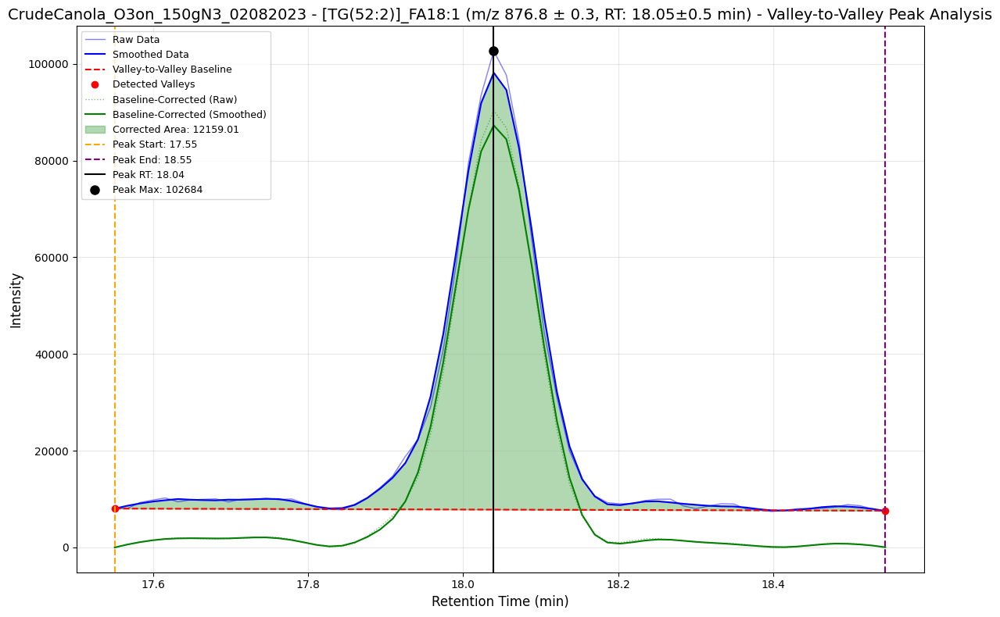

  Processing n-7 ion (m/z 794.8)
  Searching RT window: 17.55 - 18.55 min for CrudeCanola_O3on_150gN3_02082023


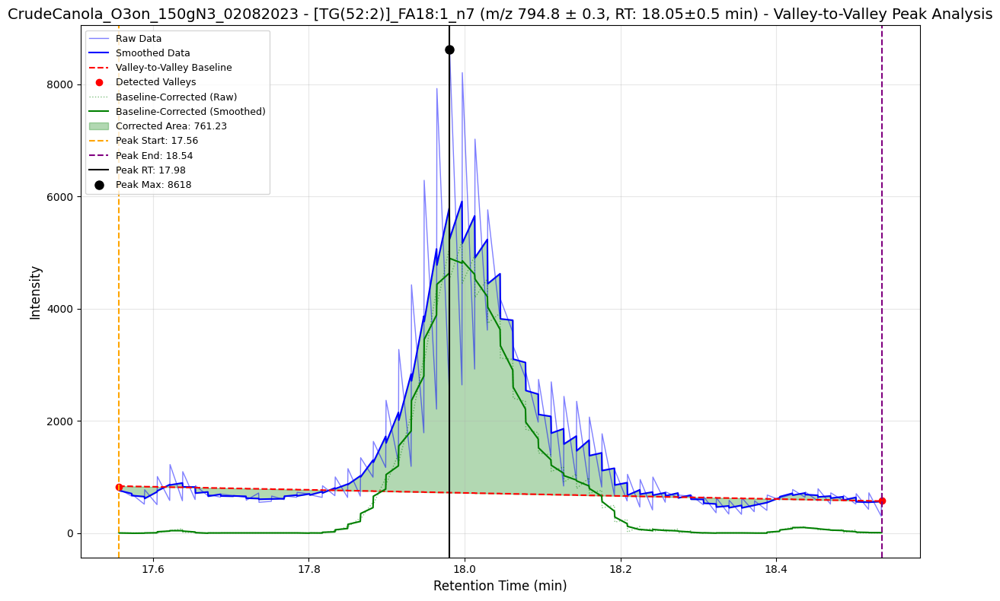

  Processing n-9 ion (m/z 766.8)
  Searching RT window: 17.55 - 18.55 min for CrudeCanola_O3on_150gN3_02082023


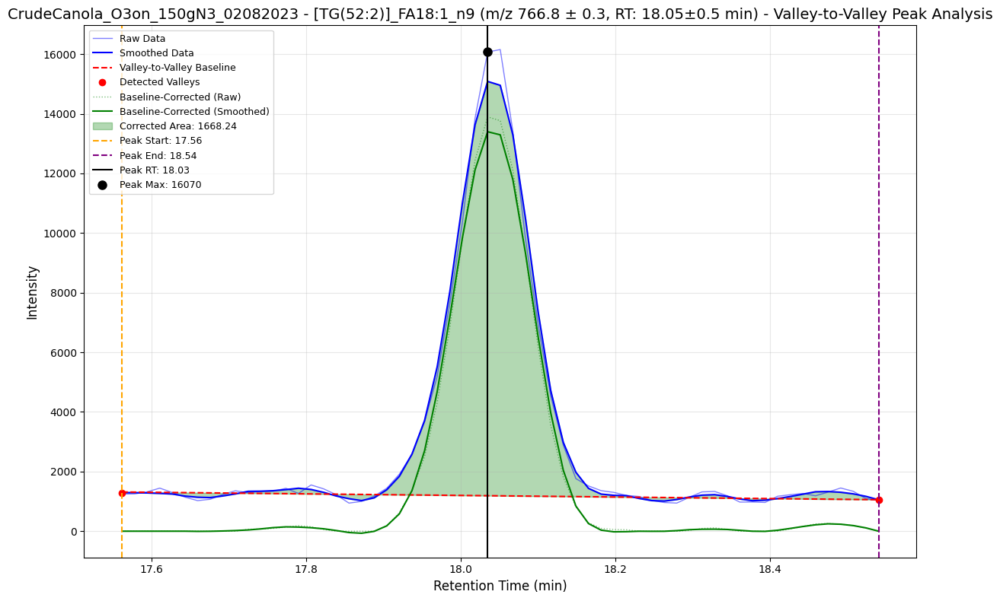

Processing lipid: [TG(52:3)]_FA18:1 (m/z 874.8, RT 16.09 min ± 0.5 min)
  Searching RT window: 15.59 - 16.59 min for CrudeCanola_O3on_150gN3_02082023


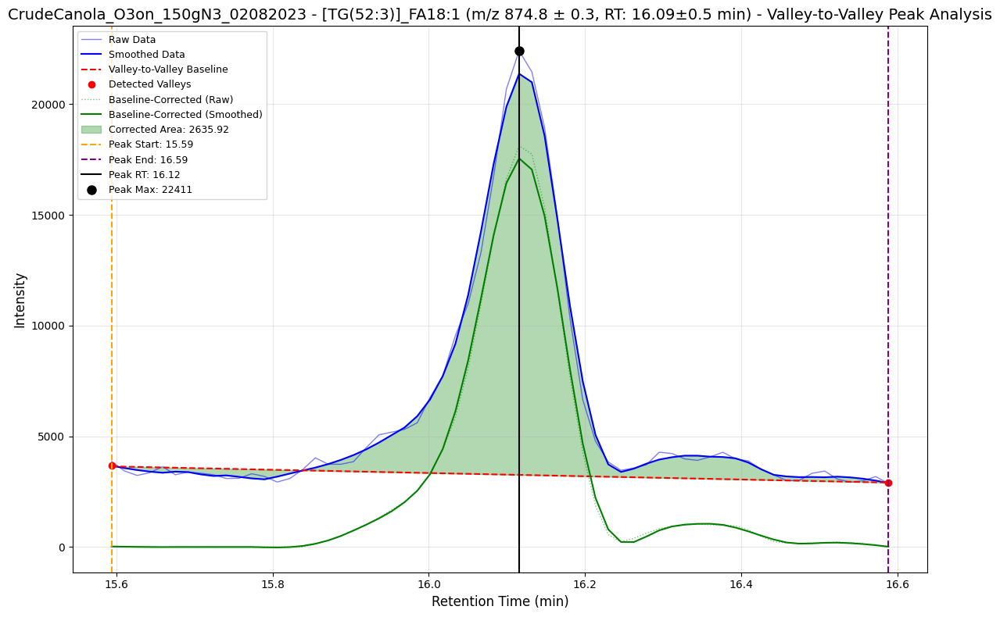

  Processing n-7 ion (m/z 792.8)
  Searching RT window: 15.59 - 16.59 min for CrudeCanola_O3on_150gN3_02082023


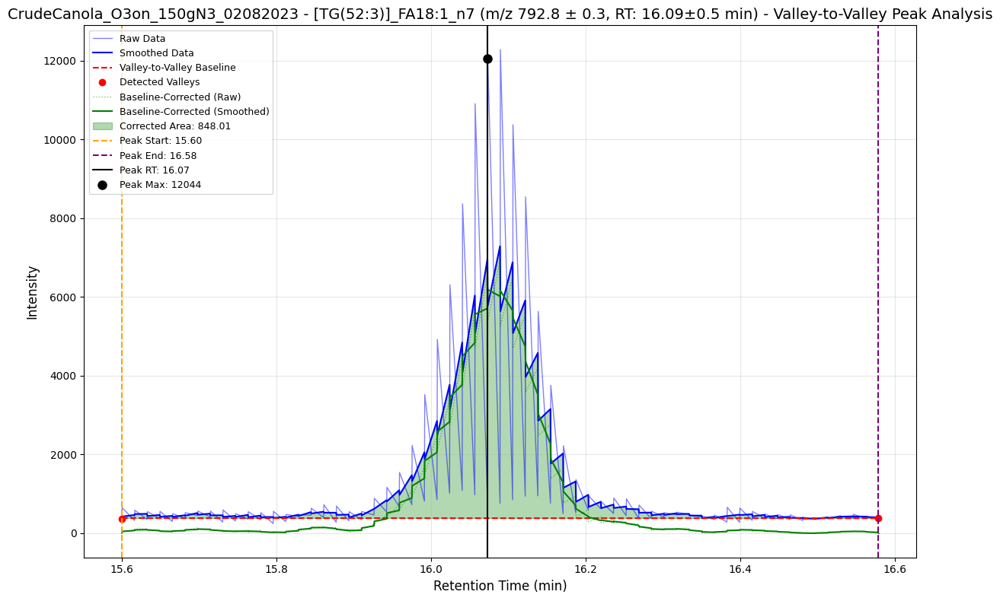

  Processing n-9 ion (m/z 764.8)
  Searching RT window: 15.59 - 16.59 min for CrudeCanola_O3on_150gN3_02082023


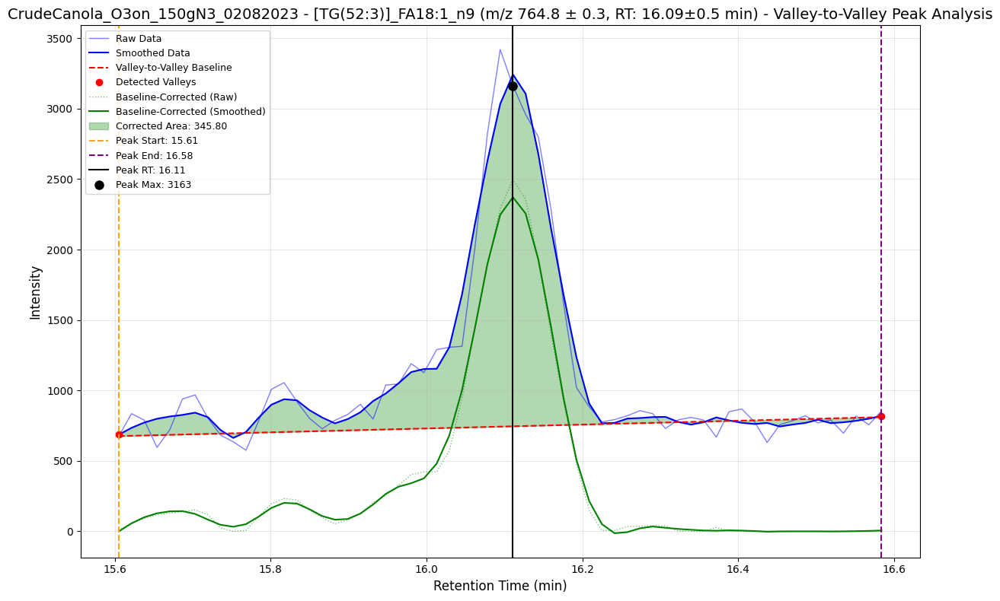

Processing lipid: [TG(52:4)]_FA18:1 (m/z 872.8, RT 14.3 min ± 0.5 min)
  Searching RT window: 13.80 - 14.80 min for CrudeCanola_O3on_150gN3_02082023


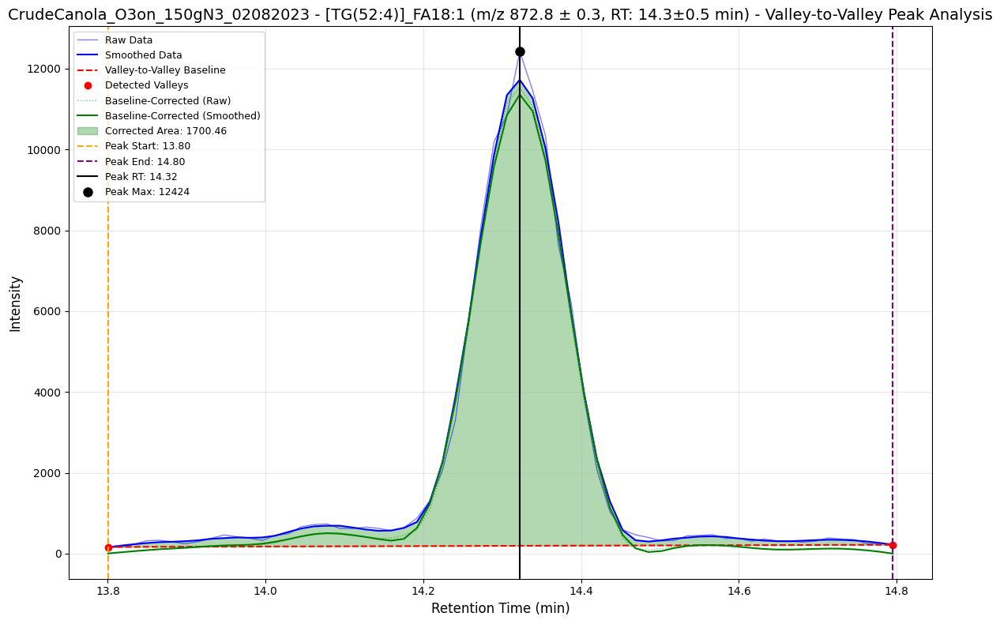

  Processing n-7 ion (m/z 790.8)
  Searching RT window: 13.80 - 14.80 min for CrudeCanola_O3on_150gN3_02082023


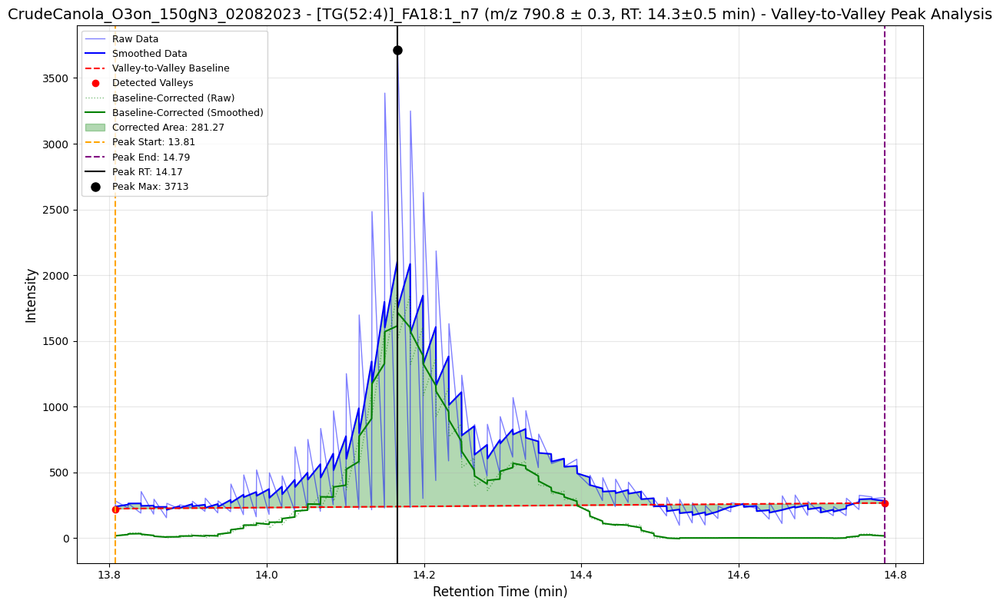

  Processing n-9 ion (m/z 762.8)
  Searching RT window: 13.80 - 14.80 min for CrudeCanola_O3on_150gN3_02082023


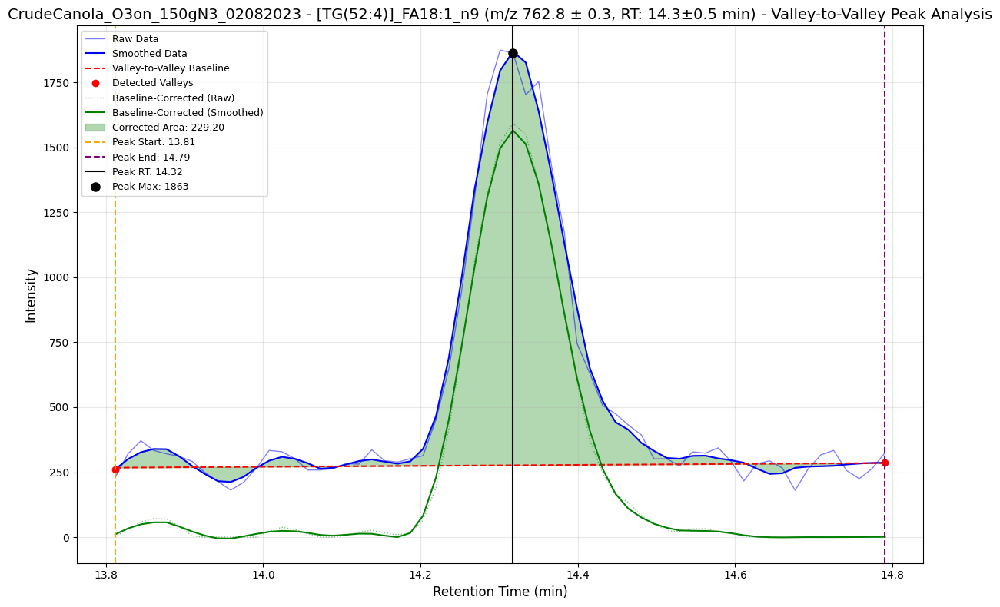

Processing lipid: [TG(54:2)]_FA18:1 (m/z 904.8, RT 20.0 min ± 0.5 min)
  Searching RT window: 19.50 - 20.50 min for CrudeCanola_O3on_150gN3_02082023


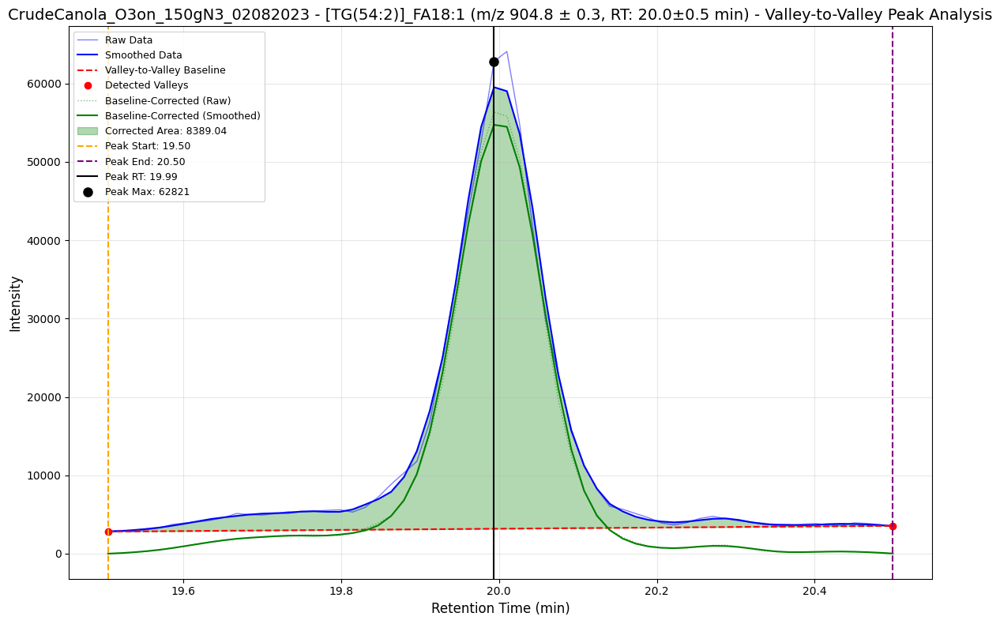

  Processing n-7 ion (m/z 822.8)
  Searching RT window: 19.50 - 20.50 min for CrudeCanola_O3on_150gN3_02082023


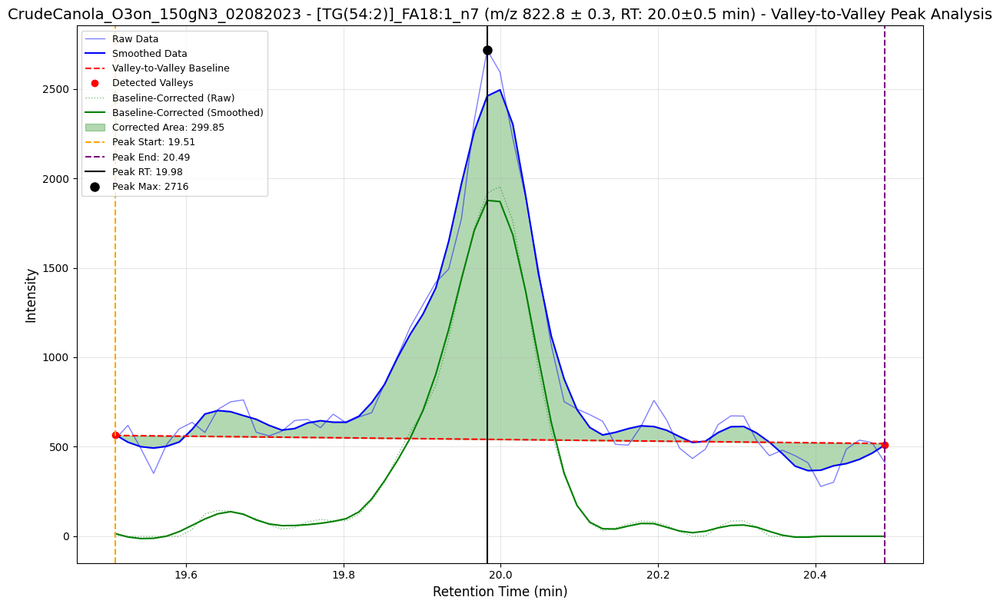

  Processing n-9 ion (m/z 794.8)
  Searching RT window: 19.50 - 20.50 min for CrudeCanola_O3on_150gN3_02082023


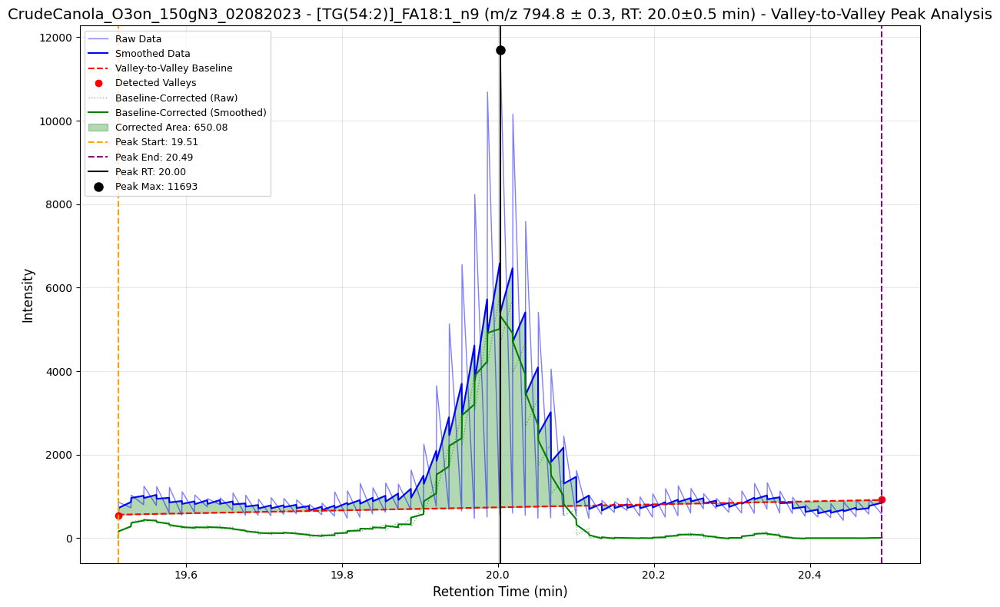

Processing lipid: [TG(54:3)]_FA18:1 (m/z 902.8, RT 17.98 min ± 0.5 min)
  Searching RT window: 17.48 - 18.48 min for CrudeCanola_O3on_150gN3_02082023


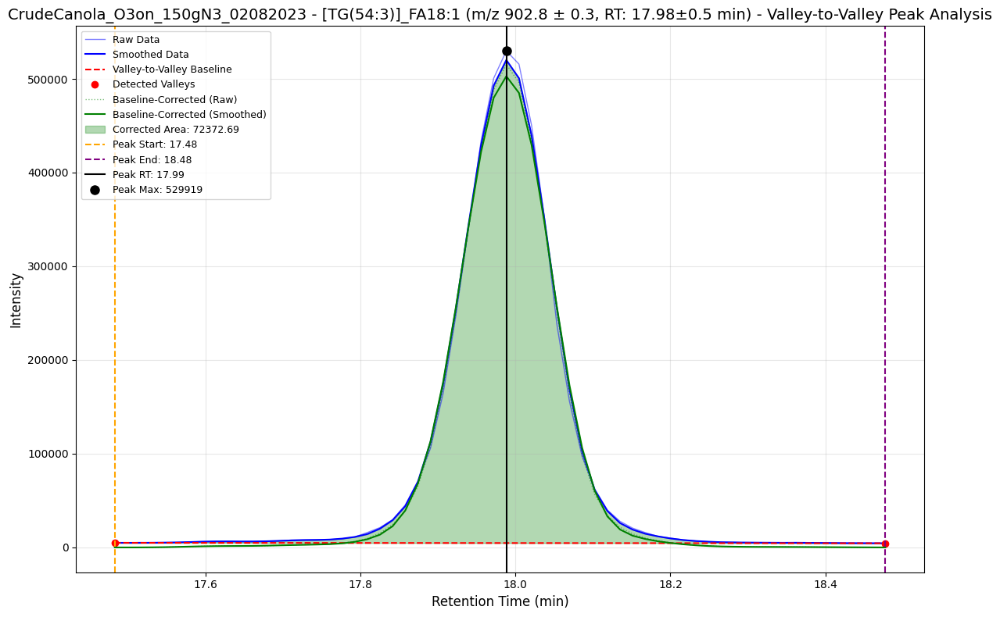

  Processing n-7 ion (m/z 820.8)
  Searching RT window: 17.48 - 18.48 min for CrudeCanola_O3on_150gN3_02082023


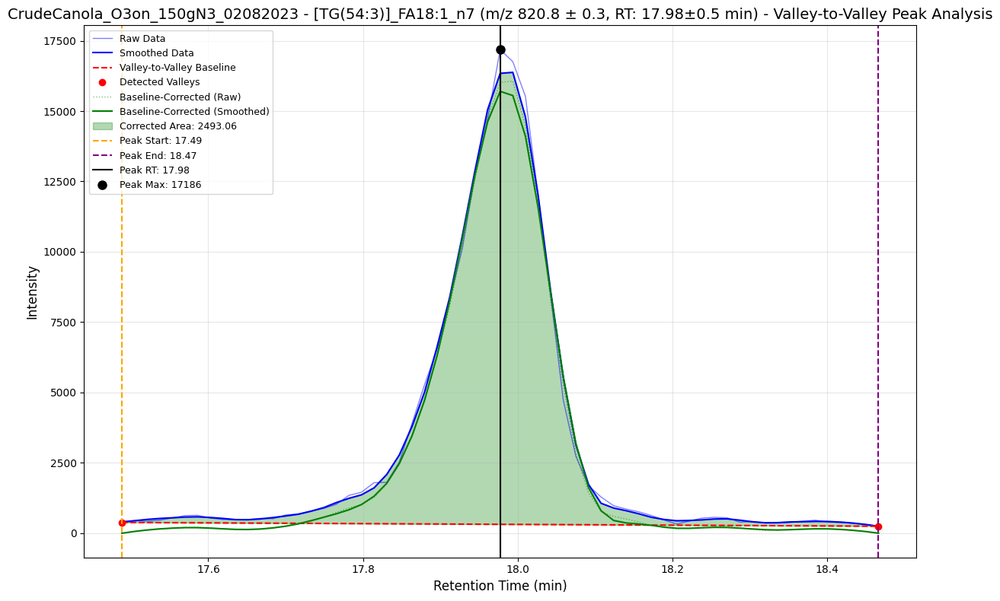

  Processing n-9 ion (m/z 792.8)
  Searching RT window: 17.48 - 18.48 min for CrudeCanola_O3on_150gN3_02082023


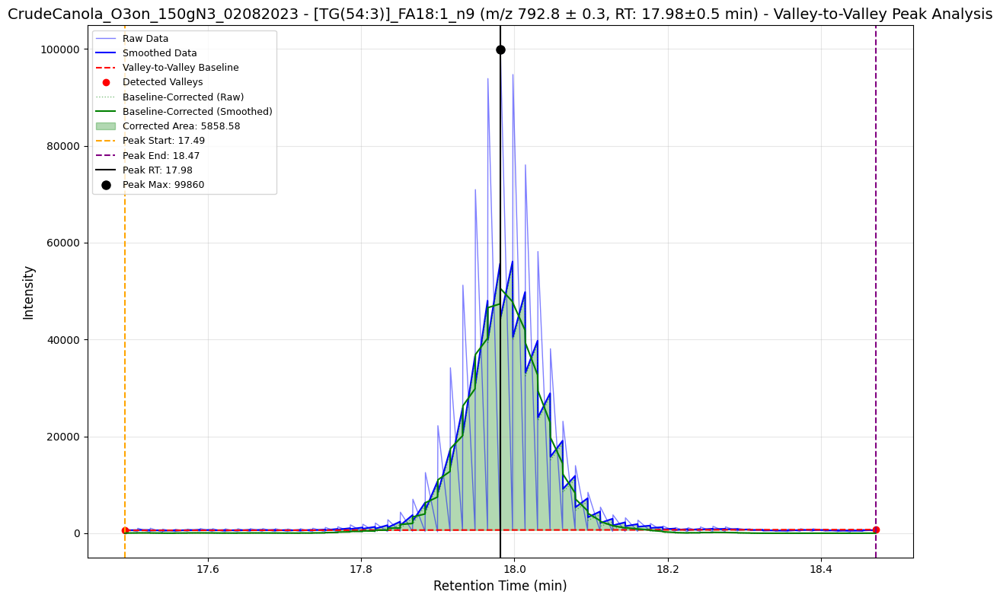

Processing lipid: [TG(54:4)]_FA18:1 (m/z 900.8, RT 16.07 min ± 0.5 min)
  Searching RT window: 15.57 - 16.57 min for CrudeCanola_O3on_150gN3_02082023


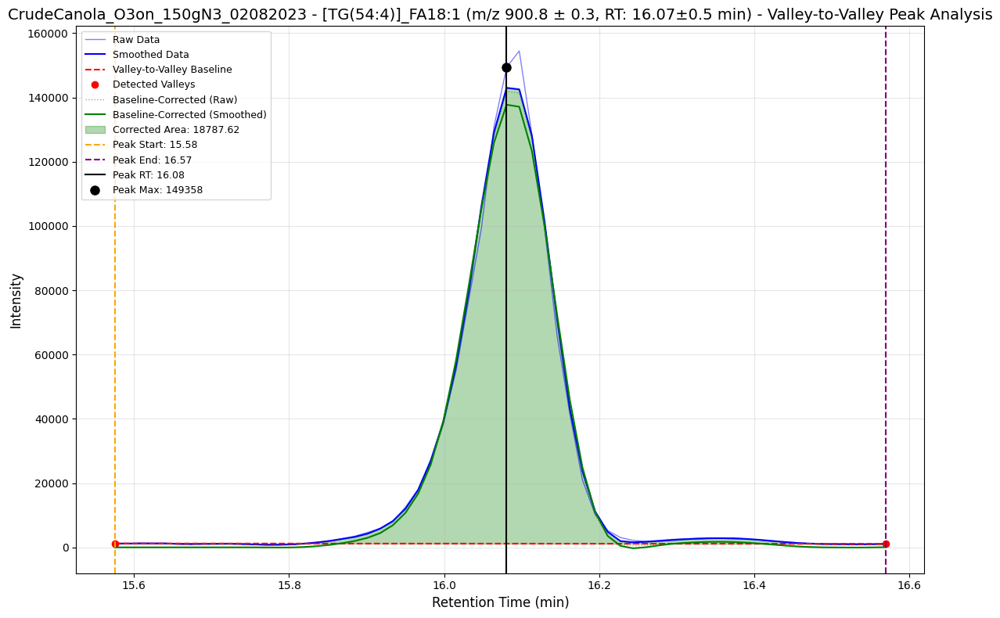

  Processing n-7 ion (m/z 818.8)
  Searching RT window: 15.57 - 16.57 min for CrudeCanola_O3on_150gN3_02082023


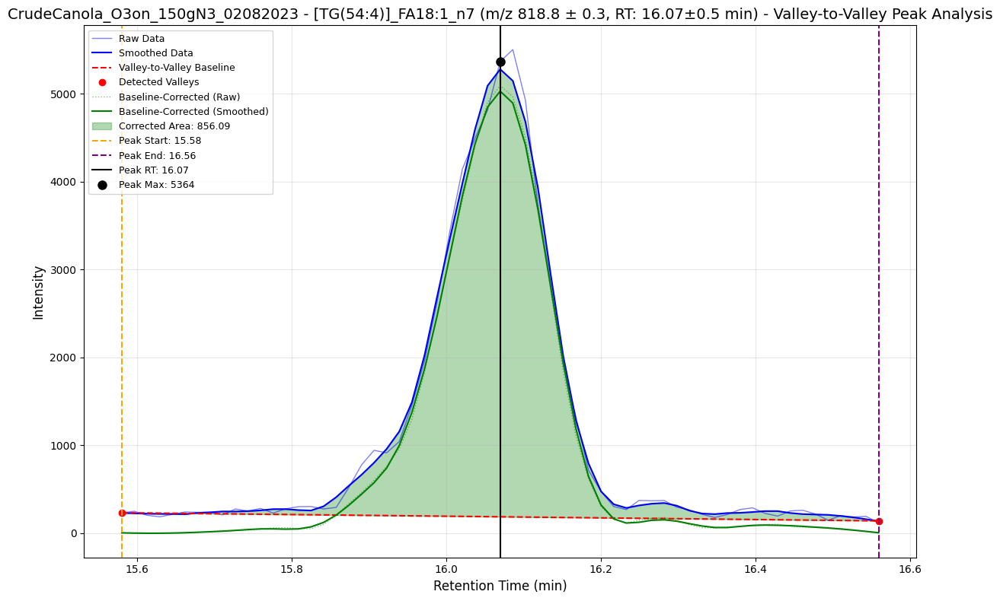

  Processing n-9 ion (m/z 790.8)
  Searching RT window: 15.57 - 16.57 min for CrudeCanola_O3on_150gN3_02082023


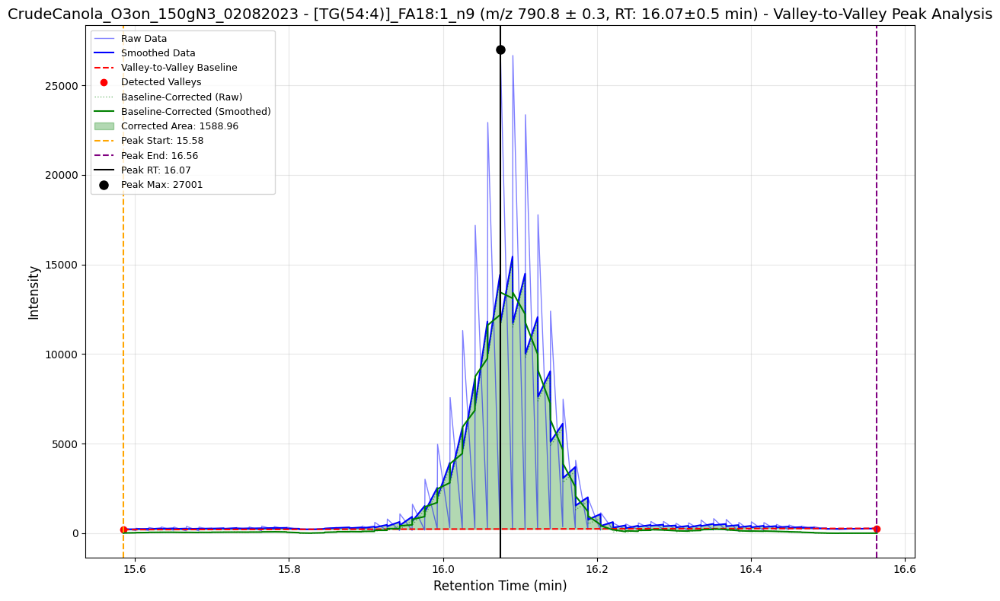

Processing lipid: [TG(54:5)]_FA18:1 (m/z 898.8, RT 14.31 min ± 0.5 min)
  Searching RT window: 13.81 - 14.81 min for CrudeCanola_O3on_150gN3_02082023


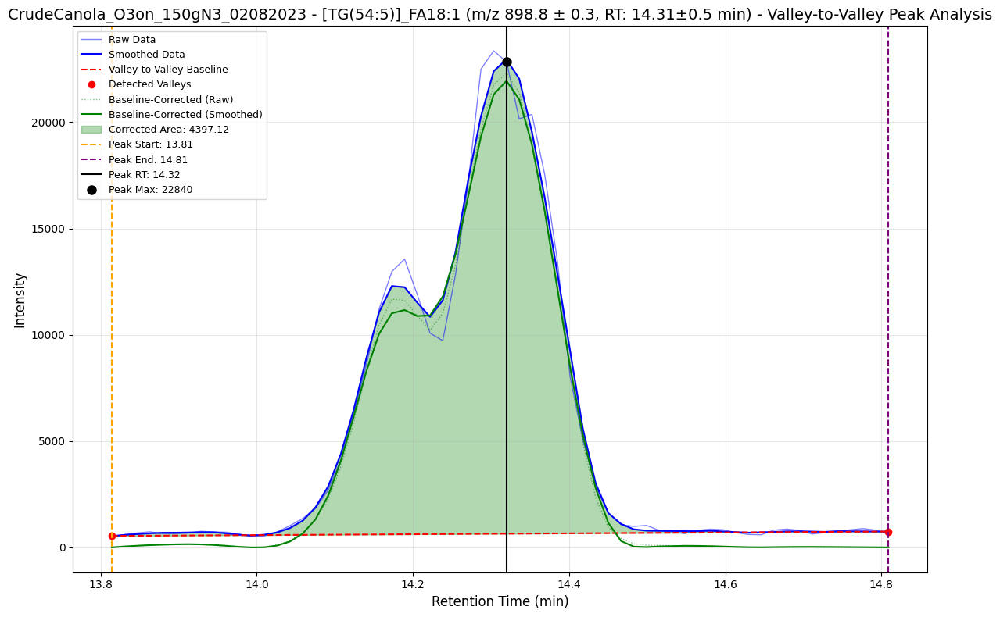

  Processing n-7 ion (m/z 816.8)
  Searching RT window: 13.81 - 14.81 min for CrudeCanola_O3on_150gN3_02082023


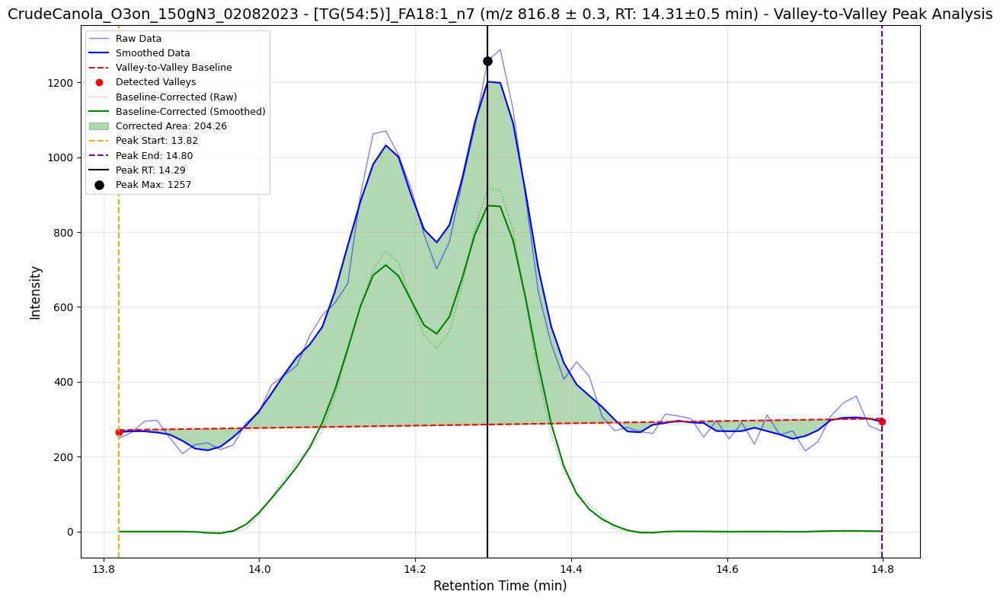

  Processing n-9 ion (m/z 788.8)
  Searching RT window: 13.81 - 14.81 min for CrudeCanola_O3on_150gN3_02082023


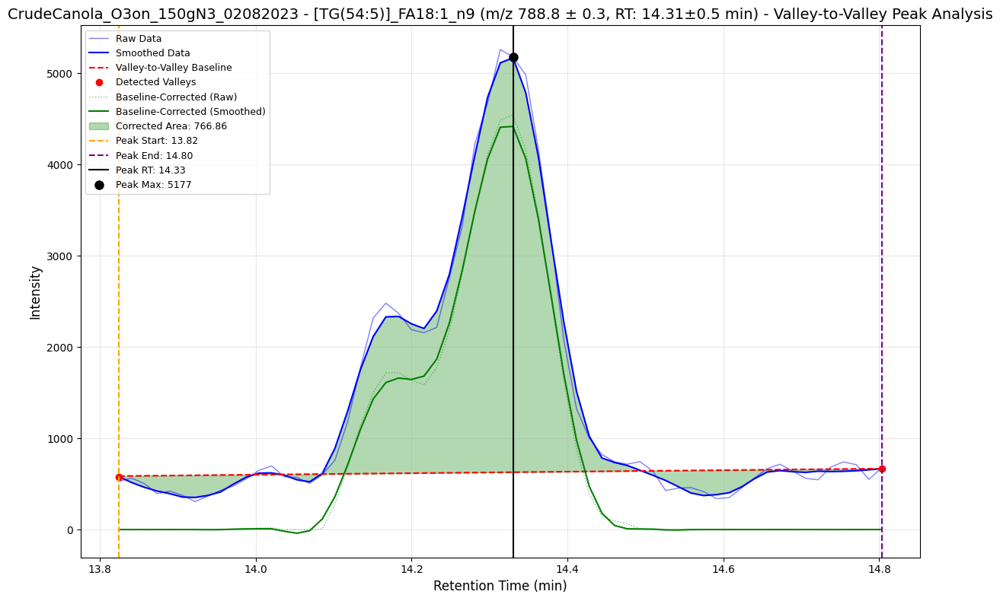

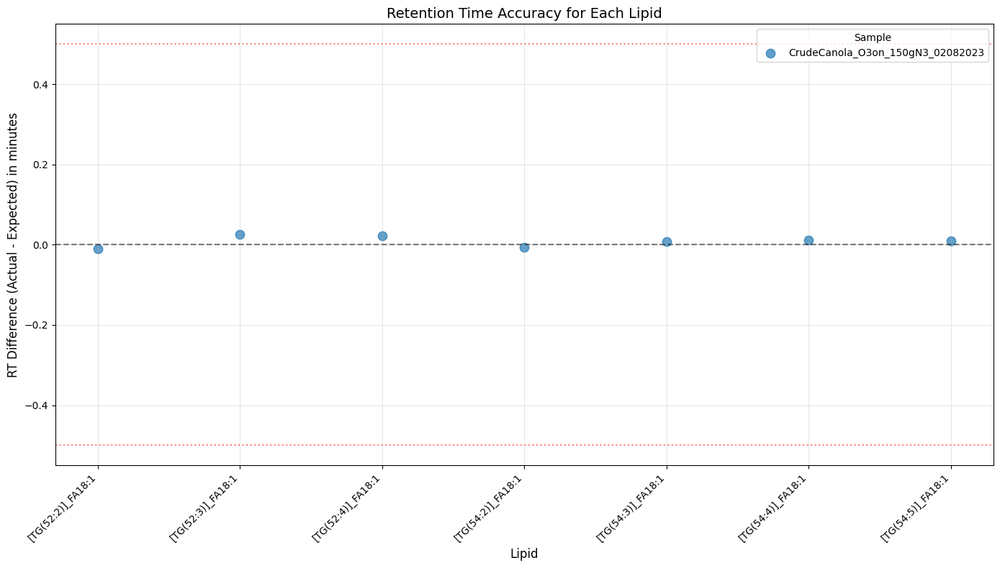

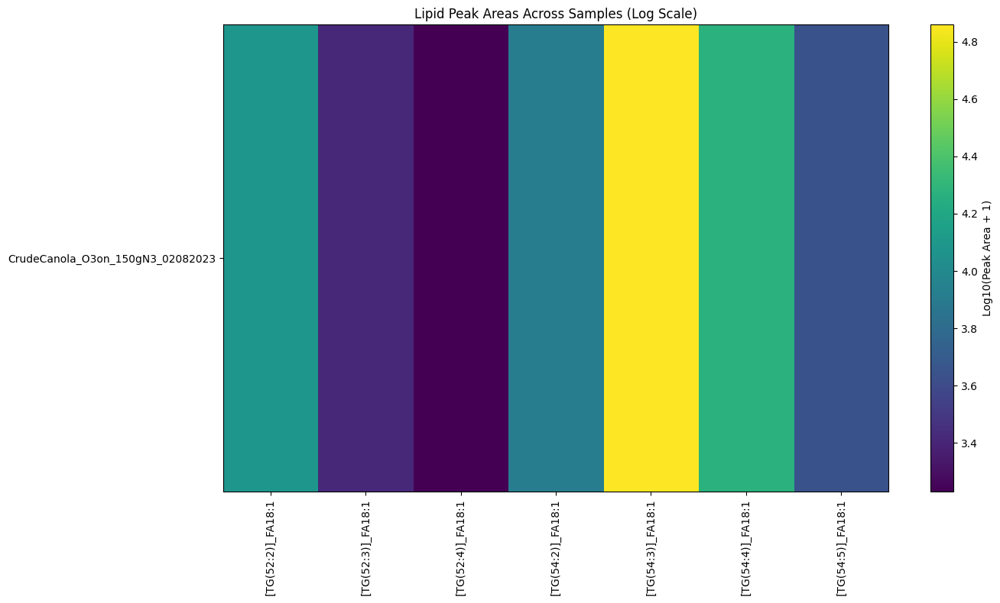

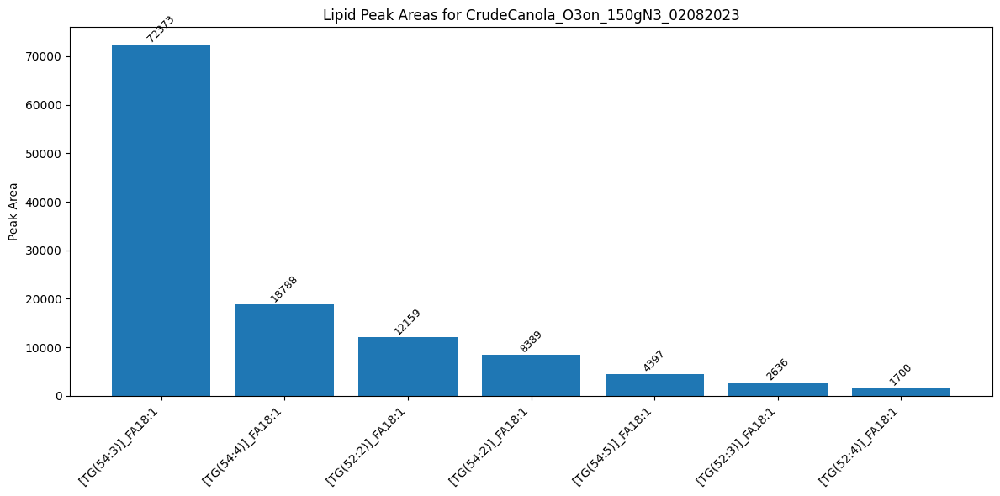

<Figure size 1400x800 with 0 Axes>

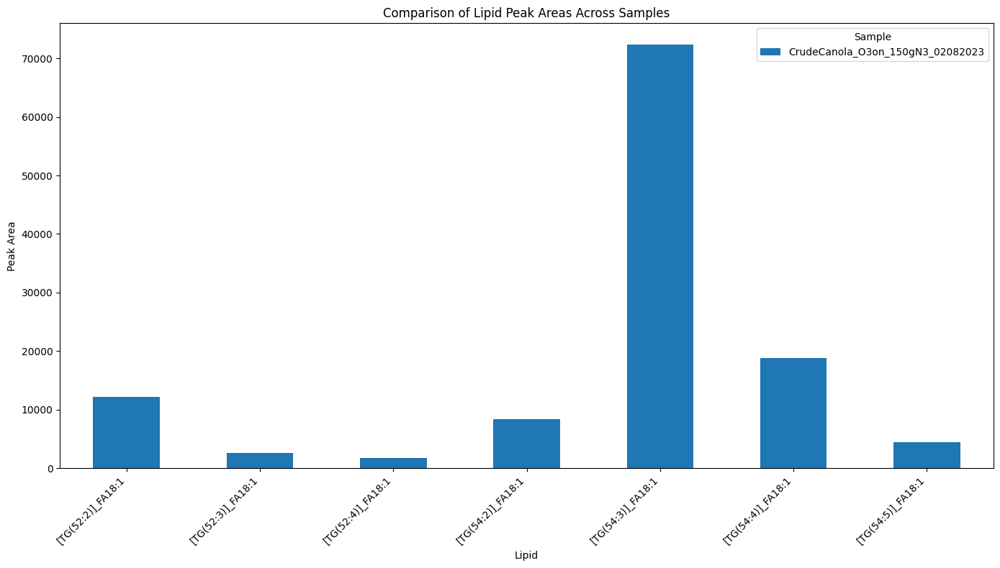


Retention Time Analysis Summary:
                   Expected_RT_first  Peak_RT_mean  Peak_RT_std  Peak_RT_min  \
Lipid                                                                          
[TG(52:2)]_FA18:1              18.05        18.039          NaN       18.039   
[TG(52:3)]_FA18:1              16.09        16.116          NaN       16.116   
[TG(52:4)]_FA18:1              14.30        14.322          NaN       14.322   
[TG(54:2)]_FA18:1              20.00        19.994          NaN       19.994   
[TG(54:3)]_FA18:1              17.98        17.988          NaN       17.988   
[TG(54:4)]_FA18:1              16.07        16.081          NaN       16.081   
[TG(54:5)]_FA18:1              14.31        14.320          NaN       14.320   

                   Peak_RT_max  RT_Difference_mean  RT_Difference_std  \
Lipid                                                                   
[TG(52:2)]_FA18:1       18.039              -0.011                NaN   
[TG(52:3)]_FA18:1       16

<Figure size 1400x800 with 0 Axes>

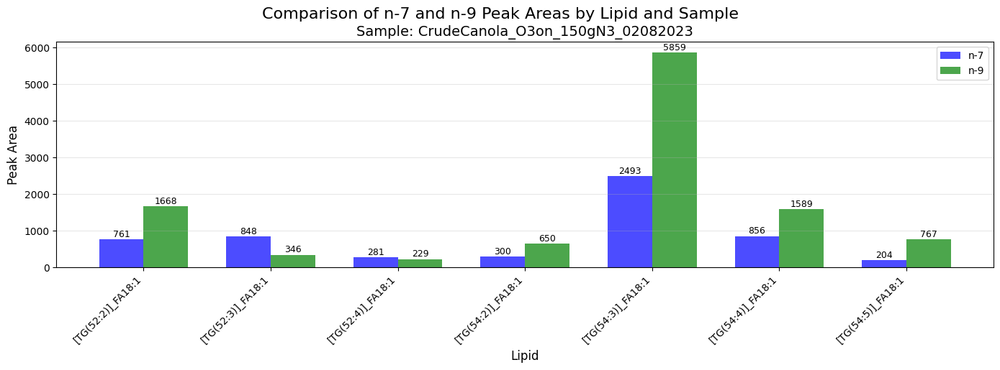

NameError: name 'bar_positions' is not defined

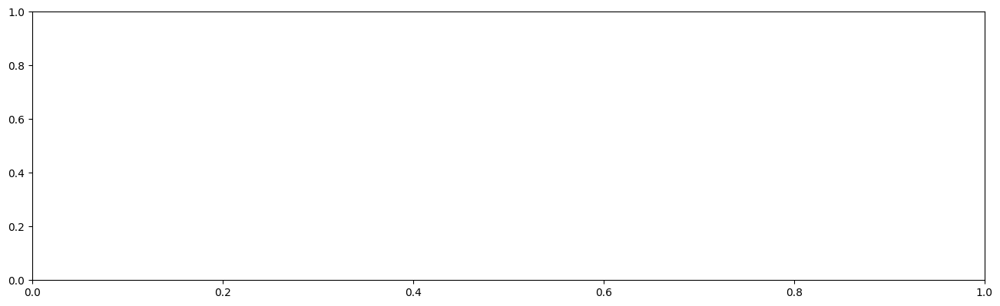

In [82]:
def lower_baseline(rt, intensity, baseline, valleys, lipid_name, double_bond_position, offset_amount, 
                 plot_details=True, title_prefix=""):
    """
    Lower the valley-to-valley baseline by a specified amount for a specific lipid and double bond position.
    
    Parameters:
    -----------
    rt : array-like
        Retention time array
    intensity : array-like
        Intensity values
    baseline : array-like
        Original baseline values from valley-to-valley detection
    valleys : list
        Indices of detected valleys
    lipid_name : str
        Name of the lipid (e.g., 'TG(52:3)')
    double_bond_position : str
        Double bond position ('n-7' or 'n-9')
    offset_amount : float
        Amount to lower the baseline by (positive value)
    plot_details : bool
        Whether to show detailed plot of the adjusted baseline
    title_prefix : str
        Prefix for plot title
        
    Returns:
    --------
    adjusted_baseline : array-like
        The adjusted baseline with the specified offset
    """
    import numpy as np
    import matplotlib.pyplot as plt
    from scipy.integrate import trapezoid
    
    # Create a copy of the original baseline
    adjusted_baseline = baseline.copy()
    
    # Lower the baseline by the specified amount, but don't go below zero
    adjusted_baseline = np.maximum(adjusted_baseline - offset_amount, 0)
    
    # Calculate the baseline-corrected intensity with the adjusted baseline
    corrected_intensity = np.maximum(intensity - adjusted_baseline, 0)
    
    # Plot the results if requested
    if plot_details:
        plt.figure(figsize=(12, 8))
        
        # Plot the original data
        plt.plot(rt, intensity, 'b-', linewidth=1.5, label="Original Data")
        
        # Plot the original baseline
        plt.plot(rt, baseline, 'r--', linewidth=1.5, label="Original Baseline")
        
        # Plot the adjusted baseline
        plt.plot(rt, adjusted_baseline, 'g-', linewidth=1.5, 
                 label=f"Adjusted Baseline (Offset: -{offset_amount})")
        
        # Mark valleys
        valley_rts = rt[valleys]
        valley_intensities = intensity[valleys]
        plt.plot(valley_rts, valley_intensities, 'ro', markersize=6, label="Detected Valleys")
        
        # Plot the original corrected intensity
        original_corrected = np.maximum(intensity - baseline, 0)
        plt.plot(rt, original_corrected, 'r:', linewidth=1, alpha=0.5, 
                 label="Original Baseline-Corrected")
        
        # Plot the new corrected intensity
        plt.plot(rt, corrected_intensity, 'g:', linewidth=1, alpha=0.5, 
                 label="Adjusted Baseline-Corrected")
        
        # Shade the area between the adjusted baseline and the curve
        plt.fill_between(rt, adjusted_baseline, intensity, 
                         where=(intensity > adjusted_baseline),
                         alpha=0.3, color='green', 
                         label=f"New Integration Area")
        
        # Add labels and legend
        plt.xlabel("Retention Time (min)", fontsize=12)
        plt.ylabel("Intensity", fontsize=12)
        plt.title(f"{title_prefix} - {lipid_name} {double_bond_position} - Adjusted Baseline", fontsize=14)
        plt.legend(loc='upper left', fontsize=9)
        plt.grid(True, alpha=0.3)
        plt.tight_layout()
        plt.show()
    
    return adjusted_baseline


def find_and_integrate_peak_with_manual_baseline(rt, intensity, expected_rt=None, rt_window=0.5,
                                          smoothing_window=7, smoothing_polyorder=2,
                                          valley_ratio=0.2, min_valley_distance=3,
                                          lipid_name=None, double_bond_position=None, 
                                          baseline_offset=0, plot_details=False, 
                                          title_prefix=""):
    """
    Find and integrate peaks with manual baseline adjustment option.
    
    This function extends find_and_integrate_peak_valley_to_valley with an option
    to manually lower the baseline for specific lipid and double bond combinations.
    
    Parameters:
    -----------
    rt : array-like
        Retention time array
    intensity : array-like
        Intensity values
    expected_rt : float, optional
        Expected retention time to focus peak finding
    rt_window : float
        Retention time window to search around expected_rt
    smoothing_window : int
        Window size for Savitzky-Golay smoothing
    smoothing_polyorder : int
        Polynomial order for Savitzky-Golay smoothing
    valley_ratio : float
        Threshold for valley detection as ratio of peak height
    min_valley_distance : int
        Minimum number of points between valleys
    lipid_name : str, optional
        Name of the lipid for baseline adjustment decision
    double_bond_position : str, optional
        Double bond position ('n-7' or 'n-9') for baseline adjustment decision
    baseline_offset : float
        Amount to lower the baseline by (positive value)
    plot_details : bool
        Whether to show detailed plot of peak detection steps
    title_prefix : str
        Prefix for plot title
        
    Returns:
    --------
    result : dict
        Dictionary containing peak information
    """
    import numpy as np
    import matplotlib.pyplot as plt
    from scipy.signal import savgol_filter, find_peaks
    from scipy.integrate import trapezoid
    
    # Handle empty or invalid data
    if len(rt) < 3 or np.max(intensity) == 0:
        return {
            'Peak_Area': 0,
            'Peak_Area_No_Baseline': 0,
            'Max_Original_Intensity': 0,
            'Max_Corrected_Intensity': 0,
            'Peak_Start': 0,
            'Peak_Stop': 0,
            'Peak_RT': 0,
            'Baseline': np.zeros_like(intensity) if len(intensity) > 0 else np.array([])
        }
    
    # Ensure smoothing window is odd
    if smoothing_window % 2 == 0:
        smoothing_window += 1
    
    # Make sure smoothing window isn't too large for the data
    if len(intensity) < smoothing_window:
        smoothing_window = min(5, len(intensity))
        if smoothing_window % 2 == 0 and smoothing_window > 1:
            smoothing_window -= 1
    
    # Step 1: Apply Savitzky-Golay smoothing to reduce noise
    try:
        smoothed_intensity = savgol_filter(intensity, smoothing_window, smoothing_polyorder)
    except Exception as e:
        print(f"Warning: Smoothing error - {e}. Using original data.")
        smoothed_intensity = intensity.copy()
    
    # Step 2: Detect baseline using valley-to-valley method
    baseline, valleys = detect_valley_to_valley_baseline(
        rt, smoothed_intensity, 
        smoothing_window=smoothing_window,
        valley_ratio=valley_ratio,
        min_valley_distance=min_valley_distance
    )
    
    # Step 2b: Apply manual baseline adjustment if needed
    if baseline_offset > 0:
        adjusted_title = f"{title_prefix} - Manual Baseline Adjustment"
        baseline = lower_baseline(
            rt, smoothed_intensity, baseline, valleys,
            lipid_name, double_bond_position, baseline_offset,
            plot_details=plot_details, title_prefix=adjusted_title
        )
    
    # Step 3: Subtract baseline to get corrected intensity
    corrected_intensity = np.maximum(smoothed_intensity - baseline, 0)
    
    # Apply additional smoothing to the corrected intensity for peak finding
    if len(corrected_intensity) > smoothing_window and smoothing_window >= 3:
        try:
            smoothed_corrected = savgol_filter(corrected_intensity, smoothing_window, smoothing_polyorder)
        except Exception as e:
            print(f"Warning: Smoothing error on corrected data - {e}. Using unsmoothed corrected data.")
            smoothed_corrected = corrected_intensity.copy()
    else:
        smoothed_corrected = corrected_intensity.copy()
    
    # Step 4: Find peaks on baseline-corrected data
    # Convert relative parameters to absolute values
    abs_prominence = 0.1 * np.max(smoothed_corrected) if np.max(smoothed_corrected) > 0 else 0
    
    peaks, peak_properties = find_peaks(
        smoothed_corrected,
        prominence=abs_prominence,
        width=3  # Require some minimum width
    )
    
    # Handle case where no peaks are found
    if len(peaks) == 0:
        return {
            'Peak_Area': 0,
            'Peak_Area_No_Baseline': 0,
            'Max_Original_Intensity': 0,
            'Max_Corrected_Intensity': 0,
            'Peak_Start': 0,
            'Peak_Stop': 0,
            'Peak_RT': 0,
            'Baseline': baseline
        }
    
    # Step 5: If expected_rt is provided, select the peak closest to it
    if expected_rt is not None:
        peak_rts = rt[peaks]
        rt_differences = np.abs(peak_rts - expected_rt)
        closest_peak_idx = np.argmin(rt_differences)
        
        # Only use this peak if it's within the RT window
        if rt_differences[closest_peak_idx] <= rt_window:
            peak_idx = peaks[closest_peak_idx]
        else:
            # If no peak is close enough to expected_rt, select the most prominent peak
            peak_idx = peaks[np.argmax(peak_properties["prominences"])]
    else:
        # Without expected_rt, select the most prominent peak
        peak_idx = peaks[np.argmax(peak_properties["prominences"])]
    
    peak_rt = rt[peak_idx]
    
    # Step 6: Find the valleys on either side of the peak
    left_valley_candidates = [v for v in valleys if v < peak_idx]
    right_valley_candidates = [v for v in valleys if v > peak_idx]
    
    if left_valley_candidates:
        left_valley = max(left_valley_candidates)  # Closest valley to the left
    else:
        left_valley = 0  # Start of chromatogram
        
    if right_valley_candidates:
        right_valley = min(right_valley_candidates)  # Closest valley to the right
    else:
        right_valley = len(rt) - 1  # End of chromatogram
    
    # Convert to retention times
    peak_start_time = rt[left_valley]
    peak_stop_time = rt[right_valley]
    
    # Step 7: Calculate peak area using the trapezoidal rule between valleys
    # Get the subset of data within the valley-to-valley boundaries
    mask = (rt >= peak_start_time) & (rt <= peak_stop_time)
    x_integration = rt[mask]
    y_baseline_corrected = corrected_intensity[mask]
    y_original = smoothed_intensity[mask]
    
    # Calculate area using trapezoidal rule (baseline corrected)
    peak_area = trapezoid(y_baseline_corrected, x_integration)
    
    # Calculate area without baseline correction (using original intensities)
    peak_area_no_baseline = trapezoid(y_original, x_integration)
    
    # Step 8: Create result dictionary
    result = {
        'Peak_Area': peak_area,
        'Peak_Area_No_Baseline': peak_area_no_baseline,
        'Max_Original_Intensity': intensity[peak_idx],
        'Max_Corrected_Intensity': corrected_intensity[peak_idx],
        'Peak_Start': peak_start_time,
        'Peak_Stop': peak_stop_time,
        'Peak_RT': peak_rt,
        'Baseline': baseline,
        'Valley_Indices': valleys.tolist(),
        'Baseline_Adjustment': baseline_offset
    }
    
    # Step 9: Plot the results if requested
    if plot_details and baseline_offset == 0:  # Only plot if we haven't already shown the adjusted baseline
        plt.figure(figsize=(12, 8))
        
        # Plot the original data
        plt.plot(rt, intensity, 'b-', linewidth=1, alpha=0.5, label="Raw Data")
        
        # Plot the smoothed data
        plt.plot(rt, smoothed_intensity, 'b-', linewidth=1.5, label="Smoothed Data")
        
        # Plot the valley-to-valley baseline
        plt.plot(rt, baseline, 'r--', linewidth=1.5, label="Valley-to-Valley Baseline")
        
        # Mark valleys
        valley_rts = rt[valleys]
        valley_intensities = smoothed_intensity[valleys]
        plt.plot(valley_rts, valley_intensities, 'ro', markersize=6, label="Detected Valleys")
        
        # Plot the corrected intensity
        plt.plot(rt, corrected_intensity, 'g:', linewidth=1, alpha=0.5, label="Baseline-Corrected (Raw)")
        
        # Plot the smoothed corrected intensity
        plt.plot(rt, smoothed_corrected, 'g-', linewidth=1.5, label="Baseline-Corrected (Smoothed)")
        
        # Shade only the area between the baseline and the curve (baseline-corrected area)
        plt.fill_between(x_integration, baseline[mask], smoothed_intensity[mask], 
                         alpha=0.3, color='green', 
                         label=f"Corrected Area: {peak_area:.2f}")
        
        # Add vertical lines for peak start, peak, and stop
        plt.axvline(x=peak_start_time, linestyle="--", color="orange", 
                    label=f"Peak Start: {peak_start_time:.2f}")
        plt.axvline(x=peak_stop_time, linestyle="--", color="purple", 
                    label=f"Peak End: {peak_stop_time:.2f}")
        plt.axvline(x=peak_rt, linestyle="-", color="black", 
                    label=f"Peak RT: {peak_rt:.2f}")
        
        # Mark the detected peak
        plt.plot(peak_rt, intensity[peak_idx], 'ko', markersize=8, 
                 label=f"Peak Max: {intensity[peak_idx]:.0f}")
        
        # Add labels and legend
        plt.xlabel("Retention Time (min)", fontsize=12)
        plt.ylabel("Intensity", fontsize=12)
        plt.title(f"{title_prefix} - Valley-to-Valley Peak Analysis", fontsize=14)
        plt.legend(loc='upper left', fontsize=9)
        plt.grid(True, alpha=0.3)
        plt.tight_layout()
        plt.show()
    
    return result


def process_lipid_sample_with_manual_baseline(lipid_name, precursor_ion, expected_rt, sample_id, 
                                       baseline_adjustments=None, plot_details=True, 
                                       smoothing_window=7, smoothing_polyorder=2, rt_window=0.5,
                                       valley_ratio=0.2, min_valley_distance=3):
    """
    Process a single lipid in a specific sample with option for manual baseline adjustment
    
    Parameters:
    -----------
    lipid_name : str
        Name of the lipid (e.g., 'TG(52:3)')
    precursor_ion : float
        m/z value of the precursor ion
    expected_rt : float
        Expected retention time in minutes
    sample_id : str
        Sample identifier
    baseline_adjustments : dict, optional
        Dictionary specifying baseline offsets, e.g., {'TG(52:3)': {'n-9': 500}}
    plot_details : bool
        Whether to display plots
    smoothing_window : int
        Window size for Savitzky-Golay smoothing
    smoothing_polyorder : int
        Polynomial order for smoothing
    rt_window : float
        Retention time window around expected_rt to search
    valley_ratio : float
        Threshold for valley detection
    min_valley_distance : int
        Minimum number of points between valleys
        
    Returns:
    --------
    dict
        Dictionary with peak analysis results
    """
    # Determine double bond position from lipid name
    double_bond_position = None
    if '_n7' in lipid_name:
        double_bond_position = 'n-7'
        parent_lipid = lipid_name.replace('_n7', '')
    elif '_n9' in lipid_name:
        double_bond_position = 'n-9'
        parent_lipid = lipid_name.replace('_n9', '')
    else:
        parent_lipid = lipid_name
    
    # Check if baseline adjustment is needed
    baseline_offset = 0
    if baseline_adjustments and parent_lipid in baseline_adjustments:
        if double_bond_position and double_bond_position in baseline_adjustments[parent_lipid]:
            baseline_offset = baseline_adjustments[parent_lipid][double_bond_position]
        elif None in baseline_adjustments[parent_lipid]:  # For precursor ion
            baseline_offset = baseline_adjustments[parent_lipid][None]
    
    # Calculate retention time window based on expected RT
    rt_start = max(0, expected_rt - rt_window)
    rt_end = expected_rt + rt_window
    
    print(f"  Searching RT window: {rt_start:.2f} - {rt_end:.2f} min for {sample_id}")
    if baseline_offset > 0:
        position_str = double_bond_position if double_bond_position else "precursor"
        print(f"  Applying baseline adjustment: -{baseline_offset} for {parent_lipid} {position_str}")
    
    # Filter the DataFrame for the given sample, parent ion (with tolerance), and retention time window
    subset = processed_df[
        (processed_df['Parent_Ion'] >= precursor_ion - parent_ion_tolerance) &
        (processed_df['Parent_Ion'] <= precursor_ion + parent_ion_tolerance) &
        (processed_df['Sample_ID'] == sample_id) &
        (processed_df['Retention_Time'] >= rt_start) &
        (processed_df['Retention_Time'] <= rt_end)
    ].copy()
    
    # Group by Retention_Time and take the maximum OzESI_Intensity
    aggregated = subset.groupby('Retention_Time', as_index=False)['OzESI_Intensity'].max()
    aggregated.sort_values('Retention_Time', inplace=True)
    aggregated = aggregated.reset_index(drop=True)
    
    # Skip if no data is available
    if aggregated.empty:
        print(f"No data for sample {sample_id}, lipid {lipid_name} (m/z {precursor_ion}) in RT window {rt_start:.2f} - {rt_end:.2f} min.")
        return {
            'Lipid': lipid_name,
            'Sample_ID': sample_id,
            'Precursor_Ion': precursor_ion,
            'Expected_RT': expected_rt,
            'RT_Window_Start': rt_start,
            'RT_Window_End': rt_end,
            'Peak_Area': 0,
            'Peak_Area_No_Baseline': 0,
            'Max_Intensity': 0,
            'Peak_RT': 0,
            'Baseline_Adjustment': baseline_offset
        }
    
    # Get arrays for processing
    retention_times = aggregated['Retention_Time'].values
    intensity_array = aggregated['OzESI_Intensity'].values
    
    # Apply the peak finding and integration with manual baseline if needed
    plot_title = f"{sample_id} - {lipid_name} (m/z {precursor_ion} ± {parent_ion_tolerance}, RT: {expected_rt}±{rt_window} min)"
    
    peak_result = find_and_integrate_peak_with_manual_baseline(
        retention_times, 
        intensity_array,
        expected_rt=expected_rt,
        rt_window=rt_window,
        smoothing_window=smoothing_window,
        smoothing_polyorder=smoothing_polyorder,
        valley_ratio=valley_ratio,
        min_valley_distance=min_valley_distance,
        lipid_name=parent_lipid,
        double_bond_position=double_bond_position,
        baseline_offset=baseline_offset,
        plot_details=plot_details,
        title_prefix=plot_title
    )
    
    # Return the results with retention time window information
    return {
        'Lipid': lipid_name,
        'Sample_ID': sample_id,
        'Precursor_Ion': precursor_ion,
        'Expected_RT': expected_rt,
        'RT_Window_Start': rt_start,
        'RT_Window_End': rt_end,
        'Peak_Area': peak_result['Peak_Area'],
        'Peak_Area_No_Baseline': peak_result['Peak_Area_No_Baseline'],
        'Max_Intensity': peak_result['Max_Original_Intensity'],
        'Peak_RT': peak_result['Peak_RT'],
        'RT_Difference': peak_result['Peak_RT'] - expected_rt if peak_result['Peak_RT'] > 0 else float('nan'),
        'Baseline_Adjustment': baseline_offset
    }


def analyze_lipids_with_manual_baseline(baseline_adjustments, process_all_samples=True, 
                                      plot_individual=False, smoothing_window=7, 
                                      smoothing_polyorder=2, rt_window=0.5, 
                                      valley_ratio=0.2, min_valley_distance=3):
    """
    Analyze lipids with manual baseline adjustments for specific lipid-double bond combinations.
    
    Parameters:
    -----------
    baseline_adjustments : dict
        Dictionary of baseline adjustments, e.g.:
        {
            'TG(52:3)': {'n-9': 500, 'n-7': 300},
            'TG(54:1)': {'n-9': 200}
        }
    process_all_samples : bool
        Whether to process all samples or just the first one
    plot_individual : bool
        Whether to display individual plots
    smoothing_window : int
        Window size for Savitzky-Golay smoothing
    smoothing_polyorder : int
        Polynomial order for smoothing
    rt_window : float
        Retention time window to search
    valley_ratio : float
        Threshold for valley detection
    min_valley_distance : int
        Minimum number of points between valleys
        
    Returns:
    --------
    tuple
        Tuple of DataFrames (results_df, n7_df, n9_df)
    """
    import pandas as pd
    
    # List to store all results
    all_results = []
    
    # Lists to store n-7 and n-9 results
    n7_results = []
    n9_results = []
    
    # Determine which samples to process
    samples_to_process = sample_ids if process_all_samples else [sample_ids[0]]
    
    # Process each lipid
    for idx, row in lipid_df.iterrows():
        lipid_name = row['Lipid']
        precursor_ion = row['Precursor_Ion']
        expected_rt = row['Retention_Time']
        n7_ion = row['n-7']
        n9_ion = row['n-9']
        
        print(f"Processing lipid: {lipid_name} (m/z {precursor_ion}, RT {expected_rt} min ± {rt_window} min)")
        
        # Process this lipid for each sample
        for sample_id in samples_to_process:
            # Process precursor ion
            result = process_lipid_sample_with_manual_baseline(
                lipid_name, 
                precursor_ion,
                expected_rt,
                sample_id,
                baseline_adjustments=baseline_adjustments,
                plot_details=plot_individual,
                smoothing_window=smoothing_window,
                smoothing_polyorder=smoothing_polyorder,
                rt_window=rt_window,
                valley_ratio=valley_ratio,
                min_valley_distance=min_valley_distance
            )
            all_results.append(result)
            
            # Process n-7 ion
            print(f"  Processing n-7 ion (m/z {n7_ion})")
            n7_result = process_lipid_sample_with_manual_baseline(
                f"{lipid_name}_n7", 
                n7_ion,
                expected_rt,
                sample_id,
                baseline_adjustments=baseline_adjustments,
                plot_details=plot_individual,
                smoothing_window=smoothing_window,
                smoothing_polyorder=smoothing_polyorder,
                rt_window=rt_window,
                valley_ratio=valley_ratio,
                min_valley_distance=min_valley_distance
            )
            n7_result['Parent_Lipid'] = lipid_name
            n7_result['Ion_Type'] = 'n-7'
            n7_results.append(n7_result)
            
            # Process n-9 ion
            print(f"  Processing n-9 ion (m/z {n9_ion})")
            n9_result = process_lipid_sample_with_manual_baseline(
                f"{lipid_name}_n9", 
                n9_ion,
                expected_rt,
                sample_id,
                baseline_adjustments=baseline_adjustments,
                plot_details=plot_individual,
                smoothing_window=smoothing_window,
                smoothing_polyorder=smoothing_polyorder,
                rt_window=rt_window,
                valley_ratio=valley_ratio,
                min_valley_distance=min_valley_distance
            )
            n9_result['Parent_Lipid'] = lipid_name
            n9_result['Ion_Type'] = 'n-9'
            n9_results.append(n9_result)
    
    # Convert to DataFrames
    results_df = pd.DataFrame(all_results)
    n7_df = pd.DataFrame(n7_results)
    n9_df = pd.DataFrame(n9_results)
    
    # Create summary plots
    create_summary_plots(results_df)
    
    # Create n-7 vs n-9 comparison plots
    create_n7_n9_comparison(n7_df, n9_df)
    
    return results_df, n7_df, n9_df

# Example usage:
baseline_adjustments = {
    'TG(52:3)': {'n-9': 5000},
    'TG(54:1)': {'n-7': 300, 'n-9': 200}
}

results, n7_results, n9_results = analyze_lipids_with_manual_baseline(
    baseline_adjustments,
    process_all_samples=True, 
    plot_individual=True,
    smoothing_window=9,
    smoothing_polyorder=2,
    rt_window=0.5,
    valley_ratio=0.15,
    min_valley_distance=5
)

# chatgpt 14apr25

In [67]:
import numpy as np
from scipy.signal import find_peaks_cwt, ricker

def detect_peaks_cwt(intensity, widths=np.arange(1, 10)):
    """
    Detect peaks using Continuous Wavelet Transform (CWT).
    
    Parameters:
    -----------
    intensity : array-like
        Intensity values of the chromatogram.
    widths : array-like
        Widths to use for the Ricker wavelet.
        
    Returns:
    --------
    peaks : array-like
        Indices of the detected peaks.
    """
    peaks = find_peaks_cwt(intensity, widths, wavelet=ricker)
    return peaks


ImportError: cannot import name 'ricker' from 'scipy.signal' (/scratch/negishi/iyer95/conda/mufaAI/lib/python3.11/site-packages/scipy/signal/__init__.py)

# update ratio

In [40]:
import pandas as pd

def update_ratio_area_for_sample(df, sample_name="Sample"):
    print(f"\nProcessing {sample_name}:")
    
    # Create masks for TG(54:5) with db_pos 'n-9' and 'n-7'
    mask_n9 = (df['Lipid'] == '[TG(54:5)]_FA18:1') & (df['db_pos'] == 'n-9')
    mask_n7 = (df['Lipid'] == '[TG(54:5)]_FA18:1') & (df['db_pos'] == 'n-7')
    
    # Check if the required rows exist
    if df.loc[mask_n9].empty:
        print("No row found for [TG(54:5)]_FA18:1 with db_pos n-9")
        return
    if df.loc[mask_n7].empty:
        print("No row found for [TG(54:5)]_FA18:1 with db_pos n-7")
        return
    
    # Print values before update
    print("Before update:")
    print("n-9 row:")
    print(df.loc[mask_n9, ['peak_area', 'Ratio_Area']])
    print("n-7 row (for reference, peak_area):")
    print(df.loc[mask_n7, ['peak_area']])
    
    # Retrieve the peak_area values
    peak_area_n9 = df.loc[mask_n9, 'peak_area'].values[0]
    peak_area_n7 = df.loc[mask_n7, 'peak_area'].values[0]
    
    # Calculate the new ratio_area as peak_area(n-9) / peak_area(n-7)
    new_ratio_area = peak_area_n9 / peak_area_n7
    
    # Update the Ratio_Area column for the n-9 row
    df.loc[mask_n9, 'Ratio_Area'] = new_ratio_area
    
    # Print values after update
    print("After update:")
    print("n-9 row:")
    print(df.loc[mask_n9, ['peak_area', 'Ratio_Area']])
    
# Example usage for three DataFrames:
# Assuming df_sample1, df_sample2, and df_sample3 are already defined

update_ratio_area_for_sample(df_sample1, "df_sample1")
update_ratio_area_for_sample(df_sample2, "df_sample2")
update_ratio_area_for_sample(df_sample3, "df_sample3")



Processing df_sample1:
Before update:
n-9 row:
    peak_area  Ratio_Area
26      570.0    2.593622
n-7 row (for reference, peak_area):
    peak_area
28      119.0
After update:
n-9 row:
    peak_area  Ratio_Area
26      570.0    4.789916

Processing df_sample2:
Before update:
n-9 row:
    peak_area  Ratio_Area
26      281.0    2.593622
n-7 row (for reference, peak_area):
    peak_area
28       82.0
After update:
n-9 row:
    peak_area  Ratio_Area
26      281.0    3.426829

Processing df_sample3:
Before update:
n-9 row:
    peak_area  Ratio_Area
26      310.0    2.593622
n-7 row (for reference, peak_area):
    peak_area
28      136.0
After update:
n-9 row:
    peak_area  Ratio_Area
26      310.0    2.279412


In [41]:
import pandas as pd

# Assuming df_sample1 is already defined. For example, you might load it like:
# df_sample1 = pd.read_csv('your_file.csv')

# Create masks to select the rows for TG(54:5) with db_pos n-9 and n-7 respectively
mask_n9 = (df_sample1['Lipid'] == '[TG(54:5)]_FA18:1') & (df_sample1['db_pos'] == 'n-9')
mask_n7 = (df_sample1['Lipid'] == '[TG(54:5)]_FA18:1') & (df_sample1['db_pos'] == 'n-7')

# Print before update values
print("Before update:")
print("n-9 row:")
print(df_sample1.loc[mask_n9, ['peak_area', 'Ratio_Area']])
print("\nn-7 row (for reference, peak_area):")
print(df_sample1.loc[mask_n7, ['peak_area']])

# Retrieve the peak_area values for both rows
peak_area_n9 = df_sample1.loc[mask_n9, 'peak_area'].values[0]
peak_area_n7 = df_sample1.loc[mask_n7, 'peak_area'].values[0]

# Calculate the new ratio_area (n-9 divided by n-7)
new_ratio_area = peak_area_n9 / peak_area_n7

# Update the Ratio_Area column in the n-9 row with the new value
df_sample1.loc[mask_n9, 'Ratio_Area'] = new_ratio_area

# Print after update values
print("\nAfter update:")
print("n-9 row:")
print(df_sample1.loc[mask_n9, ['peak_area', 'Ratio_Area']])


Before update:
n-9 row:
    peak_area  Ratio_Area
26      570.0    4.789916

n-7 row (for reference, peak_area):
    peak_area
28      119.0

After update:
n-9 row:
    peak_area  Ratio_Area
26      570.0    4.789916


In [42]:
# Filter rows where 'Ratio' is not NaN
df_sample1_ratio = df_sample1[df_sample1['Ratio'].notna()].reset_index(drop=True)
df_sample2_ratio = df_sample2[df_sample2['Ratio'].notna()].reset_index(drop=True)
df_sample3_ratio = df_sample3[df_sample3['Ratio'].notna()].reset_index(drop=True)

# Process df_sample1_ratio
df_sample1_ratio = process_dataframe(df_sample1_ratio, lipids_to_drop)

# Process df_sample2_ratio
df_sample2_ratio = process_dataframe(df_sample2_ratio, lipids_to_drop)

# Process df_sample3_ratio
df_sample3_ratio = process_dataframe(df_sample3_ratio, lipids_to_drop)


# plots again after update

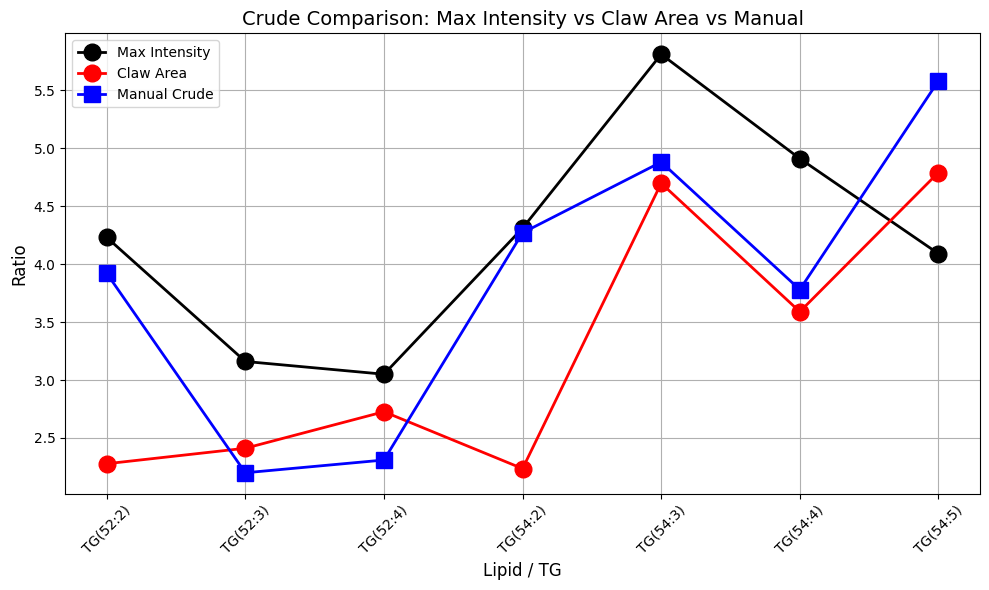

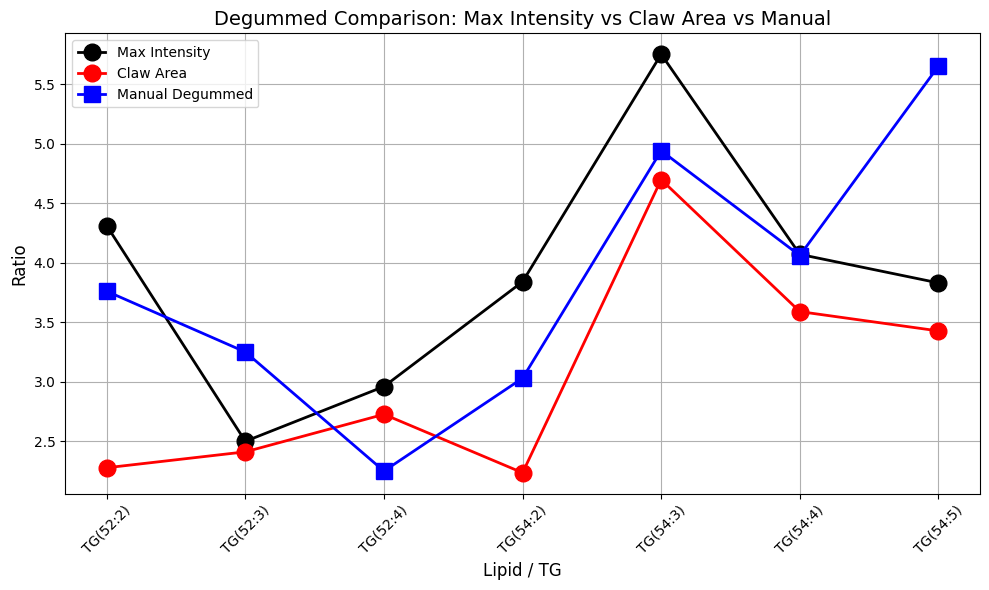

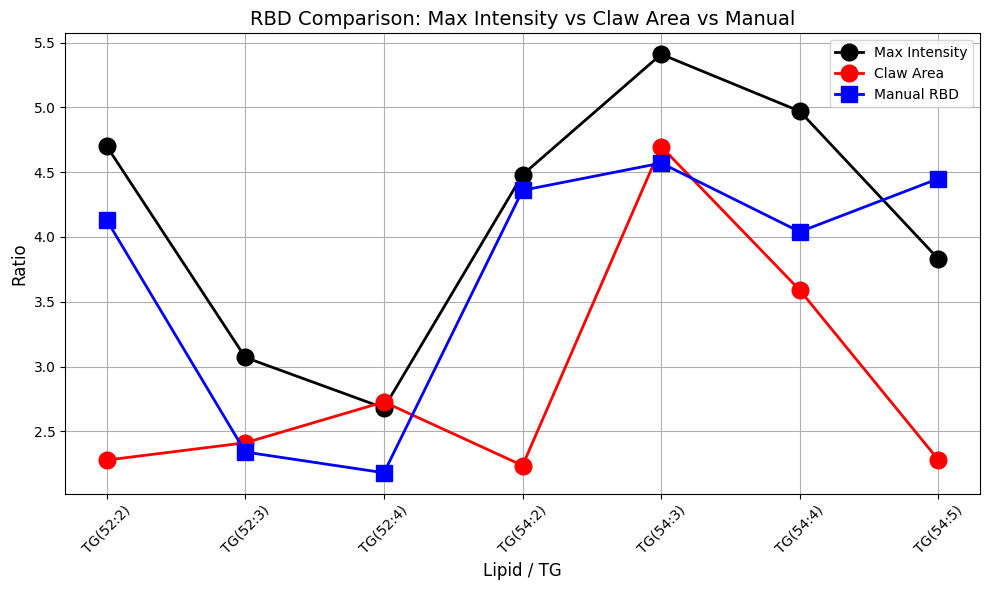

In [43]:
def plot_ratio_comparison(df_sample_ratio, manual_df, plot_title):
    plt.figure(figsize=(10, 6))
    
    # Plotting Max Intensity data (Black line, circle markers)
    plt.plot(df_sample_ratio['Lipid'], df_sample_ratio['Ratio'], 
             label='Max Intensity', color='black', marker='o', 
             markersize=12, linewidth=2)
    
    # Plotting Claw Area data (Red line, circle markers)
    plt.plot(df_sample_ratio['Lipid'], df_sample_ratio['Ratio_Area'], 
             label='Claw Area', color='red', marker='o', 
             markersize=12, linewidth=2)
    
    # Plotting Manual data (Blue line, square markers)
    plt.plot(manual_df['TG'], manual_df[plot_title], 
             label=f'Manual {plot_title}', color='blue', marker='s', 
             markersize=12, linewidth=2)
    
    # Adding Title, Labels, and Legend
    plt.title(f'{plot_title} Comparison: Max Intensity vs Claw Area vs Manual', fontsize=14)
    plt.xlabel('Lipid / TG', fontsize=12)
    plt.ylabel('Ratio', fontsize=12)
    plt.legend()
    
    # Adding grid, rotating x-axis labels, and showing the plot
    plt.grid(True)
    plt.xticks(rotation=45)
    plt.tight_layout()
    
    # Show the plot
    plt.show()

# Example manual data for comparison
manual_canola = {
    'TG': ['TG(52:2)', 'TG(52:3)', 'TG(52:4)', 'TG(54:2)', 'TG(54:3)', 'TG(54:4)', 'TG(54:5)'],
    'Crude': [3.92, 2.2, 2.31, 4.27, 4.88, 3.78, 5.58],
    'Degummed': [3.76, 3.25, 2.25, 3.03, 4.94, 4.06, 5.65],
    'RBD': [4.13, 2.34, 2.18, 4.36, 4.57, 4.04, 4.45]
}
manual_df = pd.DataFrame(manual_canola)

# Plotting Crude comparison
plot_ratio_comparison(df_sample1_ratio, manual_df, 'Crude')

# Plotting Degummed comparison
plot_ratio_comparison(df_sample2_ratio, manual_df, 'Degummed')

# Plotting RBD comparison
plot_ratio_comparison(df_sample3_ratio, manual_df, 'RBD')


In [44]:
# 103.785343 
# 66.122035 
# 36.53388

### Lipidomic OzESI Data Visualization

This section presents the visual representation of the lipidomic OzESI data, focusing on the ratio analysis of isomeric lipids based on their double bond location. By default, the visualization emphasizes the n-9/n-7 ratios, but the configuration can be tailored to accommodate any specific double bond location on a lipid. Select the directory where the plots will be saved.

In [45]:
# from plot import process_and_plot

# # Define output directories for each sample
# project = 'Projects/canola/'
# plot_folder = 'plots/'

# output_directory_crude = os.path.join(project, plot_folder, 'crude')
# output_directory_degummed = os.path.join(project, plot_folder, 'degummed')
# output_directory_rbd = os.path.join(project, plot_folder, 'rbd')

# # Assuming df_sample1_ratio, df_sample2_ratio, and df_sample3_ratio are already loaded

# # Process and plot for each sample
# process_and_plot(df_sample1_ratio, 'Crude', output_directory_crude)
# process_and_plot(df_sample2_ratio, 'Degummed', output_directory_degummed)
# process_and_plot(df_sample3_ratio, 'RBD', output_directory_rbd)


# Ratio Plot for Paper

In [46]:
from plot import plot_canola_comparison

# Assuming df_sample1_ratio, df_sample2_ratio, and df_sample3_ratio are already loaded

# Plot and display the comparison
plot_canola_comparison(df_sample1_ratio, df_sample2_ratio, df_sample3_ratio)

# Alternatively, save the plot to a file
# plot_canola_comparison(df_sample1_ratio, df_sample2_ratio, df_sample3_ratio, output_file="canola_comparison.png")
